In [1]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import Sequential, layers
from tensorflow.keras import optimizers
from tensorflow.keras.layers import Conv2D, MaxPooling2D
from tensorflow.keras.layers import Activation, Dropout, Flatten, Dense
from tensorflow.keras.layers.experimental.preprocessing import Rescaling
from tensorflow.keras import backend as K
import matplotlib.pyplot as plt

import os

2022-08-23 11:22:57.641024: I tensorflow/core/util/util.cc:169] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2022-08-23 11:22:57.668734: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-08-23 11:22:57.668784: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [2]:
# dimensions of our images.
img_width, img_height = 150, 150

train_data_dir = './raw_data/train_data/'
validation_data_dir = './raw_data/test_data/'
nb_train_samples = len([name for name in os.listdir(train_data_dir) for name in os.listdir(train_data_dir + name)])
nb_validation_samples = len([name for name in os.listdir(validation_data_dir) for name in os.listdir(validation_data_dir + name)])

batch_size = 1

input_shape = (img_width, img_height, 3)

In [3]:
model = Sequential()
model.add(Conv2D(32, (3, 3), input_shape=input_shape))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(32, (3, 3)))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(64, (3, 3)))
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Flatten())
model.add(Dense(64))
model.add(Activation('relu'))
model.add(Dropout(0.5))
model.add(Dense(41)) #class --> binary = 1 (0,1)
model.add(Activation('softmax')) #sigmoid

2022-08-23 11:23:03.661080: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2022-08-23 11:23:03.661308: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2022-08-23 11:23:03.661379: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (Kuma-HPPavilion): /proc/driver/nvidia/version does not exist
2022-08-23 11:23:03.662604: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [4]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 32)      896       
                                                                 
 activation (Activation)     (None, 148, 148, 32)      0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 74, 74, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 72, 72, 32)        9248      
                                                                 
 activation_1 (Activation)   (None, 72, 72, 32)        0         
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 36, 36, 32)       0         
 2D)                                                    

In [5]:
model.compile(loss='categorical_crossentropy', # binary_crossentropy or categorical_crossentropy  
              optimizer='adam',# rmsprop or adagrad or  #adam
              metrics=['accuracy'])

In [6]:
train_datagen = ImageDataGenerator(
    rescale=1. / 255,
    shear_range=0.7,
    zoom_range=0.7,
    brightness_range=[0.1,0.7],
    rotation_range=40)

train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical') #binary # categorical

print(train_generator.class_indices)

Found 42 images belonging to 41 classes.
{'Anri (2) - Bi・Ki・Ni': 0, 'Anri (2) - Coool': 1, 'Anri (2) - Timely!!': 2, 'Anri (2) - Wave': 3, 'Hiroshi Sato - Aqua': 4, 'Hiroshi Sato - Awakening': 5, 'Hiroshi Sato - Future File': 6, 'Hiroshi Sato - Sound Of Science': 7, 'Mariya Takeuchi - Beginning': 8, 'Mariya Takeuchi - Love Songs': 9, 'Mariya Takeuchi - Miss M': 10, 'Mariya Takeuchi - Request': 11, 'Mariya Takeuchi - Trad = トラッド': 12, 'Mariya Takeuchi - University Street': 13, 'Momoko Kikuchi - Adventure': 14, 'Momoko Kikuchi - Escape From Dimension': 15, 'Momoko Kikuchi - Ocean Side': 16, 'Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線': 17, 'Taeko Ohnuki - Aventure': 18, 'Taeko Ohnuki - Cliché': 19, 'Taeko Ohnuki - Grey Skies': 20, 'Taeko Ohnuki - Mignonne': 21, 'Taeko Ohnuki - Romantique': 22, 'Taeko Ohnuki - Sunshower': 23, 'Tatsuro Yamashita - Big Wave = ビッグウェイブ': 24, 'Tatsuro Yamashita - Circus Town': 25, 'Tatsuro Yamashita - For You': 26, 'Tatsuro Yamashita - Go Ahead

In [7]:
test_datagen = ImageDataGenerator(rescale=1. / 255)

validation_generator = test_datagen.flow_from_directory(
    validation_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='categorical') #binary # categorical

print(validation_generator.class_indices)

Found 42 images belonging to 41 classes.
{'Anri (2) - Bi・Ki・Ni': 0, 'Anri (2) - Coool': 1, 'Anri (2) - Timely!!': 2, 'Anri (2) - Wave': 3, 'Hiroshi Sato - Aqua': 4, 'Hiroshi Sato - Awakening': 5, 'Hiroshi Sato - Future File': 6, 'Hiroshi Sato - Sound Of Science': 7, 'Mariya Takeuchi - Beginning': 8, 'Mariya Takeuchi - Love Songs': 9, 'Mariya Takeuchi - Miss M': 10, 'Mariya Takeuchi - Request': 11, 'Mariya Takeuchi - Trad = トラッド': 12, 'Mariya Takeuchi - University Street': 13, 'Momoko Kikuchi - Adventure': 14, 'Momoko Kikuchi - Escape From Dimension': 15, 'Momoko Kikuchi - Ocean Side': 16, 'Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線': 17, 'Taeko Ohnuki - Aventure': 18, 'Taeko Ohnuki - Cliché': 19, 'Taeko Ohnuki - Grey Skies': 20, 'Taeko Ohnuki - Mignonne': 21, 'Taeko Ohnuki - Romantique': 22, 'Taeko Ohnuki - Sunshower': 23, 'Tatsuro Yamashita - Big Wave = ビッグウェイブ': 24, 'Tatsuro Yamashita - Circus Town': 25, 'Tatsuro Yamashita - For You': 26, 'Tatsuro Yamashita - Go Ahead

In [8]:
epochs = 1500

history =model.fit(
        train_generator,
        steps_per_epoch=nb_train_samples // batch_size,
        epochs=epochs,
        validation_data=validation_generator,
        validation_steps=nb_validation_samples // batch_size)

# model.save('modelDogCat.h5')
# model.save_weights('modelDogCat.h5')

Epoch 1/1500
42/42 [==============================] - 3s 38ms/step - loss: 3.8383 - accuracy: 0.0000e+00 - val_loss: 3.6962 - val_accuracy: 0.0476
Epoch 2/1500
42/42 [==============================] - 2s 36ms/step - loss: 3.7306 - accuracy: 0.0000e+00 - val_loss: 3.7664 - val_accuracy: 0.0238
Epoch 3/1500
42/42 [==============================] - 2s 35ms/step - loss: 3.7201 - accuracy: 0.0000e+00 - val_loss: 3.6945 - val_accuracy: 0.0238
Epoch 4/1500
42/42 [==============================] - 1s 34ms/step - loss: 3.7003 - accuracy: 0.0238 - val_loss: 3.8849 - val_accuracy: 0.0238
Epoch 5/1500
42/42 [==============================] - 1s 34ms/step - loss: 3.7497 - accuracy: 0.0238 - val_loss: 3.6969 - val_accuracy: 0.0476
Epoch 6/1500
42/42 [==============================] - 1s 33ms/step - loss: 3.7252 - accuracy: 0.0000e+00 - val_loss: 3.6974 - val_accuracy: 0.0476
Epoch 7/1500
42/42 [==============================] - 1s 33ms/step - loss: 3.7159 - accuracy: 0.0714 - val_loss: 3.6928 - val_

Epoch 58/1500
42/42 [==============================] - 1s 33ms/step - loss: 3.1015 - accuracy: 0.1429 - val_loss: 2.2645 - val_accuracy: 0.3810
Epoch 59/1500
42/42 [==============================] - 1s 33ms/step - loss: 3.1773 - accuracy: 0.1905 - val_loss: 2.0734 - val_accuracy: 0.4286
Epoch 60/1500
42/42 [==============================] - 1s 33ms/step - loss: 2.8648 - accuracy: 0.2143 - val_loss: 2.0018 - val_accuracy: 0.4286
Epoch 61/1500
42/42 [==============================] - 1s 34ms/step - loss: 2.9043 - accuracy: 0.2619 - val_loss: 1.9409 - val_accuracy: 0.4762
Epoch 62/1500
42/42 [==============================] - 1s 33ms/step - loss: 2.7794 - accuracy: 0.1190 - val_loss: 2.1304 - val_accuracy: 0.3571
Epoch 63/1500
42/42 [==============================] - 1s 32ms/step - loss: 3.2551 - accuracy: 0.1905 - val_loss: 1.8219 - val_accuracy: 0.4762
Epoch 64/1500
42/42 [==============================] - 1s 34ms/step - loss: 2.5973 - accuracy: 0.2143 - val_loss: 1.8160 - val_accuracy:

Epoch 115/1500
42/42 [==============================] - 1s 32ms/step - loss: 1.6614 - accuracy: 0.4286 - val_loss: 0.5343 - val_accuracy: 0.8333
Epoch 116/1500
42/42 [==============================] - 2s 37ms/step - loss: 2.2439 - accuracy: 0.3095 - val_loss: 0.5636 - val_accuracy: 0.8333
Epoch 117/1500
42/42 [==============================] - 2s 35ms/step - loss: 2.0258 - accuracy: 0.3095 - val_loss: 0.5442 - val_accuracy: 0.8333
Epoch 118/1500
42/42 [==============================] - 2s 35ms/step - loss: 2.0608 - accuracy: 0.4048 - val_loss: 0.5317 - val_accuracy: 0.8333
Epoch 119/1500
42/42 [==============================] - 1s 33ms/step - loss: 2.0022 - accuracy: 0.4286 - val_loss: 0.7460 - val_accuracy: 0.7619
Epoch 120/1500
42/42 [==============================] - 1s 33ms/step - loss: 2.2249 - accuracy: 0.4048 - val_loss: 0.4996 - val_accuracy: 0.8810
Epoch 121/1500
42/42 [==============================] - 1s 34ms/step - loss: 1.8693 - accuracy: 0.4286 - val_loss: 0.7017 - val_ac

42/42 [==============================] - 1s 34ms/step - loss: 1.0963 - accuracy: 0.7381 - val_loss: 0.2706 - val_accuracy: 0.8810
Epoch 172/1500
42/42 [==============================] - 1s 34ms/step - loss: 1.4953 - accuracy: 0.6190 - val_loss: 0.1645 - val_accuracy: 1.0000
Epoch 173/1500
42/42 [==============================] - 1s 33ms/step - loss: 1.2056 - accuracy: 0.5952 - val_loss: 0.5360 - val_accuracy: 0.8095
Epoch 174/1500
42/42 [==============================] - 1s 32ms/step - loss: 1.4591 - accuracy: 0.6429 - val_loss: 0.2815 - val_accuracy: 0.9286
Epoch 175/1500
42/42 [==============================] - 1s 34ms/step - loss: 1.1558 - accuracy: 0.6667 - val_loss: 0.2251 - val_accuracy: 0.9048
Epoch 176/1500
42/42 [==============================] - 1s 34ms/step - loss: 1.5436 - accuracy: 0.5238 - val_loss: 0.2499 - val_accuracy: 0.8810
Epoch 177/1500
42/42 [==============================] - 1s 33ms/step - loss: 1.3332 - accuracy: 0.5238 - val_loss: 0.1533 - val_accuracy: 0.9524


42/42 [==============================] - 1s 34ms/step - loss: 1.2305 - accuracy: 0.6429 - val_loss: 0.3957 - val_accuracy: 0.8810
Epoch 228/1500
42/42 [==============================] - 1s 35ms/step - loss: 1.0866 - accuracy: 0.6905 - val_loss: 0.2959 - val_accuracy: 0.9524
Epoch 229/1500
42/42 [==============================] - 1s 34ms/step - loss: 1.0640 - accuracy: 0.6667 - val_loss: 0.1151 - val_accuracy: 0.9524
Epoch 230/1500
42/42 [==============================] - 1s 33ms/step - loss: 1.3159 - accuracy: 0.5952 - val_loss: 0.1370 - val_accuracy: 0.9762
Epoch 231/1500
42/42 [==============================] - 2s 38ms/step - loss: 0.7927 - accuracy: 0.7143 - val_loss: 0.0690 - val_accuracy: 0.9762
Epoch 232/1500
42/42 [==============================] - 2s 35ms/step - loss: 1.3089 - accuracy: 0.5476 - val_loss: 0.1794 - val_accuracy: 0.9048
Epoch 233/1500
42/42 [==============================] - 2s 36ms/step - loss: 1.0408 - accuracy: 0.6190 - val_loss: 0.0979 - val_accuracy: 0.9762


42/42 [==============================] - 2s 36ms/step - loss: 0.6842 - accuracy: 0.7619 - val_loss: 0.0767 - val_accuracy: 0.9524
Epoch 284/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.8558 - accuracy: 0.6905 - val_loss: 0.0861 - val_accuracy: 0.9762
Epoch 285/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.8193 - accuracy: 0.8095 - val_loss: 0.0637 - val_accuracy: 0.9762
Epoch 286/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.9948 - accuracy: 0.7143 - val_loss: 0.0743 - val_accuracy: 0.9762
Epoch 287/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.8177 - accuracy: 0.7619 - val_loss: 0.0525 - val_accuracy: 0.9762
Epoch 288/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.5402 - accuracy: 0.8095 - val_loss: 0.0442 - val_accuracy: 0.9762
Epoch 289/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.8131 - accuracy: 0.7857 - val_loss: 0.0350 - val_accuracy: 1.0000


42/42 [==============================] - 1s 32ms/step - loss: 0.7755 - accuracy: 0.8333 - val_loss: 0.0200 - val_accuracy: 1.0000
Epoch 340/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.8992 - accuracy: 0.8810 - val_loss: 0.0168 - val_accuracy: 1.0000
Epoch 341/1500
42/42 [==============================] - 2s 37ms/step - loss: 0.7777 - accuracy: 0.7143 - val_loss: 0.0230 - val_accuracy: 1.0000
Epoch 342/1500
42/42 [==============================] - 2s 40ms/step - loss: 0.7310 - accuracy: 0.7619 - val_loss: 0.0268 - val_accuracy: 1.0000
Epoch 343/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.9685 - accuracy: 0.6905 - val_loss: 0.0426 - val_accuracy: 1.0000
Epoch 344/1500
42/42 [==============================] - 2s 34ms/step - loss: 0.6451 - accuracy: 0.7619 - val_loss: 0.1543 - val_accuracy: 0.9524
Epoch 345/1500
42/42 [==============================] - 1s 32ms/step - loss: 1.2648 - accuracy: 0.6429 - val_loss: 0.1718 - val_accuracy: 0.9048


42/42 [==============================] - 1s 34ms/step - loss: 0.7160 - accuracy: 0.7619 - val_loss: 0.0231 - val_accuracy: 1.0000
Epoch 396/1500
42/42 [==============================] - 1s 32ms/step - loss: 0.7363 - accuracy: 0.8095 - val_loss: 0.0053 - val_accuracy: 1.0000
Epoch 397/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.6240 - accuracy: 0.8333 - val_loss: 0.0030 - val_accuracy: 1.0000
Epoch 398/1500
42/42 [==============================] - 1s 32ms/step - loss: 0.8691 - accuracy: 0.7619 - val_loss: 0.0330 - val_accuracy: 0.9762
Epoch 399/1500
42/42 [==============================] - 1s 31ms/step - loss: 0.6336 - accuracy: 0.8095 - val_loss: 0.0078 - val_accuracy: 1.0000
Epoch 400/1500
42/42 [==============================] - 1s 35ms/step - loss: 0.6844 - accuracy: 0.7381 - val_loss: 0.0138 - val_accuracy: 1.0000
Epoch 401/1500
42/42 [==============================] - 1s 31ms/step - loss: 1.2540 - accuracy: 0.8095 - val_loss: 0.0260 - val_accuracy: 1.0000


42/42 [==============================] - 1s 34ms/step - loss: 1.0404 - accuracy: 0.6905 - val_loss: 0.0396 - val_accuracy: 0.9762
Epoch 452/1500
42/42 [==============================] - 1s 33ms/step - loss: 1.0101 - accuracy: 0.7381 - val_loss: 0.0164 - val_accuracy: 1.0000
Epoch 453/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.6056 - accuracy: 0.8095 - val_loss: 0.0140 - val_accuracy: 1.0000
Epoch 454/1500
42/42 [==============================] - 1s 32ms/step - loss: 0.3639 - accuracy: 0.9048 - val_loss: 0.0228 - val_accuracy: 0.9762
Epoch 455/1500
42/42 [==============================] - 1s 35ms/step - loss: 0.7847 - accuracy: 0.6905 - val_loss: 0.0366 - val_accuracy: 0.9762
Epoch 456/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.5756 - accuracy: 0.8095 - val_loss: 0.0167 - val_accuracy: 1.0000
Epoch 457/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.4528 - accuracy: 0.8571 - val_loss: 0.0047 - val_accuracy: 1.0000


42/42 [==============================] - 1s 34ms/step - loss: 0.5875 - accuracy: 0.8810 - val_loss: 0.0218 - val_accuracy: 1.0000
Epoch 508/1500
42/42 [==============================] - 2s 35ms/step - loss: 0.9764 - accuracy: 0.7143 - val_loss: 0.0942 - val_accuracy: 0.9524
Epoch 509/1500
42/42 [==============================] - 1s 32ms/step - loss: 0.6823 - accuracy: 0.8095 - val_loss: 1.0720 - val_accuracy: 0.8571
Epoch 510/1500
42/42 [==============================] - 1s 33ms/step - loss: 1.0679 - accuracy: 0.7381 - val_loss: 0.0379 - val_accuracy: 0.9762
Epoch 511/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.7066 - accuracy: 0.7619 - val_loss: 0.0231 - val_accuracy: 1.0000
Epoch 512/1500
42/42 [==============================] - 2s 35ms/step - loss: 0.5895 - accuracy: 0.8095 - val_loss: 0.0365 - val_accuracy: 0.9762
Epoch 513/1500
42/42 [==============================] - 1s 33ms/step - loss: 1.3388 - accuracy: 0.6905 - val_loss: 0.0809 - val_accuracy: 0.9524


42/42 [==============================] - 2s 35ms/step - loss: 0.8034 - accuracy: 0.7619 - val_loss: 0.0154 - val_accuracy: 1.0000
Epoch 564/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.4127 - accuracy: 0.9048 - val_loss: 0.0288 - val_accuracy: 0.9762
Epoch 565/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.7426 - accuracy: 0.8095 - val_loss: 0.0376 - val_accuracy: 0.9762
Epoch 566/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.4469 - accuracy: 0.8810 - val_loss: 0.0883 - val_accuracy: 0.9762
Epoch 567/1500
42/42 [==============================] - 2s 37ms/step - loss: 0.3860 - accuracy: 0.8333 - val_loss: 0.0660 - val_accuracy: 0.9762
Epoch 568/1500
42/42 [==============================] - 2s 37ms/step - loss: 0.3344 - accuracy: 0.8810 - val_loss: 0.0335 - val_accuracy: 0.9762
Epoch 569/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.7625 - accuracy: 0.7143 - val_loss: 0.0587 - val_accuracy: 0.9762


42/42 [==============================] - 1s 33ms/step - loss: 0.5927 - accuracy: 0.8095 - val_loss: 2.7917e-04 - val_accuracy: 1.0000
Epoch 620/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.4949 - accuracy: 0.8333 - val_loss: 2.0700e-04 - val_accuracy: 1.0000
Epoch 621/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.2671 - accuracy: 0.8810 - val_loss: 2.3843e-04 - val_accuracy: 1.0000
Epoch 622/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.5449 - accuracy: 0.8095 - val_loss: 0.0051 - val_accuracy: 1.0000
Epoch 623/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.4778 - accuracy: 0.8333 - val_loss: 0.0056 - val_accuracy: 1.0000
Epoch 624/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.3753 - accuracy: 0.8095 - val_loss: 0.0120 - val_accuracy: 1.0000
Epoch 625/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.2492 - accuracy: 0.9048 - val_loss: 0.0115 - val_accur

42/42 [==============================] - 2s 53ms/step - loss: 0.4133 - accuracy: 0.8571 - val_loss: 0.0151 - val_accuracy: 1.0000
Epoch 676/1500
42/42 [==============================] - 2s 41ms/step - loss: 0.6254 - accuracy: 0.7857 - val_loss: 0.1251 - val_accuracy: 0.9524
Epoch 677/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.4261 - accuracy: 0.9048 - val_loss: 0.0078 - val_accuracy: 1.0000
Epoch 678/1500
42/42 [==============================] - 2s 35ms/step - loss: 0.4025 - accuracy: 0.9048 - val_loss: 0.0012 - val_accuracy: 1.0000
Epoch 679/1500
42/42 [==============================] - 2s 41ms/step - loss: 0.3950 - accuracy: 0.8810 - val_loss: 0.0019 - val_accuracy: 1.0000
Epoch 680/1500
42/42 [==============================] - 2s 56ms/step - loss: 0.4998 - accuracy: 0.8571 - val_loss: 0.0273 - val_accuracy: 1.0000
Epoch 681/1500
42/42 [==============================] - 2s 58ms/step - loss: 0.4250 - accuracy: 0.8571 - val_loss: 0.0065 - val_accuracy: 1.0000


42/42 [==============================] - 1s 35ms/step - loss: 0.5032 - accuracy: 0.8333 - val_loss: 0.0033 - val_accuracy: 1.0000
Epoch 732/1500
42/42 [==============================] - 2s 39ms/step - loss: 0.7727 - accuracy: 0.7857 - val_loss: 0.0022 - val_accuracy: 1.0000
Epoch 733/1500
42/42 [==============================] - 1s 32ms/step - loss: 0.6897 - accuracy: 0.8095 - val_loss: 0.0092 - val_accuracy: 1.0000
Epoch 734/1500
42/42 [==============================] - 1s 32ms/step - loss: 0.3524 - accuracy: 0.8810 - val_loss: 0.0145 - val_accuracy: 1.0000
Epoch 735/1500
42/42 [==============================] - 1s 31ms/step - loss: 0.3110 - accuracy: 0.8810 - val_loss: 0.0151 - val_accuracy: 1.0000
Epoch 736/1500
42/42 [==============================] - 1s 32ms/step - loss: 0.6203 - accuracy: 0.7857 - val_loss: 0.1980 - val_accuracy: 0.9524
Epoch 737/1500
42/42 [==============================] - 2s 39ms/step - loss: 0.3879 - accuracy: 0.8095 - val_loss: 0.0830 - val_accuracy: 0.9762


42/42 [==============================] - 3s 60ms/step - loss: 0.2203 - accuracy: 0.9048 - val_loss: 3.0708e-04 - val_accuracy: 1.0000
Epoch 788/1500
42/42 [==============================] - 2s 40ms/step - loss: 0.3221 - accuracy: 0.9048 - val_loss: 8.7765e-04 - val_accuracy: 1.0000
Epoch 789/1500
42/42 [==============================] - 2s 56ms/step - loss: 0.6661 - accuracy: 0.8333 - val_loss: 2.9149e-04 - val_accuracy: 1.0000
Epoch 790/1500
42/42 [==============================] - 2s 50ms/step - loss: 0.4698 - accuracy: 0.8095 - val_loss: 3.1347e-04 - val_accuracy: 1.0000
Epoch 791/1500
42/42 [==============================] - 2s 49ms/step - loss: 0.5216 - accuracy: 0.8571 - val_loss: 7.9098e-05 - val_accuracy: 1.0000
Epoch 792/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.4713 - accuracy: 0.8810 - val_loss: 5.5194e-05 - val_accuracy: 1.0000
Epoch 793/1500
42/42 [==============================] - 1s 32ms/step - loss: 0.6830 - accuracy: 0.8571 - val_loss: 4.4121

42/42 [==============================] - 2s 42ms/step - loss: 0.8100 - accuracy: 0.8095 - val_loss: 0.0964 - val_accuracy: 0.9524
Epoch 844/1500
42/42 [==============================] - 2s 43ms/step - loss: 0.4008 - accuracy: 0.8095 - val_loss: 0.0051 - val_accuracy: 1.0000
Epoch 845/1500
42/42 [==============================] - 2s 55ms/step - loss: 0.5056 - accuracy: 0.8571 - val_loss: 0.0023 - val_accuracy: 1.0000
Epoch 846/1500
42/42 [==============================] - 2s 47ms/step - loss: 0.4139 - accuracy: 0.8571 - val_loss: 0.0045 - val_accuracy: 1.0000
Epoch 847/1500
42/42 [==============================] - 2s 46ms/step - loss: 1.2978 - accuracy: 0.8333 - val_loss: 0.0339 - val_accuracy: 0.9762
Epoch 848/1500
42/42 [==============================] - 2s 45ms/step - loss: 0.3196 - accuracy: 0.9048 - val_loss: 0.0155 - val_accuracy: 1.0000
Epoch 849/1500
42/42 [==============================] - 2s 51ms/step - loss: 0.4614 - accuracy: 0.8333 - val_loss: 0.0059 - val_accuracy: 1.0000


42/42 [==============================] - 1s 34ms/step - loss: 0.1024 - accuracy: 0.9762 - val_loss: 1.4208e-04 - val_accuracy: 1.0000
Epoch 900/1500
42/42 [==============================] - 2s 35ms/step - loss: 0.3337 - accuracy: 0.8571 - val_loss: 5.4281e-04 - val_accuracy: 1.0000
Epoch 901/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.3548 - accuracy: 0.9048 - val_loss: 0.0610 - val_accuracy: 0.9762
Epoch 902/1500
42/42 [==============================] - 2s 35ms/step - loss: 0.5378 - accuracy: 0.8571 - val_loss: 6.5849e-04 - val_accuracy: 1.0000
Epoch 903/1500
42/42 [==============================] - 1s 35ms/step - loss: 0.3450 - accuracy: 0.9048 - val_loss: 3.4673e-04 - val_accuracy: 1.0000
Epoch 904/1500
42/42 [==============================] - 2s 35ms/step - loss: 0.2078 - accuracy: 0.9048 - val_loss: 4.1132e-04 - val_accuracy: 1.0000
Epoch 905/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.1641 - accuracy: 0.9286 - val_loss: 3.0346e-04

Epoch 955/1500
42/42 [==============================] - 2s 35ms/step - loss: 0.3995 - accuracy: 0.8810 - val_loss: 6.0024e-04 - val_accuracy: 1.0000
Epoch 956/1500
42/42 [==============================] - 2s 36ms/step - loss: 0.3063 - accuracy: 0.9286 - val_loss: 0.0122 - val_accuracy: 1.0000
Epoch 957/1500
42/42 [==============================] - 2s 36ms/step - loss: 0.2725 - accuracy: 0.8810 - val_loss: 0.0010 - val_accuracy: 1.0000
Epoch 958/1500
42/42 [==============================] - 2s 37ms/step - loss: 0.6753 - accuracy: 0.8333 - val_loss: 0.0010 - val_accuracy: 1.0000
Epoch 959/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.3359 - accuracy: 0.9048 - val_loss: 5.7755e-04 - val_accuracy: 1.0000
Epoch 960/1500
42/42 [==============================] - 1s 35ms/step - loss: 0.5379 - accuracy: 0.9048 - val_loss: 3.2101e-04 - val_accuracy: 1.0000
Epoch 961/1500
42/42 [==============================] - 1s 35ms/step - loss: 0.2504 - accuracy: 0.9524 - val_loss: 0.0

42/42 [==============================] - 1s 34ms/step - loss: 0.2024 - accuracy: 0.9286 - val_loss: 7.4691e-04 - val_accuracy: 1.0000
Epoch 1011/1500
42/42 [==============================] - 1s 35ms/step - loss: 0.7393 - accuracy: 0.7619 - val_loss: 0.0065 - val_accuracy: 1.0000
Epoch 1012/1500
42/42 [==============================] - 1s 35ms/step - loss: 0.2163 - accuracy: 0.9286 - val_loss: 0.0060 - val_accuracy: 1.0000
Epoch 1013/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.1531 - accuracy: 0.9524 - val_loss: 0.0189 - val_accuracy: 1.0000
Epoch 1014/1500
42/42 [==============================] - 2s 37ms/step - loss: 0.4452 - accuracy: 0.8095 - val_loss: 0.0017 - val_accuracy: 1.0000
Epoch 1015/1500
42/42 [==============================] - 2s 36ms/step - loss: 0.4035 - accuracy: 0.8333 - val_loss: 3.4526e-04 - val_accuracy: 1.0000
Epoch 1016/1500
42/42 [==============================] - 2s 38ms/step - loss: 0.3458 - accuracy: 0.8810 - val_loss: 8.0938e-04 - val

Epoch 1066/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.2351 - accuracy: 0.9048 - val_loss: 0.0080 - val_accuracy: 1.0000
Epoch 1067/1500
42/42 [==============================] - 2s 39ms/step - loss: 0.2699 - accuracy: 0.9048 - val_loss: 0.0024 - val_accuracy: 1.0000
Epoch 1068/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.4840 - accuracy: 0.8810 - val_loss: 0.0059 - val_accuracy: 1.0000
Epoch 1069/1500
42/42 [==============================] - 2s 35ms/step - loss: 0.2921 - accuracy: 0.9048 - val_loss: 0.0067 - val_accuracy: 1.0000
Epoch 1070/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.2220 - accuracy: 0.9048 - val_loss: 0.0083 - val_accuracy: 1.0000
Epoch 1071/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.1358 - accuracy: 0.9524 - val_loss: 0.0104 - val_accuracy: 1.0000
Epoch 1072/1500
42/42 [==============================] - 2s 35ms/step - loss: 0.5792 - accuracy: 0.7619 - val_loss: 0.0771 -

Epoch 1122/1500
42/42 [==============================] - 2s 44ms/step - loss: 0.2994 - accuracy: 0.8810 - val_loss: 0.0067 - val_accuracy: 1.0000
Epoch 1123/1500
42/42 [==============================] - 2s 42ms/step - loss: 0.3556 - accuracy: 0.8571 - val_loss: 0.0047 - val_accuracy: 1.0000
Epoch 1124/1500
42/42 [==============================] - 2s 40ms/step - loss: 0.2438 - accuracy: 0.8571 - val_loss: 0.0022 - val_accuracy: 1.0000
Epoch 1125/1500
42/42 [==============================] - 2s 50ms/step - loss: 0.3791 - accuracy: 0.9286 - val_loss: 0.0032 - val_accuracy: 1.0000
Epoch 1126/1500
42/42 [==============================] - 2s 51ms/step - loss: 0.6759 - accuracy: 0.8095 - val_loss: 0.0044 - val_accuracy: 1.0000
Epoch 1127/1500
42/42 [==============================] - 2s 48ms/step - loss: 0.4024 - accuracy: 0.8333 - val_loss: 0.0185 - val_accuracy: 1.0000
Epoch 1128/1500
42/42 [==============================] - 2s 44ms/step - loss: 0.3879 - accuracy: 0.9048 - val_loss: 0.0197 -

42/42 [==============================] - 2s 44ms/step - loss: 0.4089 - accuracy: 0.8810 - val_loss: 0.0101 - val_accuracy: 1.0000
Epoch 1179/1500
42/42 [==============================] - 1s 32ms/step - loss: 0.1539 - accuracy: 0.9524 - val_loss: 0.0081 - val_accuracy: 1.0000
Epoch 1180/1500
42/42 [==============================] - 1s 31ms/step - loss: 0.1759 - accuracy: 0.9524 - val_loss: 0.3966 - val_accuracy: 0.9286
Epoch 1181/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.2688 - accuracy: 0.9048 - val_loss: 0.0309 - val_accuracy: 0.9762
Epoch 1182/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.2178 - accuracy: 0.9048 - val_loss: 4.1750e-04 - val_accuracy: 1.0000
Epoch 1183/1500
42/42 [==============================] - 2s 44ms/step - loss: 0.7417 - accuracy: 0.7381 - val_loss: 3.9453e-04 - val_accuracy: 1.0000
Epoch 1184/1500
42/42 [==============================] - 2s 48ms/step - loss: 0.4837 - accuracy: 0.8810 - val_loss: 0.0013 - val_acc

Epoch 1234/1500
42/42 [==============================] - 1s 32ms/step - loss: 0.3070 - accuracy: 0.9286 - val_loss: 1.5056e-04 - val_accuracy: 1.0000
Epoch 1235/1500
42/42 [==============================] - 1s 32ms/step - loss: 0.2206 - accuracy: 0.9286 - val_loss: 1.4910e-04 - val_accuracy: 1.0000
Epoch 1236/1500
42/42 [==============================] - 1s 31ms/step - loss: 0.2222 - accuracy: 0.9286 - val_loss: 2.9212e-04 - val_accuracy: 1.0000
Epoch 1237/1500
42/42 [==============================] - 1s 34ms/step - loss: 0.3935 - accuracy: 0.8810 - val_loss: 2.0017e-04 - val_accuracy: 1.0000
Epoch 1238/1500
42/42 [==============================] - 1s 32ms/step - loss: 0.1836 - accuracy: 0.9524 - val_loss: 2.6279e-04 - val_accuracy: 1.0000
Epoch 1239/1500
42/42 [==============================] - 1s 32ms/step - loss: 1.2118 - accuracy: 0.7619 - val_loss: 3.2155e-04 - val_accuracy: 1.0000
Epoch 1240/1500
42/42 [==============================] - 1s 32ms/step - loss: 0.3207 - accuracy: 0.9

Epoch 1290/1500
42/42 [==============================] - 2s 37ms/step - loss: 0.4228 - accuracy: 0.8571 - val_loss: 0.0012 - val_accuracy: 1.0000
Epoch 1291/1500
42/42 [==============================] - 2s 37ms/step - loss: 0.3699 - accuracy: 0.9048 - val_loss: 6.8190e-04 - val_accuracy: 1.0000
Epoch 1292/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.3929 - accuracy: 0.9048 - val_loss: 0.0010 - val_accuracy: 1.0000
Epoch 1293/1500
42/42 [==============================] - 1s 33ms/step - loss: 0.2642 - accuracy: 0.9762 - val_loss: 9.1236e-04 - val_accuracy: 1.0000
Epoch 1294/1500
42/42 [==============================] - 2s 39ms/step - loss: 0.7652 - accuracy: 0.8333 - val_loss: 0.1894 - val_accuracy: 0.9762
Epoch 1295/1500
42/42 [==============================] - 2s 37ms/step - loss: 0.4376 - accuracy: 0.8571 - val_loss: 0.0170 - val_accuracy: 1.0000
Epoch 1296/1500
42/42 [==============================] - 2s 37ms/step - loss: 0.2663 - accuracy: 0.9048 - val_loss: 

42/42 [==============================] - 2s 41ms/step - loss: 0.1911 - accuracy: 0.9286 - val_loss: 0.0040 - val_accuracy: 1.0000
Epoch 1346/1500
42/42 [==============================] - 2s 38ms/step - loss: 0.1785 - accuracy: 0.9524 - val_loss: 0.0021 - val_accuracy: 1.0000
Epoch 1347/1500
42/42 [==============================] - 2s 39ms/step - loss: 0.1581 - accuracy: 0.9286 - val_loss: 0.0017 - val_accuracy: 1.0000
Epoch 1348/1500
42/42 [==============================] - 2s 37ms/step - loss: 0.7236 - accuracy: 0.8333 - val_loss: 0.0042 - val_accuracy: 1.0000
Epoch 1349/1500
42/42 [==============================] - 2s 43ms/step - loss: 0.1776 - accuracy: 0.9524 - val_loss: 0.0019 - val_accuracy: 1.0000
Epoch 1350/1500
42/42 [==============================] - 2s 47ms/step - loss: 0.4004 - accuracy: 0.9048 - val_loss: 0.0019 - val_accuracy: 1.0000
Epoch 1351/1500
42/42 [==============================] - 2s 47ms/step - loss: 0.3118 - accuracy: 0.9048 - val_loss: 0.0028 - val_accuracy: 1

Epoch 1401/1500
42/42 [==============================] - 3s 59ms/step - loss: 0.5367 - accuracy: 0.8095 - val_loss: 0.0864 - val_accuracy: 0.9762
Epoch 1402/1500
42/42 [==============================] - 2s 46ms/step - loss: 0.3457 - accuracy: 0.9048 - val_loss: 6.7095e-04 - val_accuracy: 1.0000
Epoch 1403/1500
42/42 [==============================] - 2s 46ms/step - loss: 0.2030 - accuracy: 0.9286 - val_loss: 0.0083 - val_accuracy: 1.0000
Epoch 1404/1500
42/42 [==============================] - 2s 40ms/step - loss: 0.3776 - accuracy: 0.9286 - val_loss: 0.0024 - val_accuracy: 1.0000
Epoch 1405/1500
42/42 [==============================] - 2s 40ms/step - loss: 0.3975 - accuracy: 0.8810 - val_loss: 4.1175e-04 - val_accuracy: 1.0000
Epoch 1406/1500
42/42 [==============================] - 2s 47ms/step - loss: 0.7798 - accuracy: 0.7381 - val_loss: 0.0829 - val_accuracy: 0.9762
Epoch 1407/1500
42/42 [==============================] - 2s 46ms/step - loss: 0.4272 - accuracy: 0.8333 - val_loss: 

42/42 [==============================] - 2s 38ms/step - loss: 0.2717 - accuracy: 0.9286 - val_loss: 0.0022 - val_accuracy: 1.0000
Epoch 1457/1500
42/42 [==============================] - 2s 38ms/step - loss: 0.2982 - accuracy: 0.8571 - val_loss: 0.0054 - val_accuracy: 1.0000
Epoch 1458/1500
42/42 [==============================] - 2s 37ms/step - loss: 0.1224 - accuracy: 0.9762 - val_loss: 0.0043 - val_accuracy: 1.0000
Epoch 1459/1500
42/42 [==============================] - 2s 38ms/step - loss: 0.2879 - accuracy: 0.9048 - val_loss: 5.8998e-04 - val_accuracy: 1.0000
Epoch 1460/1500
42/42 [==============================] - 2s 38ms/step - loss: 0.2941 - accuracy: 0.9048 - val_loss: 0.0017 - val_accuracy: 1.0000
Epoch 1461/1500
42/42 [==============================] - 1s 35ms/step - loss: 0.2142 - accuracy: 0.9048 - val_loss: 0.0047 - val_accuracy: 1.0000
Epoch 1462/1500
42/42 [==============================] - 2s 37ms/step - loss: 0.1715 - accuracy: 0.9286 - val_loss: 0.0060 - val_accurac

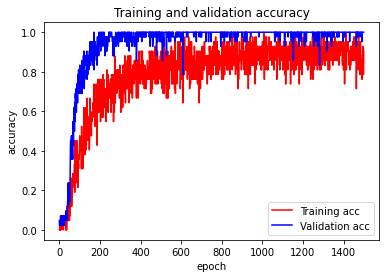

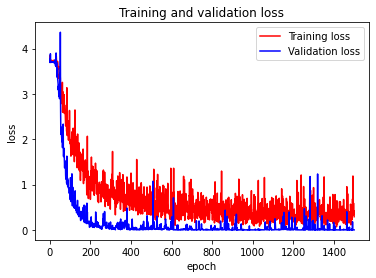

In [14]:
#Graphing our training and validation
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(len(acc))
plt.plot(epochs, acc, 'r', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.ylabel('accuracy') 
plt.xlabel('epoch')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'r', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.ylabel('loss') 
plt.xlabel('epoch')
plt.legend()
plt.show()

In [10]:
model.save('model_vynil.h5')

In [11]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
import numpy as np
from os import listdir
from os.path import isfile, join
import matplotlib.pyplot as plt

In [12]:
# dimensions of our images
img_width, img_height = 150, 150

# load the model we saved
model = load_model('model_vynil.h5')

['3.m51786064734_1.jpg', '6.m29481208014_1.jpg', '2.m21284341854_1.jpg', '5.m82386266798_1.jpg', '4.m82380223801_1.jpg', '7.img-421845956-l-1192555620.jpg', '4.m51786064734_2.jpg', '5.m70805178391_1.jpg', '4.m70473182692_1.jpg', '3.m73993617730_2.jpg', '7.61uz8pnazml._ac_sl1500_.jpg', '1.m79216628607_1.jpg', '2.m66501224806_1.jpg', '3.m45251919568_1.jpg', '7.m17039467299_4.jpg', '3.m22184983384_1.jpg', '1.m88299889385_1.jpg', '6.181205108.jpg', '2.m24108902445_2.jpg', '5.m56646435367_1.jpg', '5.m33441902042_1.jpg', '5.m38645278129_1.jpg', '5.m85302009752_2.jpg', '3.m67899962321_1.jpg', '3.m15588363283_1.jpg', '1.m43303091319_1.jpg', '3.m54536359205_1.jpg', '5.m39831465134_1.jpg', '2.m91940822397_1.jpg', '2.m90558147170_1.jpg', '5.m45157180784_1.jpg', '3.m82935382292_5.jpg', '4.m17039467299_5.jpg', '5.m70381324119_1.jpg', '6.m59215775836_2.jpg', '3.m83034804829_1.jpg', '3.161399666.jpg', '7.m24108902445_2.jpg', '5.m80385441872_1.jpg', '4.m26092923537_3.jpg', '5.m95535196361_2.jpg', '5.m

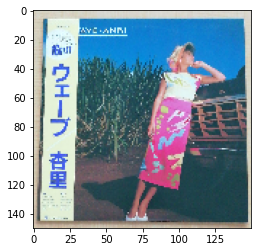

1/1 [==============================] - 0s 388ms/step
[[3.30596783e-26 1.62092632e-28 4.35039867e-03 9.89906847e-01
  1.43130492e-14 2.41925378e-24 1.14903034e-23 5.59365017e-24
  2.03514901e-06 1.76604479e-32 2.27943159e-33 4.36251684e-28
  7.01571396e-13 5.08308396e-30 6.01653883e-12 4.22077819e-13
  3.10461874e-05 4.21331916e-03 3.59923626e-24 0.00000000e+00
  5.67493690e-31 1.03972550e-18 4.78835761e-23 1.52070581e-27
  1.30513334e-03 3.65562400e-16 1.71812771e-05 5.28007236e-29
  7.98735481e-32 5.59342441e-28 4.75495246e-17 1.23996969e-22
  9.04844288e-13 2.54044095e-11 2.25802799e-34 1.74019253e-04
  3.83389363e-18 8.36164634e-24 1.05225914e-13 3.72733977e-24
  2.39455482e-13]]
Anri (2) - Wave , 98.99
3.m51786064734_1.jpg: Anri (2) - Wave
--------------------------------------------------------------
6.m29481208014_1.jpg


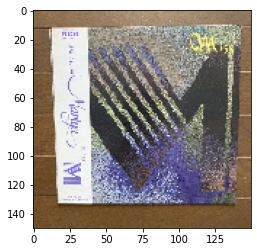

1/1 [==============================] - 0s 38ms/step
[[3.3217920e-27 4.9606063e-20 2.6971470e-21 2.9781956e-17 4.2248369e-24
  3.3808787e-09 4.5636244e-25 9.0242951e-09 1.0378165e-12 9.8726805e-10
  1.4073160e-01 4.7424221e-03 2.9410424e-12 2.7176832e-14 1.0133411e-26
  3.0978171e-30 1.0104823e-23 3.8452955e-29 7.7963670e-19 8.8600860e-09
  8.5450923e-01 7.3873529e-23 1.1587750e-24 2.7986970e-12 3.1614582e-31
  7.2642754e-25 1.4332688e-29 1.0038926e-24 5.6250393e-24 1.1096729e-19
  6.4715286e-09 3.4168900e-13 5.2543702e-11 1.8505533e-30 4.0440027e-29
  4.3283311e-22 1.4746658e-20 5.8063071e-10 3.8515320e-23 1.6677581e-05
  1.5908559e-26]]
Taeko Ohnuki - Grey Skies , 85.45
6.m29481208014_1.jpg: Taeko Ohnuki - Grey Skies
--------------------------------------------------------------
2.m21284341854_1.jpg


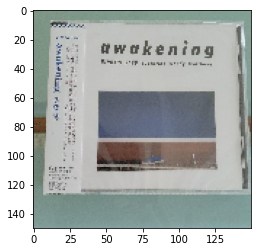

1/1 [==============================] - 0s 46ms/step
[[6.4349779e-06 1.0516657e-03 3.0054174e-05 1.3916610e-03 8.8001361e-06
  1.9421729e-01 1.1268462e-02 6.4500625e-04 2.5563706e-02 3.3668500e-06
  1.1769541e-02 5.5652508e-03 3.0576889e-04 7.0941617e-04 1.0888456e-04
  1.7180747e-03 8.5687480e-04 9.9331362e-04 3.4628978e-03 3.0417230e-05
  1.5720973e-02 2.9327495e-05 4.0866560e-03 8.8665277e-02 2.1651060e-04
  9.8025033e-05 1.0723543e-04 6.6264528e-07 1.7531163e-03 1.0309080e-06
  3.5097908e-02 5.4846914e-05 4.5371167e-02 1.1052723e-04 9.1477414e-05
  5.4238029e-02 1.4780129e-01 3.6051304e-03 2.5469798e-01 1.3948226e-04
  8.8406399e-02]]
Utada Hikaru - First Love , 25.47
2.m21284341854_1.jpg: Utada Hikaru - First Love
--------------------------------------------------------------
5.m82386266798_1.jpg


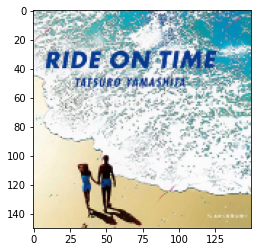

1/1 [==============================] - 0s 32ms/step
[[7.3175507e-18 1.8794377e-19 9.9470753e-07 1.2193690e-06 7.2910775e-15
  6.1367609e-05 1.3760047e-04 2.9730851e-12 4.1422441e-06 2.7867629e-22
  1.2041193e-18 1.7493092e-10 8.4795949e-21 4.2684534e-25 1.6789081e-11
  2.7931915e-03 5.4147846e-01 1.8971878e-14 1.3396108e-10 2.2995851e-18
  1.8965550e-10 1.2785719e-15 3.9029467e-07 1.0930484e-05 5.6664525e-03
  3.0111933e-14 3.2399569e-13 1.5656361e-16 9.3588336e-24 9.1950953e-16
  6.1210492e-05 2.6294180e-13 3.5122487e-01 7.0912186e-08 2.8631036e-25
  1.2338973e-07 8.5369080e-11 2.0701550e-12 6.4214858e-17 1.0207695e-18
  9.8559037e-02]]
Momoko Kikuchi - Ocean Side , 54.15
5.m82386266798_1.jpg: Momoko Kikuchi - Ocean Side
--------------------------------------------------------------
4.m82380223801_1.jpg


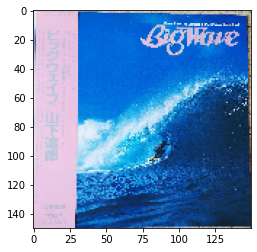

1/1 [==============================] - 0s 39ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 1.1891858e-27 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 3.5162116e-32 1.0077270e-24 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+00
  1.4731870e-23 2.3549316e-27 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 1.0415176e-32 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00]]
Tatsuro Yamashita - Big Wave = ビッグウェイブ , 100.00
4.m82380223801_1.jpg: Tatsuro Yamashita - Big Wave = ビッグウェイブ
--------------------------------------------------------------
7.img-421845956-l-1192555620.jpg


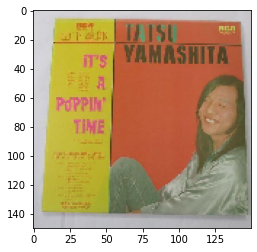

1/1 [==============================] - 0s 41ms/step
[[9.8676855e-07 7.5235820e-01 1.5151162e-23 3.8218751e-08 2.2688249e-24
  6.9484771e-21 5.3929062e-23 6.1052948e-25 1.8090377e-05 4.9718069e-20
  2.4770408e-17 9.2889351e-15 1.2591720e-12 9.2812257e-07 1.0669571e-08
  3.8428740e-24 6.6831396e-17 1.3824602e-20 2.1161300e-27 7.7949563e-24
  1.3425978e-19 2.7897342e-16 8.7930778e-15 1.6234117e-13 3.6566626e-21
  3.9013618e-26 8.5315515e-23 1.0097008e-08 1.9980358e-01 1.2517331e-14
  8.9468736e-12 7.6350698e-23 1.8810084e-16 1.0511068e-12 5.0631072e-05
  1.6470348e-12 2.2027409e-08 2.4122285e-20 4.7767527e-02 6.4509567e-19
  5.2248133e-22]]
Anri (2) - Coool , 75.24
7.img-421845956-l-1192555620.jpg: Anri (2) - Coool
--------------------------------------------------------------
4.m51786064734_2.jpg


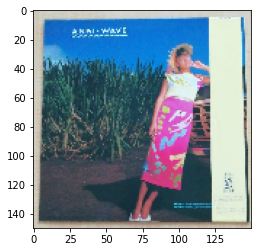

1/1 [==============================] - 0s 29ms/step
[[3.2194296e-30 1.0604888e-24 7.4012138e-07 1.6006242e-04 2.4363839e-13
  1.0889485e-22 9.7462081e-22 1.7228445e-20 1.5771748e-03 5.8663166e-35
  0.0000000e+00 5.1499540e-38 7.4096510e-17 3.5652636e-26 4.0654395e-09
  3.7965474e-20 8.1528798e-11 8.2820064e-01 2.4482032e-16 0.0000000e+00
  7.7204307e-27 1.0653943e-18 5.4694142e-17 3.0758854e-21 3.4672011e-02
  1.9662461e-11 7.6376587e-02 2.2769625e-28 9.2897532e-30 2.6928661e-26
  2.5550135e-13 6.4042852e-23 4.7432021e-08 2.5015892e-09 2.9356803e-28
  5.9012838e-02 1.0013366e-13 5.2648242e-24 3.8361279e-14 2.7057330e-29
  2.5429501e-18]]
Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線 , 82.82
4.m51786064734_2.jpg: Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線
--------------------------------------------------------------
5.m70805178391_1.jpg


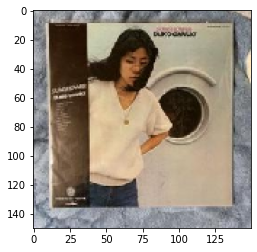

1/1 [==============================] - 0s 38ms/step
[[0.0000000e+00 1.9133565e-27 1.6967754e-21 1.0683793e-16 0.0000000e+00
  1.2402274e-29 0.0000000e+00 5.2957576e-35 2.2617574e-25 2.1435629e-25
  0.0000000e+00 0.0000000e+00 0.0000000e+00 9.3715799e-32 3.8684114e-24
  7.0902581e-37 2.1896106e-27 2.1966650e-33 0.0000000e+00 0.0000000e+00
  3.5071023e-14 1.0396692e-15 8.4150093e-07 6.4575056e-10 4.7016965e-32
  0.0000000e+00 4.3818233e-34 7.2515558e-24 6.9078947e-27 3.4757878e-34
  2.5512811e-05 5.0994224e-31 8.1839961e-38 2.8474395e-25 1.9469978e-19
  9.9997365e-01 3.3244138e-13 2.2339181e-15 7.1723066e-10 0.0000000e+00
  0.0000000e+00]]
Tatsuro Yamashita - Spacy , 100.00
5.m70805178391_1.jpg: Tatsuro Yamashita - Spacy
--------------------------------------------------------------
4.m70473182692_1.jpg


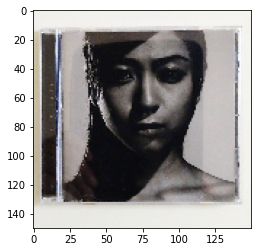

1/1 [==============================] - 0s 45ms/step
[[0.00000000e+00 1.12479138e-36 1.06460675e-05 1.01012515e-18
  3.66915000e-27 7.54053323e-20 0.00000000e+00 1.25509525e-09
  8.48211867e-29 2.05252273e-03 9.72659245e-11 4.05978656e-14
  4.38140263e-22 1.03027818e-29 7.54742772e-38 1.03157249e-28
  1.15462060e-33 5.36238850e-24 5.38027408e-32 3.90853528e-14
  7.63059035e-02 1.01034994e-08 1.36599274e-11 6.25839387e-13
  3.35001196e-35 1.81107048e-32 4.38783763e-24 1.93544608e-28
  0.00000000e+00 4.55833764e-29 2.47136601e-15 1.19405530e-09
  7.09341275e-34 2.53337615e-27 2.77665495e-34 2.20610612e-14
  2.41010032e-19 9.21630919e-01 1.60050964e-24 2.28278750e-14
  0.00000000e+00]]
Utada Hikaru - Deep River , 92.16
4.m70473182692_1.jpg: Utada Hikaru - Deep River
--------------------------------------------------------------
3.m73993617730_2.jpg


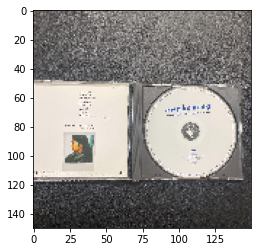

1/1 [==============================] - 0s 34ms/step
[[1.3097973e-07 1.1689845e-03 9.8335603e-04 3.0388378e-06 6.9499140e-10
  6.2243710e-04 1.6158312e-05 3.3424892e-02 9.0378046e-02 1.5488247e-06
  7.9123315e-04 3.1753583e-08 7.1939787e-05 1.6836699e-05 6.5013101e-06
  3.6240239e-05 3.9625775e-05 1.7939622e-03 4.8959072e-07 1.9213729e-08
  6.9317553e-05 9.3411742e-05 9.5788814e-02 2.1250977e-04 2.6204766e-06
  4.1931716e-10 3.6066777e-07 2.4201529e-07 3.8948124e-07 5.5265667e-05
  9.2179365e-03 4.8985720e-02 3.7480992e-01 3.1700379e-01 2.0429849e-04
  2.1648333e-05 2.2465937e-02 1.4122290e-04 1.5711151e-07 1.5660651e-03
  4.9513537e-06]]
Tatsuro Yamashita - On The Street Corner 2 , 37.48
3.m73993617730_2.jpg: Tatsuro Yamashita - On The Street Corner 2
--------------------------------------------------------------
7.61uz8pnazml._ac_sl1500_.jpg


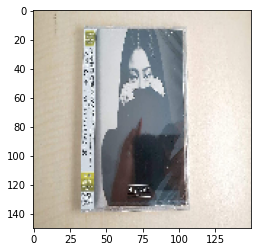

1/1 [==============================] - 0s 34ms/step
[[9.04734065e-09 8.60578325e-07 9.16590856e-04 1.50249007e-05
  1.49640944e-09 7.14186626e-03 5.04725380e-03 3.74395109e-04
  7.16494843e-02 7.31784944e-09 1.04736224e-04 2.81412639e-07
  7.92842798e-07 6.55085008e-09 2.69300449e-06 2.50823498e-02
  6.34941785e-03 2.66668014e-03 2.96916073e-06 3.83537202e-10
  8.34805087e-06 4.96002895e-06 1.36892170e-01 2.65745935e-03
  1.71549743e-06 3.26678862e-09 5.16537852e-07 2.21306462e-09
  1.88757525e-07 6.07089206e-08 5.07798931e-03 4.59263014e-04
  4.03726399e-01 2.62045681e-01 3.35413745e-07 1.58513535e-03
  5.46074845e-02 2.23163934e-05 2.31432750e-05 1.18771482e-06
  1.35301631e-02]]
Tatsuro Yamashita - On The Street Corner 2 , 40.37
7.61uz8pnazml._ac_sl1500_.jpg: Tatsuro Yamashita - On The Street Corner 2
--------------------------------------------------------------
1.m79216628607_1.jpg


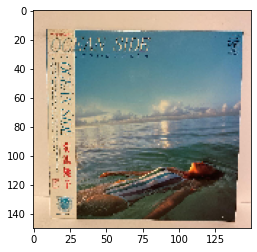

1/1 [==============================] - 0s 38ms/step
[[3.43095338e-19 8.86455879e-18 9.83417928e-01 3.89969209e-04
  3.37108154e-11 1.53195344e-06 2.82061785e-14 6.04631261e-15
  2.76212371e-03 3.41623299e-20 7.60614580e-14 1.17920526e-05
  1.43571274e-17 4.01262528e-21 9.49550298e-16 5.21940272e-03
  8.06071982e-03 1.48140067e-09 1.29238196e-16 6.49604064e-20
  8.76044116e-12 2.34827185e-05 5.42672609e-08 2.45697490e-10
  1.76274799e-08 1.25484821e-16 9.52115651e-14 2.49154638e-11
  8.19089348e-21 3.90528437e-14 1.73157147e-07 3.44589757e-09
  8.28860358e-09 9.24115811e-05 2.65732185e-18 2.03084164e-05
  1.49140783e-10 1.14989405e-08 6.21069196e-10 1.09361356e-08
  1.65585377e-08]]
Anri (2) - Timely!! , 98.34
1.m79216628607_1.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
2.m66501224806_1.jpg


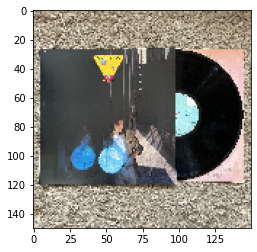

1/1 [==============================] - 0s 41ms/step
[[0.0000000e+00 3.3874343e-17 8.6909494e-13 1.1550263e-15 0.0000000e+00
  6.3203736e-27 0.0000000e+00 9.8553214e-19 1.1102132e-10 6.2641492e-15
  2.8508871e-23 5.0136893e-36 1.4147601e-34 5.4735249e-26 8.6991086e-13
  0.0000000e+00 2.9735441e-33 5.7148628e-27 0.0000000e+00 2.1215715e-34
  5.8518021e-24 1.5239850e-17 1.2719716e-04 7.5276661e-23 2.8827557e-37
  0.0000000e+00 1.6632528e-35 3.8148859e-27 5.4124586e-34 1.0186501e-23
  9.9987042e-01 7.9403576e-12 3.1043379e-24 1.8133274e-11 3.5952355e-23
  1.5132824e-13 2.4020276e-06 9.2520433e-18 6.8844810e-19 1.0993365e-24
  0.0000000e+00]]
Tatsuro Yamashita - Moonglow , 99.99
2.m66501224806_1.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
3.m45251919568_1.jpg


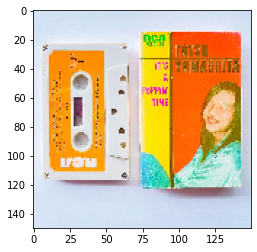

1/1 [==============================] - 0s 34ms/step
[[5.7857523e-08 5.3580536e-08 3.3114283e-25 2.0208863e-05 1.0434939e-34
  8.5392848e-22 7.7033781e-34 1.3879699e-25 6.5516047e-02 4.5658767e-19
  7.7057107e-09 7.1639099e-15 3.2674507e-08 1.7293392e-12 9.3446362e-01
  2.6760667e-32 3.2699203e-15 1.5660002e-31 8.2695561e-36 2.0849037e-23
  2.0891678e-26 8.1983294e-26 8.0777337e-24 1.9891265e-22 2.1133582e-34
  0.0000000e+00 3.8150456e-36 8.3789066e-16 1.7175007e-10 8.0400682e-18
  1.4000877e-12 6.1478276e-21 2.1963815e-10 1.5421921e-16 4.3919160e-19
  4.8655834e-26 5.5562562e-15 1.5889334e-30 1.1091878e-13 1.7166325e-14
  1.3911809e-27]]
Momoko Kikuchi - Adventure , 93.45
3.m45251919568_1.jpg: Momoko Kikuchi - Adventure
--------------------------------------------------------------
7.m17039467299_4.jpg


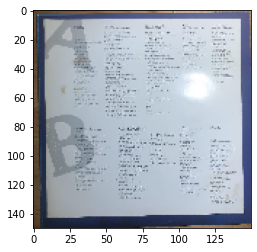

1/1 [==============================] - 0s 33ms/step
[[1.1983397e-07 1.5151351e-09 2.8903960e-06 1.1806701e-06 1.2079925e-06
  1.0894289e-02 1.7062148e-01 5.0299212e-07 6.5269525e-04 1.7959074e-09
  3.2281587e-08 6.1194121e-04 5.4925398e-08 3.2470991e-11 5.5021729e-07
  3.0148393e-03 4.3634813e-02 6.9764785e-05 3.0058302e-04 3.0551161e-07
  8.5062737e-08 6.1747363e-07 2.2135941e-06 6.8986624e-06 3.0353839e-02
  2.1907748e-05 6.6296666e-06 1.5425751e-08 4.5206013e-11 6.9426682e-07
  4.5107066e-04 3.5903834e-06 1.8852353e-02 1.4754690e-04 6.4862826e-10
  3.4627428e-05 4.9311220e-06 4.5564488e-07 3.8841108e-08 4.0092868e-08
  7.2030520e-01]]
東北新幹線 - Thru Traffic , 72.03
7.m17039467299_4.jpg: 東北新幹線 - Thru Traffic
--------------------------------------------------------------
3.m22184983384_1.jpg


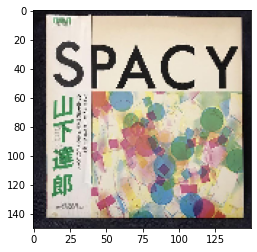

1/1 [==============================] - 0s 48ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.9986554e-37 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.7626695e-38 1.5727292e-37 4.3360739e-21 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  8.6216790e-26 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.0000000e+00 6.4673053e-24 4.0091726e-36 1.5631373e-27 0.0000000e+00
  0.0000000e+00]]
Tatsuro Yamashita - Spacy , 100.00
3.m22184983384_1.jpg: Tatsuro Yamashita - Spacy
--------------------------------------------------------------
1.m88299889385_1.jpg


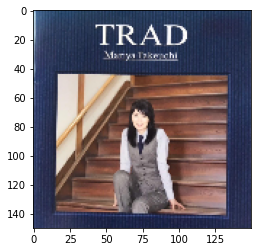

1/1 [==============================] - 0s 41ms/step
[[2.0827459e-25 4.6510196e-30 3.3944094e-30 8.3116336e-16 0.0000000e+00
  0.0000000e+00 0.0000000e+00 3.4935826e-36 2.2918908e-28 9.4157068e-28
  3.7040425e-16 1.0156237e-15 1.0000000e+00 7.8563896e-26 1.5062260e-37
  0.0000000e+00 2.5362869e-32 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 2.6875156e-37 4.0511993e-31 8.8254309e-33
  1.0557305e-31 0.0000000e+00 7.0200984e-28 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 2.0661461e-30 2.4291507e-17
  0.0000000e+00]]
Mariya Takeuchi - Trad = トラッド , 100.00
1.m88299889385_1.jpg: Mariya Takeuchi - Trad = トラッド
--------------------------------------------------------------
6.181205108.jpg


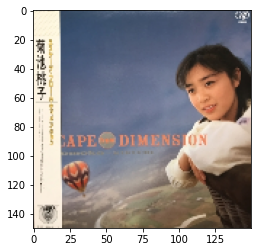

1/1 [==============================] - 0s 33ms/step
[[4.0903531e-16 4.5820463e-15 1.3910064e-05 1.7005233e-09 1.9205729e-08
  1.0404142e-04 1.6341576e-13 1.7860562e-13 2.2222453e-03 1.0052507e-19
  4.6218611e-15 1.2372114e-07 1.4652031e-11 7.0005313e-10 1.6612553e-15
  9.9442470e-01 6.5038847e-08 3.1928422e-03 3.9036274e-10 2.0142033e-22
  7.7212515e-13 6.1566202e-10 3.1430189e-10 2.7105102e-07 1.5627553e-08
  4.4777954e-13 1.3081439e-08 6.4477118e-11 4.8687628e-18 1.2896481e-11
  3.2808654e-09 1.2399487e-08 9.7822106e-10 2.0753030e-05 9.7211562e-12
  1.8399322e-05 1.0866354e-10 1.4493483e-08 1.8978869e-11 2.4462083e-06
  1.3410809e-07]]
Momoko Kikuchi - Escape From Dimension , 99.44
6.181205108.jpg: Momoko Kikuchi - Escape From Dimension
--------------------------------------------------------------
2.m24108902445_2.jpg


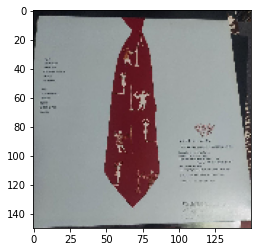

1/1 [==============================] - 0s 37ms/step
[[1.4134656e-14 1.0215149e-09 2.6824664e-02 1.8247747e-03 9.0359989e-20
  7.7222749e-11 5.7681065e-22 5.8467339e-07 8.2390690e-09 2.7013611e-04
  2.4021809e-01 1.8193072e-02 3.0036339e-05 4.0459710e-08 2.5306888e-14
  4.3086232e-15 7.7190272e-13 1.0958115e-11 8.0589414e-22 2.4248206e-10
  8.0941347e-03 1.5385823e-01 1.1717330e-04 7.5778911e-07 5.9543313e-17
  1.0192704e-21 3.3651623e-14 7.0265793e-09 4.4843336e-13 6.5280528e-13
  1.3413201e-03 1.4579928e-07 9.8660836e-13 3.1883345e-13 3.6519072e-11
  4.3412652e-02 6.1878539e-04 5.0516438e-01 1.9376354e-05 1.1604228e-05
  6.5224173e-16]]
Utada Hikaru - Deep River , 50.52
2.m24108902445_2.jpg: Utada Hikaru - Deep River
--------------------------------------------------------------
5.m56646435367_1.jpg


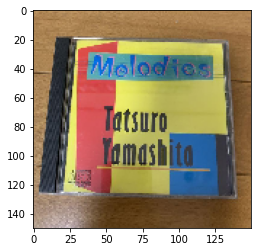

1/1 [==============================] - 0s 40ms/step
[[6.07215805e-11 4.69687767e-02 7.76348408e-09 9.47157681e-01
  7.23435843e-36 0.00000000e+00 0.00000000e+00 3.13273863e-23
  1.50238941e-06 1.08824496e-13 2.06586576e-14 1.47573495e-10
  4.75652451e-09 2.13956856e-11 2.57505660e-13 2.59199657e-29
  1.72009515e-13 1.51310680e-33 0.00000000e+00 0.00000000e+00
  3.02193333e-23 1.63348308e-18 5.18782245e-22 2.33435252e-28
  4.30342151e-27 0.00000000e+00 3.27705143e-30 2.85392421e-09
  8.66775228e-12 8.26351931e-10 2.11468631e-07 9.98790736e-27
  4.81145235e-10 1.17100797e-22 1.16137461e-18 8.51035978e-11
  5.44655467e-12 1.45262195e-19 5.87190641e-03 9.23096408e-12
  7.16925419e-27]]
Anri (2) - Wave , 94.72
5.m56646435367_1.jpg: Anri (2) - Wave
--------------------------------------------------------------
5.m33441902042_1.jpg


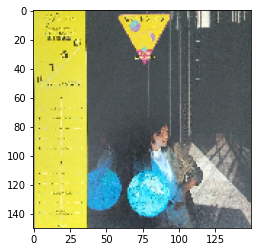

1/1 [==============================] - 0s 32ms/step
[[1.18534668e-32 1.56179584e-20 0.00000000e+00 3.88648250e-25
  0.00000000e+00 6.37652814e-21 2.54340355e-28 9.03928258e-38
  6.05676249e-20 8.79224262e-38 0.00000000e+00 2.87851001e-32
  3.11716416e-32 4.21559674e-19 1.75654691e-24 0.00000000e+00
  1.02567770e-28 0.00000000e+00 0.00000000e+00 2.76789471e-27
  3.72658195e-21 0.00000000e+00 0.00000000e+00 3.27945165e-21
  2.69604368e-33 0.00000000e+00 0.00000000e+00 1.72234354e-30
  5.85977556e-13 3.36684541e-33 1.00000000e+00 4.43625562e-38
  1.05548175e-22 0.00000000e+00 7.37521653e-26 8.53220359e-24
  3.39773633e-24 5.10973343e-34 7.15199575e-16 4.23251349e-35
  2.97818469e-27]]
Tatsuro Yamashita - Moonglow , 100.00
5.m33441902042_1.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
5.m38645278129_1.jpg


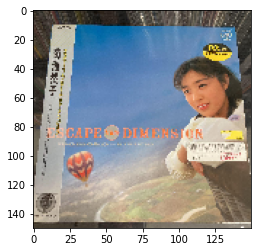

1/1 [==============================] - 0s 35ms/step
[[0.0000000e+00 0.0000000e+00 1.1085980e-11 8.3145490e-24 2.4839051e-15
  1.4647797e-14 1.5888745e-34 1.5506581e-36 1.0141587e-18 0.0000000e+00
  0.0000000e+00 5.5929577e-22 0.0000000e+00 3.8234948e-35 0.0000000e+00
  1.0000000e+00 1.2214053e-20 6.1123672e-15 2.7816218e-28 0.0000000e+00
  3.0597490e-28 7.8976214e-17 1.4979835e-18 2.6727829e-22 7.4315199e-21
  3.0282879e-31 1.1399959e-20 8.2815020e-24 0.0000000e+00 9.3770162e-31
  3.7611199e-26 3.6227781e-26 4.1935426e-34 1.7892793e-13 1.9242801e-31
  1.0893715e-13 2.5263738e-29 5.8355462e-18 3.9866390e-25 1.6292036e-21
  7.8058874e-30]]
Momoko Kikuchi - Escape From Dimension , 100.00
5.m38645278129_1.jpg: Momoko Kikuchi - Escape From Dimension
--------------------------------------------------------------
5.m85302009752_2.jpg


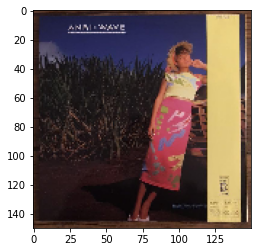

1/1 [==============================] - 0s 44ms/step
[[6.4017568e-13 2.4297370e-23 9.1497239e-20 9.9999642e-01 0.0000000e+00
  1.4293578e-27 0.0000000e+00 0.0000000e+00 3.6154845e-06 2.2248946e-30
  1.3808797e-28 1.1328952e-20 7.0087659e-25 4.1952594e-25 7.4112255e-13
  9.8958451e-29 1.4107784e-18 1.2707086e-30 0.0000000e+00 0.0000000e+00
  0.0000000e+00 8.2619737e-16 3.2065046e-28 6.2063117e-35 7.1300574e-34
  0.0000000e+00 0.0000000e+00 9.8432064e-15 7.4140720e-23 1.6462954e-23
  8.2334455e-14 3.0437927e-26 1.1159512e-30 4.7047527e-14 3.6257846e-23
  6.0676826e-19 8.8556431e-27 1.8992198e-27 2.5081499e-13 1.0373569e-20
  2.6451679e-34]]
Anri (2) - Wave , 100.00
5.m85302009752_2.jpg: Anri (2) - Wave
--------------------------------------------------------------
3.m67899962321_1.jpg


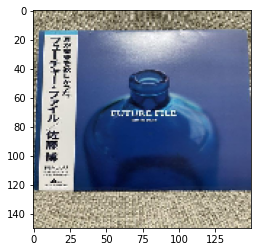

1/1 [==============================] - 0s 67ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 3.3370529e-33
  3.4993473e-12 1.0000000e+00 0.0000000e+00 4.4668196e-24 0.0000000e+00
  0.0000000e+00 2.1909597e-23 0.0000000e+00 0.0000000e+00 7.7059729e-38
  7.2411631e-23 1.5942079e-23 7.8520570e-23 4.8592714e-08 1.2409766e-26
  0.0000000e+00 5.0905622e-37 3.3566845e-28 0.0000000e+00 9.0108773e-16
  2.0805657e-29 7.4055938e-37 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.7639444e-19 0.0000000e+00 2.2904694e-14 1.1515349e-27 0.0000000e+00
  1.9047446e-23 3.7486379e-29 0.0000000e+00 0.0000000e+00 0.0000000e+00
  8.1029984e-14]]
Hiroshi Sato - Future File , 100.00
3.m67899962321_1.jpg: Hiroshi Sato - Future File
--------------------------------------------------------------
3.m15588363283_1.jpg


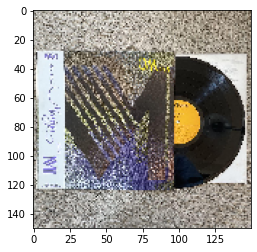

1/1 [==============================] - 0s 39ms/step
[[1.13116445e-19 4.88470213e-14 1.10211587e-07 8.81614497e-08
  6.64657914e-27 1.02596965e-17 0.00000000e+00 1.41943315e-13
  1.86760289e-07 7.03566849e-01 8.13368715e-08 4.04218950e-11
  4.50845429e-17 8.48876498e-14 8.76733852e-10 5.57956314e-35
  7.38947087e-26 1.33646114e-21 4.42225678e-28 2.81899480e-17
  3.67245757e-13 1.44715818e-06 1.45879127e-07 1.16994283e-14
  2.22857328e-30 1.23094462e-33 1.65256129e-25 2.18857181e-12
  1.24687885e-21 6.89703780e-11 2.96324462e-01 6.04828165e-05
  6.59965072e-23 9.48028006e-13 1.01322896e-15 2.16842277e-09
  3.81914615e-05 7.97071880e-06 2.15546553e-10 2.04049879e-08
  4.05131350e-37]]
Mariya Takeuchi - Love Songs , 70.36
3.m15588363283_1.jpg: Mariya Takeuchi - Love Songs
--------------------------------------------------------------
1.m43303091319_1.jpg


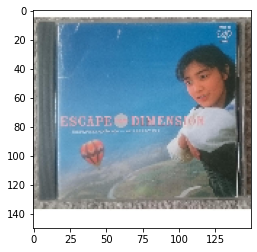

1/1 [==============================] - 0s 45ms/step
[[0.00000000e+00 0.00000000e+00 1.51646400e-16 7.41377399e-34
  6.58275128e-15 5.94591641e-20 0.00000000e+00 0.00000000e+00
  1.64081913e-26 0.00000000e+00 0.00000000e+00 3.16225871e-31
  0.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
  1.03827134e-27 9.26300228e-23 2.30925033e-35 0.00000000e+00
  0.00000000e+00 5.99708007e-27 6.04015807e-25 1.14304844e-35
  5.00296156e-32 3.45899795e-36 2.17309025e-29 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 1.36443364e-19 0.00000000e+00 1.37326459e-25
  0.00000000e+00 2.66312984e-33 1.46181732e-38 8.77017240e-37
  1.70856252e-37]]
Momoko Kikuchi - Escape From Dimension , 100.00
1.m43303091319_1.jpg: Momoko Kikuchi - Escape From Dimension
--------------------------------------------------------------
3.m54536359205_1.jpg


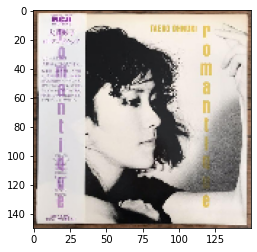

1/1 [==============================] - 0s 33ms/step
[[0.0000000e+00 0.0000000e+00 1.8081398e-26 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 1.1781208e-24 0.0000000e+00 0.0000000e+00
  5.6455877e-35 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  9.6747713e-34 7.9335681e-36 1.0000000e+00 7.9640543e-33 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.0320752e-28 0.0000000e+00 7.2009253e-36 2.6611279e-19 0.0000000e+00
  9.4727442e-34 3.4300052e-25 5.2620885e-34 0.0000000e+00 0.0000000e+00
  0.0000000e+00]]
Taeko Ohnuki - Romantique , 100.00
3.m54536359205_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
5.m39831465134_1.jpg


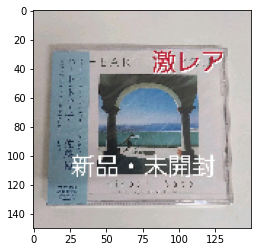

1/1 [==============================] - 0s 37ms/step
[[5.32341138e-25 1.89440308e-17 1.64888155e-12 3.71032712e-21
  1.95920103e-12 9.73780751e-01 1.25859219e-12 8.83959638e-06
  5.58123148e-09 1.16181684e-18 6.25752054e-12 2.66100618e-12
  1.92536545e-18 4.44136816e-09 1.53361753e-27 3.38546466e-04
  2.64882932e-22 2.52160728e-02 4.56516318e-05 9.57063026e-20
  2.28001173e-08 1.31748386e-13 5.20405476e-04 3.50079936e-05
  2.87263702e-13 2.33483474e-18 4.82225548e-09 2.66035462e-21
  3.35552304e-19 1.13206747e-17 5.88095961e-10 2.53990976e-07
  1.68753932e-12 5.60136959e-06 4.48188492e-12 1.05613850e-07
  4.54658616e-10 4.52252316e-05 6.27618414e-14 3.45778858e-06
  1.22987935e-17]]
Hiroshi Sato - Awakening , 97.38
5.m39831465134_1.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
2.m91940822397_1.jpg


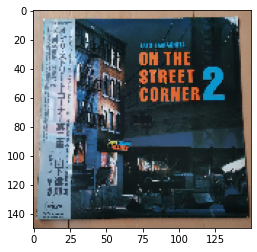

1/1 [==============================] - 0s 38ms/step
[[2.9286616e-32 9.4073904e-10 9.3616833e-08 1.7583263e-13 2.4409975e-29
  1.0970924e-06 1.1742092e-22 1.6701450e-04 1.7623518e-02 1.9520954e-22
  5.3091678e-19 3.8025137e-23 5.2682562e-18 9.2554030e-16 6.0580534e-13
  9.7058592e-26 3.6418178e-17 7.9277466e-05 7.6454929e-19 1.3794749e-26
  1.1126999e-13 4.1279632e-10 4.7667022e-04 5.0840246e-13 2.7694043e-12
  5.4362210e-23 1.7583655e-14 2.5790582e-25 2.5718497e-23 3.0578573e-21
  1.8591852e-03 4.7364566e-09 9.7321206e-01 3.3845664e-09 1.6360838e-15
  6.5722391e-03 8.8565785e-06 1.6953677e-09 7.5995258e-18 9.3536133e-16
  1.7190240e-20]]
Tatsuro Yamashita - On The Street Corner 2 , 97.32
2.m91940822397_1.jpg: Tatsuro Yamashita - On The Street Corner 2
--------------------------------------------------------------
2.m90558147170_1.jpg


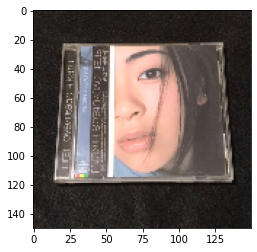

1/1 [==============================] - 0s 36ms/step
[[5.2528631e-21 7.2450364e-01 5.5530794e-15 4.6427811e-15 5.7902331e-31
  1.3818524e-10 6.2781444e-24 3.4840338e-04 1.2499541e-01 9.6085755e-19
  9.4692588e-02 1.0468791e-19 5.6132827e-17 2.4202310e-14 3.8692719e-15
  5.9900728e-25 2.1362339e-25 1.0662653e-19 6.5749362e-20 1.3318994e-24
  3.5432436e-07 2.6661204e-11 8.8346645e-04 3.6122641e-12 1.6769904e-27
  4.7012077e-35 1.7453364e-29 7.0491674e-28 4.2733303e-15 1.8545195e-18
  1.8767055e-07 4.3615858e-09 5.4575209e-02 1.4907036e-13 3.4481224e-12
  2.0838677e-18 6.7668662e-07 1.0619991e-11 3.5752883e-21 5.4965540e-08
  1.1553297e-33]]
Anri (2) - Coool , 72.45
2.m90558147170_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
5.m45157180784_1.jpg


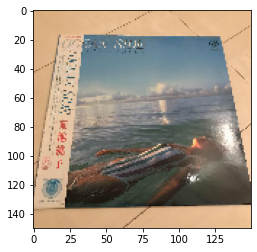

1/1 [==============================] - 0s 30ms/step
[[2.9049761e-15 7.9177025e-19 9.9571924e-09 5.0694151e-05 3.3177376e-12
  5.4303551e-01 3.9345482e-16 5.6967076e-20 5.0209522e-02 2.6902422e-23
  6.8219597e-15 5.0512281e-06 1.1094834e-20 1.9199321e-12 7.5494030e-16
  6.8676530e-04 1.0400707e-09 1.8014099e-11 3.7472020e-17 6.2548560e-16
  2.0888093e-13 3.0619558e-09 2.0179078e-10 5.6310229e-10 1.6406521e-12
  3.9265598e-22 3.3050388e-18 1.5137343e-07 1.5558643e-16 6.5106027e-15
  6.4995004e-07 7.8962097e-12 2.0726025e-12 4.0460175e-01 2.8761747e-15
  1.2254332e-08 2.3094046e-12 5.0447480e-10 7.4143664e-08 1.4097585e-03
  2.1889959e-12]]
Hiroshi Sato - Awakening , 54.30
5.m45157180784_1.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
3.m82935382292_5.jpg


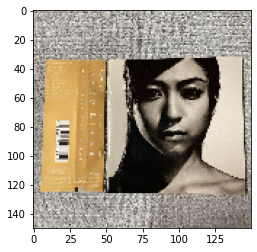

1/1 [==============================] - 0s 40ms/step
[[7.0086374e-38 4.4288034e-36 7.2833961e-12 6.4362587e-20 0.0000000e+00
  7.3144149e-34 0.0000000e+00 2.4291960e-18 1.4426344e-29 9.6626878e-03
  5.6462340e-20 2.1207801e-10 1.1387398e-20 2.3668202e-19 0.0000000e+00
  0.0000000e+00 0.0000000e+00 2.6916729e-28 0.0000000e+00 2.1119243e-32
  3.3048458e-13 4.4182165e-09 7.4149701e-17 5.5698332e-23 0.0000000e+00
  0.0000000e+00 9.5805052e-32 1.8896815e-18 0.0000000e+00 9.4081302e-28
  9.3463241e-12 3.4273656e-16 0.0000000e+00 3.2343273e-29 1.2146532e-29
  1.1917696e-03 1.3593624e-20 9.8914552e-01 3.6286221e-22 5.7499286e-15
  0.0000000e+00]]
Utada Hikaru - Deep River , 98.91
3.m82935382292_5.jpg: Utada Hikaru - Deep River
--------------------------------------------------------------
4.m17039467299_5.jpg


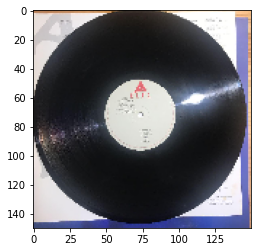

1/1 [==============================] - 0s 34ms/step
[[1.58181230e-25 1.89631838e-10 4.70084749e-04 8.37517902e-12
  3.59012050e-32 1.39569354e-11 1.62165901e-27 1.26385214e-02
  3.56540530e-09 6.45633061e-11 3.19738407e-03 3.91728547e-14
  5.34997463e-11 2.87166298e-12 7.49927032e-21 1.34602226e-22
  4.73701439e-18 2.32508999e-13 1.62016946e-26 2.44223511e-23
  7.73899446e-05 1.22229189e-11 1.92624575e-04 3.10070583e-08
  2.86972905e-24 6.23897961e-33 5.97712077e-19 1.08337323e-20
  3.64523648e-18 1.58955082e-15 9.72065926e-01 2.20165501e-04
  1.12325718e-10 4.68237374e-13 2.72017908e-16 2.79876411e-09
  3.12152872e-04 1.08257141e-02 1.08167620e-12 1.63870126e-08
  2.55706832e-16]]
Tatsuro Yamashita - Moonglow , 97.21
4.m17039467299_5.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
5.m70381324119_1.jpg


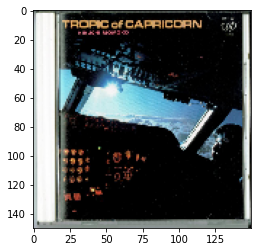

1/1 [==============================] - 0s 37ms/step
[[0.00000000e+00 0.00000000e+00 1.10413737e-29 0.00000000e+00
  0.00000000e+00 3.40960203e-25 0.00000000e+00 2.11605639e-29
  8.19593239e-37 0.00000000e+00 0.00000000e+00 1.19662961e-36
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 1.81317842e-15 0.00000000e+00 0.00000000e+00
  2.47874721e-37 0.00000000e+00 0.00000000e+00 8.32070667e-31
  0.00000000e+00 0.00000000e+00 5.09741746e-31 0.00000000e+00
  0.00000000e+00 1.10156264e-29 3.58790818e-29 1.00000000e+00
  0.00000000e+00 4.35586430e-23 0.00000000e+00 1.32047891e-33
  0.00000000e+00 1.23027438e-15 0.00000000e+00 6.89433906e-18
  0.00000000e+00]]
Tatsuro Yamashita - On The Street Corner , 100.00
5.m70381324119_1.jpg: Tatsuro Yamashita - On The Street Corner
--------------------------------------------------------------
6.m59215775836_2.jpg


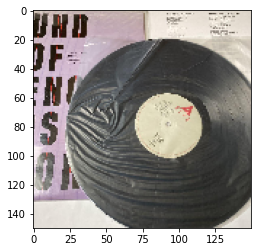

1/1 [==============================] - 0s 38ms/step
[[1.37200557e-16 9.93851418e-17 1.41815133e-02 1.08082601e-08
  3.14613075e-14 4.55711330e-10 8.90005807e-18 8.95018193e-09
  6.51104387e-12 1.32582218e-05 3.44925252e-06 6.10605014e-07
  1.51357335e-05 2.92554915e-07 1.07952250e-18 4.31907620e-06
  3.47586043e-10 3.86387061e-10 1.54518300e-18 2.26522894e-19
  1.24384008e-01 3.65974667e-10 1.17594023e-09 1.42677709e-01
  1.19492431e-15 3.02863517e-18 9.68904332e-11 3.81426918e-10
  1.70777766e-13 6.78140766e-10 1.74642817e-04 6.85810662e-08
  3.89137127e-16 1.99676300e-12 1.54102002e-12 6.63537905e-03
  1.07910921e-06 7.11904228e-01 4.21319464e-06 1.60972661e-07
  1.35838545e-11]]
Utada Hikaru - Deep River , 71.19
6.m59215775836_2.jpg: Utada Hikaru - Deep River
--------------------------------------------------------------
3.m83034804829_1.jpg


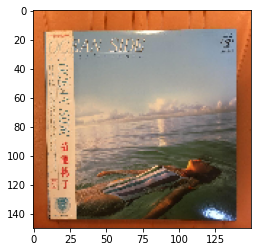

1/1 [==============================] - 0s 30ms/step
[[1.52513335e-10 2.50262000e-14 5.80921596e-11 3.20675485e-06
  6.29315784e-18 2.00866512e-03 1.46578253e-19 3.47537205e-18
  6.79066638e-03 1.25026205e-14 7.15653422e-18 4.89857164e-04
  1.52311947e-13 6.64092440e-05 1.38861523e-14 1.58774539e-11
  1.97869247e-15 3.16079536e-08 1.12755174e-19 8.75020081e-16
  1.06890882e-13 5.62853747e-05 5.73505436e-12 6.59801077e-12
  6.89827345e-07 1.66372895e-24 8.55111855e-17 4.68596809e-05
  1.63507879e-13 2.18988667e-08 8.37281585e-01 5.00207307e-07
  9.78638680e-16 8.18945846e-05 1.22376025e-06 5.81730856e-04
  2.71292580e-12 4.53327993e-05 1.01217047e-07 1.52544886e-01
  8.77814654e-17]]
Tatsuro Yamashita - Moonglow , 83.73
3.m83034804829_1.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
3.161399666.jpg


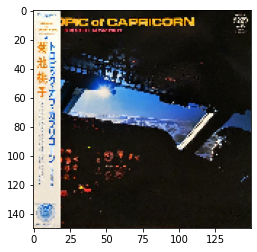

1/1 [==============================] - 0s 34ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  2.0665550e-16 0.0000000e+00 5.9304901e-35 2.5071208e-32 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 5.4400287e-27 0.0000000e+00
  1.8672666e-26 0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 4.7447119e-28 0.0000000e+00
  0.0000000e+00 3.1078684e-24 0.0000000e+00 0.0000000e+00 0.0000000e+00
  2.2458818e-28 4.4871012e-12 0.0000000e+00 1.5886958e-30 1.3443411e-34
  1.6136945e-24 0.0000000e+00 8.8053352e-15 0.0000000e+00 1.6535522e-15
  0.0000000e+00]]
Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線 , 100.00
3.161399666.jpg: Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線
--------------------------------------------------------------
7.m24108902445_2.jpg


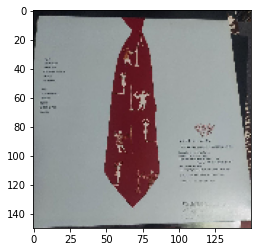

1/1 [==============================] - 0s 36ms/step
[[1.4134656e-14 1.0215149e-09 2.6824664e-02 1.8247747e-03 9.0359989e-20
  7.7222749e-11 5.7681065e-22 5.8467339e-07 8.2390690e-09 2.7013611e-04
  2.4021809e-01 1.8193072e-02 3.0036339e-05 4.0459710e-08 2.5306888e-14
  4.3086232e-15 7.7190272e-13 1.0958115e-11 8.0589414e-22 2.4248206e-10
  8.0941347e-03 1.5385823e-01 1.1717330e-04 7.5778911e-07 5.9543313e-17
  1.0192704e-21 3.3651623e-14 7.0265793e-09 4.4843336e-13 6.5280528e-13
  1.3413201e-03 1.4579928e-07 9.8660836e-13 3.1883345e-13 3.6519072e-11
  4.3412652e-02 6.1878539e-04 5.0516438e-01 1.9376354e-05 1.1604228e-05
  6.5224173e-16]]
Utada Hikaru - Deep River , 50.52
7.m24108902445_2.jpg: Utada Hikaru - Deep River
--------------------------------------------------------------
5.m80385441872_1.jpg


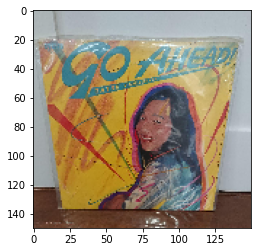

1/1 [==============================] - 0s 35ms/step
[[1.3527638e-04 2.7492354e-04 4.5320900e-05 1.6022339e-01 1.4093839e-12
  1.7101736e-14 8.0449258e-14 5.0172462e-14 1.3015978e-04 2.7896307e-08
  5.3714488e-10 8.8947136e-06 1.3814205e-08 1.0355399e-09 1.0063485e-06
  1.7035767e-08 3.1048618e-05 3.6465447e-10 3.2150221e-17 1.8058253e-17
  7.6984025e-13 9.8004634e-04 1.7311898e-08 4.1592732e-12 7.5672174e-10
  5.0414117e-17 5.7969588e-12 5.1869592e-04 5.0523880e-07 1.3220130e-06
  1.5296540e-05 3.6542575e-11 1.4611308e-09 2.4538227e-09 5.3179531e-07
  1.8845325e-03 3.2779433e-05 9.1875165e-08 8.3571619e-01 9.8072483e-10
  8.2363109e-12]]
Utada Hikaru - First Love , 83.57
5.m80385441872_1.jpg: Utada Hikaru - First Love
--------------------------------------------------------------
4.m26092923537_3.jpg


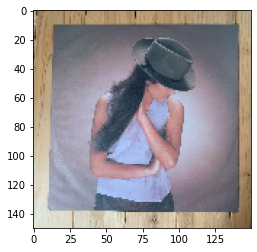

1/1 [==============================] - 0s 30ms/step
[[1.95615694e-11 3.00082191e-14 1.88771637e-11 2.38877229e-09
  1.12738016e-05 9.97416258e-01 8.27367330e-07 6.23089025e-10
  3.48937974e-05 1.31000810e-09 5.01690192e-05 9.00924148e-04
  3.00936706e-11 1.62103326e-08 5.17389647e-12 2.74661147e-07
  2.36119648e-11 3.54197716e-09 1.14442912e-04 9.98434960e-04
  2.59149203e-07 1.53881179e-11 7.31997396e-09 9.53015387e-07
  1.17143916e-11 3.85493548e-09 1.09116285e-10 5.83169402e-10
  1.04043253e-10 2.61441259e-12 3.57019826e-06 4.27182678e-10
  2.94032844e-07 9.84693145e-08 6.47789168e-13 5.01982100e-09
  4.13147291e-07 1.94854564e-07 4.67168229e-06 4.61985008e-04
  4.99439545e-10]]
Hiroshi Sato - Awakening , 99.74
4.m26092923537_3.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
5.m95535196361_2.jpg


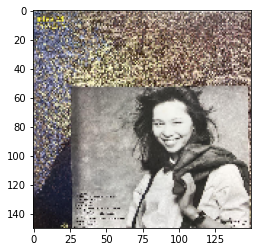

1/1 [==============================] - 0s 39ms/step
[[7.5551151e-14 9.9359312e-19 7.6519133e-04 7.1767755e-07 5.4055242e-23
  3.0288246e-16 1.5515640e-24 3.5324614e-08 2.2607212e-10 3.0821219e-01
  2.5938526e-03 7.0857747e-16 4.7854689e-15 2.8259705e-20 1.6912614e-07
  7.6931303e-21 5.5739830e-17 6.4548304e-21 2.3534409e-23 5.8393075e-11
  2.6358764e-14 5.7237692e-10 6.5699154e-01 1.5921326e-15 5.7655818e-21
  2.9698772e-25 3.5741423e-23 1.0655574e-10 6.5599032e-22 7.7037476e-13
  1.1634534e-06 1.2255552e-07 4.0829657e-12 3.1402521e-02 2.4792837e-20
  4.0615391e-18 3.2473727e-05 2.2177383e-11 3.6815609e-19 3.5200036e-09
  2.7397088e-24]]
Taeko Ohnuki - Romantique , 65.70
5.m95535196361_2.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
5.m77856892163_1.jpg


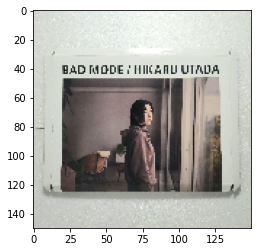

1/1 [==============================] - 0s 49ms/step
[[8.68862761e-22 3.25932146e-23 6.35326385e-01 1.55934710e-09
  6.90435935e-14 7.90722468e-14 1.27370931e-21 1.58699026e-04
  1.31436948e-17 3.60782504e-01 1.65725200e-04 1.71854396e-16
  4.12778725e-13 3.24640723e-21 2.72718751e-13 1.32526887e-18
  1.00906224e-17 1.85161361e-18 1.11222705e-18 2.63532511e-05
  7.97426594e-07 9.25761984e-12 3.52371531e-03 1.39132011e-10
  2.26014242e-20 6.04463184e-18 3.26171212e-14 5.23914908e-15
  9.41385081e-27 4.23609918e-14 3.20296152e-07 6.44025658e-06
  1.31850874e-15 1.11288421e-06 1.39506235e-24 4.37745383e-16
  8.66457299e-07 7.09687356e-06 7.66185770e-17 3.16836862e-10
  7.23278246e-21]]
Anri (2) - Timely!! , 63.53
5.m77856892163_1.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
7.m42927500800_3.jpg


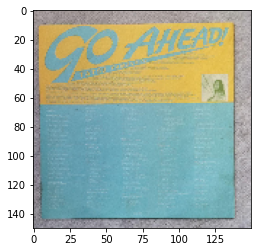

1/1 [==============================] - 0s 32ms/step
[[4.9569733e-32 4.7814172e-28 0.0000000e+00 8.1885308e-37 6.9322362e-19
  9.8010159e-01 1.5759776e-09 4.7769683e-28 4.0209389e-13 3.6616855e-32
  1.3024747e-18 1.1112187e-16 1.6108659e-32 3.5109313e-18 2.4001343e-27
  9.4791287e-23 5.6580745e-35 1.4033803e-21 1.9898370e-02 7.6957819e-16
  1.0043673e-21 5.4182845e-35 6.7136339e-24 8.5989900e-18 8.3917490e-27
  1.5219849e-20 4.6908458e-30 1.3829182e-31 9.4340439e-29 6.8820530e-31
  1.4046563e-19 1.9573654e-33 5.6292765e-10 1.2442642e-23 1.1276749e-26
  3.0193279e-23 2.8993970e-16 1.2433235e-25 6.7654636e-24 3.5757694e-18
  1.2113607e-34]]
Hiroshi Sato - Awakening , 98.01
7.m42927500800_3.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
2.m52637126854_3.jpg


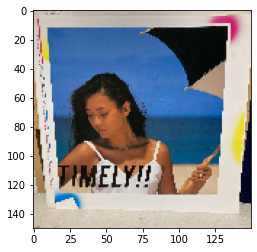

1/1 [==============================] - 0s 43ms/step
[[0.0000000e+00 1.3790726e-34 1.0552453e-02 1.5545414e-28 6.2965152e-27
  1.6291571e-14 0.0000000e+00 1.1817128e-28 6.4291877e-18 0.0000000e+00
  0.0000000e+00 9.5198997e-33 0.0000000e+00 1.5286905e-35 0.0000000e+00
  9.8944587e-01 6.1942292e-23 1.1468547e-06 7.8039233e-34 0.0000000e+00
  4.0727623e-16 8.7984270e-10 1.4413409e-12 3.0181702e-15 1.1756761e-25
  0.0000000e+00 1.7020768e-19 2.8695208e-36 0.0000000e+00 5.4492212e-27
  3.5975509e-14 3.4282372e-08 1.2348624e-36 4.3135445e-15 2.3474947e-25
  2.5995319e-09 1.1814514e-28 5.1578547e-07 3.4354988e-18 3.3034080e-18
  8.6415446e-28]]
Momoko Kikuchi - Escape From Dimension , 98.94
2.m52637126854_3.jpg: Momoko Kikuchi - Escape From Dimension
--------------------------------------------------------------
5.m32686553614_1.jpg


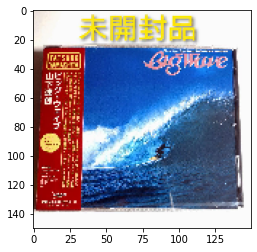

1/1 [==============================] - 0s 46ms/step
[[0.0000000e+00 2.1389571e-38 6.1285687e-38 2.7914199e-37 1.8083617e-32
  6.2182716e-07 1.5902438e-05 2.4286217e-25 8.9028300e-18 2.2598440e-38
  0.0000000e+00 6.0291949e-19 3.6473149e-37 0.0000000e+00 1.0991630e-34
  2.2738034e-28 2.8760427e-23 3.1836108e-15 1.4121468e-05 2.7767516e-23
  8.2583494e-23 4.5251422e-34 4.8486183e-29 2.2332855e-16 9.9996936e-01
  1.1844142e-19 8.3106015e-20 0.0000000e+00 0.0000000e+00 3.6294660e-22
  2.9721464e-12 9.7426333e-16 5.7163879e-12 4.0379754e-24 0.0000000e+00
  6.1962529e-21 1.9455243e-29 4.5931787e-26 0.0000000e+00 2.5039664e-32
  1.1237679e-16]]
Tatsuro Yamashita - Big Wave = ビッグウェイブ , 100.00
5.m32686553614_1.jpg: Tatsuro Yamashita - Big Wave = ビッグウェイブ
--------------------------------------------------------------
4.m21284341854_2.jpg


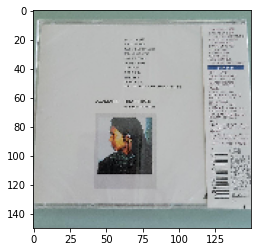

1/1 [==============================] - 0s 33ms/step
[[2.9709245e-04 5.4214522e-03 1.7068622e-01 2.0209135e-02 1.3642311e-04
  8.6091495e-05 1.6283871e-05 8.4697552e-02 1.1116870e-02 1.8596377e-02
  1.5394475e-01 2.7603994e-03 2.7738926e-01 4.4121998e-04 2.5811666e-04
  3.2588420e-04 5.7142228e-03 9.8319305e-04 1.0462127e-05 2.8679449e-05
  1.2014931e-03 7.8808611e-05 1.5403541e-03 2.7662155e-04 2.4557166e-04
  8.7205066e-05 6.4061903e-03 1.5442923e-04 1.4691120e-04 8.0617787e-03
  3.1239925e-02 4.6063226e-02 3.3318963e-02 1.0953424e-03 3.3593751e-05
  6.7005814e-05 2.9488450e-02 6.2828921e-03 2.7685354e-03 6.8052694e-02
  1.0270285e-02]]
Mariya Takeuchi - Trad = トラッド , 27.74
4.m21284341854_2.jpg: Mariya Takeuchi - Trad = トラッド
--------------------------------------------------------------
7.m95347080549_1.jpg


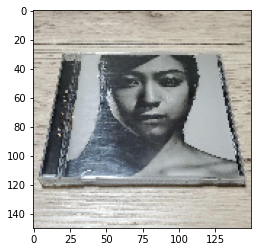

1/1 [==============================] - 0s 36ms/step
[[5.9278929e-20 1.3068202e-17 9.0088406e-08 2.2943417e-13 3.5257755e-18
  4.5891699e-08 5.2115843e-14 1.7547347e-11 1.6514458e-10 9.0903895e-06
  7.5678727e-06 3.0468625e-10 3.2123573e-21 7.8319823e-17 7.0572284e-08
  9.5323275e-15 7.2921778e-14 6.0077421e-16 5.0762996e-12 1.3248149e-09
  1.1282559e-11 3.1612300e-12 5.4486584e-02 7.3176348e-10 1.8246620e-16
  9.3548263e-18 6.5463851e-18 5.0415194e-14 3.3782722e-18 1.2698265e-16
  1.5662978e-06 2.0150860e-14 3.5281063e-09 7.2627714e-05 7.0720410e-18
  1.4233966e-06 9.4542098e-01 9.6929548e-11 8.8280327e-10 1.6900047e-15
  1.3296106e-15]]
Utada Hikaru - Badモード , 94.54
7.m95347080549_1.jpg: Utada Hikaru - Badモード
--------------------------------------------------------------
1.m95535196361_1.jpg


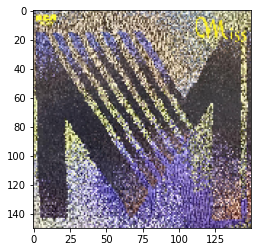

1/1 [==============================] - 0s 35ms/step
[[1.7142407e-34 3.2846973e-24 7.8980869e-05 3.8865164e-18 3.4417239e-27
  3.0913230e-14 1.3606241e-36 2.9060591e-02 5.4486356e-19 1.8839014e-06
  2.5528937e-04 6.6158787e-11 6.0692784e-14 2.7545101e-20 1.2061150e-33
  2.6867539e-27 3.2682710e-33 1.6779795e-16 1.3956419e-26 5.9808752e-17
  5.3925317e-04 2.9349638e-07 1.2428870e-08 1.6962653e-14 9.9824814e-31
  2.2121506e-31 9.2453379e-21 3.5754717e-26 9.8644400e-33 7.3081313e-24
  2.9497200e-11 8.2568895e-06 8.8029361e-21 3.6178856e-23 1.1742765e-25
  1.6465043e-12 2.1270183e-13 9.7004831e-01 3.1151975e-23 7.1495051e-06
  1.0356520e-31]]
Utada Hikaru - Deep River , 97.00
1.m95535196361_1.jpg: Utada Hikaru - Deep River
--------------------------------------------------------------
6.m34800885170_3.jpg


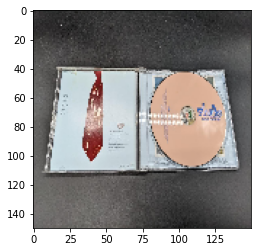

1/1 [==============================] - 0s 38ms/step
[[3.2011199e-11 8.8837991e-12 2.3170164e-06 2.2199442e-08 1.0121585e-05
  7.2614220e-03 2.3462254e-13 1.6027807e-03 6.9964335e-05 5.5209114e-07
  3.3195915e-03 1.2954268e-06 1.7767999e-09 3.7049213e-09 5.6366180e-13
  1.8070523e-07 2.5536026e-14 2.3623672e-07 2.3525031e-06 1.0362767e-07
  1.2841390e-04 1.4326349e-07 4.8049889e-05 1.0882943e-06 3.2252916e-11
  1.3561076e-10 2.0642094e-08 1.1508997e-11 6.4241749e-15 4.7974213e-10
  1.2576817e-07 2.1258144e-04 3.7632901e-07 2.8148688e-06 3.7115779e-12
  4.2988450e-11 2.5645244e-08 5.7284610e-04 1.6321174e-12 9.8676258e-01
  3.5559348e-16]]
Various - Classic Jazz-Funk Mastercuts Volume 7 , 98.68
6.m34800885170_3.jpg: Various - Classic Jazz-Funk Mastercuts Volume 7
--------------------------------------------------------------
4.m95731390551_1.jpg


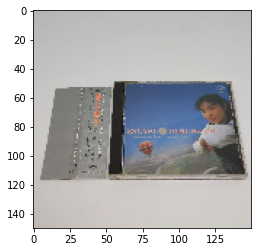

1/1 [==============================] - 0s 39ms/step
[[4.4927927e-19 4.6874858e-14 2.8513738e-11 4.9313802e-17 4.6075557e-11
  2.5750396e-01 1.5869221e-08 9.8748276e-10 1.4329600e-05 8.1559167e-16
  2.3547371e-11 4.4120895e-07 1.4330048e-13 1.2861726e-07 2.3111557e-20
  6.6987729e-01 3.5344302e-13 7.0977554e-02 1.1328785e-03 5.6349720e-17
  1.9283439e-10 4.6889242e-11 4.7904376e-07 1.1041291e-06 1.3081325e-09
  1.7853890e-15 9.8565711e-11 2.3947090e-14 1.6715323e-16 5.3225382e-11
  2.7806644e-07 1.3886633e-05 2.2757713e-09 1.5261296e-04 1.8176323e-08
  4.5239960e-07 8.0439050e-10 3.7045126e-08 4.6013681e-13 3.2449406e-04
  3.3723116e-10]]
Momoko Kikuchi - Escape From Dimension , 66.99
4.m95731390551_1.jpg: Momoko Kikuchi - Escape From Dimension
--------------------------------------------------------------
7.e5_a4_a7_e8_b2_ab_e5_a6_99_e5_ad_90-taeko-ohnuki-grey-skies_600x600_crop_center.jpg


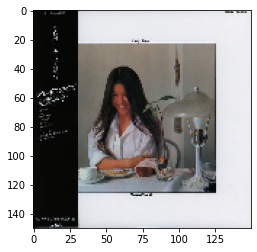

1/1 [==============================] - 0s 44ms/step
[[0.00000000e+00 0.00000000e+00 8.40390038e-16 9.62336412e-31
  2.40939370e-38 2.27369049e-21 1.38408407e-38 3.60590819e-15
  2.89389612e-36 1.37689518e-24 4.81593129e-16 1.06337526e-28
  7.54739144e-30 1.41292336e-38 0.00000000e+00 7.16532531e-30
  4.90457009e-31 0.00000000e+00 2.44689873e-37 2.29547307e-25
  1.00000000e+00 1.12460105e-29 8.00730982e-26 1.27231037e-09
  0.00000000e+00 0.00000000e+00 1.79149690e-34 0.00000000e+00
  0.00000000e+00 6.87399563e-38 9.43544891e-20 1.10720397e-21
  5.88487003e-30 0.00000000e+00 0.00000000e+00 1.88043821e-21
  2.75038627e-23 1.36997011e-11 4.44114579e-32 3.10426711e-31
  4.89281264e-25]]
Taeko Ohnuki - Grey Skies , 100.00
7.e5_a4_a7_e8_b2_ab_e5_a6_99_e5_ad_90-taeko-ohnuki-grey-skies_600x600_crop_center.jpg: Taeko Ohnuki - Grey Skies
--------------------------------------------------------------
5.m78902672503_1.jpg


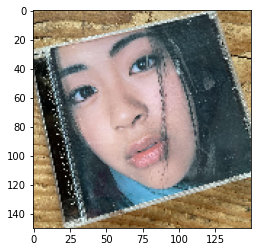

1/1 [==============================] - 0s 33ms/step
[[1.0436921e-30 6.8084598e-21 7.0244297e-19 5.4644994e-19 0.0000000e+00
  9.0751116e-04 1.4701871e-14 3.9120994e-12 3.5321615e-10 9.8578694e-24
  1.7768617e-10 7.0200117e-11 1.0248947e-18 7.2656858e-17 1.2382882e-26
  1.6973738e-13 3.4097459e-13 1.8189469e-21 7.6755676e-22 1.2323841e-25
  5.7261484e-03 8.2373310e-27 6.2845572e-21 9.4928527e-01 1.9668217e-25
  1.1017678e-34 1.5788104e-28 1.1565671e-30 2.3881246e-22 2.7683502e-22
  1.6939461e-05 3.4123725e-14 4.5544809e-07 3.5771702e-23 2.0442260e-26
  4.6388338e-09 4.5150580e-14 1.0482365e-08 2.8467398e-16 5.6616063e-18
  4.4063654e-02]]
Taeko Ohnuki - Sunshower , 94.93
5.m78902672503_1.jpg: Taeko Ohnuki - Sunshower
--------------------------------------------------------------
2.m29179180415_6.jpg


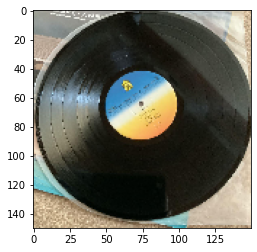

1/1 [==============================] - 0s 32ms/step
[[9.52222715e-22 1.39086187e-20 4.13978256e-08 5.15357312e-09
  1.73996441e-29 1.26451348e-17 4.02178586e-34 2.17360007e-19
  3.04650863e-13 2.17051293e-16 4.81151989e-19 2.54541647e-19
  1.87314733e-10 1.27447686e-14 1.08796174e-29 1.60690282e-15
  1.06011940e-21 3.03056879e-07 8.71446022e-35 1.76439373e-37
  4.70593386e-09 1.24264870e-05 2.60438589e-13 2.39219631e-08
  2.09210448e-24 4.04768312e-37 4.25840467e-16 5.77857788e-17
  8.37201453e-21 2.39384663e-17 1.53093645e-03 1.12306497e-10
  9.27444430e-27 2.29879688e-24 1.14213534e-10 5.53490818e-01
  1.47095552e-12 4.44962978e-01 2.51478014e-06 2.38826678e-15
  6.51773101e-25]]
Tatsuro Yamashita - Spacy , 55.35
2.m29179180415_6.jpg: Tatsuro Yamashita - Spacy
--------------------------------------------------------------
1.m75849161538_1.jpg


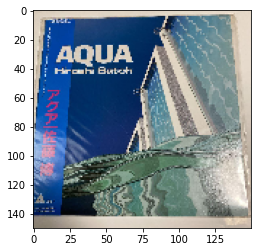

1/1 [==============================] - 0s 56ms/step
[[0.0000000e+00 0.0000000e+00 6.7549391e-12 1.0626967e-23 9.9721515e-01
  2.2104172e-13 2.3733346e-22 8.7748848e-23 6.0617393e-25 7.3459366e-24
  3.9969200e-16 6.5812436e-15 7.1609646e-34 0.0000000e+00 0.0000000e+00
  4.1196625e-15 8.3408300e-29 5.3186524e-20 3.3550511e-06 8.3374537e-15
  1.3271076e-09 6.1761703e-21 1.0457364e-19 5.7594079e-16 9.6403410e-23
  2.7815453e-03 1.2421770e-11 1.0114674e-37 0.0000000e+00 3.1454997e-38
  1.4061117e-29 5.7821660e-25 2.3965081e-28 9.9122597e-32 0.0000000e+00
  3.1543377e-19 2.5360046e-18 4.2281643e-16 1.9758778e-19 2.7356515e-24
  2.8163354e-26]]
Hiroshi Sato - Aqua , 99.72
1.m75849161538_1.jpg: Hiroshi Sato - Aqua
--------------------------------------------------------------
2.m26325528778_1.jpg


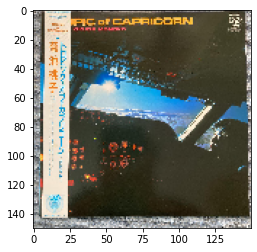

1/1 [==============================] - 0s 34ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  6.0254553e-24 0.0000000e+00 0.0000000e+00 4.2274589e-22 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  7.5706065e-22 0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 1.9717330e-38 1.4670573e-38 7.3253008e-35
  0.0000000e+00 1.5170978e-27 0.0000000e+00 0.0000000e+00 0.0000000e+00
  6.6030960e-38 2.1569995e-31 0.0000000e+00 3.1083592e-21 0.0000000e+00
  5.7079517e-21 0.0000000e+00 1.4582590e-37 0.0000000e+00 2.2501113e-34
  0.0000000e+00]]
Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線 , 100.00
2.m26325528778_1.jpg: Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線
--------------------------------------------------------------
7.m29149120832_1.jpg


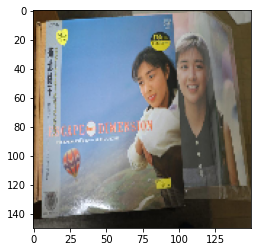

1/1 [==============================] - 0s 31ms/step
[[1.74148783e-16 3.43911920e-19 6.13210577e-05 2.13487095e-09
  1.71413922e-04 3.81822214e-02 7.05770295e-12 1.27245870e-11
  1.23502337e-03 5.98204094e-20 1.86060341e-18 9.91346916e-09
  5.11342110e-17 1.10297785e-16 1.89302106e-14 6.81539834e-01
  1.84276497e-10 2.16957062e-01 1.22680649e-06 4.82207937e-19
  6.09480175e-17 7.75547596e-06 9.11917050e-06 1.47010459e-11
  3.97344556e-05 3.59384952e-11 1.10604037e-06 2.94132614e-15
  4.57890368e-25 4.40893752e-16 3.70923431e-10 7.22670535e-10
  4.31741354e-09 6.13106899e-02 2.90767988e-15 4.83391254e-04
  1.89009433e-11 2.64299178e-08 2.06126999e-13 6.01887322e-08
  1.46245201e-12]]
Momoko Kikuchi - Escape From Dimension , 68.15
7.m29149120832_1.jpg: Momoko Kikuchi - Escape From Dimension
--------------------------------------------------------------
1.m17039467299_1.jpg


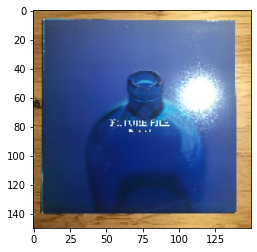

1/1 [==============================] - 0s 47ms/step
[[0.00000000e+00 0.00000000e+00 3.14236603e-33 0.00000000e+00
  4.37237447e-25 2.19561443e-13 1.00000000e+00 0.00000000e+00
  1.07061504e-23 0.00000000e+00 0.00000000e+00 6.22989341e-26
  0.00000000e+00 0.00000000e+00 1.07099507e-30 8.23738145e-19
  1.33272416e-20 2.29180422e-20 1.23182087e-09 6.48730242e-29
  0.00000000e+00 3.51858483e-33 4.75153668e-22 0.00000000e+00
  7.31152826e-15 8.30615250e-23 2.44458200e-32 0.00000000e+00
  0.00000000e+00 0.00000000e+00 7.59769995e-26 0.00000000e+00
  8.67063529e-16 1.54889291e-18 0.00000000e+00 2.46866096e-21
  2.22693876e-24 0.00000000e+00 0.00000000e+00 0.00000000e+00
  7.26504309e-15]]
Hiroshi Sato - Future File , 100.00
1.m17039467299_1.jpg: Hiroshi Sato - Future File
--------------------------------------------------------------
7.m39271101987_1.jpg


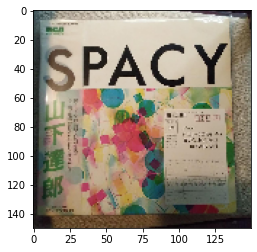

1/1 [==============================] - 0s 33ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 2.3160986e-33 0.0000000e+00
  0.0000000e+00 7.1349261e-34 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 1.9423064e-29 1.2985692e-26 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.7089940e-28 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.0000000e+00 3.3683754e-25 0.0000000e+00 3.7934122e-25 0.0000000e+00
  0.0000000e+00]]
Tatsuro Yamashita - Spacy , 100.00
7.m39271101987_1.jpg: Tatsuro Yamashita - Spacy
--------------------------------------------------------------
4.m39085176876_1.jpg


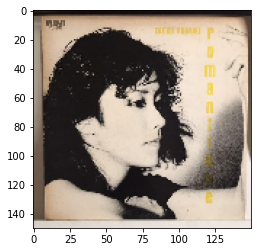

1/1 [==============================] - 0s 30ms/step
[[0.0000000e+00 0.0000000e+00 3.3140330e-30 0.0000000e+00 0.0000000e+00
  1.0109700e-37 0.0000000e+00 4.2283585e-31 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  4.2609890e-37 0.0000000e+00 1.0000000e+00 6.6700523e-32 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  3.2194420e-31 0.0000000e+00 0.0000000e+00 1.8378226e-15 0.0000000e+00
  1.4955226e-33 1.0052058e-29 8.0287323e-38 0.0000000e+00 0.0000000e+00
  0.0000000e+00]]
Taeko Ohnuki - Romantique , 100.00
4.m39085176876_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
3.m38682487476_1.jpg


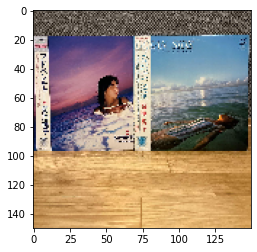

1/1 [==============================] - 0s 33ms/step
[[9.27263246e-17 1.91334429e-21 2.43151262e-01 1.39501974e-01
  7.24542636e-18 1.74651538e-09 6.05127264e-30 1.68822961e-22
  1.95446341e-06 8.01203212e-19 7.84334111e-21 2.23468192e-07
  3.30700431e-24 3.11952515e-18 1.15254042e-18 1.33486235e-08
  3.81936496e-12 9.97603996e-12 9.92914627e-28 2.01231830e-27
  1.38022892e-14 4.33659136e-01 2.17534035e-09 5.75949471e-14
  8.12433940e-11 1.84192786e-28 4.98466925e-16 5.42993206e-09
  9.54292926e-23 1.89638493e-13 5.41560767e-05 1.82416263e-10
  6.35048688e-24 1.88007070e-05 1.49635504e-16 1.79919153e-01
  1.10625695e-13 3.58657516e-03 1.06595769e-04 1.73649241e-07
  1.90492526e-21]]
Taeko Ohnuki - Mignonne , 43.37
3.m38682487476_1.jpg: Taeko Ohnuki - Mignonne
--------------------------------------------------------------
1.m26422727620_1.jpg


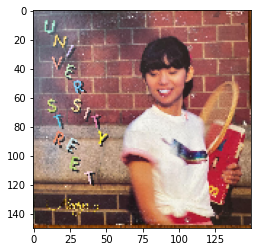

1/1 [==============================] - 0s 34ms/step
[[1.4961716e-35 2.1014909e-19 0.0000000e+00 1.3762467e-35 1.2087637e-30
  4.3676628e-11 1.7529158e-35 6.4595119e-32 4.8469148e-15 0.0000000e+00
  7.2770304e-36 2.2977598e-25 4.8994644e-24 1.0000000e+00 0.0000000e+00
  8.4539378e-22 8.9982908e-34 2.0795388e-17 3.1463307e-29 0.0000000e+00
  1.5379212e-22 9.3597626e-37 1.2877200e-36 7.8363369e-18 3.9491456e-33
  0.0000000e+00 4.7109454e-30 7.2988716e-24 7.3412840e-25 1.5482246e-19
  5.9187213e-18 5.6578986e-20 6.2823865e-29 2.1530871e-23 3.8792485e-13
  1.0049882e-27 6.4587941e-33 4.0556693e-23 8.0735644e-25 3.8578087e-08
  6.1260837e-33]]
Mariya Takeuchi - University Street , 100.00
1.m26422727620_1.jpg: Mariya Takeuchi - University Street
--------------------------------------------------------------
6.m30985902201_1.jpg


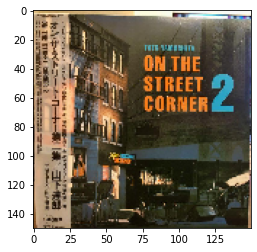

1/1 [==============================] - 0s 43ms/step
[[3.49458560e-34 2.81395810e-03 4.44621540e-09 1.03496186e-19
  0.00000000e+00 4.75871044e-11 0.00000000e+00 6.13565732e-08
  7.34979636e-04 3.61743146e-27 2.28829868e-22 5.63099551e-31
  1.01711229e-23 2.04804428e-06 1.15410424e-25 1.27488417e-22
  1.20978345e-22 2.18689823e-11 2.31265949e-37 0.00000000e+00
  4.91077060e-07 1.30745352e-08 1.20022421e-04 4.27809056e-07
  4.80198893e-31 0.00000000e+00 3.79361484e-25 1.94854607e-23
  4.94817282e-22 1.51939128e-12 3.84575158e-01 5.79305589e-01
  2.37118183e-14 5.97464345e-09 1.27901565e-02 4.74372630e-09
  2.44371147e-12 1.96570475e-02 2.10335858e-20 1.76662007e-09
  5.70525028e-29]]
Tatsuro Yamashita - On The Street Corner , 57.93
6.m30985902201_1.jpg: Tatsuro Yamashita - On The Street Corner
--------------------------------------------------------------
1.m27280358170_1.jpg


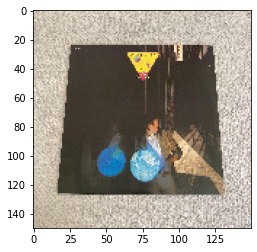

1/1 [==============================] - 0s 42ms/step
[[3.23741633e-24 7.39774964e-10 3.55715382e-31 1.83381157e-10
  0.00000000e+00 4.66731588e-20 0.00000000e+00 1.48532978e-28
  1.54993415e-06 1.25377690e-22 1.63902340e-23 8.34950627e-22
  3.72367712e-21 1.36142962e-14 8.12701657e-08 0.00000000e+00
  1.68025098e-28 2.76355025e-37 0.00000000e+00 1.30451770e-22
  1.18982910e-18 4.80927883e-23 1.08411596e-19 2.98729454e-19
  1.05132406e-31 0.00000000e+00 0.00000000e+00 5.35242846e-21
  2.71716026e-13 2.11851283e-25 9.99998331e-01 7.32070576e-28
  1.61610428e-12 1.24801709e-30 6.82509238e-17 8.01417775e-17
  3.73604251e-13 1.25927838e-24 3.20469042e-12 7.46032621e-24
  0.00000000e+00]]
Tatsuro Yamashita - Moonglow , 100.00
1.m27280358170_1.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
5.m80828542331_1.jpg


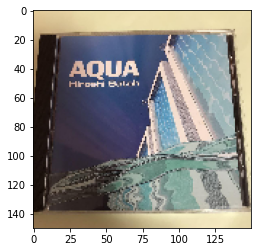

1/1 [==============================] - 0s 32ms/step
[[7.09056098e-28 2.44818504e-32 3.66609587e-09 3.01386584e-20
  1.64122600e-08 2.25433297e-02 2.63674187e-11 1.89508460e-15
  6.12990344e-12 2.20466432e-19 4.35172918e-16 6.18601958e-13
  2.27269575e-27 1.16976842e-18 5.54696280e-28 9.77170825e-01
  7.87000831e-19 6.37133610e-07 2.84507580e-04 9.62475862e-17
  1.26244010e-14 1.91639795e-13 2.36812117e-08 2.13751026e-08
  2.02330015e-14 5.95861793e-14 1.18925306e-14 1.65992888e-16
  1.29119723e-30 1.19295833e-18 9.16008328e-12 1.57469187e-12
  4.74807442e-16 5.20983967e-08 2.29836026e-22 1.01617506e-10
  3.82523874e-13 1.84445739e-07 1.86850652e-19 3.13645074e-07
  6.06858575e-19]]
Momoko Kikuchi - Escape From Dimension , 97.72
5.m80828542331_1.jpg: Momoko Kikuchi - Escape From Dimension
--------------------------------------------------------------
6.m85302009752_1.jpg


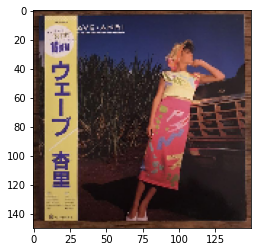

1/1 [==============================] - 0s 34ms/step
[[6.7073930e-10 5.1569431e-20 1.3088554e-16 1.0000000e+00 0.0000000e+00
  1.9133158e-38 0.0000000e+00 0.0000000e+00 1.2892644e-12 9.8541523e-27
  1.3422575e-31 5.2599945e-29 3.2407209e-24 1.7535785e-27 2.4017175e-12
  3.5921179e-26 1.6495336e-14 7.5354666e-34 0.0000000e+00 0.0000000e+00
  7.1853950e-36 1.1434171e-16 2.3557043e-27 3.6624118e-31 1.8388204e-28
  0.0000000e+00 0.0000000e+00 1.8455033e-13 3.7524788e-18 7.6799879e-19
  2.9030408e-13 5.1531433e-29 4.9168216e-31 7.0175531e-21 6.7658051e-21
  6.9765783e-22 1.7295443e-25 1.0826881e-26 3.5596490e-13 3.4856516e-27
  8.1807326e-34]]
Anri (2) - Wave , 100.00
6.m85302009752_1.jpg: Anri (2) - Wave
--------------------------------------------------------------
4.m76652346709_1.jpg


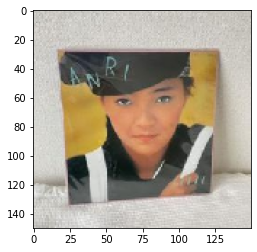

1/1 [==============================] - 0s 40ms/step
[[2.0509568e-17 9.9999988e-01 1.4053340e-22 7.3211359e-13 1.0546678e-31
  5.4566133e-27 3.0204022e-27 1.9651475e-23 3.4689227e-09 1.3665725e-29
  5.5933979e-17 4.3106196e-24 7.7779647e-14 5.7810055e-11 1.5217611e-15
  4.7631724e-28 2.7976222e-16 1.4862463e-26 3.2598350e-34 4.7391665e-32
  4.9635734e-17 1.9415807e-21 6.8302752e-20 2.5636911e-15 1.3168761e-27
  3.2998786e-30 8.4860318e-27 8.9224044e-20 1.1232458e-07 2.2635103e-16
  1.0355702e-11 9.9971307e-25 4.4869468e-12 4.8346129e-24 2.6662981e-09
  1.2083542e-21 1.5426800e-11 2.5359902e-22 3.7727460e-10 4.2338655e-22
  4.5425665e-23]]
Anri (2) - Coool , 100.00
4.m76652346709_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
3.m99511392468_1.jpg


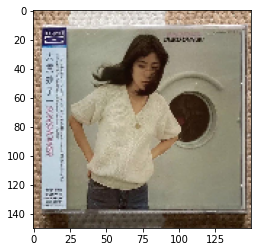

1/1 [==============================] - 0s 44ms/step
[[9.4721734e-30 6.4553059e-20 4.1351869e-13 4.0206622e-17 1.6201126e-25
  1.3374723e-06 2.6354859e-18 1.3763767e-12 7.3866735e-09 1.6022084e-26
  6.7577708e-22 1.0611121e-22 1.4186319e-28 1.3749488e-20 3.5944170e-18
  1.5642281e-18 7.1096897e-23 6.9893106e-12 6.3529814e-17 4.7200199e-24
  1.0473347e-14 3.5691541e-10 9.9973172e-01 1.3211837e-09 6.8741056e-19
  2.3406626e-26 6.4284723e-20 2.3118618e-23 1.3534630e-26 9.3027023e-27
  2.2345018e-08 5.5353984e-18 6.9601377e-08 7.9669071e-09 2.6716023e-18
  2.6682325e-04 9.8384213e-08 3.5326880e-11 1.6434922e-18 5.4958554e-21
  1.6761249e-25]]
Taeko Ohnuki - Romantique , 99.97
3.m99511392468_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
3.m30985902201_2.jpg


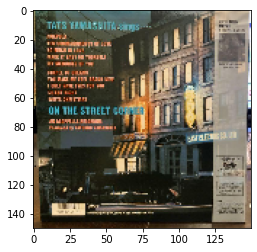

1/1 [==============================] - 0s 32ms/step
[[0.0000000e+00 5.1010477e-20 5.7587299e-09 3.0700746e-28 7.1295936e-35
  6.5129797e-11 9.4476068e-32 9.9496645e-01 1.0961093e-15 6.1792667e-12
  8.6666285e-11 4.7930563e-18 2.5355493e-20 1.3245554e-19 5.4764904e-27
  1.5318989e-27 1.0610704e-28 2.7420979e-18 8.3064619e-26 2.1249784e-23
  2.5113255e-07 2.7264045e-15 2.9629368e-10 1.2204660e-11 1.6073527e-27
  6.7231142e-32 5.0262628e-25 7.3061648e-34 1.8228034e-32 2.6533939e-20
  1.9008241e-10 2.4707082e-03 3.3983534e-13 1.9667381e-16 2.1723688e-23
  3.9451508e-14 4.0362760e-13 2.5625401e-03 1.3242809e-29 3.4531773e-11
  7.1082872e-32]]
Hiroshi Sato - Sound Of Science , 99.50
3.m30985902201_2.jpg: Hiroshi Sato - Sound Of Science
--------------------------------------------------------------
1.m43379398272_6.jpg


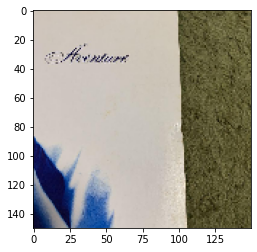

1/1 [==============================] - 0s 37ms/step
[[2.5533390e-11 2.2879156e-08 2.9686625e-10 3.6929847e-05 4.7752168e-15
  3.5310461e-07 7.3595501e-16 1.9355746e-13 9.9995899e-01 2.2236201e-18
  1.6471563e-09 4.9233423e-11 3.2117933e-07 1.2465678e-06 5.2420929e-10
  1.7919608e-07 1.5654903e-08 1.4414182e-09 1.7798870e-16 4.1927426e-21
  7.6536269e-12 9.7494153e-15 2.7082652e-15 1.7652407e-09 2.4323904e-16
  1.7979754e-19 1.8357689e-14 2.7938290e-12 2.1505477e-09 2.5012119e-12
  4.4793653e-09 9.9599655e-11 1.4023346e-06 3.4315235e-08 4.8065944e-12
  2.2289497e-10 1.4818010e-11 2.5536981e-12 1.3742734e-08 4.8124502e-07
  4.7039723e-08]]
Mariya Takeuchi - Beginning , 100.00
1.m43379398272_6.jpg: Mariya Takeuchi - Beginning
--------------------------------------------------------------
5.img_2021.jpg


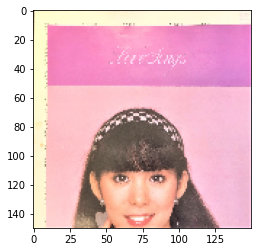

1/1 [==============================] - 0s 47ms/step
[[7.53795959e-09 3.77673630e-12 1.16807790e-02 3.49526032e-04
  1.95025152e-08 8.82542099e-06 2.13939431e-14 2.45153642e-05
  1.51447489e-06 8.75591561e-02 2.27711885e-03 5.78436302e-03
  2.14967599e-06 2.65376627e-08 3.86376708e-10 2.56244137e-09
  1.92652665e-12 5.49942918e-08 1.96726316e-10 9.97496159e-07
  7.18813908e-06 4.25454436e-06 4.13497401e-05 6.83246384e-08
  1.08339755e-08 9.24586796e-13 2.59611195e-08 2.67292677e-07
  1.11333848e-13 1.86249133e-06 6.56630425e-03 3.18985134e-02
  7.54966298e-11 2.40817302e-04 2.96480158e-12 1.83839873e-07
  9.76525553e-06 2.63390113e-02 5.62621594e-08 8.27201128e-01
  8.57337638e-12]]
Various - Classic Jazz-Funk Mastercuts Volume 7 , 82.72
5.img_2021.jpg: Various - Classic Jazz-Funk Mastercuts Volume 7
--------------------------------------------------------------
5.m24561199996_1.jpg


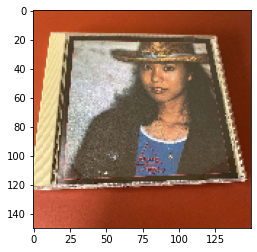

1/1 [==============================] - 0s 31ms/step
[[7.71020219e-19 2.61078104e-11 0.00000000e+00 1.14008679e-23
  0.00000000e+00 1.13331039e-10 1.21698322e-28 8.12083784e-31
  1.10706603e-02 7.20112814e-28 1.81816583e-24 3.60343949e-10
  2.10377604e-22 9.88742948e-01 2.51409204e-20 1.56216111e-35
  1.05674929e-27 2.03410006e-30 3.82979645e-32 1.21411895e-26
  5.89821931e-25 1.07394539e-31 3.68019759e-26 1.65246078e-18
  7.48319302e-35 0.00000000e+00 0.00000000e+00 1.07553174e-13
  6.43456122e-12 2.29013224e-17 1.86337958e-04 3.55914805e-22
  7.14908852e-15 1.33895564e-12 1.11022801e-12 1.51997233e-20
  2.50696682e-20 4.82772089e-26 1.17416078e-16 1.99984163e-09
  9.96309982e-34]]
Mariya Takeuchi - University Street , 98.87
5.m24561199996_1.jpg: Mariya Takeuchi - University Street
--------------------------------------------------------------
7.m52141637069_2.jpg


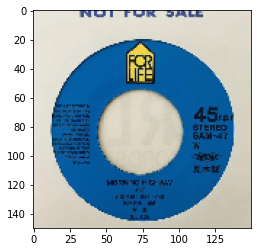

1/1 [==============================] - 0s 36ms/step
[[0.00000000e+00 1.25095084e-35 8.17457121e-21 1.76747801e-20
  0.00000000e+00 6.58966100e-13 8.72166042e-28 1.41726469e-27
  1.75587616e-08 0.00000000e+00 0.00000000e+00 3.39620714e-37
  0.00000000e+00 0.00000000e+00 3.67901349e-17 0.00000000e+00
  1.49612571e-26 8.01651849e-29 7.45600550e-32 0.00000000e+00
  4.73755858e-30 1.13336055e-20 6.75487099e-04 6.90587075e-23
  1.04479243e-08 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 7.62470365e-01 2.36986733e-30
  2.36847416e-01 9.00232939e-20 0.00000000e+00 6.74533658e-06
  2.19410882e-17 7.80967366e-27 0.00000000e+00 0.00000000e+00
  4.80147758e-36]]
Tatsuro Yamashita - Moonglow , 76.25
7.m52141637069_2.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
4.61oyigs2iel.jpg


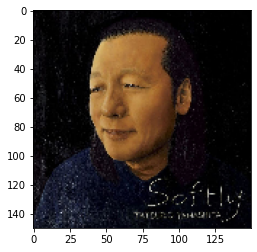

1/1 [==============================] - 0s 37ms/step
[[2.4064860e-33 5.4204684e-05 0.0000000e+00 5.6595801e-34 0.0000000e+00
  2.9368181e-38 0.0000000e+00 1.5656695e-38 2.2824847e-12 0.0000000e+00
  0.0000000e+00 0.0000000e+00 2.4658108e-33 4.2053277e-20 4.7324689e-36
  0.0000000e+00 2.1215605e-35 1.2086097e-24 0.0000000e+00 0.0000000e+00
  3.1683553e-30 7.1396873e-26 2.5349799e-24 6.7482785e-19 0.0000000e+00
  0.0000000e+00 0.0000000e+00 7.3430399e-33 1.3593703e-22 2.0806755e-21
  1.3392484e-17 2.6253860e-23 3.9860325e-30 1.4357071e-26 9.9994576e-01
  1.8012535e-34 2.1470149e-24 3.8258631e-31 1.3349104e-28 4.8232482e-37
  0.0000000e+00]]
Tatsuro Yamashita - Softly , 99.99
4.61oyigs2iel.jpg: Tatsuro Yamashita - Softly
--------------------------------------------------------------
7.m42911749728_1.jpg


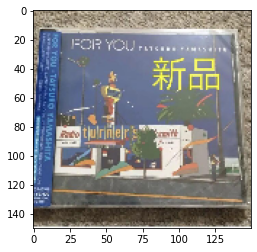

1/1 [==============================] - 0s 35ms/step
[[8.0677813e-15 1.9190186e-13 1.5023477e-01 2.0138747e-05 1.2859994e-01
  2.9191098e-04 1.3858241e-12 3.1631478e-06 2.4462997e-07 1.4125085e-07
  6.8136334e-04 3.4025109e-07 4.2794221e-09 1.8295703e-12 1.6975525e-15
  4.6140802e-05 3.4946594e-14 8.5569806e-03 1.2172306e-04 5.2444323e-11
  1.2209323e-04 4.4424096e-04 1.3133640e-04 2.2273474e-07 7.1981844e-11
  2.1852168e-07 4.3746625e-04 7.3950896e-14 3.2283267e-15 7.1927221e-11
  7.8320809e-05 2.0228813e-03 8.1419645e-12 2.3229021e-10 1.9750401e-12
  4.5166507e-06 2.6679723e-04 5.4841137e-01 1.1756012e-02 1.4776769e-01
  3.5808951e-12]]
Utada Hikaru - Deep River , 54.84
7.m42911749728_1.jpg: Utada Hikaru - Deep River
--------------------------------------------------------------
1.m25372332437_1.jpg


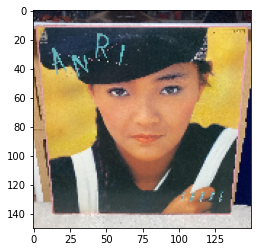

1/1 [==============================] - 0s 35ms/step
[[2.09546126e-20 9.99995828e-01 5.86610954e-22 9.79718872e-17
  0.00000000e+00 7.03506685e-32 1.10560341e-37 1.03232780e-26
  5.14843668e-10 4.58982539e-29 1.89579782e-24 2.88782463e-32
  3.84060756e-22 6.61765564e-12 2.35983229e-19 6.85340772e-32
  3.42916221e-20 1.08682095e-27 0.00000000e+00 0.00000000e+00
  1.12495023e-18 9.45464984e-20 3.15398984e-18 6.47315707e-15
  5.21235533e-36 0.00000000e+00 1.74219063e-33 6.70484679e-17
  8.90542862e-10 1.02829705e-15 1.08797533e-10 1.73837095e-21
  3.58853923e-20 1.69092004e-21 4.14208898e-06 5.63923662e-20
  2.55699953e-12 3.84379166e-20 3.45272720e-14 9.86373303e-28
  8.22913002e-31]]
Anri (2) - Coool , 100.00
1.m25372332437_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
1.m93779399967_1.jpg


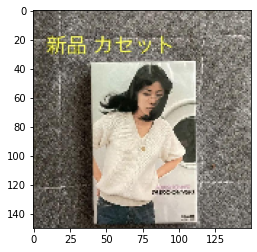

1/1 [==============================] - 0s 37ms/step
[[1.5949747e-20 1.6574385e-17 4.8658296e-07 1.2526329e-10 4.5466992e-18
  4.8794281e-08 5.8668245e-13 2.7085053e-07 2.4576741e-13 3.4003251e-09
  5.2866322e-10 6.2343988e-12 7.1910450e-18 1.3037752e-17 4.9541734e-14
  3.1502464e-11 1.6352742e-11 3.2364691e-15 5.1595414e-17 3.4471972e-10
  2.0026493e-04 2.8882647e-08 9.9949145e-01 2.3383707e-04 2.9279656e-17
  9.7239262e-20 2.4136296e-17 1.1828704e-16 2.6388358e-18 5.2745765e-21
  2.2456909e-07 2.3238729e-12 3.5315292e-11 5.0573175e-07 3.7829458e-17
  7.0440794e-05 5.7799241e-07 1.7585503e-06 1.7886603e-12 3.0382218e-17
  2.7082576e-16]]
Taeko Ohnuki - Romantique , 99.95
1.m93779399967_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
2.m11912690272_1.jpg


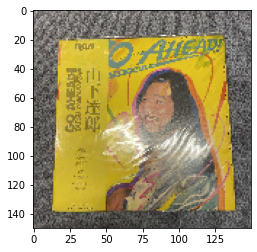

1/1 [==============================] - 0s 35ms/step
[[1.7180664e-05 1.3800820e-02 1.8209939e-10 4.2049060e-04 1.0332668e-08
  7.5378831e-10 3.6277478e-11 1.7561555e-11 6.3218329e-05 1.4108248e-08
  4.9372461e-06 2.3498206e-04 1.2383533e-04 2.3608729e-03 1.3844775e-07
  6.1367128e-10 2.5466610e-08 6.9723033e-11 3.3571711e-12 1.9496706e-09
  1.3900393e-07 4.1147757e-08 2.8425151e-10 1.8789867e-08 7.9325151e-11
  3.0353543e-11 1.0045135e-10 5.9654544e-06 3.4276480e-03 4.3486477e-08
  3.8306703e-06 1.2430725e-11 3.1602198e-08 5.7639480e-11 3.7684033e-05
  2.4437365e-06 1.5067654e-05 6.3459915e-08 9.7947627e-01 4.1765538e-06
  1.1338172e-09]]
Utada Hikaru - First Love , 97.95
2.m11912690272_1.jpg: Utada Hikaru - First Love
--------------------------------------------------------------
6.m76351374765_4.jpg


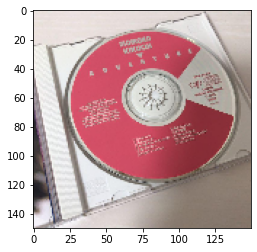

1/1 [==============================] - 0s 30ms/step
[[8.35835490e-09 1.91943263e-06 1.08183785e-14 5.67626012e-06
  3.97338695e-20 1.88339682e-16 3.18678181e-19 1.71005407e-20
  1.20890454e-05 2.50793009e-16 1.08533898e-14 8.30987687e-15
  4.29905157e-12 1.46381615e-10 2.34514687e-06 2.15338709e-15
  9.85585528e-13 1.98354178e-13 2.72951083e-21 1.43302090e-23
  1.49477471e-15 1.00414501e-12 1.74842762e-09 3.10847259e-09
  5.30681494e-17 8.24426415e-23 9.82059594e-17 1.71230835e-10
  2.91551396e-06 1.19127364e-13 1.52451776e-08 3.38020187e-15
  1.74690720e-13 2.03156825e-09 8.12898634e-07 2.23434063e-06
  4.25454455e-05 4.42480525e-15 9.99929309e-01 3.78606158e-17
  2.32151995e-15]]
Utada Hikaru - First Love , 99.99
6.m76351374765_4.jpg: Utada Hikaru - First Love
--------------------------------------------------------------
6.m54536359205_3.jpg


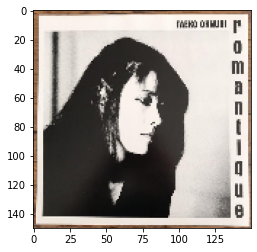

1/1 [==============================] - 0s 40ms/step
[[0.0000000e+00 3.0611463e-23 1.8478002e-05 2.5895811e-15 0.0000000e+00
  1.4111462e-15 0.0000000e+00 4.6314170e-09 2.4773330e-19 5.5483044e-17
  2.3980633e-13 3.0466474e-20 5.8900778e-31 8.5387811e-24 8.9858785e-33
  1.8928900e-35 1.3993288e-34 1.4180262e-23 2.0754602e-37 2.8136378e-28
  2.5145951e-07 2.8417771e-08 1.4167768e-01 2.2353006e-13 0.0000000e+00
  0.0000000e+00 5.5436006e-27 1.8127772e-30 1.8127519e-35 3.5480001e-30
  2.5239268e-07 2.4911995e-10 2.4902131e-31 5.9478281e-18 7.9905798e-28
  1.4799051e-10 1.2810485e-11 8.5830337e-01 4.4834460e-17 2.0225991e-16
  0.0000000e+00]]
Utada Hikaru - Deep River , 85.83
6.m54536359205_3.jpg: Utada Hikaru - Deep River
--------------------------------------------------------------
5.m46412031299_1.jpg


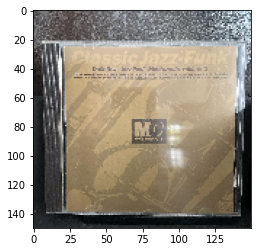

1/1 [==============================] - 0s 41ms/step
[[6.6760548e-16 7.3712287e-03 1.4650428e-07 1.7827724e-11 1.2672407e-15
  3.6608513e-02 2.0712808e-15 2.1488977e-06 2.2115479e-01 6.7345784e-16
  1.8920605e-13 7.8328177e-10 1.3265034e-10 1.1662182e-02 2.8456428e-14
  1.0415528e-08 5.0940321e-11 8.0379816e-03 2.7938532e-13 1.2017769e-17
  1.9805346e-05 2.4244320e-05 3.2374304e-05 7.8664382e-04 1.1286907e-11
  4.4279090e-18 4.2564363e-10 6.9736147e-11 2.8463853e-11 1.8731477e-06
  2.2510520e-01 3.1004524e-01 2.8883617e-06 4.3585162e-05 8.5556813e-02
  3.1966524e-04 3.0243282e-06 9.0380915e-02 1.3466849e-08 2.8406640e-03
  3.3821008e-11]]
Tatsuro Yamashita - On The Street Corner , 31.00
5.m46412031299_1.jpg: Tatsuro Yamashita - On The Street Corner
--------------------------------------------------------------
3.m30097271846_1.jpg


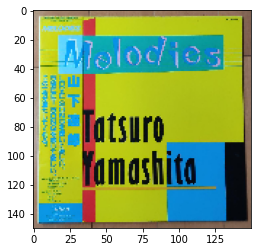

1/1 [==============================] - 0s 32ms/step
[[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  7.86254881e-30 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 1.00000000e+00 1.10485705e-23 4.16643045e-29
  1.82929094e-21 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 4.63986961e-24
  0.00000000e+00]]
Tatsuro Yamashita - Melodies , 100.00
3.m30097271846_1.jpg: Tatsuro Yamashita - Melodies
--------------------------------------------------------------
7.m62090005516_4.jpg


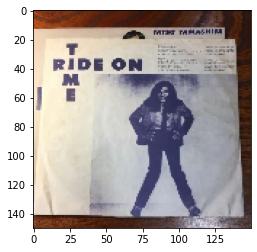

1/1 [==============================] - 0s 41ms/step
[[3.00025946e-34 8.70906753e-27 4.33956317e-21 4.37279938e-28
  2.48813977e-25 9.99999404e-01 1.57903279e-09 3.83302399e-15
  3.34467766e-11 3.61369839e-31 3.65797588e-20 1.37715738e-16
  3.25614059e-35 1.74465168e-25 2.34676182e-26 9.40588839e-12
  6.34684163e-22 1.51826776e-14 6.70823341e-10 5.95583006e-21
  4.58666912e-16 9.16522177e-21 3.71139834e-07 4.90189889e-10
  4.08843737e-18 4.74003099e-25 3.97267417e-23 8.63033846e-31
  1.51134208e-29 9.89797841e-31 1.70847625e-15 1.01485376e-20
  2.24084275e-07 9.41645317e-10 9.54492036e-27 3.40906026e-10
  6.76556120e-12 3.13284156e-15 5.58154936e-23 3.18868029e-21
  5.50902288e-20]]
Hiroshi Sato - Awakening , 100.00
7.m62090005516_4.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
2.m31085431462_1.jpg


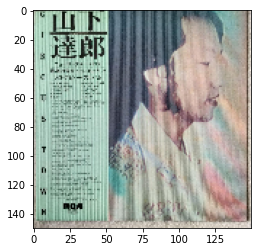

1/1 [==============================] - 0s 49ms/step
[[3.2213666e-11 3.4436360e-07 1.2257006e-05 4.3979540e-09 1.0008493e-11
  2.4087124e-02 3.7972754e-06 1.3720240e-02 3.8583469e-04 1.2447924e-07
  6.4825866e-04 2.4298724e-05 2.1378483e-08 5.0176550e-06 3.1583850e-11
  1.7204064e-04 2.2674824e-06 2.8780189e-06 5.8436945e-07 3.0740757e-09
  5.4939485e-01 5.2593271e-07 7.1597242e-06 3.2927322e-01 5.5738504e-08
  3.7057504e-10 6.5217849e-09 1.3521548e-10 3.1138496e-09 2.9540385e-07
  8.4070145e-04 6.9537992e-04 1.2107770e-02 4.2445858e-08 4.3167603e-08
  5.9556955e-05 3.1002732e-05 6.8483777e-02 1.3465551e-09 3.3579632e-05
  6.9914818e-06]]
Taeko Ohnuki - Grey Skies , 54.94
2.m31085431462_1.jpg: Taeko Ohnuki - Grey Skies
--------------------------------------------------------------
7.81b2scb+gol._sx355_.jpg


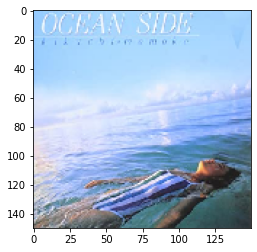

1/1 [==============================] - 0s 32ms/step
[[2.31973182e-28 2.34052354e-27 1.53263239e-24 3.41795735e-22
  3.13158926e-24 1.16521192e-12 2.16879896e-04 5.76610570e-28
  7.36633545e-19 3.53693724e-29 5.22408889e-20 4.98126605e-13
  4.35352336e-24 1.51752541e-37 7.17605771e-14 1.64879812e-15
  1.25970514e-02 2.16264230e-26 9.91167038e-16 2.88474816e-15
  3.74897401e-27 1.87291327e-31 2.32640958e-24 2.48625885e-22
  9.93145288e-11 1.24111765e-14 1.11655246e-22 1.53224689e-31
  2.35374909e-26 8.50291907e-28 2.32484201e-14 4.39913244e-31
  2.59216093e-09 7.76698122e-23 2.74721553e-35 2.07093916e-21
  4.13973673e-15 4.56341974e-35 8.72380378e-21 1.30820571e-34
  9.87186134e-01]]
東北新幹線 - Thru Traffic , 98.72
7.81b2scb+gol._sx355_.jpg: 東北新幹線 - Thru Traffic
--------------------------------------------------------------
6.m19750838754_1.jpg


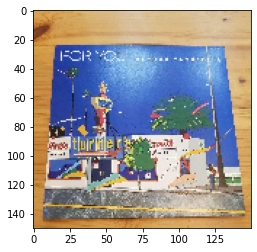

1/1 [==============================] - 0s 40ms/step
[[0.0000000e+00 0.0000000e+00 3.3787922e-29 0.0000000e+00 6.9553727e-22
  5.2937780e-12 0.0000000e+00 0.0000000e+00 4.2956736e-28 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.0000000e+00 0.0000000e+00 5.0526213e-23 2.5612184e-30 0.0000000e+00
  0.0000000e+00 5.3254696e-37 3.7962138e-21 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 2.2175816e-15 0.0000000e+00
  6.0090278e-29 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00]]
Momoko Kikuchi - Escape From Dimension , 100.00
6.m19750838754_1.jpg: Momoko Kikuchi - Escape From Dimension
--------------------------------------------------------------
1.m22541729140_1.jpg


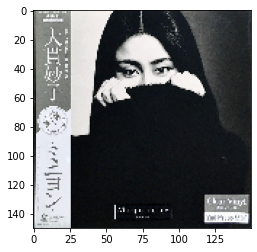

1/1 [==============================] - 0s 34ms/step
[[0.0000000e+00 1.1004664e-35 5.5724052e-21 8.8472852e-29 0.0000000e+00
  1.5801831e-13 0.0000000e+00 5.0180933e-18 1.7127441e-22 2.9814431e-28
  1.8365256e-29 7.6296047e-28 0.0000000e+00 0.0000000e+00 2.3924347e-34
  0.0000000e+00 0.0000000e+00 2.5275068e-31 0.0000000e+00 1.2601297e-32
  4.2249997e-17 2.8187775e-12 9.6232837e-01 1.9665878e-21 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.2809403e-18 1.1736150e-26 8.5449190e-27 2.3175228e-23 7.5556011e-36
  3.7671644e-02 2.8903610e-15 2.6255135e-14 1.5971913e-28 0.0000000e+00
  0.0000000e+00]]
Taeko Ohnuki - Romantique , 96.23
1.m22541729140_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
7.m59942082721_3.jpg


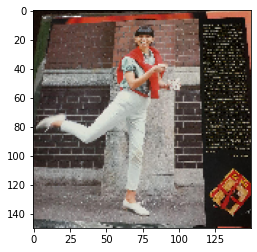

1/1 [==============================] - 0s 32ms/step
[[9.45975650e-24 2.00399523e-11 9.14436882e-08 1.07032688e-12
  9.38447149e-21 3.66930508e-09 3.04681811e-22 3.13495696e-09
  8.95331250e-05 2.67626095e-15 4.07854801e-18 5.94933125e-16
  5.23775352e-20 8.77850378e-15 1.13659065e-14 8.35801323e-18
  8.07314302e-15 3.06972936e-08 3.00029856e-17 1.45312319e-21
  5.75502840e-12 2.75356854e-07 8.83787155e-01 1.01281845e-08
  1.65265924e-12 8.89076482e-22 4.77148160e-14 1.95639666e-15
  3.82936466e-19 1.11938833e-13 3.84671410e-04 2.58544860e-05
  4.21823384e-12 1.15594022e-01 9.07593334e-10 1.18212360e-04
  1.14320855e-07 5.75310857e-08 4.42612136e-12 1.78192704e-12
  7.74222232e-21]]
Taeko Ohnuki - Romantique , 88.38
7.m59942082721_3.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
4.m84561498037_1.jpg


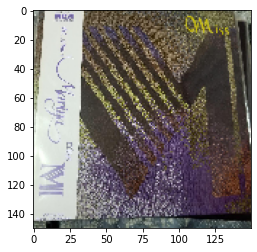

1/1 [==============================] - 0s 40ms/step
[[3.83956826e-17 3.04267584e-14 1.36361759e-05 1.32006672e-08
  9.72573528e-19 1.37734003e-06 7.12208818e-22 1.33887678e-03
  9.17222906e-07 2.88785249e-01 1.03766419e-01 2.33405968e-04
  5.75578751e-10 1.32329902e-11 4.11847612e-14 1.67148666e-18
  1.05692993e-21 5.78848880e-09 1.60592398e-14 1.41527764e-07
  9.28949859e-08 3.83847177e-01 8.37324634e-02 4.04513020e-11
  1.65208712e-20 2.26746417e-22 1.75155015e-17 9.32314325e-14
  1.99591767e-19 5.68823255e-17 6.03026892e-05 5.85361740e-05
  9.98724645e-11 2.05018447e-10 4.94621922e-13 7.29081454e-03
  3.25641959e-05 1.23912945e-01 3.69069548e-13 6.92511676e-03
  3.13747627e-22]]
Taeko Ohnuki - Mignonne , 38.38
4.m84561498037_1.jpg: Taeko Ohnuki - Mignonne
--------------------------------------------------------------
1.m63695457036_1.jpg


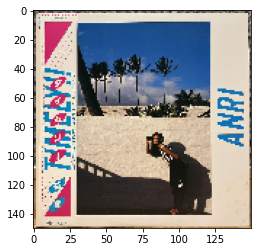

1/1 [==============================] - 0s 42ms/step
[[0.00000000e+00 0.00000000e+00 1.00000000e+00 7.35001131e-29
  0.00000000e+00 0.00000000e+00 0.00000000e+00 8.76890948e-35
  0.00000000e+00 8.17820954e-33 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  5.73571793e-35 4.16201114e-38 1.50203696e-15 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 3.13855005e-37 1.03286751e-34
  0.00000000e+00 1.33722795e-17 0.00000000e+00 0.00000000e+00
  5.21705458e-35 3.56923427e-36 0.00000000e+00 0.00000000e+00
  0.00000000e+00]]
Anri (2) - Timely!! , 100.00
1.m63695457036_1.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
4.m82503518486_1.jpg


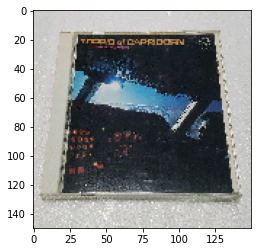

1/1 [==============================] - 0s 31ms/step
[[1.7647509e-32 1.7938433e-30 2.4596752e-06 1.7598570e-13 1.7387835e-13
  1.6374571e-09 3.1288559e-26 7.8024479e-12 5.5582097e-17 1.4265493e-09
  5.3235248e-13 3.2210395e-05 7.6432261e-22 8.9659935e-28 1.9954920e-28
  9.4947978e-19 1.0741957e-25 2.1053495e-13 1.4234687e-18 6.8007150e-13
  1.3945776e-09 6.3111343e-05 8.4095501e-04 1.5148131e-13 1.0063401e-21
  4.2685165e-21 1.1707729e-14 9.3731822e-22 6.1801770e-33 2.2927606e-29
  1.5746954e-11 4.3377120e-14 5.1926544e-24 8.8364076e-16 2.0872908e-26
  9.9885082e-01 1.0648473e-09 2.1036652e-04 9.3025752e-12 1.0224203e-16
  1.1554951e-24]]
Tatsuro Yamashita - Spacy , 99.89
4.m82503518486_1.jpg: Tatsuro Yamashita - Spacy
--------------------------------------------------------------
7.m63877435287_1.jpg


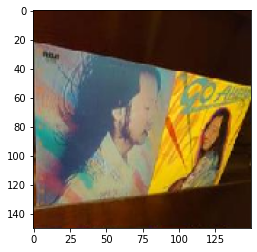

1/1 [==============================] - 0s 38ms/step
[[2.01423961e-10 8.23010233e-17 5.32840386e-19 8.67962271e-08
  6.90550850e-23 1.26207211e-09 1.32533908e-25 7.91304718e-28
  9.99855042e-01 3.55195154e-24 1.48432719e-24 6.35146710e-12
  5.43593082e-16 7.02695194e-11 9.75977979e-13 1.17373059e-14
  2.00940882e-17 1.39045095e-11 1.06320257e-25 4.32029266e-27
  7.81105262e-27 4.14650783e-14 1.51312241e-18 1.02718985e-19
  1.55583915e-18 1.62916159e-34 1.81355059e-24 1.54433577e-10
  2.74823430e-17 9.49120534e-16 3.10970072e-09 3.84816927e-14
  1.30248943e-17 1.44700680e-04 5.94279671e-13 2.32147288e-10
  5.72149745e-18 3.31241023e-18 2.05912006e-11 1.64482373e-07
  3.21497725e-22]]
Mariya Takeuchi - Beginning , 99.99
7.m63877435287_1.jpg: Mariya Takeuchi - Beginning
--------------------------------------------------------------
6.m89227384589_1.jpg


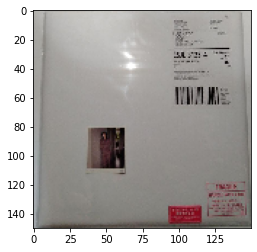

1/1 [==============================] - 0s 39ms/step
[[7.79609072e-16 6.74442779e-10 3.75430919e-02 8.80633433e-09
  2.06428055e-13 3.52478189e-08 9.04186834e-15 7.77055681e-01
  5.27244310e-07 1.56961755e-06 1.40664133e-03 2.83997201e-06
  1.04794679e-02 4.29324018e-07 1.34961995e-16 7.57492680e-10
  1.33375283e-10 8.75465685e-06 7.97145485e-14 1.52844046e-14
  5.03597839e-05 2.41326195e-11 1.17977784e-07 7.93800552e-07
  1.62705804e-09 2.45491121e-14 5.54426651e-06 2.03575204e-14
  1.13854374e-13 7.15939379e-08 1.91847570e-02 2.35056095e-02
  9.85375209e-07 5.16069010e-09 7.83235076e-13 4.10019538e-07
  2.47992762e-06 8.86567235e-02 4.75533879e-09 4.20931317e-02
  2.83808195e-08]]
Hiroshi Sato - Sound Of Science , 77.71
6.m89227384589_1.jpg: Hiroshi Sato - Sound Of Science
--------------------------------------------------------------
2.m12303541507_2.jpg


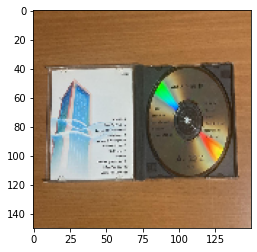

1/1 [==============================] - 0s 31ms/step
[[1.6069436e-33 0.0000000e+00 3.2342759e-17 7.4542291e-24 3.5269740e-14
  5.1000550e-02 4.5091325e-29 1.9613332e-27 1.1523923e-09 2.8637195e-37
  2.0177612e-31 1.9727404e-18 4.2855575e-30 1.7443299e-23 5.4061926e-33
  1.7060926e-03 3.8148575e-28 6.8763340e-01 1.1217976e-14 0.0000000e+00
  1.4990317e-32 2.2963370e-22 1.7370764e-14 4.9723882e-18 1.1701355e-17
  8.2935455e-26 6.6057169e-13 3.2256204e-28 0.0000000e+00 1.0710737e-30
  1.3741961e-21 7.9100981e-20 5.8165203e-28 2.5966001e-01 2.6720851e-27
  3.6424374e-11 2.3717082e-22 9.2637396e-18 5.0141088e-23 1.0024291e-13
  2.6636380e-27]]
Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線 , 68.76
2.m12303541507_2.jpg: Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線
--------------------------------------------------------------
4.m71692766164_3.jpg


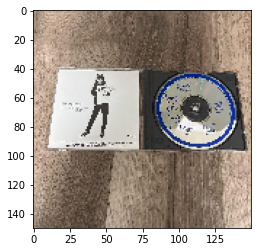

1/1 [==============================] - 0s 38ms/step
[[1.2178623e-21 1.0921126e-23 3.5643347e-02 4.6792161e-09 7.9114682e-20
  6.4110810e-13 4.9243953e-32 9.3774511e-12 4.7016152e-10 8.8665030e-14
  4.9484337e-13 3.7339372e-19 1.4914098e-22 1.8296799e-20 4.9792476e-18
  2.6555955e-13 3.1085580e-20 1.4021148e-13 6.8657278e-24 4.5042001e-24
  7.5291742e-16 1.3788591e-07 5.8536476e-01 2.5482626e-15 3.0953506e-21
  5.1709179e-29 1.7727593e-18 1.6864985e-14 2.9056151e-30 3.8737613e-18
  1.1427561e-10 1.7089755e-09 6.1966085e-18 3.7899163e-01 2.0847750e-20
  1.1468600e-12 8.6523688e-12 9.6469090e-09 1.6787853e-19 8.3628045e-08
  2.9994996e-28]]
Taeko Ohnuki - Romantique , 58.54
4.m71692766164_3.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
1.m72064985680_1.jpg


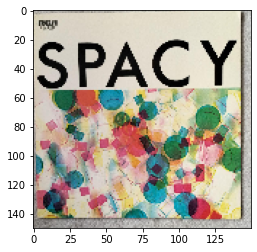

1/1 [==============================] - 0s 43ms/step
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]]
Tatsuro Yamashita - Spacy , 100.00
1.m72064985680_1.jpg: Tatsuro Yamashita - Spacy
--------------------------------------------------------------
1.m36202937387_1.jpg


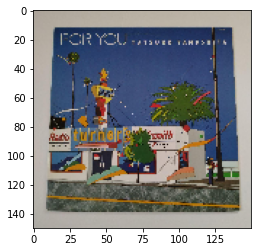

1/1 [==============================] - 0s 36ms/step
[[1.2177634e-22 6.9305351e-24 9.9755955e-01 2.7533106e-11 8.6288274e-09
  2.3317430e-16 2.3626057e-24 3.6424484e-07 2.6445840e-10 4.4792166e-16
  6.3228456e-19 6.3734024e-21 6.2807355e-13 6.1880746e-19 3.8885508e-25
  5.0410285e-09 2.7091629e-14 1.5856631e-03 3.1065202e-18 2.1653827e-28
  7.2673899e-21 5.8962057e-15 2.6176125e-12 9.1480541e-22 1.1366694e-09
  1.2769237e-14 1.2219835e-04 3.4926212e-18 1.8849358e-30 2.5146158e-13
  1.3502872e-12 5.7217477e-07 1.5408891e-15 7.2853838e-04 2.8630870e-23
  1.5604670e-17 9.9853599e-20 8.4740347e-11 2.7435484e-23 3.0890383e-06
  4.6974338e-18]]
Anri (2) - Timely!! , 99.76
1.m36202937387_1.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
7.m32283264548_1.jpg


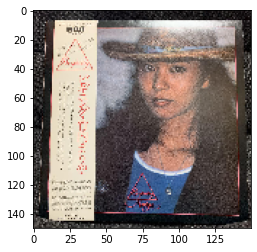

1/1 [==============================] - 0s 30ms/step
[[3.51137362e-20 1.71044317e-15 3.33628378e-17 2.15420368e-12
  1.32402408e-30 4.42350938e-06 2.64655709e-17 5.93653629e-15
  8.99861567e-04 4.29012550e-22 2.21133915e-18 4.22114154e-18
  5.73188995e-16 1.03733435e-13 1.14463896e-12 1.94174259e-18
  2.42624765e-09 9.32868421e-17 4.05410033e-22 2.28508660e-27
  1.90456176e-05 3.12341396e-20 2.12875389e-15 2.83898562e-01
  3.00792158e-19 4.01840229e-26 2.17347383e-23 1.17814761e-20
  5.20993191e-17 1.49453511e-15 7.12787628e-01 1.21407734e-12
  2.39052624e-03 2.49356193e-17 2.11698531e-17 1.01349658e-08
  5.56573468e-11 6.80612684e-12 1.43956227e-16 1.95811535e-17
  1.96077836e-15]]
Tatsuro Yamashita - Moonglow , 71.28
7.m32283264548_1.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
5.m34800885170_2.jpg


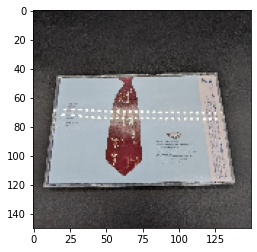

1/1 [==============================] - 0s 36ms/step
[[2.04507974e-14 5.89680042e-07 8.77374128e-12 1.19784174e-13
  4.85753832e-18 1.67211192e-03 4.11286023e-12 2.90739816e-03
  2.69654226e-02 2.08834707e-12 6.01046158e-05 1.39110028e-07
  2.14729692e-10 5.53066537e-10 1.15756895e-14 6.08743687e-13
  8.50238570e-17 2.02647704e-10 3.33047034e-10 1.49786422e-12
  1.25522711e-05 8.72776056e-08 1.92606493e-07 4.15581924e-09
  1.45024979e-15 5.14953616e-21 2.77292034e-18 9.09132705e-18
  2.48017653e-16 1.61446464e-11 2.36344204e-06 3.39583174e-04
  9.47056711e-01 2.09781886e-10 1.07023959e-10 5.60790824e-11
  6.23261442e-10 1.05519985e-06 3.49096611e-19 2.09817141e-02
  3.25885918e-18]]
Tatsuro Yamashita - On The Street Corner 2 , 94.71
5.m34800885170_2.jpg: Tatsuro Yamashita - On The Street Corner 2
--------------------------------------------------------------
5.m99517669703_1.jpg


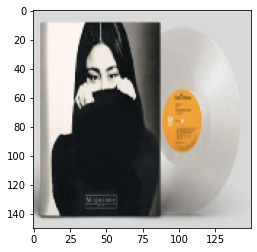

1/1 [==============================] - 0s 32ms/step
[[0.00000000e+00 0.00000000e+00 5.44637512e-12 1.41279977e-20
  0.00000000e+00 2.77492710e-23 0.00000000e+00 1.74256598e-20
  2.20304723e-33 9.99632478e-01 9.67260822e-21 1.11649745e-17
  6.95359597e-34 0.00000000e+00 3.78171312e-35 0.00000000e+00
  3.98463276e-37 1.49513614e-36 0.00000000e+00 3.15516012e-14
  2.02958475e-07 6.93934216e-11 1.23206780e-06 8.53352872e-16
  0.00000000e+00 0.00000000e+00 2.63634408e-38 6.14709710e-33
  0.00000000e+00 0.00000000e+00 1.28204974e-10 1.13800262e-23
  0.00000000e+00 8.94680976e-32 0.00000000e+00 3.60866194e-04
  5.93919377e-14 5.24944562e-06 2.79197670e-25 2.97946377e-35
  0.00000000e+00]]
Mariya Takeuchi - Love Songs , 99.96
5.m99517669703_1.jpg: Mariya Takeuchi - Love Songs
--------------------------------------------------------------
1.m72044373645_1.jpg


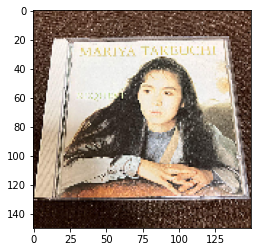

1/1 [==============================] - 0s 33ms/step
[[1.93711683e-28 4.72135096e-31 1.15669583e-14 4.94990099e-22
  2.19182291e-25 3.11741188e-11 6.65443590e-32 7.12124355e-17
  2.40846788e-14 2.18211300e-13 3.56469688e-21 1.28875851e-15
  1.04307417e-25 2.47042635e-22 1.92410242e-29 2.34046767e-24
  7.51578272e-28 3.50033181e-18 1.35626634e-22 3.83004269e-20
  2.23530951e-13 1.43618393e-16 1.04777409e-21 5.06753184e-16
  3.50387806e-22 2.34888034e-27 1.70416418e-24 3.24240922e-24
  1.16465755e-35 4.32697524e-11 1.29171454e-07 9.99982953e-01
  4.03239416e-25 4.16846544e-18 8.21066691e-27 6.50795495e-24
  8.84128876e-25 3.21354469e-06 5.43088452e-31 1.37289380e-05
  2.97904362e-34]]
Tatsuro Yamashita - On The Street Corner , 100.00
1.m72044373645_1.jpg: Tatsuro Yamashita - On The Street Corner
--------------------------------------------------------------
1.m78946600062_1.jpg


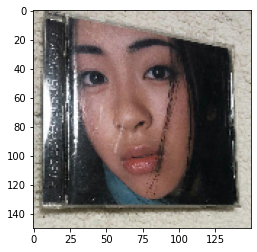

1/1 [==============================] - 0s 44ms/step
[[1.4454616e-15 9.9882346e-01 1.4431235e-18 2.1655074e-12 5.1935428e-31
  4.7737391e-17 3.4085052e-23 8.8280421e-17 8.5446318e-06 1.4331389e-18
  1.6428375e-12 1.1712864e-13 6.4171278e-18 1.6731034e-08 4.9611825e-15
  4.7525232e-22 3.7782925e-20 5.8357166e-16 1.2731006e-25 9.3950498e-29
  5.7293070e-17 1.6706024e-09 1.1752682e-08 7.4509126e-15 1.7027198e-25
  2.7954420e-37 2.4076848e-26 7.3064647e-15 5.2761560e-08 8.7140442e-18
  4.1591608e-08 1.5837107e-17 2.3759961e-12 9.5723820e-15 2.0262953e-05
  1.5590475e-04 2.2900938e-04 6.6706867e-13 7.6270022e-04 3.7470223e-17
  9.1348555e-25]]
Anri (2) - Coool , 99.88
1.m78946600062_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
6.m75017000833_1.jpg


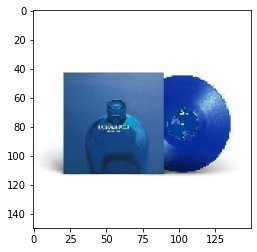

1/1 [==============================] - 0s 41ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  3.5051048e-01 3.2585162e-01 0.0000000e+00 2.3608412e-23 0.0000000e+00
  0.0000000e+00 7.3500258e-29 0.0000000e+00 0.0000000e+00 0.0000000e+00
  9.2113710e-21 0.0000000e+00 2.6560262e-23 3.2363787e-01 0.0000000e+00
  0.0000000e+00 0.0000000e+00 1.2960404e-37 0.0000000e+00 1.9838130e-18
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  3.9996145e-30 0.0000000e+00 6.7193439e-20 1.3116697e-27 0.0000000e+00
  4.1924972e-33 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.2270355e-34]]
Hiroshi Sato - Awakening , 35.05
6.m75017000833_1.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
1.m93461032992_1.jpg


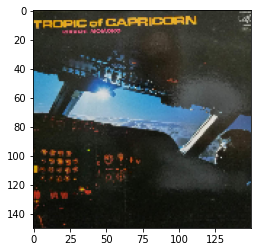

1/1 [==============================] - 0s 33ms/step
[[0.0000000e+00 0.0000000e+00 4.6781231e-36 0.0000000e+00 1.4500441e-29
  8.3488515e-22 0.0000000e+00 1.2013992e-30 8.2310136e-32 0.0000000e+00
  0.0000000e+00 0.0000000e+00 5.2865596e-32 1.0668626e-26 0.0000000e+00
  1.4510261e-18 0.0000000e+00 1.0000000e+00 7.7038751e-26 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 9.8035477e-32 1.6485992e-33
  0.0000000e+00 1.1744090e-18 0.0000000e+00 0.0000000e+00 0.0000000e+00
  3.7240136e-34 7.8911310e-21 0.0000000e+00 9.4471325e-32 2.1150057e-38
  4.1664644e-28 0.0000000e+00 1.5354057e-23 0.0000000e+00 6.9829859e-17
  0.0000000e+00]]
Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線 , 100.00
1.m93461032992_1.jpg: Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線
--------------------------------------------------------------
7.m47288176738_1.jpg


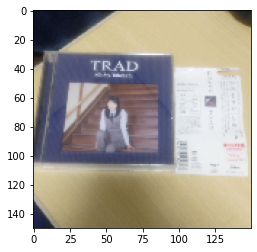

1/1 [==============================] - 0s 45ms/step
[[6.37705559e-14 2.64926122e-14 8.15069453e-12 1.00377484e-08
  4.75812778e-10 2.04690732e-03 1.02938147e-08 4.40213702e-13
  8.96108588e-07 3.61348213e-13 1.42031205e-08 9.97922242e-01
  6.03547351e-11 6.97314439e-13 2.04580981e-13 2.38511122e-09
  1.33645706e-09 1.54929888e-11 6.06255028e-08 1.28248683e-08
  3.55297836e-09 1.49583453e-11 2.82813304e-11 7.46556650e-10
  9.53036050e-09 4.81893215e-12 3.74978217e-12 4.41471370e-14
  1.24328580e-14 1.15743447e-13 2.72790185e-05 2.04054200e-12
  2.39001690e-08 3.70987269e-12 1.19260376e-15 3.48099974e-07
  8.67889938e-09 2.23886176e-09 1.62077174e-06 1.08682109e-07
  4.67784020e-07]]
Mariya Takeuchi - Request , 99.79
7.m47288176738_1.jpg: Mariya Takeuchi - Request
--------------------------------------------------------------
1.s-l500.jpg


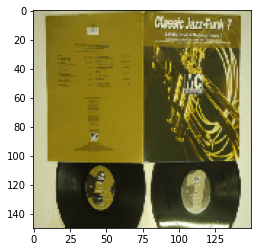

1/1 [==============================] - 0s 42ms/step
[[2.54177926e-24 7.77930200e-06 7.41692774e-30 1.05692656e-25
  6.70377934e-38 5.42316608e-18 1.11488355e-36 1.12348345e-26
  3.55959332e-06 5.78024588e-33 7.43027959e-34 2.39867857e-26
  1.10027607e-24 1.50853452e-07 4.39468297e-24 7.48069032e-30
  3.88902918e-27 2.42007943e-15 1.09788594e-32 1.44033458e-38
  6.25987356e-22 1.21186881e-18 3.96721420e-13 1.59530635e-11
  9.16357618e-30 0.00000000e+00 6.88636173e-29 5.86297413e-16
  1.14120269e-17 8.90872527e-14 5.45901591e-09 3.38856655e-12
  3.38292933e-23 4.94969399e-10 9.99988437e-01 2.21105073e-16
  7.47045722e-14 3.58338493e-19 5.68996235e-17 3.87175741e-18
  3.12093268e-34]]
Tatsuro Yamashita - Softly , 100.00
1.s-l500.jpg: Tatsuro Yamashita - Softly
--------------------------------------------------------------
4.m82849224719_2.jpg


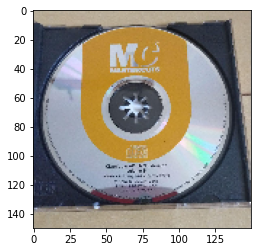

1/1 [==============================] - 0s 34ms/step
[[5.08508270e-11 1.50726919e-05 1.80071709e-08 3.84016930e-05
  3.93318097e-15 1.23850390e-04 2.16356433e-13 1.70783736e-07
  7.62030436e-03 9.77441843e-08 7.99388230e-01 8.33267186e-05
  1.03519124e-05 2.09896172e-07 3.66906875e-06 8.71429339e-13
  4.35622458e-12 3.95020489e-10 1.54586052e-10 3.97291866e-10
  2.00218172e-04 3.14360904e-07 1.46463108e-05 4.02990881e-05
  1.04175845e-14 1.31973861e-16 3.23055689e-14 1.60015786e-13
  1.48065880e-08 8.18567002e-12 1.89571995e-02 5.52133258e-07
  1.66887956e-04 1.39951167e-11 3.36378463e-08 7.72873755e-04
  1.52318329e-01 6.83235021e-06 1.99984424e-02 2.39691028e-04
  6.24624311e-12]]
Mariya Takeuchi - Miss M , 79.94
4.m82849224719_2.jpg: Mariya Takeuchi - Miss M
--------------------------------------------------------------
6.m40852281296_1.jpg


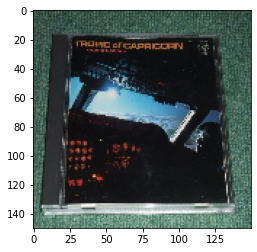

1/1 [==============================] - 0s 42ms/step
[[0.0000000e+00 0.0000000e+00 2.3728328e-13 1.8788935e-34 4.1024347e-07
  7.6405006e-05 1.8099888e-29 3.4655295e-12 1.2113590e-23 4.4341684e-13
  3.4212869e-21 1.7944109e-06 4.1030690e-18 2.3946870e-18 0.0000000e+00
  2.2035685e-08 1.4724542e-36 2.0091595e-01 2.3208771e-07 1.8967547e-25
  3.7029612e-15 9.5604534e-21 1.7960848e-18 5.4148415e-11 2.2524642e-14
  1.3916198e-15 1.7279624e-04 8.3060736e-29 0.0000000e+00 1.3185440e-16
  1.4398087e-16 7.4432939e-01 0.0000000e+00 5.9557513e-13 4.4120870e-26
  6.5137664e-15 1.8914593e-24 3.3565906e-03 4.2799213e-23 5.1146399e-02
  3.9881702e-30]]
Tatsuro Yamashita - On The Street Corner , 74.43
6.m40852281296_1.jpg: Tatsuro Yamashita - On The Street Corner
--------------------------------------------------------------
6.m83168068380_1.jpg


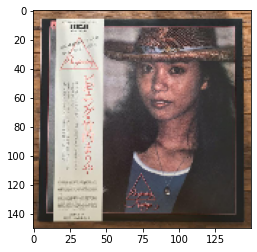

1/1 [==============================] - 0s 41ms/step
[[1.2050896e-08 3.2570458e-06 8.9795839e-07 1.6953640e-05 1.8971333e-13
  6.9713108e-02 3.9654253e-08 4.3548857e-06 7.9023892e-01 3.6132559e-11
  4.3238091e-05 8.0531507e-08 2.6264761e-06 8.3355161e-08 1.7348768e-05
  6.0521829e-06 2.2990123e-06 1.4134205e-05 1.6326047e-09 2.7589969e-13
  1.3725870e-04 9.6673482e-08 2.8581155e-04 7.2498657e-02 2.5185473e-10
  7.9433503e-14 2.0545042e-10 6.1990964e-12 2.6078713e-08 1.7089655e-09
  7.6002036e-03 1.2290562e-04 5.0686076e-02 2.3045068e-04 2.5313204e-07
  3.3099451e-03 5.0067552e-03 3.8838371e-05 8.4043550e-06 5.6948325e-06
  5.4017751e-06]]
Mariya Takeuchi - Beginning , 79.02
6.m83168068380_1.jpg: Mariya Takeuchi - Beginning
--------------------------------------------------------------
4.m80121781767_4.jpg


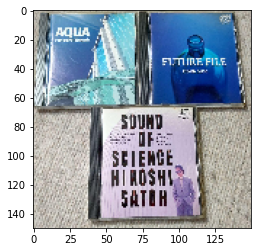

1/1 [==============================] - 0s 34ms/step
[[4.1305740e-32 6.0629304e-26 9.9998319e-01 1.2664175e-17 1.2261361e-29
  0.0000000e+00 0.0000000e+00 1.6835365e-05 1.7139604e-20 5.3248880e-16
  3.6431603e-25 0.0000000e+00 1.9772095e-08 1.5937595e-33 1.9594409e-30
  2.2076234e-33 1.9834386e-15 2.5939614e-19 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 6.7252203e-27 0.0000000e+00 2.4634468e-20
  7.5583457e-33 6.0105493e-12 2.0181839e-27 0.0000000e+00 3.0108080e-13
  1.2643587e-21 1.0828778e-12 5.6283029e-12 2.6277425e-09 0.0000000e+00
  0.0000000e+00 4.0573043e-30 1.7308487e-32 0.0000000e+00 2.1322325e-16
  6.0029104e-26]]
Anri (2) - Timely!! , 100.00
4.m80121781767_4.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
6.m46412031299_2.jpg


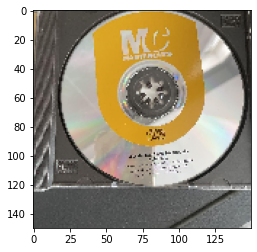

1/1 [==============================] - 0s 37ms/step
[[3.9986374e-19 3.8377114e-13 4.1690250e-03 1.8437890e-10 5.4402332e-13
  1.4137868e-05 2.4165734e-06 8.7477599e-07 7.9637519e-10 8.8965474e-11
  2.0120785e-09 6.7094090e-15 1.0562356e-13 3.0602625e-13 1.1131098e-09
  2.4715124e-01 6.8429991e-04 7.9770343e-11 6.5210766e-12 3.2948401e-12
  2.9523272e-02 4.9889143e-10 6.0721352e-03 7.0343482e-01 3.4287472e-11
  1.0363239e-13 1.9396361e-11 1.9677098e-11 5.3651911e-14 8.2506529e-11
  1.1505191e-05 2.3599127e-07 3.0878250e-04 1.0925507e-04 1.2515018e-11
  7.8870973e-04 7.6618707e-03 3.6076410e-06 1.2854365e-06 3.5012008e-13
  6.2421212e-05]]
Taeko Ohnuki - Sunshower , 70.34
6.m46412031299_2.jpg: Taeko Ohnuki - Sunshower
--------------------------------------------------------------
6.m94447644169_2.jpg


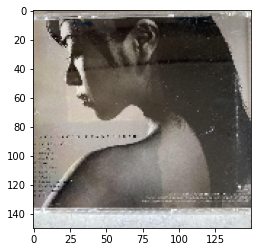

1/1 [==============================] - 0s 40ms/step
[[1.10907602e-29 8.92512694e-20 1.66598818e-10 9.09863932e-17
  7.99729498e-26 9.45636493e-05 4.68528851e-19 7.60595587e-09
  2.59738814e-10 5.53961623e-15 4.57887922e-10 1.93182677e-15
  6.70526216e-23 1.05863469e-11 3.32798895e-25 2.92312122e-20
  1.92736919e-27 8.53590123e-08 1.34365026e-13 2.11540494e-19
  2.65589534e-07 9.83503146e-09 6.36517778e-02 1.17933023e-05
  2.16494048e-21 7.61340230e-24 5.94571998e-17 4.97008337e-20
  2.47928002e-19 1.35174383e-22 9.91481319e-02 3.23398738e-14
  3.28584642e-12 2.59782970e-17 3.39011093e-16 1.09099984e-01
  6.28910214e-02 6.65102422e-01 3.37379485e-10 2.03773153e-12
  6.24645752e-25]]
Utada Hikaru - Deep River , 66.51
6.m94447644169_2.jpg: Utada Hikaru - Deep River
--------------------------------------------------------------
6.m27048747804_1.jpg


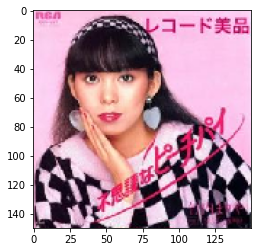

1/1 [==============================] - 0s 40ms/step
[[0.00000000e+00 2.08474408e-32 8.63662253e-10 0.00000000e+00
  0.00000000e+00 3.15125882e-37 0.00000000e+00 9.99997497e-01
  1.00279575e-26 1.30867094e-26 1.20875912e-25 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 1.82121024e-35 0.00000000e+00 0.00000000e+00
  5.12024810e-15 4.69437720e-22 9.68408287e-09 1.41092815e-29
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 1.42140192e-23 2.51482493e-06
  8.43307328e-23 6.08938621e-21 0.00000000e+00 0.00000000e+00
  1.13666110e-30 7.10149670e-15 0.00000000e+00 1.35617836e-28
  0.00000000e+00]]
Hiroshi Sato - Sound Of Science , 100.00
6.m27048747804_1.jpg: Hiroshi Sato - Sound Of Science
--------------------------------------------------------------
4.m58925816668_1.jpg


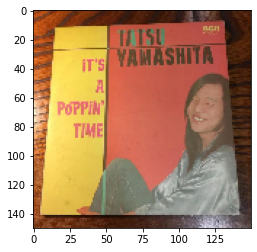

1/1 [==============================] - 0s 32ms/step
[[4.0543020e-11 8.3664001e-04 3.2527121e-30 1.4106296e-15 4.4613076e-22
  2.1729356e-08 1.0734851e-17 5.5856482e-21 3.0461434e-04 8.5540675e-25
  1.9077819e-18 1.1233105e-14 1.3707590e-12 9.0969807e-01 8.3443249e-16
  1.0946163e-24 2.7040946e-21 9.5899810e-16 2.4042197e-20 2.8540334e-22
  4.4736771e-12 7.8749151e-23 3.5797551e-17 2.9006645e-07 2.8457614e-21
  7.1235962e-24 4.4556944e-22 2.9208739e-14 8.9062929e-02 1.7092654e-16
  5.7674390e-07 3.4289301e-19 1.9949741e-13 1.1719313e-12 9.0177891e-05
  1.2216031e-13 3.1794328e-10 2.8839288e-17 6.6047282e-06 6.2427255e-12
  8.3241426e-22]]
Mariya Takeuchi - University Street , 90.97
4.m58925816668_1.jpg: Mariya Takeuchi - University Street
--------------------------------------------------------------
4.m46535537012_1.jpg


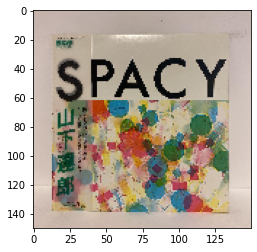

1/1 [==============================] - 0s 39ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 2.7946770e-32 6.4338932e-30 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  5.7155296e-30 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.0000000e+00 3.7745692e-28 1.2586141e-37 1.9920891e-27 0.0000000e+00
  0.0000000e+00]]
Tatsuro Yamashita - Spacy , 100.00
4.m46535537012_1.jpg: Tatsuro Yamashita - Spacy
--------------------------------------------------------------
4.i-img1080x1080-1658190388pgv7sp1020600.jpg


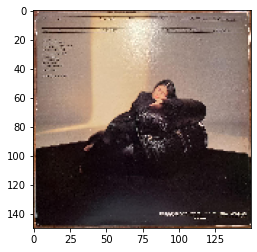

1/1 [==============================] - 0s 34ms/step
[[1.8927801e-26 2.3589065e-23 8.1624156e-09 4.3831954e-22 1.8092431e-16
  1.0127276e-16 4.2892636e-28 5.3891296e-07 2.3296523e-14 9.1179379e-07
  3.3184172e-15 1.9317105e-18 1.8871427e-14 4.7215700e-15 8.3533487e-25
  2.7170417e-24 3.1212619e-26 4.3129677e-15 1.3581629e-20 3.2110212e-17
  3.4583551e-12 1.3614230e-16 1.1424212e-12 1.3508271e-14 2.4519869e-22
  4.5443992e-22 3.7206904e-16 3.2044864e-17 1.4231133e-29 6.1014767e-08
  3.0788776e-08 9.9997544e-01 7.6892089e-19 3.2732814e-08 2.1392673e-20
  2.9700881e-21 1.7862209e-17 6.2668647e-07 1.4495785e-27 2.2304806e-05
  4.4463401e-33]]
Tatsuro Yamashita - On The Street Corner , 100.00
4.i-img1080x1080-1658190388pgv7sp1020600.jpg: Tatsuro Yamashita - On The Street Corner
--------------------------------------------------------------
3.m19330519253_1.jpg


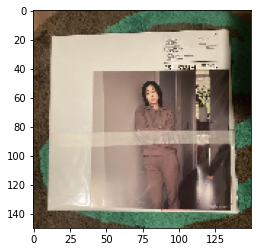

1/1 [==============================] - 0s 32ms/step
[[2.5699864e-24 6.6313675e-16 2.0230100e-07 4.0285490e-11 1.5076965e-24
  1.5620089e-11 1.6010875e-25 3.4226393e-11 7.7349696e-08 2.0124267e-11
  2.0818494e-13 2.8588378e-15 1.2349948e-24 3.9032233e-20 7.1110283e-12
  5.7401981e-23 2.5836857e-19 9.4962328e-18 5.5237492e-23 4.8964048e-15
  8.8436376e-13 3.2405365e-05 9.9986672e-01 1.2595124e-11 1.6486826e-24
  1.3222165e-28 8.1250748e-24 2.2088404e-18 1.0112590e-23 2.6102836e-20
  4.5266435e-05 1.9658472e-10 1.6679185e-14 1.6928549e-05 5.1720065e-16
  3.4845478e-05 2.8707357e-06 5.0873120e-07 1.3256982e-14 1.5883864e-16
  1.6295300e-25]]
Taeko Ohnuki - Romantique , 99.99
3.m19330519253_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
1.m10194343119_1.jpg


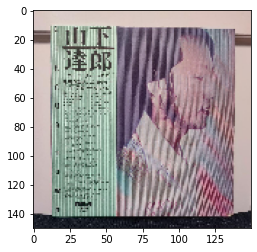

1/1 [==============================] - 0s 48ms/step
[[5.0918021e-18 2.0627980e-11 1.8898066e-10 7.2520406e-14 4.7988534e-20
  8.8235658e-01 4.2198528e-10 2.2977838e-05 1.4347213e-02 6.0602947e-16
  9.3042968e-10 3.0221400e-07 6.8076117e-17 7.0937552e-14 4.3008551e-15
  5.0915729e-09 3.2211248e-11 1.4378490e-09 4.1806433e-11 5.0470858e-13
  9.9129591e-07 2.0356678e-08 1.3136151e-05 3.7142854e-06 9.9992258e-13
  1.5585185e-20 3.3252535e-17 2.8174684e-18 2.3545331e-17 2.8647373e-14
  4.5525044e-06 2.3027680e-05 1.0321998e-01 3.1445804e-06 1.4009799e-13
  5.0177630e-07 3.2095246e-09 3.5632561e-06 5.1779140e-16 3.2448938e-07
  7.9358542e-12]]
Hiroshi Sato - Awakening , 88.24
1.m10194343119_1.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
3.m29872418800_1.jpg


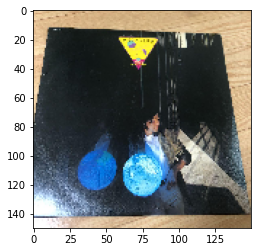

1/1 [==============================] - 0s 39ms/step
[[0.0000000e+00 1.5306808e-30 0.0000000e+00 1.4660820e-33 0.0000000e+00
  5.4071450e-30 0.0000000e+00 2.5139812e-37 2.2706667e-20 2.5949790e-31
  2.9836207e-34 0.0000000e+00 0.0000000e+00 4.7179845e-27 6.2907582e-21
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 2.1859084e-31
  0.0000000e+00 0.0000000e+00 1.5555030e-38 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 2.9326520e-33 1.2951658e-33 8.3269133e-35
  1.0000000e+00 4.3058065e-38 4.3714960e-15 2.7060831e-38 0.0000000e+00
  0.0000000e+00 5.0256529e-30 0.0000000e+00 0.0000000e+00 5.8214838e-29
  0.0000000e+00]]
Tatsuro Yamashita - Moonglow , 100.00
3.m29872418800_1.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
7.m33186481522_4.jpg


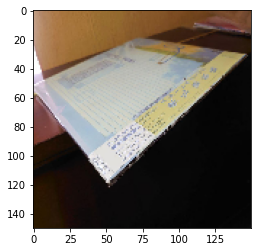

1/1 [==============================] - 0s 33ms/step
[[1.6043011e-33 1.5540436e-22 3.9187801e-20 1.3952360e-24 3.2536736e-25
  9.9211121e-01 3.8992017e-12 9.2466724e-18 3.4720690e-14 1.1540118e-31
  1.1475648e-28 3.9248689e-20 3.5466969e-31 2.2968319e-15 2.4466797e-24
  5.9031176e-09 1.9536190e-17 3.2937444e-12 2.0993564e-13 4.9923810e-23
  7.4906348e-12 2.8455960e-21 1.4676413e-04 7.6408722e-03 1.4513830e-13
  6.3940202e-26 5.9770508e-18 9.3616529e-21 1.5902959e-22 3.7830377e-23
  1.1396193e-08 1.1330477e-16 8.6926275e-14 9.6092517e-05 1.5178974e-17
  5.0948056e-06 1.2601398e-09 3.4105956e-13 1.3812215e-12 2.8478019e-20
  1.5686300e-14]]
Hiroshi Sato - Awakening , 99.21
7.m33186481522_4.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
6.m82275608720_1.jpg


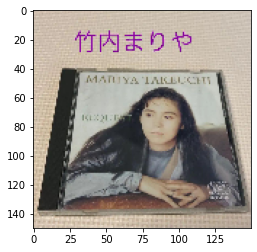

1/1 [==============================] - 0s 43ms/step
[[5.3465500e-04 1.6115483e-10 2.4057408e-04 1.9251471e-02 5.6786813e-13
  6.7391301e-12 9.9263325e-16 2.2503467e-10 1.2508231e-03 8.1472332e-03
  2.8204218e-05 4.1035420e-08 6.0192669e-06 1.7169834e-10 2.1359263e-04
  2.7719533e-09 1.0729223e-07 7.1573186e-10 2.6555417e-16 2.1432600e-15
  2.2343817e-13 2.0876005e-09 9.9325815e-05 1.7220800e-10 3.2820207e-13
  2.1312891e-17 1.1509562e-12 1.4897849e-06 2.2896256e-09 1.4343027e-07
  1.7225124e-04 3.7356281e-07 2.2376276e-09 9.7003484e-01 1.6360586e-10
  1.8009358e-09 1.7574501e-05 1.6487434e-09 1.8009206e-07 1.1629776e-06
  2.8008982e-12]]
Tatsuro Yamashita - Ride On Time , 97.00
6.m82275608720_1.jpg: Tatsuro Yamashita - Ride On Time
--------------------------------------------------------------
6.s819045119.2.jpg


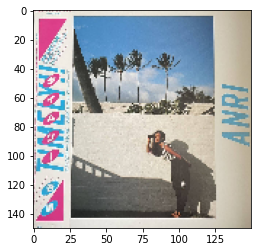

1/1 [==============================] - 0s 44ms/step
[[5.8655978e-28 5.9340409e-27 9.9999940e-01 5.7512653e-07 1.0777448e-22
  3.2416854e-30 1.8403897e-37 1.4759923e-24 2.4679796e-15 1.1092109e-22
  6.9948511e-23 6.5012361e-32 3.1633524e-25 1.1932257e-33 1.6896665e-16
  1.3106470e-18 1.5533345e-12 2.6919925e-26 2.8045256e-37 2.9860982e-36
  2.8973921e-16 4.6118529e-13 2.7040623e-13 4.4532752e-16 6.5054177e-28
  1.1958333e-31 1.5763141e-22 1.5669980e-21 2.4362868e-31 4.0095089e-20
  6.9025033e-15 4.0067587e-19 1.8838661e-24 1.4833998e-14 1.0577834e-28
  1.6141927e-16 3.1701212e-15 3.5322652e-15 1.6575156e-17 1.0307108e-25
  1.9865156e-29]]
Anri (2) - Timely!! , 100.00
6.s819045119.2.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
6.m41462312305_1.jpg


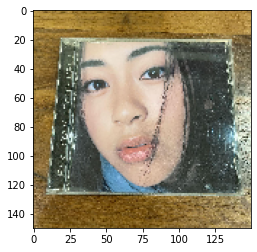

1/1 [==============================] - 0s 30ms/step
[[3.06643743e-24 5.14946419e-11 1.62024249e-26 2.96226632e-14
  2.95510699e-35 9.65969741e-01 3.09218525e-13 3.94132886e-20
  3.12512182e-02 5.26086399e-33 2.28666183e-14 7.24581195e-09
  3.96179932e-20 4.73663135e-07 5.90900540e-22 2.22836336e-18
  4.77196551e-16 3.20984226e-21 2.89973075e-20 6.98991347e-24
  1.98914183e-08 1.21521570e-25 1.97043308e-21 1.60931068e-05
  4.79084745e-22 4.48913716e-34 2.86712359e-31 2.88907148e-23
  8.63034436e-11 1.30699406e-23 2.48886994e-03 4.35031773e-22
  2.73318001e-04 2.51394509e-19 1.06552874e-17 9.79361592e-10
  8.18960039e-14 1.44319218e-14 5.32715738e-09 1.45536672e-13
  2.57414172e-07]]
Hiroshi Sato - Awakening , 96.60
6.m41462312305_1.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
3.61oyigs2iel._sx466_.jpg


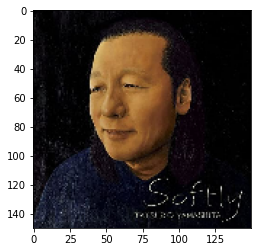

1/1 [==============================] - 0s 35ms/step
[[4.9255186e-36 4.2142190e-05 0.0000000e+00 1.5012537e-35 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 7.2049100e-13 0.0000000e+00
  0.0000000e+00 0.0000000e+00 6.8362142e-36 9.1608859e-22 1.6722143e-37
  0.0000000e+00 7.3629412e-38 9.9875900e-27 0.0000000e+00 0.0000000e+00
  1.3752153e-31 2.7706422e-26 4.9741102e-25 6.0990515e-20 0.0000000e+00
  0.0000000e+00 0.0000000e+00 5.9498175e-35 2.7564238e-24 8.3825767e-23
  9.5925654e-18 2.9836469e-24 3.6574945e-32 1.4942829e-28 9.9995780e-01
  1.5032710e-35 1.4672459e-25 4.6039353e-32 1.5474421e-30 0.0000000e+00
  0.0000000e+00]]
Tatsuro Yamashita - Softly , 100.00
3.61oyigs2iel._sx466_.jpg: Tatsuro Yamashita - Softly
--------------------------------------------------------------
3.m15882643816_1.jpg


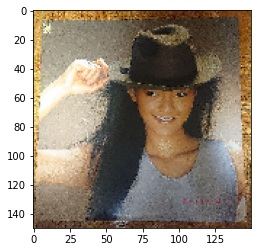

1/1 [==============================] - 0s 45ms/step
[[9.97293770e-01 4.50269013e-08 9.19996936e-27 7.02410489e-06
  7.23629432e-30 3.93577536e-23 8.43857625e-25 1.35958810e-28
  2.65539857e-03 3.73181706e-18 9.63974655e-14 1.36262495e-14
  3.98665774e-13 3.55180577e-12 4.29836437e-05 2.30423940e-28
  2.27300042e-15 9.48844596e-30 2.21850681e-32 1.72798878e-21
  5.07246501e-31 8.70034503e-23 6.53428255e-22 1.31188742e-24
  1.64994659e-29 2.06408170e-35 3.96045054e-35 1.27799309e-08
  5.37285302e-07 3.54288437e-14 1.61732128e-10 9.78645555e-25
  2.74185839e-13 2.88678125e-13 2.73553678e-14 8.85198078e-27
  8.96016399e-17 7.53846069e-30 2.00663732e-13 8.46508888e-15
  1.03944011e-25]]
Anri (2) - Bi・Ki・Ni , 99.73
3.m15882643816_1.jpg: Anri (2) - Bi・Ki・Ni
--------------------------------------------------------------
7.m26164114568_1.jpg


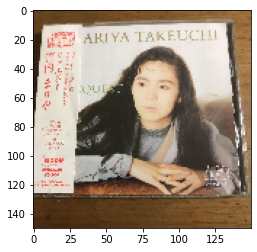

1/1 [==============================] - 0s 35ms/step
[[1.01786609e-17 3.63885106e-18 5.24744123e-20 2.62738672e-15
  1.29827342e-27 1.22657298e-06 3.42929274e-24 1.08988454e-13
  3.37088727e-06 9.80099474e-11 1.48179611e-11 9.96311963e-01
  2.16672500e-17 2.19021680e-14 1.59254214e-19 6.00345008e-28
  1.73275160e-23 8.60045315e-23 3.04230981e-19 7.24938208e-12
  8.94388741e-09 2.11298531e-15 1.55666675e-18 1.62705537e-12
  8.65687890e-21 7.29095387e-31 1.70067896e-28 7.14346560e-18
  1.25130819e-26 2.82348849e-11 3.36314784e-03 2.16587364e-06
  1.74011055e-12 3.93569392e-17 2.34543821e-22 1.94597942e-15
  1.36434403e-16 8.28725533e-08 1.30907327e-22 3.17996251e-04
  3.41395080e-27]]
Mariya Takeuchi - Request , 99.63
7.m26164114568_1.jpg: Mariya Takeuchi - Request
--------------------------------------------------------------
2.m72064985680_2.jpg


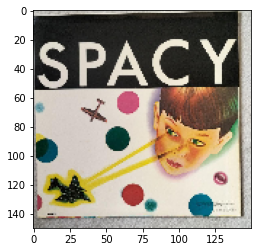

1/1 [==============================] - 0s 33ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 1.3967606e-38 0.0000000e+00
  1.1812276e-36 0.0000000e+00 0.0000000e+00 6.4672967e-34 1.0695909e-37
  0.0000000e+00 2.7003139e-34 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  2.4727884e-29 5.2616767e-23 4.6549482e-20 6.3355271e-36 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  7.8039915e-20 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.0000000e+00 1.2038265e-22 7.0713413e-24 1.0686099e-26 0.0000000e+00
  0.0000000e+00]]
Tatsuro Yamashita - Spacy , 100.00
2.m72064985680_2.jpg: Tatsuro Yamashita - Spacy
--------------------------------------------------------------
4.ohnuki2_c59bc90f-f093-4106-9274-5f8d247c2f35_1200x1200.jpg


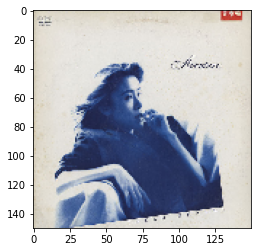

1/1 [==============================] - 0s 46ms/step
[[1.2793802e-28 2.0149888e-30 4.9061633e-35 2.5288724e-33 4.3461546e-28
  9.9939620e-01 3.5605895e-05 1.6763553e-25 3.8000901e-11 1.3710764e-23
  9.0232991e-20 4.6609609e-11 1.9950567e-30 2.8215573e-27 3.5328856e-21
  5.7896342e-20 3.8545180e-22 5.4983593e-18 5.6810031e-04 6.8672471e-13
  1.6913141e-26 1.7259794e-29 3.7686934e-21 3.6764919e-22 1.7414318e-14
  3.2189845e-23 5.5952989e-29 8.9752219e-31 2.0335569e-33 1.3818239e-24
  1.3946025e-12 6.4713411e-25 7.2618313e-08 1.2800673e-15 1.1614103e-28
  2.9059424e-19 1.1724699e-17 2.3638751e-27 3.7487723e-31 1.8937524e-22
  3.6282215e-19]]
Hiroshi Sato - Awakening , 99.94
4.ohnuki2_c59bc90f-f093-4106-9274-5f8d247c2f35_1200x1200.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
5.m56606700574_1.jpg


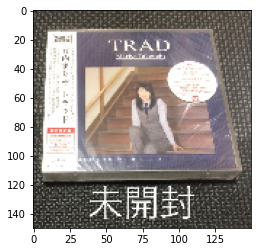

1/1 [==============================] - 0s 34ms/step
[[5.7692031e-22 2.6361775e-07 1.2567866e-08 3.1506658e-16 8.2129962e-22
  3.3795902e-09 3.8588554e-20 9.7491121e-01 1.1895818e-06 5.4882093e-10
  7.6588816e-03 6.0157527e-14 9.3884915e-13 3.3653692e-12 1.6089316e-17
  4.9717215e-19 2.9442641e-20 1.4329056e-14 1.0519686e-16 4.3740180e-15
  9.3179122e-05 2.2831786e-10 2.0777950e-05 1.4667045e-10 2.3006420e-22
  4.2814183e-25 5.9142735e-20 1.4510140e-21 8.1318366e-17 7.5664898e-13
  2.6453546e-07 1.7072506e-02 1.7805574e-05 9.4816177e-10 1.1415108e-13
  3.9280436e-16 5.0200777e-09 1.9238164e-06 1.6381244e-19 2.2193372e-04
  5.3933819e-25]]
Hiroshi Sato - Sound Of Science , 97.49
5.m56606700574_1.jpg: Hiroshi Sato - Sound Of Science
--------------------------------------------------------------
7.m27280358170_4.jpg


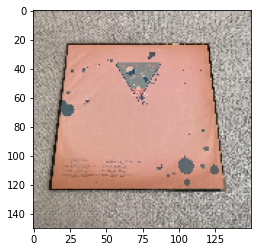

1/1 [==============================] - 0s 30ms/step
[[1.36582168e-09 2.14893639e-01 3.71293335e-14 4.45669022e-04
  3.34011154e-22 1.86377686e-19 7.95721530e-25 1.35268718e-21
  8.09515186e-04 2.00069389e-18 1.77157024e-18 4.13098409e-14
  6.12132076e-15 1.60915226e-10 1.63346058e-07 2.34702624e-21
  8.83320313e-14 9.84701953e-16 2.60346902e-27 6.06538510e-26
  4.49767825e-16 8.85809186e-06 2.93437026e-08 8.27574391e-13
  1.27539246e-16 2.78852747e-26 4.20316370e-19 1.26346835e-08
  1.55323778e-06 6.42282126e-13 5.36597554e-06 4.06081690e-17
  3.21617021e-14 1.35246382e-12 1.15077046e-03 6.18476479e-04
  7.45866710e-05 4.70603211e-13 7.81991243e-01 4.73793049e-18
  5.63943566e-24]]
Utada Hikaru - First Love , 78.20
7.m27280358170_4.jpg: Utada Hikaru - First Love
--------------------------------------------------------------
2.m43969228477_1.jpg


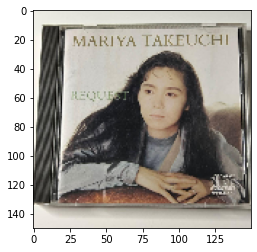

1/1 [==============================] - 0s 37ms/step
[[6.12300265e-17 2.96173190e-21 4.88900288e-04 6.41866862e-08
  6.26543876e-15 1.14718898e-06 1.28148242e-20 3.30788161e-08
  2.13639684e-08 8.87354553e-01 3.33030948e-05 1.59000920e-03
  3.41367044e-13 1.93245174e-17 2.10744491e-14 3.04146560e-14
  7.34775356e-18 7.46875218e-13 4.87144342e-13 3.90092225e-09
  1.67993193e-07 6.23014694e-06 2.33288858e-07 3.06896664e-09
  1.04711927e-16 6.81393959e-18 1.63210014e-16 2.18747762e-15
  1.22594996e-23 6.41716194e-12 2.78878379e-05 3.82812507e-03
  9.15888997e-16 7.23503035e-09 1.66137562e-20 2.69798139e-08
  1.04037823e-09 1.02966882e-01 1.96192929e-13 3.70244985e-03
  1.80710328e-21]]
Mariya Takeuchi - Love Songs , 88.74
2.m43969228477_1.jpg: Mariya Takeuchi - Love Songs
--------------------------------------------------------------
1.m13469745305_1.jpg


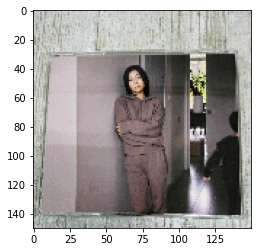

1/1 [==============================] - 0s 37ms/step
[[1.7983934e-28 4.1976987e-17 1.1003002e-14 1.3638960e-13 1.4583247e-34
  8.3383931e-22 0.0000000e+00 6.4965517e-21 2.5267144e-07 4.1341991e-12
  4.2802911e-19 4.0528864e-18 5.1731628e-29 2.9481093e-28 6.7026094e-13
  0.0000000e+00 3.1412060e-27 2.6540377e-25 2.5697484e-36 1.2371053e-22
  9.7981216e-21 1.3670321e-05 9.9997866e-01 1.9013828e-19 8.8696781e-36
  0.0000000e+00 4.3653661e-32 1.0760522e-19 1.5772801e-29 1.6446496e-27
  8.0680858e-09 1.2709071e-18 2.3429431e-22 6.1228557e-11 7.9719469e-16
  5.1452080e-06 2.2695563e-06 2.4029363e-15 3.1062233e-18 2.3915351e-28
  1.3098269e-38]]
Taeko Ohnuki - Romantique , 100.00
1.m13469745305_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
6.m88299889385_2.jpg


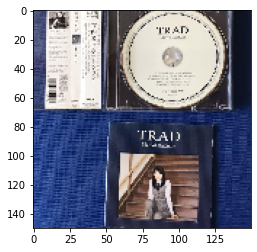

1/1 [==============================] - 0s 32ms/step
[[1.36742554e-31 4.73527761e-25 1.42929220e-18 2.49019802e-19
  4.19365433e-18 1.88493266e-06 2.73751243e-21 2.19460297e-10
  1.23710341e-13 4.00860038e-08 9.93542910e-01 3.87436245e-07
  2.83347682e-20 9.41253827e-21 1.71626045e-25 6.84042060e-26
  9.60883219e-31 3.25677072e-22 3.32281008e-11 6.45475090e-03
  2.53526178e-08 4.58478402e-14 2.85752203e-11 9.74369627e-18
  9.77019623e-33 4.19606223e-22 1.90769909e-27 4.10582957e-27
  1.20940635e-26 1.66000397e-30 2.49791209e-13 2.16208598e-19
  1.41341474e-13 2.64389935e-23 8.42101544e-27 1.61794863e-14
  6.32555098e-13 1.14113219e-10 1.47502847e-18 5.07175191e-09
  3.22942740e-31]]
Mariya Takeuchi - Miss M , 99.35
6.m88299889385_2.jpg: Mariya Takeuchi - Miss M
--------------------------------------------------------------
1.m30985902201_1.jpg


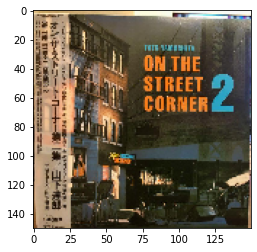

1/1 [==============================] - 0s 38ms/step
[[3.49458560e-34 2.81395810e-03 4.44621540e-09 1.03496186e-19
  0.00000000e+00 4.75871044e-11 0.00000000e+00 6.13565732e-08
  7.34979636e-04 3.61743146e-27 2.28829868e-22 5.63099551e-31
  1.01711229e-23 2.04804428e-06 1.15410424e-25 1.27488417e-22
  1.20978345e-22 2.18689823e-11 2.31265949e-37 0.00000000e+00
  4.91077060e-07 1.30745352e-08 1.20022421e-04 4.27809056e-07
  4.80198893e-31 0.00000000e+00 3.79361484e-25 1.94854607e-23
  4.94817282e-22 1.51939128e-12 3.84575158e-01 5.79305589e-01
  2.37118183e-14 5.97464345e-09 1.27901565e-02 4.74372630e-09
  2.44371147e-12 1.96570475e-02 2.10335858e-20 1.76662007e-09
  5.70525028e-29]]
Tatsuro Yamashita - On The Street Corner , 57.93
1.m30985902201_1.jpg: Tatsuro Yamashita - On The Street Corner
--------------------------------------------------------------
4.m17567061299_1.jpg


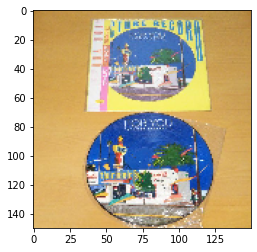

1/1 [==============================] - 0s 49ms/step
[[1.37127199e-22 0.00000000e+00 0.00000000e+00 6.69693883e-35
  0.00000000e+00 2.08523807e-06 5.46395671e-23 0.00000000e+00
  9.17357445e-01 0.00000000e+00 1.45144376e-37 2.63347585e-13
  1.46895732e-28 1.18780136e-07 8.55581017e-29 0.00000000e+00
  0.00000000e+00 0.00000000e+00 7.16074928e-26 7.69661331e-12
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 1.41898911e-23
  1.59743485e-37 7.44328208e-24 1.38000614e-04 0.00000000e+00
  1.73387434e-06 1.29716754e-34 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 8.25006217e-02
  0.00000000e+00]]
Mariya Takeuchi - Beginning , 91.74
4.m17567061299_1.jpg: Mariya Takeuchi - Beginning
--------------------------------------------------------------
6.m31085431462_2.jpg


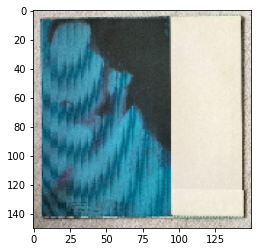

1/1 [==============================] - 0s 34ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.5131198e-29
  1.0000000e+00 3.1378893e-31 0.0000000e+00 6.8699063e-23 0.0000000e+00
  1.2968889e-29 4.2278019e-20 0.0000000e+00 2.8890334e-35 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 4.8032533e-16 6.3652012e-14
  2.2001948e-33 0.0000000e+00 0.0000000e+00 2.7360804e-31 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  2.6480905e-30 0.0000000e+00 1.0404806e-18 0.0000000e+00 0.0000000e+00
  0.0000000e+00 2.5637513e-29 0.0000000e+00 0.0000000e+00 2.1024157e-24
  0.0000000e+00]]
Hiroshi Sato - Awakening , 100.00
6.m31085431462_2.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
7.m59955707890_1.jpg


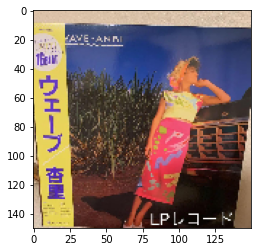

1/1 [==============================] - 0s 34ms/step
[[4.9631172e-18 4.0197732e-27 2.5687601e-13 1.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 2.1451516e-15 1.4668349e-36
  0.0000000e+00 4.0084775e-32 4.3681866e-34 0.0000000e+00 2.2304427e-23
  5.6053232e-30 1.6074098e-16 1.0790835e-35 0.0000000e+00 0.0000000e+00
  0.0000000e+00 3.2400437e-11 2.0117763e-27 0.0000000e+00 1.0438142e-29
  0.0000000e+00 0.0000000e+00 1.7602473e-19 2.0108667e-31 9.4956583e-24
  3.3764568e-16 3.5087652e-30 0.0000000e+00 1.6452043e-21 8.6424108e-29
  2.3109742e-23 9.0135742e-35 3.0013857e-25 5.0068108e-20 1.6076000e-31
  0.0000000e+00]]
Anri (2) - Wave , 100.00
7.m59955707890_1.jpg: Anri (2) - Wave
--------------------------------------------------------------
2.m12497127115_1.jpg


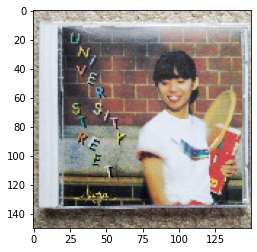

1/1 [==============================] - 0s 35ms/step
[[1.4347087e-15 1.1070837e-06 2.6439411e-12 2.3209201e-17 3.7862714e-17
  3.0201100e-04 1.2665705e-15 1.6054265e-06 1.7683667e-03 7.6222976e-16
  7.5047841e-12 1.1957430e-12 6.3313625e-09 1.3221462e-01 1.0820242e-17
  1.4255390e-10 1.4812441e-17 5.5948441e-04 1.3801509e-12 9.0189699e-21
  3.4292921e-10 4.1209373e-11 3.7857124e-11 6.6844970e-09 8.8609667e-15
  2.3131473e-20 1.7846031e-13 2.6001307e-13 8.3061542e-15 2.2805179e-06
  1.8809737e-05 9.8015703e-03 9.1632182e-06 1.3929350e-08 6.2159655e-05
  7.9092982e-11 4.3893456e-10 8.0862337e-06 3.0478040e-16 8.5525072e-01
  3.7193734e-18]]
Various - Classic Jazz-Funk Mastercuts Volume 7 , 85.53
2.m12497127115_1.jpg: Various - Classic Jazz-Funk Mastercuts Volume 7
--------------------------------------------------------------
4.m16386192707_1.jpg


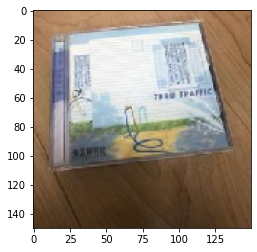

1/1 [==============================] - 0s 37ms/step
[[3.7126945e-13 4.4148658e-17 1.2555125e-07 3.9044538e-05 1.3354270e-13
  3.4626912e-02 8.0209683e-14 3.1373688e-21 5.3040138e-03 2.0079428e-21
  1.5623870e-20 1.9824881e-02 6.0007217e-20 4.8948806e-13 2.4273381e-16
  4.6692243e-01 2.1112278e-07 7.4376445e-08 3.1897249e-17 7.4267681e-20
  2.9444271e-16 7.0768615e-06 3.9035131e-10 3.1453403e-12 1.9030648e-04
  7.8182326e-22 2.0898112e-13 7.3208263e-08 8.9526327e-17 1.6485668e-13
  6.1354808e-06 1.4210559e-13 4.4255100e-15 1.4597116e-01 4.7413679e-13
  3.2708669e-01 2.4553924e-13 4.1675293e-07 2.0473673e-05 4.9003086e-09
  2.5248998e-08]]
Momoko Kikuchi - Escape From Dimension , 46.69
4.m16386192707_1.jpg: Momoko Kikuchi - Escape From Dimension
--------------------------------------------------------------
6.m31698193670_1.jpg


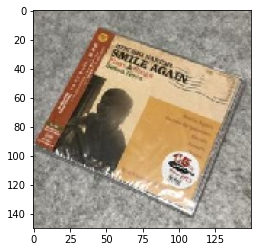

1/1 [==============================] - 0s 38ms/step
[[1.5970889e-08 9.4258738e-01 6.5296097e-16 5.7045378e-07 6.6748290e-22
  6.1654771e-18 1.5413479e-21 7.4689731e-17 1.0731413e-04 2.1707656e-13
  2.6932729e-17 1.0078284e-16 4.2874390e-15 7.6554372e-09 5.2910646e-06
  3.6373398e-24 4.7204513e-14 4.7499982e-16 7.8820726e-24 1.1922659e-21
  1.2080807e-11 2.2196826e-08 4.8940441e-05 6.5330383e-08 1.8116378e-16
  3.3751868e-23 2.1877117e-17 3.2067913e-08 3.6445730e-03 1.5498941e-10
  1.0391620e-03 1.0297403e-13 2.7415714e-14 1.6929790e-09 5.1238615e-02
  7.9350866e-07 1.1557961e-03 6.4288570e-12 1.7147392e-04 1.1323993e-20
  2.5010598e-23]]
Anri (2) - Coool , 94.26
6.m31698193670_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
6.m25697902435_1.jpg


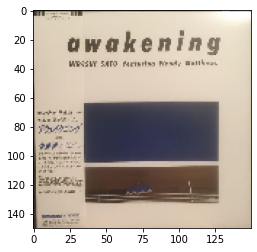

1/1 [==============================] - 0s 37ms/step
[[1.89226747e-18 1.35109290e-13 7.04333391e-15 1.47875368e-14
  2.80156994e-15 9.99902725e-01 8.05078741e-07 1.29071490e-10
  2.40451499e-07 1.03267802e-16 1.05429505e-10 2.75428693e-08
  5.66171504e-18 5.61678308e-12 4.82215857e-14 1.01220818e-08
  1.15416088e-11 2.32260999e-11 1.43682132e-06 4.42194892e-10
  1.43338059e-06 2.28725645e-14 1.97433053e-07 7.22479890e-05
  2.01361254e-11 3.11020266e-14 4.08569629e-14 1.50544648e-16
  7.12217320e-15 1.14872676e-16 9.99493039e-08 2.58125471e-13
  1.90608680e-05 2.06310857e-09 1.24066932e-14 1.04665537e-06
  6.80309597e-07 7.65548602e-09 3.51306040e-10 4.61966706e-12
  5.91996763e-09]]
Hiroshi Sato - Awakening , 99.99
6.m25697902435_1.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
2.m79157744119_1.jpg


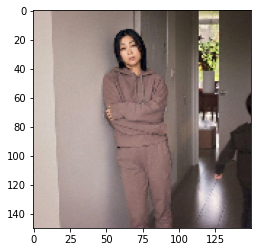

1/1 [==============================] - 0s 42ms/step
[[1.3158192e-34 1.6637511e-19 4.8199156e-21 2.5879408e-19 1.3606825e-35
  6.7658075e-16 1.7439714e-31 1.0643245e-25 6.0058473e-12 9.6513287e-22
  3.1600614e-21 4.8061756e-16 5.7981801e-36 2.8128850e-25 1.4727878e-19
  1.4305174e-33 4.0604666e-27 9.9163997e-25 4.1744103e-28 2.6215660e-26
  1.0415154e-17 8.9301726e-15 1.0878294e-04 5.4522632e-16 7.2160912e-28
  6.6844676e-36 2.8440177e-29 2.7893281e-22 1.2271785e-22 6.7237336e-33
  1.4293859e-10 6.9789604e-29 6.3012189e-20 7.0256880e-19 1.8030859e-20
  9.8905283e-01 1.0838333e-02 7.8711073e-17 2.9169775e-09 1.8575935e-33
  3.8787033e-30]]
Tatsuro Yamashita - Spacy , 98.91
2.m79157744119_1.jpg: Tatsuro Yamashita - Spacy
--------------------------------------------------------------
3.m84881049402_1.jpg


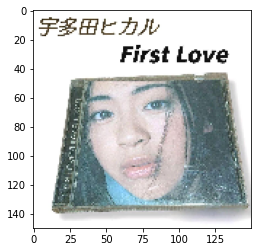

1/1 [==============================] - 0s 43ms/step
[[0.0000000e+00 4.3591830e-33 2.0296795e-23 1.4833690e-26 0.0000000e+00
  1.0182155e-14 4.2489127e-37 5.3987086e-25 2.8795821e-20 5.6009327e-33
  5.4052560e-27 1.0513449e-18 0.0000000e+00 6.8342599e-36 1.6647362e-37
  1.0590637e-36 0.0000000e+00 5.5994604e-25 5.2267915e-29 2.5256363e-33
  1.4164226e-20 1.5985426e-17 3.5791683e-09 1.2642484e-23 6.1357455e-32
  0.0000000e+00 4.9725405e-31 0.0000000e+00 3.9676331e-38 0.0000000e+00
  2.3048987e-16 4.8839645e-36 1.5100511e-23 1.2951671e-31 8.9366097e-35
  1.0000000e+00 2.9573312e-12 9.7981641e-17 9.8749318e-18 3.9153013e-35
  4.7271168e-35]]
Tatsuro Yamashita - Spacy , 100.00
3.m84881049402_1.jpg: Tatsuro Yamashita - Spacy
--------------------------------------------------------------
7.m42383447044_4.jpg


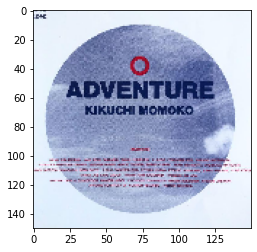

1/1 [==============================] - 0s 40ms/step
[[3.6279951e-16 5.3953524e-17 6.7183410e-09 1.2470754e-09 3.4694548e-07
  1.1309225e-03 5.6008302e-02 3.6024166e-14 2.7597797e-09 2.0105165e-13
  9.1222125e-07 7.3930569e-04 8.8035192e-15 4.2425949e-22 3.3698461e-06
  2.5406459e-04 2.5729220e-02 1.3135287e-13 7.9018519e-06 1.4746393e-05
  1.6290993e-11 3.8154793e-13 3.2388058e-08 2.8429983e-10 6.7770393e-06
  3.0946254e-04 6.3484679e-10 7.8727729e-17 1.3158293e-15 7.0544940e-18
  3.0287176e-10 8.6340202e-18 5.1205880e-05 2.9482503e-09 3.4662635e-20
  3.8019857e-07 1.7914025e-04 4.8215936e-15 1.2996865e-07 1.1604210e-18
  9.1556382e-01]]
東北新幹線 - Thru Traffic , 91.56
7.m42383447044_4.jpg: 東北新幹線 - Thru Traffic
--------------------------------------------------------------
7.m85636699149_1.jpg


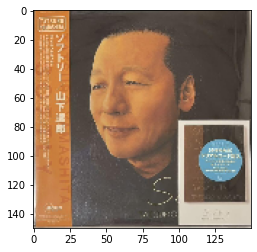

1/1 [==============================] - 0s 33ms/step
[[3.66895256e-05 8.80297244e-01 1.51653993e-21 6.34727257e-08
  4.20417906e-32 2.98243730e-25 4.79377714e-27 1.01756499e-24
  1.34966022e-05 4.60147174e-18 5.72333280e-16 1.29311176e-17
  3.95925477e-15 3.12521120e-09 9.58616624e-07 1.31714703e-26
  2.50222233e-13 1.19151612e-24 3.58022564e-34 1.05013266e-27
  3.11623837e-22 1.11407729e-17 6.88854442e-12 7.60333501e-14
  1.41210182e-25 2.62445001e-34 1.46191901e-27 1.00206296e-06
  1.19480826e-01 6.94614505e-13 3.85043064e-09 6.47530797e-21
  3.76054339e-18 2.97848213e-09 1.37639272e-05 7.46674048e-16
  2.85309852e-06 4.07313940e-23 1.53051587e-04 1.00728950e-21
  3.88306408e-21]]
Anri (2) - Coool , 88.03
7.m85636699149_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
6.m33835905678_1.jpg


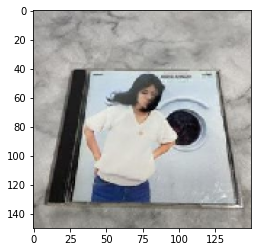

1/1 [==============================] - 0s 32ms/step
[[2.3382167e-15 1.5181439e-11 1.1444250e-02 3.4846032e-08 1.4795004e-16
  2.0477941e-07 4.3738147e-12 1.7126338e-03 7.9751571e-06 6.9642958e-11
  3.3271615e-05 5.3201098e-15 3.8487789e-11 2.6366382e-17 1.2093565e-08
  9.2664033e-07 4.1034954e-07 2.1964678e-11 4.8453244e-16 2.3324439e-15
  4.5164743e-06 7.9097362e-08 9.6568698e-01 3.0097412e-05 1.3649835e-15
  6.9215336e-19 1.5243518e-13 3.4712995e-17 2.8509537e-15 7.2636813e-13
  3.4588609e-06 4.3074004e-05 2.6315410e-04 2.0559378e-02 4.5909256e-13
  2.3084992e-08 2.0837820e-04 1.2138919e-06 6.6657608e-12 1.0830292e-11
  1.0574417e-09]]
Taeko Ohnuki - Romantique , 96.57
6.m33835905678_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
5.m16868568895_1.jpg


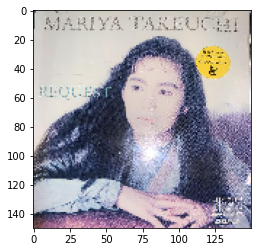

1/1 [==============================] - 0s 37ms/step
[[1.8391963e-16 1.3213161e-17 1.6781164e-18 2.7777290e-14 3.2707394e-16
  8.6003533e-09 4.1494390e-12 2.9641230e-17 1.7755396e-11 6.2489458e-11
  1.5631249e-09 1.0000000e+00 7.7430145e-15 5.5791762e-20 1.4289793e-11
  8.2684819e-20 7.6813477e-12 3.0150245e-21 9.9950439e-12 1.2077862e-08
  1.8415449e-12 1.1100476e-18 1.9689645e-18 2.9732435e-14 1.7442549e-12
  6.8503010e-13 4.1147079e-19 1.5912818e-20 9.6452537e-19 2.2342497e-15
  1.5910670e-08 7.3038830e-17 5.2812477e-10 1.3095633e-18 4.7659300e-23
  9.0772252e-15 1.3553583e-11 2.0484089e-16 3.1473405e-13 1.9899896e-15
  1.8571559e-13]]
Mariya Takeuchi - Request , 100.00
5.m16868568895_1.jpg: Mariya Takeuchi - Request
--------------------------------------------------------------
7.m21873272188_1.jpg


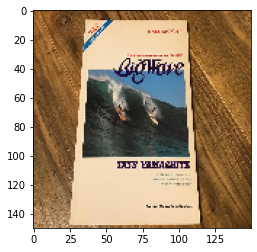

1/1 [==============================] - 0s 37ms/step
[[9.0399869e-17 4.0340626e-15 1.6608670e-08 5.4435483e-09 6.3657248e-22
  7.7186750e-11 1.0250262e-22 2.0150548e-14 2.6337167e-07 5.3259319e-10
  1.2404233e-15 8.7352280e-05 7.1603520e-20 1.6234411e-06 8.9745774e-22
  4.5650013e-13 1.4605601e-17 1.7894766e-11 4.6623786e-24 1.8675450e-15
  1.3983153e-12 1.3916275e-03 5.7371111e-05 1.9015690e-12 1.6285148e-17
  4.2106631e-31 7.4851978e-21 2.4129919e-04 9.5198022e-16 4.6065633e-14
  6.3385443e-05 1.1927547e-09 1.7445424e-19 9.6875507e-01 3.1447911e-10
  2.8812692e-02 6.9373400e-12 5.8765610e-04 4.1082668e-10 1.6349260e-06
  4.8139811e-22]]
Tatsuro Yamashita - Ride On Time , 96.88
7.m21873272188_1.jpg: Tatsuro Yamashita - Ride On Time
--------------------------------------------------------------
4.m80790109404_1.jpg


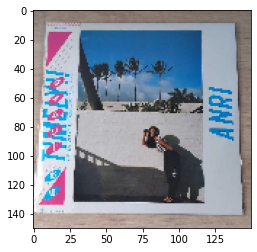

1/1 [==============================] - 0s 41ms/step
[[0.0000000e+00 0.0000000e+00 1.0000000e+00 1.7468586e-23 3.0720034e-37
  0.0000000e+00 0.0000000e+00 6.4474297e-38 2.0129857e-38 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  9.6714914e-33 3.4659906e-33 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 6.5473630e-38 2.6175455e-25 0.0000000e+00 0.0000000e+00
  0.0000000e+00 5.5014154e-38 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 2.4798764e-19 0.0000000e+00
  0.0000000e+00 2.2725002e-38 1.3220142e-36 0.0000000e+00 0.0000000e+00
  0.0000000e+00]]
Anri (2) - Timely!! , 100.00
4.m80790109404_1.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
6.m12386636277_3.jpg


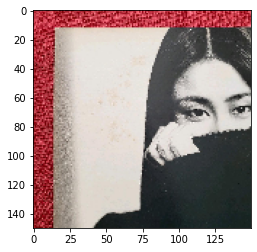

1/1 [==============================] - 0s 38ms/step
[[2.2804596e-13 3.7817910e-14 7.0132572e-08 2.3716457e-10 2.9700321e-18
  4.6667376e-10 3.3496490e-15 7.9632391e-11 2.8633388e-06 6.3093308e-09
  1.5451494e-11 1.3826872e-15 2.0863157e-12 3.4072502e-11 9.1616087e-08
  3.3825213e-11 2.8307567e-10 1.3380357e-09 7.1436345e-15 3.1758373e-16
  4.1615617e-12 2.3745776e-11 2.0394723e-04 5.1545038e-07 1.4062112e-12
  8.5781504e-19 1.7521070e-14 1.9982662e-09 2.2094350e-15 3.4015391e-09
  2.8787663e-05 1.0216016e-06 6.8528133e-10 9.9971861e-01 4.8688542e-10
  4.8621706e-07 4.3618107e-05 3.5774086e-10 2.0336161e-10 1.1373233e-09
  9.8428420e-14]]
Tatsuro Yamashita - Ride On Time , 99.97
6.m12386636277_3.jpg: Tatsuro Yamashita - Ride On Time
--------------------------------------------------------------
3.m88760730615_1.jpg


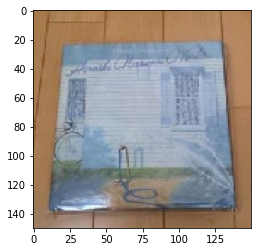

1/1 [==============================] - 0s 44ms/step
[[4.5481876e-21 5.0423084e-19 2.4685050e-13 1.9433476e-13 5.9578462e-12
  7.7867270e-01 3.3748051e-06 3.3383611e-19 3.4198558e-04 1.0390254e-24
  2.0117340e-15 2.4981264e-06 2.0352134e-24 9.8036599e-16 8.3002785e-18
  2.2095409e-01 1.0808349e-07 2.3188762e-12 6.5637273e-08 1.3431424e-13
  4.0437522e-14 2.8163399e-15 1.4380405e-10 2.7727747e-09 1.2761820e-12
  8.0529235e-17 5.0834289e-18 2.7726543e-12 7.0193538e-18 1.1203506e-18
  6.3042530e-11 4.5786611e-17 2.2266217e-07 1.8286004e-05 9.7694115e-19
  6.9173001e-09 4.3861755e-12 2.5527372e-14 7.3906246e-13 4.0760160e-12
  6.6875268e-06]]
Hiroshi Sato - Awakening , 77.87
3.m88760730615_1.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
7.m40165340782_1.jpg


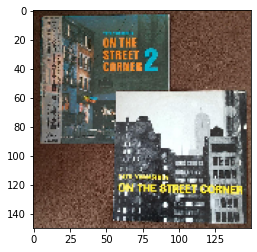

1/1 [==============================] - 0s 32ms/step
[[2.3536896e-23 7.1036571e-23 9.9929893e-01 1.1886265e-08 1.6454667e-16
  1.5161981e-17 1.8724303e-35 4.9607131e-08 4.9456695e-13 3.7006120e-09
  5.2791129e-11 1.6394214e-15 7.5961200e-16 8.5804632e-21 1.6138502e-23
  4.3092541e-18 1.1267921e-21 3.4373500e-13 3.6785536e-26 4.9839414e-22
  2.5613762e-15 3.1188412e-07 1.0507139e-07 9.0615222e-23 3.5601954e-20
  4.2590842e-25 1.3038337e-15 7.6628510e-17 7.3660388e-30 5.8599116e-17
  2.5341562e-13 6.2359877e-06 2.2798758e-21 1.9632589e-06 1.5388829e-24
  3.5640463e-17 3.9847705e-18 8.8406148e-07 3.9608157e-23 6.9141592e-04
  2.1339541e-31]]
Anri (2) - Timely!! , 99.93
7.m40165340782_1.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
2.m43379398272_3.jpg


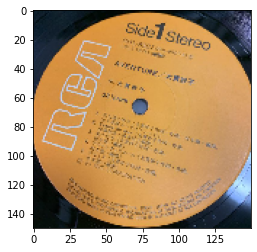

1/1 [==============================] - 0s 36ms/step
[[1.92594977e-17 1.82986785e-12 1.42491732e-20 1.02325054e-17
  1.57686281e-25 2.19479390e-09 1.37599393e-25 8.01934204e-25
  4.25319779e-09 6.41249690e-28 7.90372426e-32 2.28097351e-22
  2.39576672e-18 6.49553239e-02 2.39235967e-26 6.09364339e-13
  1.22395938e-19 1.75546504e-07 2.19989396e-28 8.33713112e-35
  2.99261939e-12 1.68869211e-15 7.33555296e-19 6.40034341e-06
  6.19302895e-13 1.98693859e-28 2.10299752e-16 1.76843623e-10
  2.27576183e-12 2.17591296e-08 1.17071490e-04 7.09729386e-10
  3.14546847e-24 1.02204768e-12 9.34921026e-01 2.98268250e-11
  6.83063416e-18 7.66669395e-09 2.44254304e-11 5.97191090e-12
  9.20999146e-23]]
Tatsuro Yamashita - Softly , 93.49
2.m43379398272_3.jpg: Tatsuro Yamashita - Softly
--------------------------------------------------------------
6.album01_grey-skies_new2.jpg


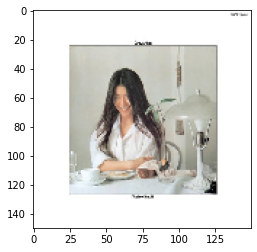

1/1 [==============================] - 0s 42ms/step
[[1.94315764e-31 1.66712694e-29 2.09079073e-10 2.23432666e-12
  1.82251828e-17 1.46753777e-14 3.19008364e-28 6.98628222e-09
  1.32667724e-22 1.09044095e-05 2.16501555e-03 1.23520124e-07
  3.33140043e-11 1.30404230e-23 6.84987366e-28 4.27276679e-26
  6.43663475e-26 2.61302878e-24 2.14770923e-21 1.21613443e-02
  9.85658109e-01 7.16302777e-13 3.88828049e-13 9.22711407e-10
  4.55916706e-30 6.01554620e-21 1.01236528e-19 2.61851688e-24
  1.13460559e-32 3.09673080e-26 5.79197671e-12 4.25695483e-14
  5.18397924e-23 5.73465393e-26 2.08356787e-30 7.48091300e-14
  2.47807298e-14 4.46484410e-06 3.45374799e-16 4.08735502e-12
  5.15305883e-25]]
Taeko Ohnuki - Grey Skies , 98.57
6.album01_grey-skies_new2.jpg: Taeko Ohnuki - Grey Skies
--------------------------------------------------------------
5.m45473795507_1.jpg


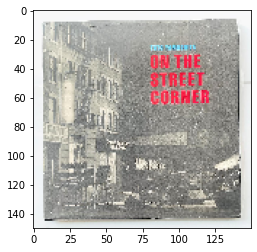

1/1 [==============================] - 0s 37ms/step
[[3.6606849e-05 2.7900804e-05 2.3706255e-03 4.3396236e-04 1.2597412e-05
  1.1986715e-02 1.6882701e-04 1.1471590e-04 2.6245299e-01 2.0300262e-05
  7.9791145e-03 3.1732535e-04 8.1087792e-06 2.3459368e-05 3.3598403e-03
  2.1041250e-03 1.5651171e-04 1.2386914e-03 3.6587790e-04 8.9243031e-06
  4.2674310e-06 1.4406872e-03 3.6440615e-02 1.9075806e-04 2.7463893e-05
  7.7836485e-06 3.4958539e-06 2.0633792e-05 8.9546825e-07 5.4627512e-06
  2.0227050e-03 3.7551872e-05 3.6629689e-01 1.7838228e-02 3.1178181e-05
  1.1564672e-03 2.7916044e-01 2.5974808e-04 9.6159827e-05 1.7577740e-03
  1.3560262e-05]]
Tatsuro Yamashita - On The Street Corner 2 , 36.63
5.m45473795507_1.jpg: Tatsuro Yamashita - On The Street Corner 2
--------------------------------------------------------------
7.m46412031299_5.jpg


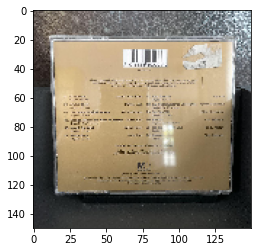

1/1 [==============================] - 0s 35ms/step
[[1.6210144e-11 2.6501383e-04 1.5738459e-04 9.3170752e-07 1.8086049e-13
  3.6940523e-06 2.4793405e-14 3.4249950e-09 1.0477353e-01 9.8184559e-12
  1.2664555e-11 2.1334674e-11 2.0234285e-10 8.6183849e-10 1.7154226e-09
  5.4833331e-06 2.2574957e-10 1.6274028e-03 3.6354627e-14 1.1156520e-18
  1.1641025e-06 8.3218235e-01 3.4894596e-04 8.0376176e-06 1.2003009e-11
  7.4132456e-18 4.1369741e-11 6.5492902e-12 2.9839027e-11 2.8363367e-08
  1.2872809e-03 1.5045484e-02 1.3214581e-06 1.1319248e-07 5.9677181e-03
  2.2321662e-02 4.1037121e-05 1.5958415e-02 2.7501812e-06 3.3553977e-07
  8.2292063e-15]]
Taeko Ohnuki - Mignonne , 83.22
7.m46412031299_5.jpg: Taeko Ohnuki - Mignonne
--------------------------------------------------------------
3.m34800885170_1.jpg


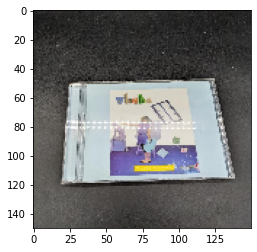

1/1 [==============================] - 0s 38ms/step
[[5.8053946e-20 8.0110424e-12 1.8153178e-09 9.3407194e-16 5.4802830e-17
  7.2448404e-04 3.8983700e-08 5.9913209e-04 1.9400507e-04 1.5431543e-13
  7.6811784e-07 2.0815238e-11 2.6502044e-16 4.0596178e-17 1.9708869e-14
  1.3928449e-10 4.0099407e-14 8.6276480e-10 1.3049935e-08 2.4486241e-11
  1.1219229e-09 2.8162563e-09 5.9944134e-02 4.2857145e-11 1.4611240e-13
  1.6815906e-19 2.2992273e-17 3.5333000e-20 1.4586030e-18 1.5868798e-16
  3.0134153e-08 5.5980394e-07 9.3793887e-01 5.9769506e-04 9.3871605e-15
  4.3715456e-10 1.7646387e-07 6.3019451e-10 2.4364839e-18 8.9730207e-08
  5.8858165e-16]]
Tatsuro Yamashita - On The Street Corner 2 , 93.79
3.m34800885170_1.jpg: Tatsuro Yamashita - On The Street Corner 2
--------------------------------------------------------------
4.m94432377367_1.jpg


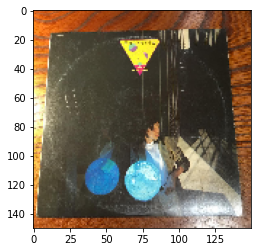

1/1 [==============================] - 0s 30ms/step
[[6.5516074e-14 6.0429759e-13 2.0915651e-36 1.7518540e-09 0.0000000e+00
  5.9208838e-10 1.3075556e-21 7.8185720e-34 4.3553198e-04 3.6109549e-27
  1.1727512e-22 3.4005871e-19 3.3792949e-23 9.8839468e-14 2.1388114e-05
  2.2976082e-36 8.1446769e-20 2.5207762e-34 3.2571174e-33 4.8056004e-17
  8.2038270e-28 3.5943138e-26 1.3414116e-27 8.9191951e-24 2.6571502e-29
  0.0000000e+00 0.0000000e+00 2.1179536e-16 8.9583629e-08 1.7892127e-24
  9.9954307e-01 2.0594296e-28 5.4305855e-13 1.0122834e-21 2.9654468e-18
  5.1339451e-19 1.3203540e-18 3.1596975e-28 1.4754446e-10 9.8992930e-20
  1.4278503e-25]]
Tatsuro Yamashita - Moonglow , 99.95
4.m94432377367_1.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
3.m60313011009_1.jpg


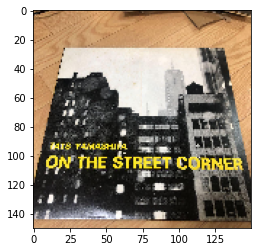

1/1 [==============================] - 0s 37ms/step
[[0.0000000e+00 0.0000000e+00 5.3459253e-22 0.0000000e+00 0.0000000e+00
  2.7903306e-32 0.0000000e+00 4.5369641e-12 0.0000000e+00 1.8336495e-22
  1.5265040e-32 4.2942205e-33 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 5.1003638e-35 6.6318013e-37 0.0000000e+00
  4.2558461e-19 0.0000000e+00 2.2511169e-33 7.5928449e-30 2.9581571e-33
  0.0000000e+00 1.0526893e-33 0.0000000e+00 0.0000000e+00 1.7571033e-24
  3.5597305e-28 1.0000000e+00 0.0000000e+00 1.1435540e-28 0.0000000e+00
  0.0000000e+00 0.0000000e+00 1.9567829e-17 0.0000000e+00 1.3467665e-15
  0.0000000e+00]]
Tatsuro Yamashita - On The Street Corner , 100.00
3.m60313011009_1.jpg: Tatsuro Yamashita - On The Street Corner
--------------------------------------------------------------
2.m60824228485_1.jpg


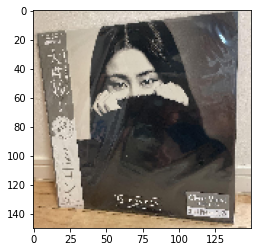

1/1 [==============================] - 0s 44ms/step
[[0.00000000e+00 1.26337610e-30 1.50527363e-13 4.19461479e-19
  0.00000000e+00 4.24629007e-21 0.00000000e+00 1.98169353e-16
  5.16997048e-17 2.35879099e-25 1.51412493e-21 1.42262570e-31
  2.19321841e-37 1.09689644e-35 7.08991697e-26 8.23766421e-34
  3.57103544e-34 5.97573167e-26 4.97121935e-36 4.61093396e-31
  3.82964359e-26 2.18685643e-11 1.00000000e+00 5.02121996e-25
  8.41949723e-38 0.00000000e+00 1.57954055e-38 2.56021935e-32
  0.00000000e+00 1.35695115e-38 2.60827893e-15 1.89061580e-21
  2.14057581e-21 1.58018987e-10 2.59003418e-31 4.96304397e-17
  6.18193183e-18 3.13575609e-18 1.45090912e-34 5.85104001e-25
  0.00000000e+00]]
Taeko Ohnuki - Romantique , 100.00
2.m60824228485_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
4.m67244952798_1.jpg


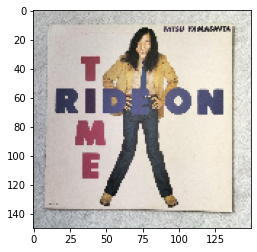

1/1 [==============================] - 0s 36ms/step
[[6.47543400e-16 5.25773273e-14 2.14442162e-11 5.49713226e-11
  4.70341482e-27 2.37060642e-13 1.61970203e-25 4.54492017e-08
  1.18046852e-08 2.00245669e-08 3.04258901e-06 7.30050243e-14
  1.93000428e-13 6.13541639e-12 1.32603418e-16 4.01679172e-25
  5.13733616e-26 7.25787838e-14 2.16958913e-21 4.65737065e-19
  3.67176314e-14 1.06166304e-07 9.99676704e-01 3.38956192e-14
  4.29432842e-23 2.03233029e-31 6.31947573e-23 1.58622742e-14
  9.83271727e-20 1.06314650e-18 3.06674774e-04 2.27028812e-12
  3.36734492e-13 6.71009914e-10 1.65313279e-13 3.70008912e-10
  1.33466119e-05 8.54936477e-09 7.89771111e-19 2.21804730e-09
  4.87655581e-30]]
Taeko Ohnuki - Romantique , 99.97
4.m67244952798_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
7.m19681380073_3.jpg


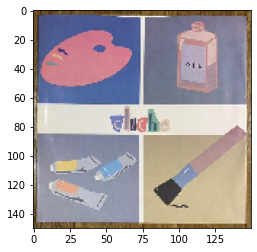

1/1 [==============================] - 0s 32ms/step
[[4.39605977e-20 3.01506374e-22 6.31557882e-08 2.93239890e-12
  3.75147820e-01 4.47479222e-04 2.32869880e-07 1.41157127e-12
  8.72556143e-08 6.65936964e-15 1.89519928e-12 1.71582180e-08
  2.10515927e-14 9.98650565e-20 1.29875386e-13 6.39823384e-06
  5.94161341e-15 3.88587621e-04 6.19134426e-01 3.44382563e-13
  6.72847802e-12 4.06524207e-12 3.06903303e-08 1.54980762e-09
  5.95506799e-06 1.26014347e-03 8.70951742e-04 1.12258607e-19
  2.74478611e-22 4.45932971e-20 2.13952055e-12 8.71562598e-15
  1.19889734e-08 7.49737772e-11 1.49920282e-20 2.63508037e-03
  1.02661324e-04 2.09917347e-10 1.30843931e-08 1.92973316e-14
  9.43673091e-12]]
Taeko Ohnuki - Aventure , 61.91
7.m19681380073_3.jpg: Taeko Ohnuki - Aventure
--------------------------------------------------------------
2.m68549617040_1.jpg


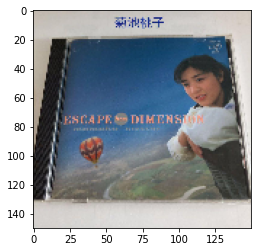

1/1 [==============================] - 0s 41ms/step
[[0.0000000e+00 0.0000000e+00 2.6108979e-22 9.2757761e-36 4.5955049e-21
  6.8953072e-12 4.8309700e-36 0.0000000e+00 2.2664920e-23 0.0000000e+00
  0.0000000e+00 5.7687851e-28 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.0000000e+00 7.3245094e-30 8.2176794e-17 6.4062501e-28 0.0000000e+00
  0.0000000e+00 5.4314151e-30 7.0178213e-21 5.4970825e-27 2.6348386e-31
  0.0000000e+00 1.0575344e-27 0.0000000e+00 0.0000000e+00 0.0000000e+00
  8.5668805e-37 3.8278348e-32 4.6974675e-38 4.2313828e-13 0.0000000e+00
  2.3134032e-20 2.0306206e-34 1.6613299e-29 2.2017998e-32 8.1808659e-32
  1.1465106e-29]]
Momoko Kikuchi - Escape From Dimension , 100.00
2.m68549617040_1.jpg: Momoko Kikuchi - Escape From Dimension
--------------------------------------------------------------
3.m49710851682_2.jpg


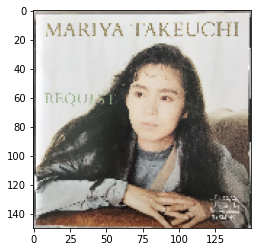

1/1 [==============================] - 0s 41ms/step
[[6.6670456e-26 1.1175594e-33 2.2486392e-23 9.1725622e-23 1.8511211e-22
  7.7309417e-15 6.0844937e-31 2.7976328e-16 3.0658585e-21 1.4210416e-07
  4.3679893e-10 9.9999988e-01 3.4450571e-11 6.1052376e-22 1.5456480e-31
  1.9614162e-32 1.3938508e-28 6.7088059e-27 5.9599407e-23 9.4842469e-18
  5.4214836e-13 1.5992096e-29 1.1166450e-30 3.1754434e-18 7.1968820e-30
  5.5756454e-27 2.1478602e-24 6.1921157e-29 5.8746550e-33 2.9001428e-19
  5.7101577e-11 4.6261423e-14 1.6474623e-24 4.5160418e-32 2.8617743e-36
  8.5213997e-25 6.8591921e-24 2.6761093e-14 8.5413165e-25 2.6721669e-10
  1.4461487e-30]]
Mariya Takeuchi - Request , 100.00
3.m49710851682_2.jpg: Mariya Takeuchi - Request
--------------------------------------------------------------
5.j719915182.1.jpg


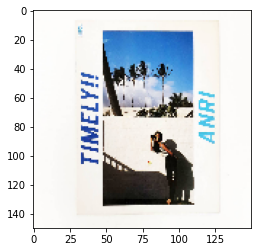

1/1 [==============================] - 0s 31ms/step
[[0.0000000e+00 0.0000000e+00 1.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 1.4284457e-29 0.0000000e+00 1.9327551e-31
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 1.9361505e-15 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 1.4168217e-36 0.0000000e+00 3.3859027e-21 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00]]
Anri (2) - Timely!! , 100.00
5.j719915182.1.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
7.m56659597128_2.jpg


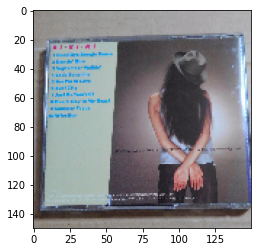

1/1 [==============================] - 0s 34ms/step
[[6.86481124e-12 3.37884700e-07 2.01974615e-07 1.07844883e-07
  3.11822262e-10 9.34825730e-05 1.20125654e-09 2.09521829e-07
  3.94639239e-04 1.95023234e-10 1.61724292e-05 6.25939478e-08
  7.67535861e-12 2.18123635e-08 4.69145078e-08 1.40122702e-09
  3.04393143e-11 9.10760818e-08 3.06421214e-07 5.06110431e-10
  2.09927157e-06 1.50949268e-06 2.03318857e-02 2.10171769e-04
  9.77493642e-11 2.55965145e-11 6.72534139e-10 3.18161664e-10
  9.21309418e-10 1.10521375e-11 5.03528863e-05 1.16176890e-09
  2.59711698e-04 1.25025579e-07 4.68740780e-08 1.11666312e-04
  9.78110373e-01 2.21198002e-06 4.14153008e-04 3.05640917e-08
  3.45607310e-12]]
Utada Hikaru - Badモード , 97.81
7.m56659597128_2.jpg: Utada Hikaru - Badモード
--------------------------------------------------------------
2.m44024679821_1.jpg


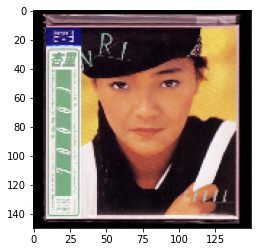

1/1 [==============================] - 0s 41ms/step
[[0.00000000e+00 1.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 6.38378380e-35 0.00000000e+00 3.35035474e-34
  2.17440769e-15 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 2.38788655e-12 0.00000000e+00 0.00000000e+00
  0.00000000e+00 2.03784619e-33 0.00000000e+00 0.00000000e+00
  2.55152052e-26 2.64234198e-35 1.83304435e-26 6.15378561e-20
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  9.44300077e-22 4.46080270e-34 5.94697174e-16 1.31004553e-29
  1.63460839e-27 4.57997064e-33 1.08046585e-08 3.54925640e-24
  1.61541084e-19 2.67514250e-27 4.17773882e-25 0.00000000e+00
  0.00000000e+00]]
Anri (2) - Coool , 100.00
2.m44024679821_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
5.m73993617730_4.jpg


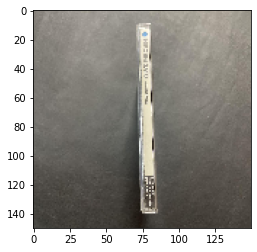

1/1 [==============================] - 0s 37ms/step
[[2.70674238e-04 3.78422300e-07 1.24406826e-04 9.16826903e-05
  3.89585421e-06 8.88377869e-08 6.10238665e-11 1.90836994e-03
  3.16647836e-03 6.03403486e-02 7.90230557e-03 2.10368918e-04
  8.12474713e-02 4.01448779e-06 1.50038488e-06 2.56920231e-07
  3.08440747e-07 7.24825043e-07 4.64594834e-08 1.05532445e-08
  9.52960377e-08 5.56732160e-10 1.00233983e-05 9.43446494e-08
  2.88814839e-08 6.73828815e-09 1.18851062e-06 7.00815463e-07
  8.02772320e-08 1.45391241e-04 5.77647879e-05 3.19402921e-03
  1.69661187e-04 1.68259908e-03 2.37363218e-09 1.23599265e-11
  3.67776533e-06 2.82199125e-07 3.10833159e-09 8.39461088e-01
  6.00173411e-10]]
Various - Classic Jazz-Funk Mastercuts Volume 7 , 83.95
5.m73993617730_4.jpg: Various - Classic Jazz-Funk Mastercuts Volume 7
--------------------------------------------------------------
6.m98283933426_1.jpg


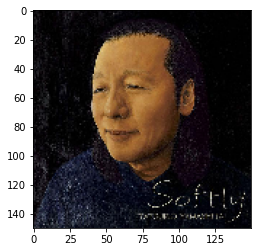

1/1 [==============================] - 0s 39ms/step
[[2.0832715e-29 7.6764607e-04 3.0938658e-35 3.8859048e-30 0.0000000e+00
  3.6999477e-36 0.0000000e+00 3.5123682e-35 1.1865710e-10 0.0000000e+00
  0.0000000e+00 0.0000000e+00 2.8242239e-30 4.5039062e-18 5.5735385e-33
  0.0000000e+00 2.6673286e-31 3.2930446e-24 0.0000000e+00 0.0000000e+00
  1.4252443e-28 1.7085533e-23 1.9599285e-22 4.0860654e-18 0.0000000e+00
  0.0000000e+00 0.0000000e+00 1.5362437e-28 1.3982334e-19 3.2290639e-19
  1.4041532e-15 1.9957665e-21 1.0646851e-28 9.4036914e-24 9.9923241e-01
  4.0842302e-31 1.7646741e-21 2.4621599e-28 2.7698696e-25 9.0533653e-35
  0.0000000e+00]]
Tatsuro Yamashita - Softly , 99.92
6.m98283933426_1.jpg: Tatsuro Yamashita - Softly
--------------------------------------------------------------
2.m17039467299_2.jpg


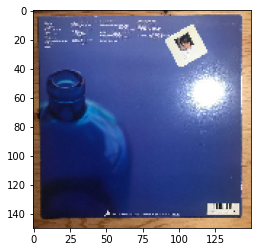

1/1 [==============================] - 0s 44ms/step
[[0.0000000e+00 0.0000000e+00 7.7025476e-31 1.0619827e-36 3.0894360e-12
  2.8844264e-08 9.4017142e-01 0.0000000e+00 1.9126402e-24 1.7480514e-35
  6.5946095e-28 1.3116327e-15 0.0000000e+00 0.0000000e+00 4.1623918e-27
  1.0014450e-15 4.0082193e-20 2.8888668e-25 5.9828591e-02 6.9570204e-14
  1.7697754e-37 2.4254320e-33 5.3820461e-24 6.5198702e-35 2.5719237e-16
  1.2856715e-09 1.6362603e-25 0.0000000e+00 0.0000000e+00 0.0000000e+00
  2.6070534e-28 0.0000000e+00 4.7867277e-16 8.4337780e-25 0.0000000e+00
  2.9843168e-22 5.7315804e-18 0.0000000e+00 6.3990823e-28 0.0000000e+00
  3.6782287e-15]]
Hiroshi Sato - Future File , 94.02
2.m17039467299_2.jpg: Hiroshi Sato - Future File
--------------------------------------------------------------
6.m97847491325_2.jpg


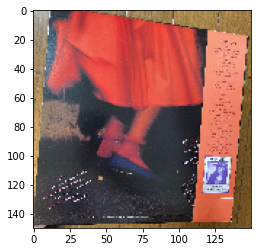

1/1 [==============================] - 0s 39ms/step
[[1.8374221e-17 4.5419410e-10 1.4187110e-27 4.0638233e-20 1.1667489e-30
  4.2865759e-12 6.2336790e-25 1.0882939e-21 4.9528235e-04 1.2250757e-24
  1.9246452e-19 9.2010172e-17 8.3550251e-17 9.9950469e-01 4.9702217e-19
  4.8646035e-24 5.7627733e-24 2.1326484e-19 6.3995886e-27 6.1311787e-27
  1.1443791e-21 2.2021015e-26 3.3413785e-22 4.4138586e-15 2.7856263e-28
  7.2623285e-38 8.8290130e-31 7.4120468e-13 5.0101607e-11 1.1675329e-14
  7.0570044e-10 2.4506439e-16 6.6351215e-14 4.9232227e-09 3.2090781e-11
  1.2096711e-18 4.9459607e-17 1.5558741e-20 4.0239092e-16 4.1374117e-09
  1.3398776e-26]]
Mariya Takeuchi - University Street , 99.95
6.m97847491325_2.jpg: Mariya Takeuchi - University Street
--------------------------------------------------------------
2.m54193286149_1.jpg


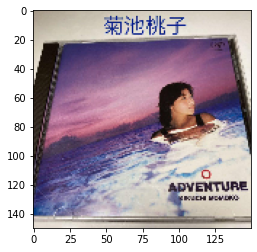

1/1 [==============================] - 0s 33ms/step
[[5.3887398e-23 1.0401524e-25 4.2605980e-13 2.2854456e-13 3.2412001e-35
  6.0684179e-22 1.3846962e-33 6.8841349e-22 1.3169897e-13 3.3650618e-08
  7.2426907e-15 1.5337765e-27 3.2545869e-24 5.6122417e-29 9.9735701e-01
  1.1770363e-29 1.3432531e-15 2.1142488e-31 1.0422295e-33 2.3820152e-24
  7.3568143e-27 1.8483077e-22 7.1013744e-07 7.3818807e-22 5.7052530e-30
  0.0000000e+00 1.6559065e-32 4.3358529e-18 1.0475968e-29 1.0027159e-17
  3.0430826e-06 8.0752557e-20 8.6131503e-16 2.6344415e-03 2.9574499e-25
  1.1296124e-19 4.7091658e-06 9.1404181e-27 1.1628590e-19 2.8832002e-28
  1.2085038e-27]]
Momoko Kikuchi - Adventure , 99.74
2.m54193286149_1.jpg: Momoko Kikuchi - Adventure
--------------------------------------------------------------
4.m77451765769_1.jpg


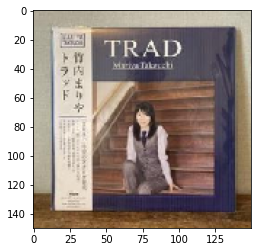

1/1 [==============================] - 0s 48ms/step
[[8.2325358e-05 3.7310498e-12 9.7647806e-25 9.6577804e-09 1.6627640e-23
  8.7717124e-17 7.5940346e-25 1.0940992e-18 7.3868221e-05 5.2300891e-07
  3.5105820e-09 9.9976116e-01 6.6760600e-05 1.5407135e-06 3.1258259e-13
  5.6743078e-29 1.2077174e-18 6.9237765e-29 2.1122631e-27 1.9564593e-15
  2.9035267e-17 5.7557673e-25 3.8017689e-29 3.1401863e-20 9.9502674e-26
  4.7810491e-31 9.7368632e-29 5.7709233e-11 1.2070515e-11 1.0668068e-08
  7.2969583e-06 9.0058687e-17 1.8073114e-11 2.9234272e-20 3.1539580e-19
  4.0779104e-21 2.3457624e-20 8.4650726e-17 2.2144623e-14 6.5511767e-06
  1.5252212e-23]]
Mariya Takeuchi - Request , 99.98
4.m77451765769_1.jpg: Mariya Takeuchi - Request
--------------------------------------------------------------
1.m42383447044_1.jpg


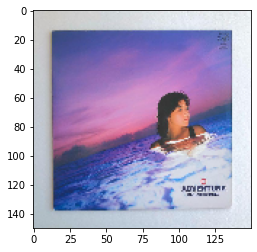

1/1 [==============================] - 0s 40ms/step
[[9.5760595e-22 6.0413824e-24 3.5225135e-29 1.1331305e-16 0.0000000e+00
  2.1891985e-29 1.7019218e-36 7.2192817e-33 2.4901288e-15 1.1179453e-22
  4.4339660e-18 1.1667876e-31 3.7506808e-23 1.7715383e-33 1.0000000e+00
  0.0000000e+00 3.7995681e-17 0.0000000e+00 0.0000000e+00 1.0571650e-24
  0.0000000e+00 4.6199895e-36 1.1877985e-27 1.8352590e-37 0.0000000e+00
  0.0000000e+00 0.0000000e+00 3.0498837e-25 2.2329166e-26 5.3896164e-24
  1.3246327e-12 1.3676262e-29 6.0562000e-15 8.0989327e-22 7.0861256e-35
  2.3330920e-38 3.8975998e-19 0.0000000e+00 1.1499683e-26 1.9915159e-30
  7.4556349e-34]]
Momoko Kikuchi - Adventure , 100.00
1.m42383447044_1.jpg: Momoko Kikuchi - Adventure
--------------------------------------------------------------
5.m26092923537_2.jpg


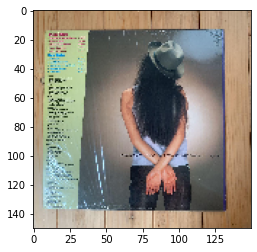

1/1 [==============================] - 0s 35ms/step
[[9.7018629e-15 4.1142847e-15 1.9966738e-11 1.6472127e-11 4.8113499e-16
  1.2339740e-03 2.0008557e-15 6.4726355e-13 2.4379048e-02 2.1761047e-15
  2.3000356e-10 3.7603200e-13 7.1159949e-19 3.8721488e-11 1.6099323e-12
  2.4427977e-09 3.2403447e-16 1.2412112e-07 4.7565601e-11 1.3830105e-15
  1.5725759e-15 3.6973133e-10 3.4064162e-03 4.5107793e-11 2.1757208e-17
  2.1045413e-21 1.0741056e-17 7.8570596e-12 1.7845944e-15 5.6073014e-15
  2.0362685e-07 1.6296207e-09 2.7881891e-08 9.7075593e-01 3.6884064e-12
  2.9520317e-10 1.1409976e-07 2.8804595e-10 1.4232556e-12 2.2413177e-04
  2.1530616e-20]]
Tatsuro Yamashita - Ride On Time , 97.08
5.m26092923537_2.jpg: Tatsuro Yamashita - Ride On Time
--------------------------------------------------------------
2.41mdbk9s4bl.jpg


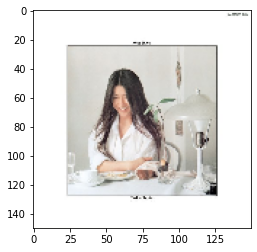

1/1 [==============================] - 0s 39ms/step
[[3.0687244e-29 2.3609671e-27 2.7242680e-10 2.0597366e-11 2.9084899e-16
  2.1663196e-14 3.8565719e-27 1.4279262e-09 5.0345213e-21 2.1125222e-06
  4.8998012e-03 9.3416861e-07 8.4918329e-11 4.1513420e-22 1.3403269e-26
  1.6571692e-24 1.5480730e-24 2.2553574e-23 4.1863482e-20 3.1454333e-03
  9.9194920e-01 2.4968101e-12 2.7537280e-13 5.5766329e-09 1.4109215e-28
  1.6741129e-19 6.1706433e-19 7.1549173e-23 4.2064484e-30 9.5950592e-25
  6.6276368e-12 9.2138109e-14 2.8035751e-22 8.2230349e-26 1.4704545e-28
  8.4742482e-14 9.7642983e-14 2.4628503e-06 4.0020185e-15 2.1268796e-11
  9.3294532e-24]]
Taeko Ohnuki - Grey Skies , 99.19
2.41mdbk9s4bl.jpg: Taeko Ohnuki - Grey Skies
--------------------------------------------------------------
6.m80828542331_2.jpg


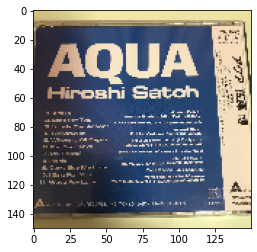

1/1 [==============================] - 0s 43ms/step
[[7.21184062e-37 1.23831183e-31 1.90052349e-10 8.29212955e-24
  1.87544855e-26 1.03682145e-01 1.22703670e-11 5.59462242e-12
  1.59055963e-10 2.47714563e-19 2.11495008e-16 1.22855285e-13
  0.00000000e+00 4.21827176e-33 1.94140550e-20 3.24653634e-14
  5.21660064e-20 4.92125084e-17 5.39512257e-09 7.90528396e-13
  3.05694543e-13 1.72496024e-13 8.96210194e-01 3.28026661e-10
  1.11404129e-16 7.86080565e-25 4.66474962e-26 4.44002054e-29
  4.86045462e-37 1.57208365e-28 2.67801115e-10 1.49943687e-14
  1.04441177e-04 5.14078636e-07 3.72262810e-32 2.45918363e-06
  2.34014095e-07 2.26323835e-10 7.64898151e-24 7.56583477e-18
  1.24491126e-21]]
Taeko Ohnuki - Romantique , 89.62
6.m80828542331_2.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
1.m12308482839_1.jpg


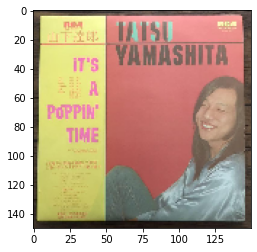

1/1 [==============================] - 0s 32ms/step
[[2.83794849e-10 3.60264233e-03 1.06240411e-27 7.86413643e-11
  3.00967753e-26 2.13096205e-16 3.19654173e-21 6.36376311e-26
  8.75451576e-07 4.00662075e-23 3.01788381e-20 1.81123829e-15
  2.44201505e-15 2.08121910e-05 5.08869249e-12 7.23762316e-27
  5.34842887e-19 1.97318240e-21 1.01590994e-26 3.38710525e-23
  1.59828798e-14 1.19912289e-19 1.35102324e-16 2.65304029e-10
  5.45185565e-20 4.75334640e-26 1.29664673e-24 1.50537124e-12
  9.89135504e-01 8.69481802e-18 3.46490268e-08 4.52353275e-24
  1.65025166e-16 4.82575793e-16 5.89629235e-06 8.05981237e-12
  3.11729420e-09 4.28906719e-19 7.23422691e-03 4.31002820e-19
  1.56092084e-22]]
Tatsuro Yamashita - It's A Poppin' Time , 98.91
1.m12308482839_1.jpg: Tatsuro Yamashita - It's A Poppin' Time
--------------------------------------------------------------
1.m59517111875_1.jpg


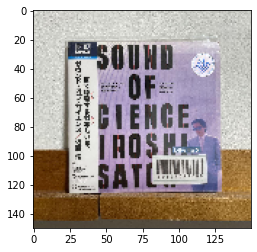

1/1 [==============================] - 0s 40ms/step
[[0.0000000e+00 4.0511138e-26 9.4008820e-12 1.1641367e-24 0.0000000e+00
  5.8119484e-14 0.0000000e+00 9.6789491e-01 4.0381193e-20 1.6571787e-11
  1.0115864e-07 9.0543333e-13 3.5733917e-18 2.6421019e-17 0.0000000e+00
  3.3314680e-32 2.6375926e-38 1.5189847e-19 5.8976945e-31 5.1491050e-24
  3.5460093e-07 4.2895900e-15 1.2911725e-09 6.0766493e-16 4.8264026e-34
  0.0000000e+00 2.0785747e-27 2.7327613e-31 6.4898943e-37 7.6217421e-30
  3.2835874e-09 5.5554113e-11 7.9052889e-20 2.1736485e-25 1.6304336e-28
  1.8300515e-12 1.0918339e-16 3.2104541e-02 1.0097091e-29 6.8522437e-09
  8.3201204e-33]]
Hiroshi Sato - Sound Of Science , 96.79
1.m59517111875_1.jpg: Hiroshi Sato - Sound Of Science
--------------------------------------------------------------
2.m27120258603_1.jpg


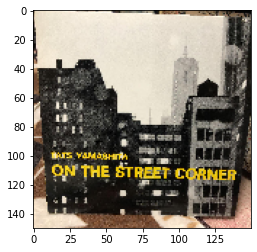

1/1 [==============================] - 0s 38ms/step
[[0.00000000e+00 0.00000000e+00 3.65589964e-35 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 5.60722253e-24
  0.00000000e+00 1.25627687e-24 0.00000000e+00 3.01052387e-33
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  1.44964413e-24 0.00000000e+00 0.00000000e+00 7.78992668e-34
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 4.05696602e-32 0.00000000e+00 1.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 2.19462568e-21 0.00000000e+00 1.01912306e-25
  0.00000000e+00]]
Tatsuro Yamashita - On The Street Corner , 100.00
2.m27120258603_1.jpg: Tatsuro Yamashita - On The Street Corner
--------------------------------------------------------------
4.m42383447044_5.jpg


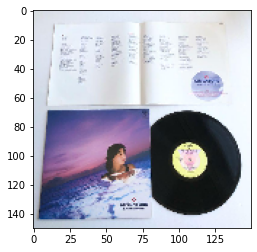

1/1 [==============================] - 0s 33ms/step
[[1.4467379e-33 0.0000000e+00 2.1661231e-10 5.4239329e-19 8.3420710e-38
  9.3161270e-38 0.0000000e+00 2.8693926e-23 1.6693145e-16 5.0538818e-10
  1.1636473e-21 0.0000000e+00 1.7226316e-25 0.0000000e+00 6.9877592e-06
  2.6704186e-38 1.4487128e-21 6.5643232e-38 0.0000000e+00 1.2297875e-37
  3.6625825e-38 2.2652411e-37 2.2917295e-14 2.6804260e-34 2.9054835e-33
  0.0000000e+00 4.2517410e-35 1.0463173e-31 0.0000000e+00 6.2013791e-24
  8.3754254e-15 2.7758747e-23 2.5222995e-16 9.9999297e-01 0.0000000e+00
  2.5169214e-35 1.4597837e-16 0.0000000e+00 1.2481589e-36 4.3669895e-34
  0.0000000e+00]]
Tatsuro Yamashita - Ride On Time , 100.00
4.m42383447044_5.jpg: Tatsuro Yamashita - Ride On Time
--------------------------------------------------------------
1.m63949046117_1.jpg


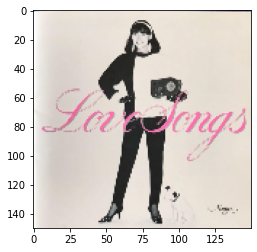

1/1 [==============================] - 0s 34ms/step
[[0.0000000e+00 0.0000000e+00 1.0016803e-14 6.3213135e-27 0.0000000e+00
  1.6921190e-38 0.0000000e+00 1.2033204e-16 1.0052367e-36 1.0000000e+00
  1.0319875e-15 5.0022163e-25 3.1958048e-29 0.0000000e+00 4.5274024e-35
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 5.0958778e-25
  6.3005680e-25 1.2388037e-29 2.1822904e-14 2.1889030e-32 0.0000000e+00
  0.0000000e+00 0.0000000e+00 2.7785589e-34 0.0000000e+00 6.3616067e-37
  6.7508490e-22 3.3734195e-23 2.6301108e-37 4.1335108e-25 0.0000000e+00
  2.1231258e-34 2.9604217e-21 1.4600911e-21 0.0000000e+00 6.5633109e-25
  0.0000000e+00]]
Mariya Takeuchi - Love Songs , 100.00
1.m63949046117_1.jpg: Mariya Takeuchi - Love Songs
--------------------------------------------------------------
2.m13248682115_1.jpg


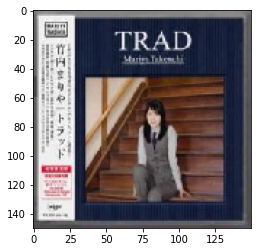

1/1 [==============================] - 0s 37ms/step
[[2.6202833e-02 2.5368352e-10 1.1467155e-13 9.7376460e-01 2.7365512e-28
  2.5634539e-30 9.3247390e-33 6.7052783e-24 5.4183579e-07 3.3407151e-12
  4.5820298e-10 7.1751050e-09 3.1406966e-05 1.4811388e-12 9.4929682e-09
  8.4738373e-25 1.1561912e-11 6.0162036e-28 0.0000000e+00 3.9751938e-28
  4.9183481e-26 2.5286968e-20 1.5004658e-23 5.0864673e-27 7.4971144e-29
  0.0000000e+00 2.9596175e-28 5.4725331e-07 4.4114559e-10 1.4171370e-09
  3.0204833e-10 6.3485219e-18 8.2213789e-15 4.8134694e-14 6.4027999e-20
  1.4215201e-20 7.3905914e-17 3.6745855e-22 3.2973171e-10 1.1643807e-09
  3.3321783e-25]]
Anri (2) - Wave , 97.38
2.m13248682115_1.jpg: Anri (2) - Wave
--------------------------------------------------------------
2.m93352621956_1.jpg


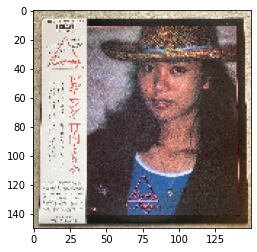

1/1 [==============================] - 0s 31ms/step
[[1.7991925e-20 3.8934225e-18 1.4975356e-34 1.0143674e-13 0.0000000e+00
  3.8159241e-15 1.7504058e-38 2.9695380e-34 9.9980074e-01 5.7696451e-33
  2.8040963e-30 1.6220689e-23 2.8826985e-29 4.2300081e-20 2.4446094e-12
  0.0000000e+00 5.7624496e-34 6.0224827e-25 3.5891615e-38 1.5343292e-35
  1.3948164e-30 5.3249974e-22 3.7239753e-15 2.0155227e-20 8.6213966e-36
  0.0000000e+00 0.0000000e+00 7.5257708e-21 5.3999587e-18 2.5713777e-30
  1.9930188e-04 1.3519432e-23 2.7423343e-18 2.7421569e-14 4.3740586e-16
  9.3567232e-10 1.2994971e-11 1.3459713e-27 3.2467591e-11 9.0709798e-24
  1.4782352e-38]]
Mariya Takeuchi - Beginning , 99.98
2.m93352621956_1.jpg: Mariya Takeuchi - Beginning
--------------------------------------------------------------
7.m51545641504_3.jpg


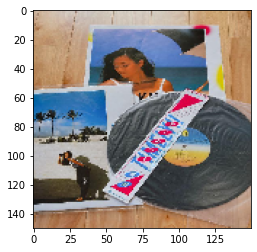

1/1 [==============================] - 0s 39ms/step
[[0.0000000e+00 5.3303172e-31 7.4289713e-11 1.5101704e-23 6.5823851e-25
  7.7396538e-04 1.2241601e-21 1.9163370e-24 5.4930279e-13 0.0000000e+00
  4.0818648e-23 9.1214523e-27 0.0000000e+00 1.5844906e-34 4.2212815e-30
  1.3321167e-07 2.1952983e-24 1.4542267e-19 9.0957762e-19 3.5908630e-36
  1.5883193e-14 1.4222234e-15 9.7698307e-01 1.0841547e-10 1.4435206e-27
  2.5986982e-33 8.7413791e-28 1.3983248e-33 1.8054338e-36 0.0000000e+00
  7.1469863e-19 2.1211068e-35 2.5731517e-09 2.9357619e-17 4.7982098e-32
  2.2239899e-02 2.9380867e-06 1.8120227e-14 9.9078668e-17 1.0859276e-30
  2.6208132e-30]]
Taeko Ohnuki - Romantique , 97.70
7.m51545641504_3.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
4.m17954323756_1.jpg


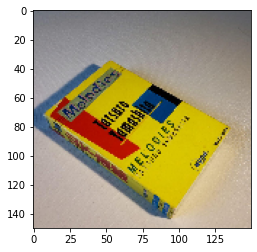

1/1 [==============================] - 0s 46ms/step
[[1.10344358e-16 2.35158167e-17 9.62371763e-04 6.18185458e-09
  7.60539259e-20 1.05580489e-09 6.43973147e-28 5.32681232e-10
  9.19625222e-07 1.12359115e-14 1.06694251e-10 2.97637470e-11
  3.72592505e-04 1.64130345e-08 9.60598158e-27 3.56080651e-04
  4.16594351e-15 6.08559728e-01 1.59950985e-24 3.70277076e-35
  2.44319582e-11 3.67301918e-11 2.53747761e-13 6.63112800e-08
  3.12333292e-19 1.07678319e-27 2.88142502e-07 1.29876157e-16
  1.14630110e-17 4.27980595e-10 4.12218196e-06 1.53229758e-02
  1.28516636e-20 7.05162942e-11 9.65823602e-11 1.02072090e-05
  2.11627943e-13 3.72686863e-01 4.41469155e-07 1.72338274e-03
  7.67851061e-11]]
Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線 , 60.86
4.m17954323756_1.jpg: Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線
--------------------------------------------------------------
1.m92793218439_1.jpg


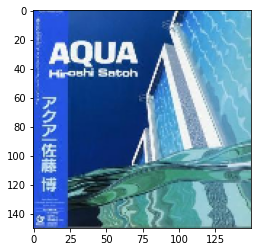

1/1 [==============================] - 0s 33ms/step
[[0.00000000e+00 0.00000000e+00 7.81376353e-12 3.73453956e-27
  9.99965549e-01 1.29886064e-27 1.52363893e-28 8.12506009e-27
  5.56123767e-29 2.30284004e-25 1.02411544e-17 5.34003448e-22
  6.25736520e-30 0.00000000e+00 1.74664600e-37 8.42382670e-17
  8.17806910e-29 1.38161382e-25 3.99155223e-11 3.34793792e-20
  8.41703642e-20 1.15981482e-33 2.91335989e-34 1.21319546e-27
  3.93071372e-28 3.45059452e-05 2.81688853e-15 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 3.03314130e-32
  2.85315116e-29 7.98966234e-36 0.00000000e+00 2.38902365e-28
  6.16801467e-24 1.46403371e-29 1.32402445e-26 1.73813467e-26
  1.65003783e-28]]
Hiroshi Sato - Aqua , 100.00
1.m92793218439_1.jpg: Hiroshi Sato - Aqua
--------------------------------------------------------------
7.m15588363283_5.jpg


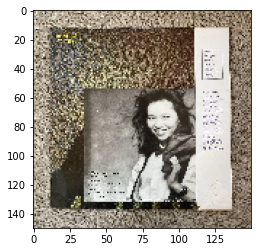

1/1 [==============================] - 0s 32ms/step
[[6.87554312e-17 5.44905146e-18 4.47296292e-01 1.08467498e-06
  9.33978067e-18 5.32989919e-09 8.83214389e-25 9.58530450e-07
  1.90079863e-05 1.55500384e-05 9.27655401e-06 2.41176471e-11
  1.29062224e-14 1.13182745e-15 2.06222758e-14 5.96388233e-15
  1.40844093e-17 6.08029609e-08 5.79104432e-18 3.19020458e-14
  1.08227494e-13 8.16297159e-02 3.11412871e-01 8.44665744e-15
  4.16488648e-17 2.13916645e-20 1.22150198e-16 1.15652427e-11
  1.12197074e-22 3.32579179e-13 7.10792938e-06 6.37391070e-03
  1.57408212e-13 7.04649761e-02 4.61683651e-15 8.58823707e-11
  5.63303937e-09 3.42936110e-04 1.36909732e-17 8.24262276e-02
  3.90305381e-24]]
Anri (2) - Timely!! , 44.73
7.m15588363283_5.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
3.m59517111875_2.jpg


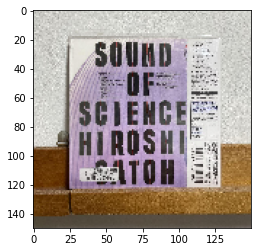

1/1 [==============================] - 0s 36ms/step
[[4.10030424e-35 3.38337827e-24 7.69247421e-08 6.72976536e-21
  8.60727499e-35 2.52818965e-18 0.00000000e+00 9.99805033e-01
  2.31781100e-19 2.76369889e-07 1.72770228e-06 1.94279190e-13
  3.35015083e-14 1.15502893e-17 2.72726858e-35 6.64178994e-32
  1.16866014e-35 1.81357427e-20 2.65452926e-32 1.84741000e-22
  1.79790305e-09 2.77005608e-14 1.61318692e-08 6.03932113e-19
  1.12130524e-31 0.00000000e+00 2.21203550e-25 6.13889954e-26
  1.75190544e-35 4.26005449e-25 3.28053661e-11 2.86746782e-09
  1.02037888e-18 1.17478439e-19 3.27728734e-28 1.19319983e-16
  2.09746467e-16 1.91695348e-04 3.51513930e-31 1.24330813e-06
  1.06413398e-35]]
Hiroshi Sato - Sound Of Science , 99.98
3.m59517111875_2.jpg: Hiroshi Sato - Sound Of Science
--------------------------------------------------------------
2.m36695518689_1.jpg


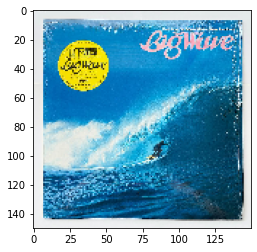

1/1 [==============================] - 0s 52ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  2.6463973e-20 1.3987341e-11 0.0000000e+00 7.8326126e-30 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 4.4531370e-33 5.2195351e-23 5.5265682e-13 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+00
  1.1402259e-21 4.3780928e-28 0.0000000e+00 0.0000000e+00 0.0000000e+00
  4.3399045e-25 0.0000000e+00 9.1238902e-21 7.5809564e-36 0.0000000e+00
  3.1880129e-36 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  6.3172059e-30]]
Tatsuro Yamashita - Big Wave = ビッグウェイブ , 100.00
2.m36695518689_1.jpg: Tatsuro Yamashita - Big Wave = ビッグウェイブ
--------------------------------------------------------------
1.m26586306292_1.jpg


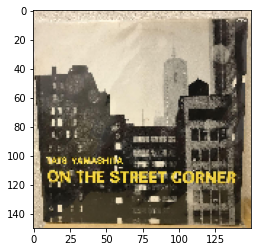

1/1 [==============================] - 0s 35ms/step
[[0.00000000e+00 0.00000000e+00 2.26376540e-27 0.00000000e+00
  0.00000000e+00 2.17260344e-27 0.00000000e+00 1.71816828e-17
  9.93590331e-36 2.63699745e-26 1.72635074e-36 1.40428399e-29
  8.29283212e-36 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 8.60937389e-29 1.47625435e-36 0.00000000e+00
  5.84546227e-25 0.00000000e+00 0.00000000e+00 3.81243947e-28
  1.23155723e-36 0.00000000e+00 1.48728458e-33 0.00000000e+00
  0.00000000e+00 1.34723835e-24 1.42979633e-31 1.00000000e+00
  0.00000000e+00 1.18937519e-29 0.00000000e+00 0.00000000e+00
  0.00000000e+00 3.32243446e-17 0.00000000e+00 5.36091625e-14
  0.00000000e+00]]
Tatsuro Yamashita - On The Street Corner , 100.00
1.m26586306292_1.jpg: Tatsuro Yamashita - On The Street Corner
--------------------------------------------------------------
1.m73993617730_1.jpg


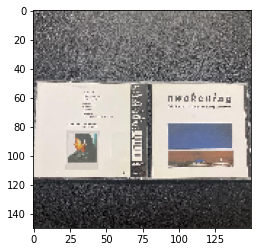

1/1 [==============================] - 0s 38ms/step
[[7.70071507e-10 5.08172970e-15 5.10925114e-01 6.94133481e-03
  1.62292258e-13 2.79327008e-16 2.81393239e-16 2.66625666e-05
  1.33885021e-06 1.60510428e-02 2.30476526e-05 7.64502936e-14
  3.45855078e-08 4.52274131e-19 1.00652454e-04 4.78556561e-12
  9.15284886e-07 1.02614027e-14 4.75377588e-17 6.85966631e-11
  4.68023873e-16 1.78607305e-13 1.41569183e-06 5.65529290e-17
  2.26344030e-12 1.13700091e-16 4.78468664e-13 1.98775926e-10
  7.10209209e-19 1.23430901e-08 1.24933042e-08 2.13495582e-06
  7.25816426e-05 4.65853453e-01 2.75830989e-21 8.41559659e-18
  6.76376510e-09 1.43443234e-14 5.61824725e-16 2.48073718e-07
  7.72014153e-14]]
Anri (2) - Timely!! , 51.09
1.m73993617730_1.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
7.i-img1200x900-1656697061tohpbj236254.jpg


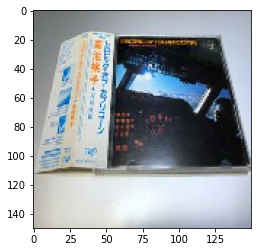

1/1 [==============================] - 0s 48ms/step
[[4.1836061e-32 4.1998605e-28 9.0646155e-02 2.4734501e-08 3.2607670e-26
  1.0090884e-16 2.2848019e-35 3.2744668e-18 1.6954787e-11 3.6116182e-23
  5.1662980e-18 1.1905523e-14 4.3678448e-29 1.9661433e-31 1.0308018e-24
  4.3340746e-19 3.0665907e-23 1.1785152e-17 8.0675845e-33 7.3374567e-29
  7.4479988e-15 1.6997840e-01 6.6854125e-01 5.7462795e-17 3.9639073e-24
  1.1544902e-34 1.3943909e-23 5.3512853e-23 3.4528938e-35 9.8788060e-33
  4.5549658e-14 2.8523795e-20 3.1592755e-18 1.1890661e-10 2.1213500e-28
  7.0834160e-02 3.0954087e-12 2.2418845e-08 3.0385831e-17 6.5899734e-18
  8.6479110e-37]]
Taeko Ohnuki - Romantique , 66.85
7.i-img1200x900-1656697061tohpbj236254.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
7.m63628826498_1.jpg


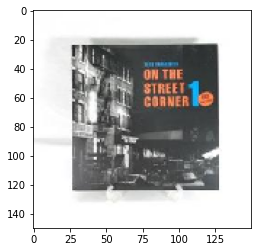

1/1 [==============================] - 0s 31ms/step
[[1.7673198e-16 1.6518717e-10 9.5638454e-02 5.5023533e-01 4.4242717e-22
  9.8555513e-16 2.4754948e-29 1.1009027e-13 3.5381961e-01 1.8047828e-18
  6.5996042e-11 7.0459440e-16 2.6201680e-12 1.8421134e-11 1.6053393e-06
  1.2438274e-13 2.5702439e-12 5.0285349e-11 1.6344535e-24 5.7670447e-27
  4.8199932e-14 1.0622059e-07 1.9100044e-07 9.4172371e-14 4.0006887e-14
  1.9505047e-26 1.2939616e-15 2.9644157e-16 1.8200623e-18 2.4588516e-17
  1.6884349e-09 4.2541159e-14 5.5444769e-07 1.6536144e-07 5.3881730e-16
  2.6778568e-04 3.6074784e-05 1.4956408e-11 4.1737551e-09 8.8345971e-08
  8.9157148e-23]]
Anri (2) - Wave , 55.02
7.m63628826498_1.jpg: Anri (2) - Wave
--------------------------------------------------------------
3.m39202428003_1.jpg


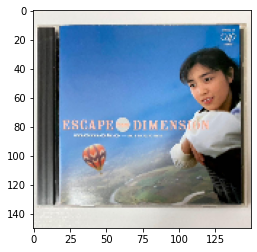

1/1 [==============================] - 0s 38ms/step
[[0.0000000e+00 0.0000000e+00 2.4082882e-18 0.0000000e+00 1.6563204e-19
  1.4322000e-21 0.0000000e+00 0.0000000e+00 1.5436953e-34 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.0000000e+00 1.5156304e-32 7.3961819e-25 1.8351049e-37 0.0000000e+00
  0.0000000e+00 2.2120780e-33 1.7228549e-24 1.6819013e-36 3.9273020e-33
  0.0000000e+00 4.8967880e-33 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 2.2041790e-16 0.0000000e+00
  1.4756974e-28 0.0000000e+00 4.3673967e-37 0.0000000e+00 0.0000000e+00
  0.0000000e+00]]
Momoko Kikuchi - Escape From Dimension , 100.00
3.m39202428003_1.jpg: Momoko Kikuchi - Escape From Dimension
--------------------------------------------------------------
6.m83035973700_1.jpg


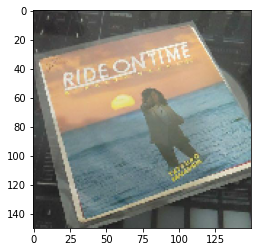

1/1 [==============================] - 0s 62ms/step
[[4.8249422e-07 5.8216881e-04 5.9270627e-10 2.3715477e-06 7.4037546e-03
  2.8407800e-01 1.3167635e-03 2.7692519e-07 1.8798518e-03 1.9716435e-08
  7.0379511e-02 1.2315513e-03 9.5180757e-03 1.9500297e-01 8.5839929e-05
  6.7474786e-05 1.1572962e-05 3.9123833e-09 5.1169086e-04 1.8575824e-03
  2.1895614e-02 4.6086968e-11 2.3238982e-09 1.6640220e-02 4.1717524e-10
  2.8089398e-05 6.8005477e-09 5.1196757e-06 1.3392040e-04 1.4549425e-05
  2.6818036e-04 1.8333512e-07 2.7857679e-01 2.9718137e-08 4.6928931e-06
  4.1951079e-08 2.4157166e-03 4.9083985e-07 3.4276038e-02 7.1809798e-02
  5.4730310e-07]]
Hiroshi Sato - Awakening , 28.41
6.m83035973700_1.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
2.m21819998460_1.jpg


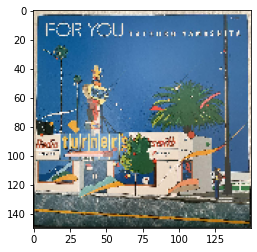

1/1 [==============================] - 0s 41ms/step
[[8.7538067e-38 0.0000000e+00 1.3214785e-08 2.7975943e-17 1.7817134e-08
  7.7181930e-24 0.0000000e+00 1.1037788e-19 1.0452138e-16 1.2978156e-31
  2.7358284e-36 6.2133871e-26 1.8824768e-17 4.2782857e-26 0.0000000e+00
  1.5119030e-06 4.9623948e-23 9.7430259e-01 2.6371009e-20 0.0000000e+00
  5.3500337e-38 5.1869718e-31 9.0406036e-32 2.1263988e-32 8.8390694e-16
  3.2214547e-21 2.5695808e-02 1.8934219e-34 0.0000000e+00 6.3622727e-30
  3.1638626e-28 5.5495341e-20 3.8451011e-30 7.7326015e-17 0.0000000e+00
  9.1166859e-18 3.9340554e-34 7.8421302e-24 3.3309159e-26 2.8053465e-14
  1.1385254e-19]]
Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線 , 97.43
2.m21819998460_1.jpg: Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線
--------------------------------------------------------------
7.m33795539903_1.jpg


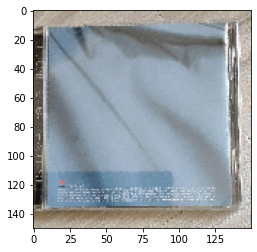

1/1 [==============================] - 0s 59ms/step
[[1.4374348e-11 2.8160788e-11 3.1126446e-09 2.9454064e-10 1.7073234e-09
  6.0487065e-02 6.5340519e-01 2.5324081e-08 2.9224746e-06 1.2944115e-09
  1.1228864e-07 2.8645649e-04 1.0153819e-11 6.4856167e-12 2.8246040e-08
  2.8364861e-04 1.0956281e-03 1.4458132e-07 1.9041696e-03 6.6052839e-06
  4.0833807e-08 1.6467240e-10 8.9782901e-07 1.9655288e-06 2.5690580e-04
  3.0410015e-07 1.9858531e-08 3.2673506e-11 1.7228699e-11 1.0562120e-09
  6.4889427e-05 3.8620702e-09 1.4115717e-03 1.6614678e-05 2.8093819e-12
  7.1121221e-06 1.9965852e-05 8.8853502e-09 3.0508822e-08 6.3964667e-11
  2.8074762e-01]]
Hiroshi Sato - Future File , 65.34
7.m33795539903_1.jpg: Hiroshi Sato - Future File
--------------------------------------------------------------
6.m95871293414_1.jpg


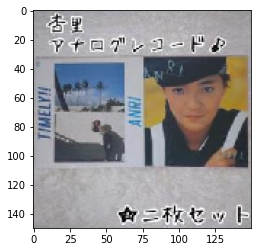

1/1 [==============================] - 0s 41ms/step
[[9.46639143e-13 1.17705443e-14 3.27876774e-06 4.23898960e-09
  3.88774279e-05 9.24933178e-04 4.18161193e-13 3.70631722e-04
  2.22504005e-01 1.15754153e-08 5.11482722e-05 9.89116842e-08
  3.34161837e-10 3.74022882e-14 1.56881075e-09 1.68531122e-09
  3.86117851e-15 3.59088261e-07 1.94393724e-05 2.97140668e-09
  3.68259902e-11 5.15825738e-09 6.29335818e-06 4.41951293e-12
  1.12580605e-11 3.03215994e-11 3.93725122e-11 3.42798596e-15
  5.98951853e-20 7.96328945e-14 1.16284304e-09 2.67572045e-06
  5.61900735e-01 3.25362598e-05 1.48518939e-17 2.56639892e-12
  7.17684898e-08 5.33525135e-09 2.47245873e-16 2.14144960e-01
  3.60041929e-20]]
Tatsuro Yamashita - On The Street Corner 2 , 56.19
6.m95871293414_1.jpg: Tatsuro Yamashita - On The Street Corner 2
--------------------------------------------------------------
7.m20731442106_2.jpg


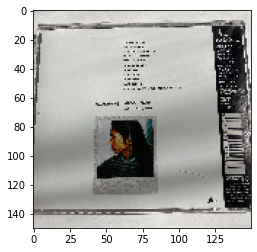

1/1 [==============================] - 0s 53ms/step
[[2.3993702e-34 2.4239543e-32 3.7846896e-18 4.5607778e-29 2.1397295e-23
  9.4461135e-16 1.9452051e-34 1.1341097e-10 3.1572214e-20 3.4633075e-04
  9.1256450e-15 1.1264179e-06 7.4317570e-23 2.3623871e-27 4.5071079e-30
  4.3322292e-37 3.0779624e-34 3.2969995e-26 1.9102364e-22 9.9566778e-14
  6.1194666e-10 3.7419023e-22 2.3549114e-26 3.2878617e-15 2.7155458e-27
  2.2151427e-23 1.1292500e-23 1.0777106e-30 1.6970229e-38 1.3732859e-14
  1.5097734e-14 9.9965143e-01 2.5977636e-27 6.7234068e-25 3.1106218e-35
  7.3141976e-22 1.5116230e-22 1.2029392e-06 1.0770085e-29 4.1218955e-12
  0.0000000e+00]]
Tatsuro Yamashita - On The Street Corner , 99.97
7.m20731442106_2.jpg: Tatsuro Yamashita - On The Street Corner
--------------------------------------------------------------
6.m43379398272_5.jpg


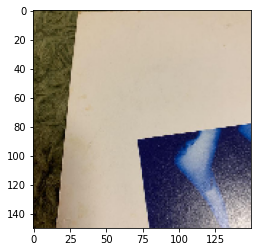

1/1 [==============================] - 0s 81ms/step
[[7.6239241e-24 2.9145078e-25 5.9217554e-23 4.1993636e-22 1.2781906e-37
  1.0739964e-18 1.8720608e-17 1.1840834e-21 7.4568980e-16 1.5037178e-10
  2.5621337e-25 2.2553133e-24 4.1082646e-25 9.0936563e-22 6.3251779e-14
  1.8238189e-31 1.6714467e-14 9.6157195e-26 3.5693649e-24 1.3600224e-18
  7.0411374e-17 1.9309546e-26 4.4743903e-17 1.5035892e-13 1.8524178e-18
  2.5715089e-29 1.7131157e-32 7.2324542e-19 9.4898858e-27 2.1671452e-15
  1.0000000e+00 8.4951408e-18 3.5219462e-12 9.9020580e-17 1.5075884e-22
  1.6838516e-15 8.4135796e-14 2.0962226e-19 2.9267186e-25 1.2990022e-23
  7.7832617e-22]]
Tatsuro Yamashita - Moonglow , 100.00
6.m43379398272_5.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
4.m19681380073_1.jpg


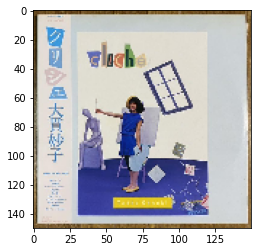

1/1 [==============================] - 0s 37ms/step
[[0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 1.63900731e-23 0.00000000e+00 0.00000000e+00
  0.00000000e+00 3.01951165e-37 8.55424535e-29 3.45152762e-27
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 1.00000000e+00
  1.09049975e-29 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 2.60154885e-32 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00]]
Taeko Ohnuki - Cliché , 100.00
4.m19681380073_1.jpg: Taeko Ohnuki - Cliché
--------------------------------------------------------------
3.m14911898302_3.jpg


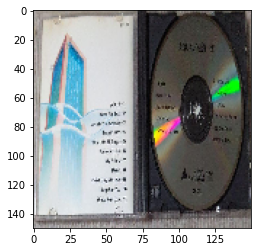

1/1 [==============================] - 0s 66ms/step
[[3.30834698e-13 3.56288904e-21 9.63745654e-01 6.98650410e-06
  8.51525525e-15 1.19485916e-19 2.42087169e-21 2.57379701e-10
  4.13025551e-11 8.71533155e-03 2.58947555e-02 3.22647985e-17
  4.69326715e-16 7.64772550e-20 5.29072675e-10 4.98103813e-16
  3.06729759e-18 1.66032460e-16 2.37668297e-15 3.02627796e-13
  1.65732346e-18 1.52810197e-12 1.32513954e-03 1.24251974e-17
  9.08040425e-21 3.80321037e-20 1.35094120e-17 3.84045018e-10
  2.26395546e-24 3.73670019e-12 9.79112236e-10 3.18290880e-11
  1.66652748e-12 1.88321530e-04 6.49000403e-25 2.92348505e-20
  1.22080310e-04 2.54440864e-13 5.51962985e-16 1.75386845e-06
  2.21001700e-25]]
Anri (2) - Timely!! , 96.37
3.m14911898302_3.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
2.m86685975104_1.jpg


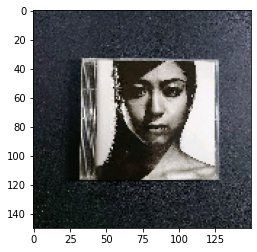

1/1 [==============================] - 0s 41ms/step
[[1.5320269e-32 4.7964987e-28 3.1192470e-05 6.7178952e-18 2.9743401e-22
  5.0760454e-17 0.0000000e+00 8.8176189e-04 4.6346889e-21 4.7638127e-01
  2.8722698e-05 3.6037106e-06 1.5823563e-14 2.2142441e-19 1.8172105e-33
  7.4025414e-28 1.4566029e-34 3.2839976e-18 2.2476989e-26 2.3029738e-14
  1.9622316e-06 2.9168877e-08 1.2315734e-08 7.1349021e-16 5.6643447e-29
  2.6998231e-29 8.4774801e-20 8.5279080e-22 5.6539901e-34 1.1861159e-22
  4.3505157e-14 6.7093893e-06 2.1503145e-27 3.8658524e-17 8.3539455e-28
  1.7779260e-12 1.8512672e-15 5.2262425e-01 3.1156775e-23 4.0523850e-05
  4.8715065e-38]]
Utada Hikaru - Deep River , 52.26
2.m86685975104_1.jpg: Utada Hikaru - Deep River
--------------------------------------------------------------
1.m48795873505_1.jpg


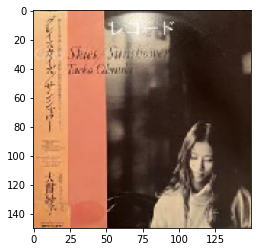

1/1 [==============================] - 0s 36ms/step
[[5.4249768e-03 6.9029474e-01 5.2778719e-17 7.4026420e-06 7.9097514e-21
  5.0347833e-15 4.6987595e-21 1.3064340e-18 7.1074921e-03 1.7378437e-13
  2.0073700e-13 3.0510962e-11 1.1851437e-11 5.4208521e-04 2.2841765e-07
  2.7167831e-18 4.5307586e-13 7.6346061e-15 4.3889846e-24 5.0274971e-20
  1.4753853e-15 3.8067591e-11 3.7818242e-09 1.6171960e-10 6.4060101e-18
  1.7672979e-26 5.9095324e-19 2.1500001e-03 2.2869036e-01 5.6492038e-09
  8.9091782e-07 4.0773193e-13 2.7562444e-16 7.0940604e-04 2.9742384e-02
  4.4829052e-09 4.6259120e-06 7.9501781e-14 3.5325311e-02 5.8375418e-12
  9.5368110e-18]]
Anri (2) - Coool , 69.03
1.m48795873505_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
7.i-img1200x1200-16399074686djjf119.jpg


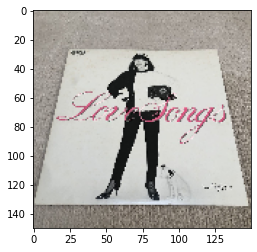

1/1 [==============================] - 0s 33ms/step
[[1.53229857e-38 0.00000000e+00 1.33914128e-07 5.52789035e-19
  1.19724645e-35 3.52372265e-29 0.00000000e+00 4.93908692e-09
  1.24931051e-29 9.99999881e-01 4.43293757e-09 1.65819766e-19
  2.19912671e-20 1.04307161e-33 6.86561595e-36 2.29084233e-35
  0.00000000e+00 2.37150372e-32 0.00000000e+00 8.81479809e-18
  3.69344415e-17 6.57823193e-15 1.14593623e-09 1.62486626e-27
  0.00000000e+00 0.00000000e+00 5.84418598e-34 1.67055333e-26
  0.00000000e+00 6.34065877e-34 3.21099498e-21 1.63049988e-17
  7.86845544e-31 1.17947651e-20 0.00000000e+00 3.72727469e-23
  6.61598279e-22 7.95518078e-12 7.43379069e-35 2.43866969e-15
  0.00000000e+00]]
Mariya Takeuchi - Love Songs , 100.00
7.i-img1200x1200-16399074686djjf119.jpg: Mariya Takeuchi - Love Songs
--------------------------------------------------------------
5.m31085431462_3.jpg


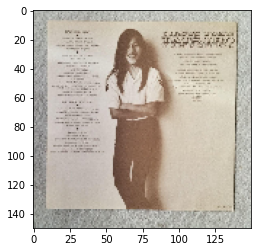

1/1 [==============================] - 0s 32ms/step
[[3.1532001e-09 1.1496113e-03 2.7849301e-09 2.1676531e-03 1.9539311e-16
  1.3694336e-09 1.1810754e-12 2.6469926e-13 4.6796123e-03 1.6048647e-12
  1.4081374e-08 1.0739991e-06 1.6913562e-10 5.7621091e-10 3.6734325e-04
  1.2028549e-12 3.2488506e-07 9.8499811e-12 6.5888162e-16 3.0219688e-13
  6.5094072e-09 2.4413810e-06 7.3913962e-04 4.8446641e-06 1.1282092e-09
  5.0598657e-15 2.7201521e-13 5.7334953e-10 9.2325914e-05 5.0728492e-13
  2.9718364e-04 1.5248612e-12 7.5364915e-07 8.7606180e-09 1.6668820e-06
  1.8894630e-02 3.8332444e-01 1.2065516e-09 5.8827692e-01 5.1297460e-14
  1.3189239e-10]]
Utada Hikaru - First Love , 58.83
5.m31085431462_3.jpg: Utada Hikaru - First Love
--------------------------------------------------------------
5.m97847491325_5.jpg


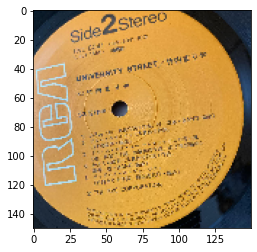

1/1 [==============================] - 0s 49ms/step
[[9.29696498e-09 4.12343532e-01 1.23617463e-10 1.35891923e-05
  2.21198046e-26 4.80851084e-14 5.91881244e-29 1.56429449e-16
  1.52321188e-02 7.94199979e-14 9.09173886e-13 1.04599636e-07
  1.05225965e-07 5.37578881e-01 4.67859996e-12 2.20445982e-17
  3.34113135e-13 6.27832964e-13 1.10671912e-31 4.45486369e-25
  1.32286748e-09 1.78126675e-06 2.39111790e-12 3.92190813e-09
  9.86957602e-16 2.24479759e-29 1.03752985e-18 6.02764601e-07
  7.41841068e-05 1.00919044e-06 8.57412000e-04 2.75363554e-08
  1.32778248e-15 2.60528793e-10 3.29084396e-02 2.18819958e-04
  2.03917580e-07 4.39851683e-05 6.85649051e-04 3.96100077e-05
  3.04504651e-22]]
Mariya Takeuchi - University Street , 53.76
5.m97847491325_5.jpg: Mariya Takeuchi - University Street
--------------------------------------------------------------
6.m98936940222_1.jpg


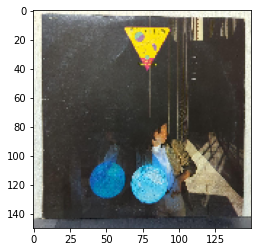

1/1 [==============================] - 0s 42ms/step
[[2.17686463e-32 1.96802721e-19 4.24148575e-29 2.99145832e-16
  0.00000000e+00 1.00824676e-25 0.00000000e+00 2.61609041e-33
  5.21632464e-05 3.25390061e-34 6.67482515e-38 2.93937907e-38
  3.93225378e-33 3.60261476e-29 1.04069253e-10 0.00000000e+00
  2.37104240e-27 2.46933366e-35 0.00000000e+00 0.00000000e+00
  1.30309532e-35 3.48749274e-26 5.26686391e-23 9.36891642e-30
  2.72107786e-36 0.00000000e+00 0.00000000e+00 2.67764568e-28
  1.25265864e-27 7.28072688e-30 9.99947786e-01 1.32801220e-26
  9.39966692e-15 1.65659332e-20 8.89161019e-25 8.88035298e-18
  7.89100195e-18 1.43451350e-30 1.17601629e-24 3.29325065e-33
  8.44021683e-38]]
Tatsuro Yamashita - Moonglow , 99.99
6.m98936940222_1.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
3.m66128519190_1.jpg


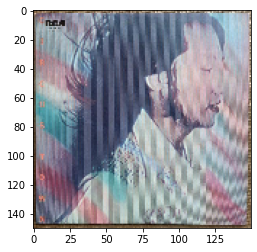

1/1 [==============================] - 0s 46ms/step
[[2.90462232e-08 8.33755257e-06 4.57119982e-04 3.47830850e-04
  1.21124787e-03 1.63707137e-01 1.15539962e-02 6.08802831e-04
  2.47495738e-03 6.23304368e-06 4.94492531e-01 3.65586653e-02
  7.52490960e-05 3.83376391e-05 1.99566307e-06 7.01883808e-03
  1.00026396e-03 1.25013685e-05 2.49671303e-02 3.05146823e-04
  6.99816942e-02 1.10724304e-05 5.45202463e-04 1.97667442e-02
  1.06659772e-05 1.68732204e-03 1.34566217e-05 4.36930634e-07
  1.32685054e-05 5.89294658e-08 2.61324341e-03 2.95138960e-07
  4.46129628e-02 1.98363318e-06 3.66250703e-07 3.37210414e-03
  5.12582287e-02 1.16724777e-03 1.00032752e-02 3.35863879e-04
  4.97581810e-02]]
Mariya Takeuchi - Miss M , 49.45
3.m66128519190_1.jpg: Mariya Takeuchi - Miss M
--------------------------------------------------------------
1.m29179180415_1.jpg


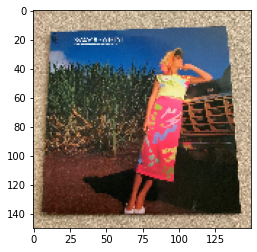

1/1 [==============================] - 0s 42ms/step
[[2.4278544e-09 4.2393463e-21 1.1001845e-15 9.9999988e-01 2.9033483e-37
  5.8946140e-32 0.0000000e+00 0.0000000e+00 9.3485518e-08 1.5823519e-29
  2.3723952e-28 2.8156934e-17 7.1861781e-24 7.4304438e-28 2.8822263e-15
  7.5715147e-26 4.2661520e-11 3.6054228e-32 0.0000000e+00 0.0000000e+00
  4.5219130e-35 1.7488226e-11 2.1335102e-26 1.9661421e-33 1.4108899e-27
  0.0000000e+00 9.8399346e-38 2.3699942e-09 2.8105289e-19 3.0383528e-17
  2.5399628e-12 1.9700522e-27 1.6379547e-26 1.5796912e-15 1.1817767e-22
  1.6994356e-15 4.5035852e-25 3.7404459e-25 2.8392924e-10 3.2646586e-22
  1.3435632e-32]]
Anri (2) - Wave , 100.00
1.m29179180415_1.jpg: Anri (2) - Wave
--------------------------------------------------------------
4.m82945471610_1.jpg


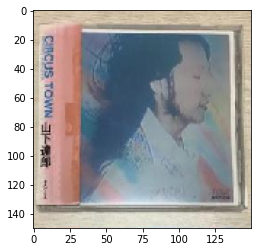

1/1 [==============================] - 0s 31ms/step
[[3.6119426e-20 1.5423747e-22 1.6502315e-11 4.7953470e-15 3.4888448e-08
  9.9227095e-01 1.7184334e-06 3.4134957e-16 2.6665922e-10 5.4722100e-18
  3.6538818e-18 9.1109960e-08 5.6333169e-23 8.3904613e-20 3.0141105e-17
  7.6606949e-03 1.0978132e-09 2.0711806e-08 3.2349904e-05 2.2547905e-11
  1.7160366e-09 4.5790655e-13 3.0492847e-10 3.4987972e-06 2.8700304e-05
  3.3309127e-09 4.4179216e-09 1.3091658e-15 8.7621045e-24 5.0616893e-15
  5.8995064e-10 3.2046300e-11 5.3331710e-12 4.3507140e-09 1.9997414e-19
  2.0089487e-06 5.2281061e-11 3.8579927e-08 2.0251394e-12 7.8285207e-15
  1.2300137e-08]]
Hiroshi Sato - Awakening , 99.23
4.m82945471610_1.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
5.m27398983087_1.jpg


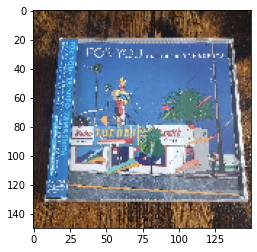

1/1 [==============================] - 0s 33ms/step
[[0.0000000e+00 0.0000000e+00 2.9904993e-14 8.1805396e-28 2.4038374e-10
  2.2033129e-09 8.9011174e-29 0.0000000e+00 4.1906347e-18 0.0000000e+00
  0.0000000e+00 1.6014499e-22 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.0000000e+00 1.7919290e-25 6.8948638e-11 5.4088902e-18 0.0000000e+00
  0.0000000e+00 7.0911084e-18 9.0585505e-14 2.4806464e-31 8.3209541e-25
  1.5411188e-26 8.3014332e-23 8.2934560e-38 0.0000000e+00 0.0000000e+00
  1.7089068e-31 1.5801616e-30 2.6424167e-32 2.8508714e-11 0.0000000e+00
  2.1575992e-17 1.1168117e-29 1.1775541e-25 2.2141698e-27 7.3805919e-26
  3.0410395e-27]]
Momoko Kikuchi - Escape From Dimension , 100.00
5.m27398983087_1.jpg: Momoko Kikuchi - Escape From Dimension
--------------------------------------------------------------
5.m60441136707_2.jpg


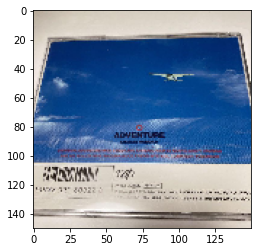

1/1 [==============================] - 0s 48ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 2.5151158e-38 4.4553543e-25
  8.0668360e-06 5.3996391e-08 2.7038716e-36 2.9869113e-15 0.0000000e+00
  0.0000000e+00 6.2036268e-26 0.0000000e+00 0.0000000e+00 1.1994773e-31
  3.8525703e-24 5.3819501e-28 2.8921869e-12 4.2549480e-02 1.5667989e-35
  3.2353100e-35 4.1718256e-38 5.4756911e-31 1.4525684e-25 9.5744234e-01
  2.1861715e-15 3.9209952e-16 0.0000000e+00 0.0000000e+00 7.4101309e-36
  2.6134217e-23 1.0646929e-34 1.1457893e-13 8.4027531e-25 0.0000000e+00
  2.0162274e-20 3.1545920e-29 0.0000000e+00 0.0000000e+00 0.0000000e+00
  4.5686766e-23]]
Tatsuro Yamashita - Big Wave = ビッグウェイブ , 95.74
5.m60441136707_2.jpg: Tatsuro Yamashita - Big Wave = ビッグウェイブ
--------------------------------------------------------------
2.m26133647428_1.jpg


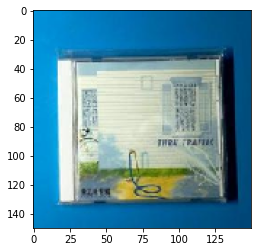

1/1 [==============================] - 0s 32ms/step
[[5.15911832e-30 4.35566635e-14 9.98958707e-01 1.68156166e-05
  1.66095912e-32 0.00000000e+00 0.00000000e+00 3.71940739e-14
  2.65894918e-16 1.46559608e-24 1.13935685e-34 0.00000000e+00
  1.00429892e-03 2.90753029e-19 1.66986359e-20 1.91886273e-38
  1.00472560e-15 3.47616181e-16 0.00000000e+00 0.00000000e+00
  2.99470987e-22 7.61989030e-36 2.31053409e-29 1.78648193e-32
  3.83671386e-06 1.07951975e-27 1.62030356e-05 1.07281647e-26
  2.58700110e-24 3.61361184e-11 8.10977667e-08 1.67895919e-20
  5.64800828e-09 2.10058483e-26 3.14676054e-37 1.38901174e-25
  2.12864177e-17 1.86267288e-23 7.89595532e-26 1.74695125e-23
  2.77916487e-32]]
Anri (2) - Timely!! , 99.90
2.m26133647428_1.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
4.m48985321505_1.jpg


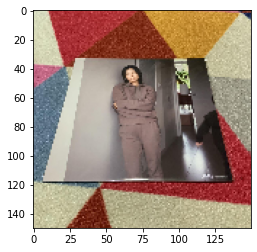

1/1 [==============================] - 0s 38ms/step
[[3.31097155e-26 2.17111522e-18 4.31114891e-24 9.06737071e-22
  0.00000000e+00 1.12185577e-13 4.65047270e-30 5.93980399e-26
  1.09607265e-06 1.17135576e-30 1.24277436e-31 2.43341695e-26
  2.89405418e-35 8.75747195e-15 2.67798221e-20 6.10094316e-27
  6.47336784e-28 1.39889874e-17 1.33353903e-27 6.14159466e-35
  6.85283863e-25 2.61832546e-18 1.03594564e-01 1.34469053e-12
  1.68525144e-25 0.00000000e+00 2.99462916e-32 2.57794359e-14
  3.89900345e-25 1.29005138e-21 4.71602507e-05 1.24675702e-18
  2.64214495e-18 8.96357179e-01 5.03224372e-12 6.52094290e-09
  2.68364371e-08 2.39363306e-20 3.05008251e-18 9.22697937e-20
  6.59154049e-33]]
Tatsuro Yamashita - Ride On Time , 89.64
4.m48985321505_1.jpg: Tatsuro Yamashita - Ride On Time
--------------------------------------------------------------
1.m24108902445_1.jpg


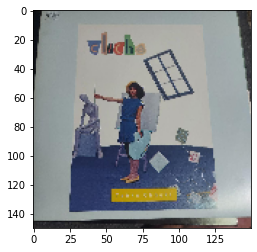

1/1 [==============================] - 0s 32ms/step
[[1.62168976e-22 1.52303466e-23 5.85723306e-25 2.09936629e-15
  5.20890786e-20 1.64100056e-04 1.71537074e-13 3.20523260e-15
  4.30681966e-13 9.12654826e-13 3.54727114e-09 6.64658801e-05
  3.67971123e-16 2.81821163e-17 2.38059556e-19 2.18240194e-25
  8.90566139e-18 5.61109366e-27 3.08154843e-15 9.99768555e-01
  4.09025773e-07 7.82872909e-25 2.82980381e-24 1.14322831e-13
  1.27715475e-21 1.85545820e-21 8.06778217e-26 8.13343674e-21
  1.40937839e-22 3.99963217e-20 4.42551737e-07 6.00744420e-17
  4.23685337e-10 1.10129488e-22 1.02182486e-27 7.92164486e-18
  9.57341928e-19 1.07897285e-14 9.29153427e-16 4.12340084e-12
  7.06871187e-15]]
Taeko Ohnuki - Cliché , 99.98
1.m24108902445_1.jpg: Taeko Ohnuki - Cliché
--------------------------------------------------------------
6.m29017044963_1.jpg


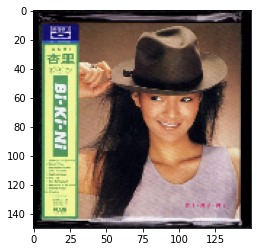

1/1 [==============================] - 0s 34ms/step
[[1.28649344e-05 2.27404946e-22 1.15054282e-23 6.16918427e-08
  1.69157009e-35 5.38257422e-26 4.28800358e-28 3.14257280e-35
  8.73897569e-12 2.65224376e-09 2.26009543e-26 2.28612753e-25
  1.41173900e-26 4.74309008e-14 2.70302899e-12 9.18856265e-28
  1.52672968e-23 4.77186276e-26 2.57026927e-36 4.05523486e-20
  4.94899567e-29 5.98134769e-13 1.20633151e-19 1.36102929e-22
  3.69164250e-28 0.00000000e+00 8.59740609e-38 9.99982953e-01
  1.04760883e-16 2.42921494e-14 4.11523024e-06 1.18413426e-23
  2.53218996e-27 1.62120179e-15 2.58255158e-12 3.65254106e-16
  1.05958363e-20 1.99540947e-19 1.17966535e-17 3.27071122e-22
  5.72930345e-34]]
Tatsuro Yamashita - Go Ahead! , 100.00
6.m29017044963_1.jpg: Tatsuro Yamashita - Go Ahead!
--------------------------------------------------------------
4.m96504827187_1.jpg


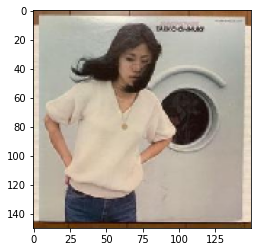

1/1 [==============================] - 0s 46ms/step
[[4.55733525e-28 2.80036889e-18 3.05932471e-12 3.27213274e-15
  8.05277840e-27 4.87800822e-09 2.13237155e-22 4.58992826e-12
  1.17505116e-12 3.72294307e-18 9.37921700e-16 9.32187702e-20
  2.38287839e-26 2.17810889e-20 2.02106148e-15 1.38382030e-19
  2.69803181e-20 1.94187638e-18 1.24558254e-21 4.15244926e-19
  1.11656906e-10 9.15735369e-12 9.99986649e-01 1.91589784e-08
  2.11099683e-22 7.45586764e-29 6.05607482e-22 4.73268116e-21
  1.81691327e-23 2.39955414e-25 8.33260039e-09 6.01871172e-17
  9.71146232e-13 1.60228231e-09 3.13497275e-18 8.69403812e-06
  4.66200527e-06 1.24602204e-10 1.88983300e-14 2.72748014e-22
  1.37269244e-23]]
Taeko Ohnuki - Romantique , 100.00
4.m96504827187_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
5.m46238719725_1.jpg


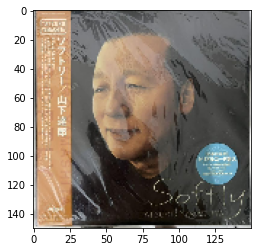

1/1 [==============================] - 0s 39ms/step
[[1.58177223e-13 9.99497771e-01 3.93082173e-14 2.88545273e-12
  3.94638327e-31 2.49363800e-16 2.20325430e-26 1.53059152e-12
  3.36810044e-04 4.81563065e-21 1.70708864e-11 1.21610422e-24
  5.85903342e-13 3.25563065e-09 2.87341375e-12 9.58012676e-22
  6.97155285e-16 4.44005438e-15 4.02984759e-28 2.03021770e-29
  2.89289588e-13 1.50276319e-12 1.74163517e-07 3.03956166e-10
  4.48695751e-25 6.36507416e-33 1.23987338e-22 3.06667876e-15
  1.43353260e-10 1.05737745e-10 1.98016073e-06 1.42241530e-09
  9.59915258e-10 7.01132596e-10 1.62628407e-04 4.49679204e-18
  5.68242797e-07 1.48020946e-13 1.19025248e-14 5.24359581e-13
  1.70853199e-22]]
Anri (2) - Coool , 99.95
5.m46238719725_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
1.m33186481522_1.jpg


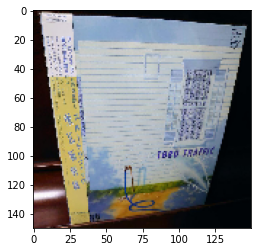

1/1 [==============================] - 0s 30ms/step
[[2.4327409e-36 4.1213343e-33 3.1319389e-18 3.8716893e-28 0.0000000e+00
  1.5206134e-19 8.5225089e-22 8.8986516e-24 3.2218624e-21 1.1360047e-28
  1.1177019e-35 1.6568888e-32 8.2926938e-29 4.2697082e-28 9.3174582e-31
  1.5974489e-14 3.4301514e-10 1.4999262e-25 1.1636774e-34 0.0000000e+00
  1.1885328e-06 7.7349161e-30 7.4434124e-25 9.9999881e-01 8.7528447e-23
  4.4002014e-37 5.9119784e-29 7.1114008e-30 9.3614034e-35 2.9057684e-17
  5.4431158e-08 2.2827819e-14 1.6509573e-18 8.5824931e-25 4.2438752e-27
  1.2358940e-15 4.5883829e-23 7.5278203e-14 9.5916145e-31 9.5504214e-33
  2.2473136e-14]]
Taeko Ohnuki - Sunshower , 100.00
1.m33186481522_1.jpg: Taeko Ohnuki - Sunshower
--------------------------------------------------------------
7.more_large.jpg


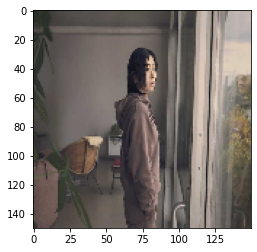

1/1 [==============================] - 0s 37ms/step
[[7.3831306e-12 9.6039177e-09 1.3727208e-07 1.5283635e-07 3.0317055e-13
  7.5311427e-06 6.3152406e-10 2.6788975e-09 1.6922657e-05 7.8415283e-08
  1.3324936e-06 9.4334247e-09 9.5976117e-14 8.9103858e-10 6.5710096e-06
  1.6501744e-10 4.6425832e-09 3.8302195e-10 9.6119945e-10 5.2614588e-09
  1.9316937e-07 1.5067678e-07 2.8833160e-01 1.4536856e-05 3.5939329e-10
  1.5341482e-12 1.5408176e-11 3.7807936e-08 3.1611036e-09 1.1147354e-11
  2.3517075e-04 5.4990314e-11 2.2826137e-06 6.9084708e-05 7.6499038e-09
  3.6246676e-04 7.1093112e-01 1.2951523e-07 2.0534279e-05 3.2199677e-12
  1.3701343e-10]]
Utada Hikaru - Badモード , 71.09
7.more_large.jpg: Utada Hikaru - Badモード
--------------------------------------------------------------
5.m24108902445_1.jpg


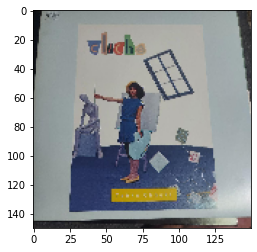

1/1 [==============================] - 0s 43ms/step
[[1.62168976e-22 1.52303466e-23 5.85723306e-25 2.09936629e-15
  5.20890786e-20 1.64100056e-04 1.71537074e-13 3.20523260e-15
  4.30681966e-13 9.12654826e-13 3.54727114e-09 6.64658801e-05
  3.67971123e-16 2.81821163e-17 2.38059556e-19 2.18240194e-25
  8.90566139e-18 5.61109366e-27 3.08154843e-15 9.99768555e-01
  4.09025773e-07 7.82872909e-25 2.82980381e-24 1.14322831e-13
  1.27715475e-21 1.85545820e-21 8.06778217e-26 8.13343674e-21
  1.40937839e-22 3.99963217e-20 4.42551737e-07 6.00744420e-17
  4.23685337e-10 1.10129488e-22 1.02182486e-27 7.92164486e-18
  9.57341928e-19 1.07897285e-14 9.29153427e-16 4.12340084e-12
  7.06871187e-15]]
Taeko Ohnuki - Cliché , 99.98
5.m24108902445_1.jpg: Taeko Ohnuki - Cliché
--------------------------------------------------------------
2.m31964477145_1.jpg


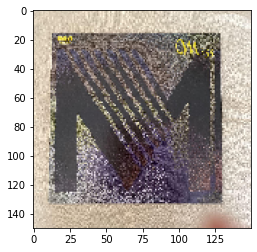

1/1 [==============================] - 0s 33ms/step
[[5.25382409e-17 2.48002967e-15 7.46323076e-06 2.97366176e-09
  3.48608859e-18 1.50691872e-12 1.06672707e-26 1.73340395e-05
  3.49305654e-11 8.81225860e-05 9.19883072e-01 5.45699149e-05
  4.59569681e-04 5.25476971e-12 1.38602044e-17 1.11579354e-20
  2.99584037e-21 6.01520659e-16 6.49261656e-22 1.65822325e-13
  5.89868705e-07 4.45613026e-11 3.75898514e-11 5.64154301e-13
  5.82016578e-22 4.26673762e-24 2.48666930e-16 2.43253383e-16
  7.35452357e-20 4.16656293e-13 5.37167580e-07 3.28672577e-05
  3.50148458e-13 7.47782603e-16 8.25725098e-20 2.91023905e-13
  8.96659247e-10 5.62020432e-05 1.36751242e-14 7.93996379e-02
  3.77638886e-23]]
Mariya Takeuchi - Miss M , 91.99
2.m31964477145_1.jpg: Mariya Takeuchi - Miss M
--------------------------------------------------------------
5.m33186481522_2.jpg


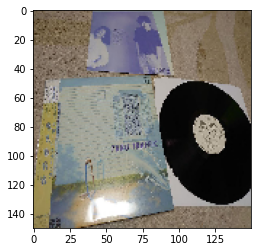

1/1 [==============================] - 0s 45ms/step
[[0.0000000e+00 0.0000000e+00 1.7569869e-19 1.1508272e-28 0.0000000e+00
  3.5146983e-31 1.3198475e-36 1.4487599e-31 6.0891753e-19 1.1327506e-23
  4.1198572e-35 0.0000000e+00 0.0000000e+00 0.0000000e+00 4.7982235e-21
  9.2026174e-34 4.0027535e-29 2.0677704e-30 0.0000000e+00 0.0000000e+00
  0.0000000e+00 7.9996076e-28 9.1303654e-10 1.1009471e-33 5.5276739e-36
  0.0000000e+00 0.0000000e+00 1.4058356e-33 0.0000000e+00 8.2928761e-33
  1.3866469e-16 1.2765556e-26 2.5763450e-25 1.0000000e+00 1.6079876e-37
  2.5859095e-22 6.6444950e-20 7.4598375e-36 6.2464474e-36 1.4718219e-38
  0.0000000e+00]]
Tatsuro Yamashita - Ride On Time , 100.00
5.m33186481522_2.jpg: Tatsuro Yamashita - Ride On Time
--------------------------------------------------------------
3.m71692766164_1.jpg


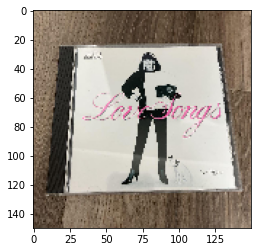

1/1 [==============================] - 0s 33ms/step
[[4.52408918e-37 0.00000000e+00 9.99528408e-01 1.95652678e-11
  0.00000000e+00 8.95815138e-29 0.00000000e+00 5.91695611e-22
  2.08752615e-35 4.70417202e-04 2.30315451e-22 8.96489332e-35
  8.72862390e-31 0.00000000e+00 5.26321833e-27 1.05822784e-16
  9.02110171e-24 2.33162056e-36 0.00000000e+00 1.92794324e-22
  3.33729906e-18 5.03708297e-10 1.15960677e-06 2.27478647e-21
  1.19552591e-38 0.00000000e+00 2.00063256e-38 5.50348788e-20
  0.00000000e+00 1.69454054e-34 1.54226714e-19 1.44167801e-23
  1.83189789e-36 3.97269630e-12 0.00000000e+00 2.77270933e-14
  9.75711367e-24 9.81692765e-12 3.62415742e-30 3.67482779e-32
  0.00000000e+00]]
Anri (2) - Timely!! , 99.95
3.m71692766164_1.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
5.m43379398272_4.jpg


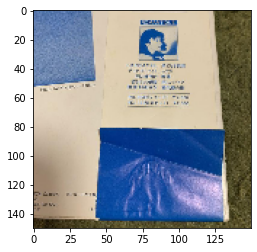

1/1 [==============================] - 0s 38ms/step
[[1.7370244e-15 3.0252859e-31 0.0000000e+00 1.5534164e-22 0.0000000e+00
  3.9986613e-15 2.3400355e-23 0.0000000e+00 4.9689298e-08 2.2139469e-30
  5.9948206e-33 4.7044229e-24 7.0480815e-29 1.5628262e-21 6.3675688e-14
  0.0000000e+00 3.7987007e-31 0.0000000e+00 2.4846677e-34 1.7214907e-10
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.3494263e-36
  0.0000000e+00 0.0000000e+00 6.5151614e-19 1.4757071e-30 5.0907031e-20
  1.0000000e+00 3.0150781e-31 5.2425281e-10 2.3572331e-34 5.3257184e-35
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 2.4907266e-12
  0.0000000e+00]]
Tatsuro Yamashita - Moonglow , 100.00
5.m43379398272_4.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
6.m77464499238_1.jpg


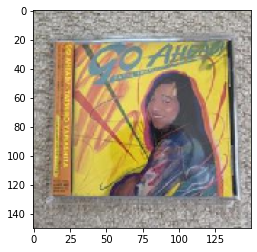

1/1 [==============================] - 0s 36ms/step
[[1.86511055e-08 3.76962781e-01 2.42035074e-14 2.75607908e-06
  1.64621397e-24 5.06822337e-23 6.66720832e-25 1.63583115e-21
  1.44523869e-06 1.00130069e-11 6.73498909e-13 4.93813532e-11
  2.87498331e-14 7.62996777e-09 1.82496515e-05 3.49117083e-23
  6.50587787e-12 8.81465451e-22 7.10423376e-29 6.01825716e-21
  7.07712714e-15 1.65090136e-10 1.83482035e-10 1.73363372e-11
  2.64214299e-20 1.06494427e-26 3.53771773e-23 1.81982759e-05
  3.59837941e-05 2.96200564e-10 4.77416108e-07 2.15326906e-16
  8.37744130e-15 4.13456460e-13 1.02899874e-04 4.60199523e-08
  1.19883660e-02 1.52442965e-15 6.10868692e-01 2.72870051e-18
  3.46058699e-20]]
Utada Hikaru - First Love , 61.09
6.m77464499238_1.jpg: Utada Hikaru - First Love
--------------------------------------------------------------
5.m33421071605_1.jpg


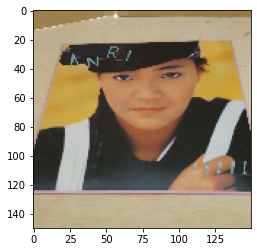

1/1 [==============================] - 0s 30ms/step
[[7.91312409e-15 9.99926805e-01 1.14872961e-21 5.37691040e-13
  2.10847058e-31 1.11150755e-20 1.84621078e-23 1.42852070e-22
  1.71262997e-07 7.40388637e-24 2.34280313e-15 1.75760068e-21
  1.45339056e-18 3.09263669e-07 8.38587825e-13 1.02493397e-20
  1.18193232e-17 1.23834481e-21 1.78939656e-29 1.39096435e-30
  9.75693778e-18 4.23080583e-17 4.21400068e-12 1.08702023e-11
  4.39705003e-29 8.93887797e-37 2.14904171e-29 8.14864409e-12
  4.71792373e-06 2.52421989e-17 4.16209471e-12 2.78378335e-22
  3.89270356e-14 1.15021686e-12 3.18967286e-05 1.83681577e-11
  2.02757519e-06 3.10325208e-20 3.40404586e-05 8.14466023e-21
  3.65859804e-23]]
Anri (2) - Coool , 99.99
5.m33421071605_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
2.m80121781767_1.jpg


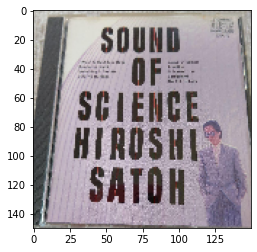

1/1 [==============================] - 0s 29ms/step
[[0.00000000e+00 4.17719038e-28 1.13076615e-09 7.94924337e-25
  4.00587399e-34 8.55038368e-24 0.00000000e+00 9.99999881e-01
  1.51782439e-23 1.57644175e-10 6.38774438e-08 1.93198883e-23
  2.49380221e-19 2.83042031e-28 7.21317880e-38 7.57355570e-36
  0.00000000e+00 7.69988591e-24 3.98075652e-33 1.69799748e-22
  1.71095397e-13 1.13421095e-17 1.02862913e-07 1.84347944e-25
  4.28709369e-36 0.00000000e+00 1.38677573e-28 7.78220331e-34
  0.00000000e+00 1.80518540e-31 1.45628280e-18 1.45740309e-10
  2.24963917e-19 4.72342360e-19 9.92670082e-35 1.40126811e-26
  8.69548820e-21 6.06917164e-12 0.00000000e+00 3.37652489e-10
  0.00000000e+00]]
Hiroshi Sato - Sound Of Science , 100.00
2.m80121781767_1.jpg: Hiroshi Sato - Sound Of Science
--------------------------------------------------------------
4.m63628826498_1.jpg


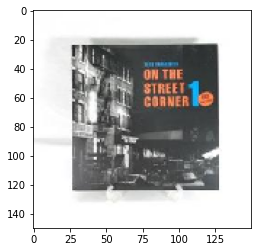

1/1 [==============================] - 0s 54ms/step
[[1.7673198e-16 1.6518717e-10 9.5638454e-02 5.5023533e-01 4.4242717e-22
  9.8555513e-16 2.4754948e-29 1.1009027e-13 3.5381961e-01 1.8047828e-18
  6.5996042e-11 7.0459440e-16 2.6201680e-12 1.8421134e-11 1.6053393e-06
  1.2438274e-13 2.5702439e-12 5.0285349e-11 1.6344535e-24 5.7670447e-27
  4.8199932e-14 1.0622059e-07 1.9100044e-07 9.4172371e-14 4.0006887e-14
  1.9505047e-26 1.2939616e-15 2.9644157e-16 1.8200623e-18 2.4588516e-17
  1.6884349e-09 4.2541159e-14 5.5444769e-07 1.6536144e-07 5.3881730e-16
  2.6778568e-04 3.6074784e-05 1.4956408e-11 4.1737551e-09 8.8345971e-08
  8.9157148e-23]]
Anri (2) - Wave , 55.02
4.m63628826498_1.jpg: Anri (2) - Wave
--------------------------------------------------------------
1.m26092923537_1.jpg


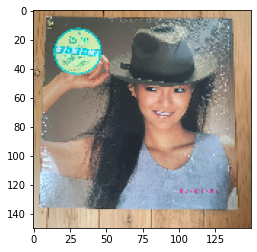

1/1 [==============================] - 0s 37ms/step
[[5.48367761e-02 5.42964465e-08 1.20385310e-13 2.21650735e-01
  2.12641298e-12 2.57539227e-07 2.22067888e-13 9.47301531e-16
  2.52469480e-02 8.90533556e-06 2.76955236e-02 1.20279334e-01
  2.70531814e-06 1.39223796e-03 1.76681744e-04 1.88252427e-17
  3.30212246e-11 8.85642430e-19 1.27228520e-15 9.19186496e-05
  5.86179938e-10 2.33172271e-12 2.19157679e-14 3.19243035e-11
  1.11659814e-16 9.24629520e-18 8.53167138e-20 4.55318112e-03
  2.97219987e-04 9.14760562e-07 4.72130775e-01 4.85362889e-13
  4.69661821e-08 2.42326048e-10 5.16672607e-11 2.32661248e-13
  3.85316469e-07 2.16291096e-10 1.67359188e-02 5.48995659e-02
  4.78704905e-16]]
Tatsuro Yamashita - Moonglow , 47.21
1.m26092923537_1.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
1.m85720853383_1.jpg


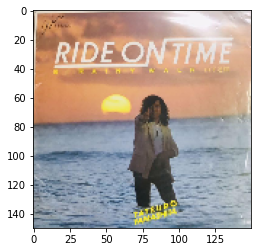

1/1 [==============================] - 0s 42ms/step
[[8.4395344e-07 2.3264189e-03 1.5951522e-25 3.7985385e-06 2.1702970e-19
  1.8063700e-05 4.3167957e-14 4.0362883e-17 3.5167665e-03 5.7118973e-16
  6.4513786e-04 1.0531094e-06 1.0212924e-03 4.7534910e-01 6.0561072e-04
  6.3493301e-21 5.8911509e-10 1.9578155e-26 7.5964859e-21 8.2385977e-06
  1.0527738e-10 7.0483043e-23 7.1235876e-22 1.2808871e-11 2.3874821e-26
  1.0370682e-23 5.1438295e-27 9.2449176e-10 5.1540327e-01 1.8263984e-12
  8.9281588e-05 5.5514659e-18 1.0571314e-04 2.0530764e-15 1.3405876e-11
  5.6069900e-19 9.6979304e-13 2.4739470e-19 8.9791231e-04 7.5305302e-06
  3.7233463e-15]]
Tatsuro Yamashita - It's A Poppin' Time , 51.54
1.m85720853383_1.jpg: Tatsuro Yamashita - It's A Poppin' Time
--------------------------------------------------------------
3.m85860739963_1.jpg


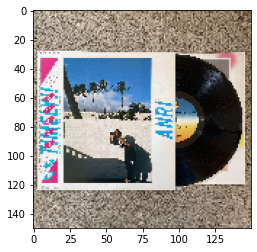

1/1 [==============================] - 0s 125ms/step
[[0.0000000e+00 0.0000000e+00 9.8283708e-01 4.5159259e-21 5.0549831e-10
  4.8532848e-19 0.0000000e+00 4.6891982e-13 1.1499990e-32 3.5006757e-14
  5.9786857e-20 8.0058394e-18 2.5816286e-23 2.3908863e-32 0.0000000e+00
  5.2914625e-23 0.0000000e+00 1.0426783e-08 9.2404524e-21 7.5556610e-28
  2.8294560e-14 6.5982362e-14 1.6757354e-18 4.6853302e-23 1.2939194e-27
  4.9094242e-27 3.5563165e-08 5.7254582e-36 0.0000000e+00 4.8868777e-32
  9.6874668e-19 2.6277808e-08 0.0000000e+00 1.0974495e-25 0.0000000e+00
  9.8592211e-12 7.6174608e-25 1.7155603e-02 3.4240217e-21 7.2661783e-06
  0.0000000e+00]]
Anri (2) - Timely!! , 98.28
3.m85860739963_1.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
2.m39915736818_1.jpg


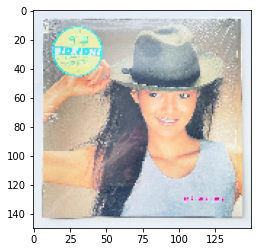

1/1 [==============================] - 0s 32ms/step
[[7.4775697e-04 1.3389875e-06 5.0361009e-06 9.4226176e-01 3.2477559e-11
  6.2728023e-10 8.8681406e-12 2.1183684e-10 3.7592325e-02 5.2216578e-09
  3.2530232e-05 9.6082445e-08 1.3867809e-04 3.9780388e-09 1.7712697e-02
  5.6172036e-09 2.6990585e-05 1.4809152e-09 7.0534171e-13 2.5276029e-12
  4.5008136e-11 4.9090003e-09 6.7219871e-06 3.9531486e-08 3.1731240e-09
  4.8511786e-13 5.8117600e-10 5.4528664e-07 1.1528668e-06 3.2673324e-08
  8.2429644e-05 1.1619630e-08 1.7745782e-05 1.8565924e-04 5.2143827e-09
  1.1274770e-08 6.1338465e-04 3.8962885e-11 5.7234732e-04 1.3982954e-07
  4.0317730e-07]]
Anri (2) - Wave , 94.23
2.m39915736818_1.jpg: Anri (2) - Wave
--------------------------------------------------------------
4.m51175755924_1.jpg


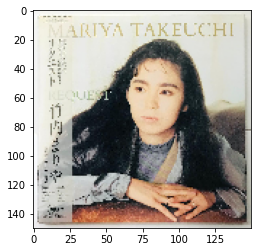

1/1 [==============================] - 0s 48ms/step
[[4.5799589e-23 2.2091014e-25 6.8084202e-21 2.3175067e-23 7.4788359e-30
  3.0216521e-16 1.4218055e-32 1.7771054e-14 2.9007348e-15 3.0609550e-05
  1.5711043e-14 9.9996936e-01 2.1219861e-17 1.4987627e-23 4.1857048e-22
  4.3156768e-36 1.8653804e-25 1.0602320e-28 1.0915590e-25 1.6233611e-19
  3.1479238e-16 2.2197017e-26 6.8616487e-25 2.8704024e-20 1.8702418e-23
  4.5561710e-31 9.5477226e-28 1.1522302e-25 2.5093783e-32 5.3802373e-13
  4.9530041e-08 3.4961634e-09 3.4309215e-17 6.6521398e-24 5.0149392e-33
  7.0089810e-24 1.4262368e-19 3.2676977e-15 3.1252159e-30 1.8191668e-12
  9.0109400e-32]]
Mariya Takeuchi - Request , 100.00
4.m51175755924_1.jpg: Mariya Takeuchi - Request
--------------------------------------------------------------
2.m50731521306_1.jpg


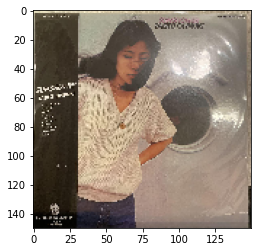

1/1 [==============================] - 0s 38ms/step
[[4.1891528e-18 2.6983906e-12 1.7360032e-11 1.1076809e-09 1.1473634e-17
  5.9804802e-06 4.6775230e-13 3.4399079e-14 1.3665779e-09 7.1824576e-17
  2.3117204e-13 5.3796903e-13 4.8663786e-13 4.9854414e-09 1.2292859e-15
  1.3768554e-08 3.9080330e-08 4.4377076e-12 3.4607814e-15 6.4044265e-20
  6.6573374e-02 2.8221100e-14 3.3069970e-11 9.2989808e-01 2.2503355e-13
  3.8362175e-16 3.1325738e-14 6.6588809e-15 1.2691724e-10 8.0630618e-14
  3.5149367e-03 2.1353763e-12 1.0479024e-11 5.2414076e-16 7.1971540e-11
  4.8393636e-06 2.4316122e-08 7.0594632e-07 2.0087116e-06 2.4435361e-13
  2.9486330e-08]]
Taeko Ohnuki - Sunshower , 92.99
2.m50731521306_1.jpg: Taeko Ohnuki - Sunshower
--------------------------------------------------------------
1.m43379398272_4.jpg


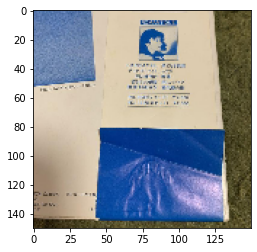

1/1 [==============================] - 0s 48ms/step
[[1.7370244e-15 3.0252859e-31 0.0000000e+00 1.5534164e-22 0.0000000e+00
  3.9986613e-15 2.3400355e-23 0.0000000e+00 4.9689298e-08 2.2139469e-30
  5.9948206e-33 4.7044229e-24 7.0480815e-29 1.5628262e-21 6.3675688e-14
  0.0000000e+00 3.7987007e-31 0.0000000e+00 2.4846677e-34 1.7214907e-10
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.3494263e-36
  0.0000000e+00 0.0000000e+00 6.5151614e-19 1.4757071e-30 5.0907031e-20
  1.0000000e+00 3.0150781e-31 5.2425281e-10 2.3572331e-34 5.3257184e-35
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 2.4907266e-12
  0.0000000e+00]]
Tatsuro Yamashita - Moonglow , 100.00
1.m43379398272_4.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
2.m82259480950_1.jpg


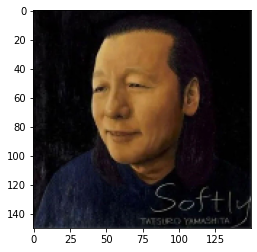

1/1 [==============================] - 0s 58ms/step
[[1.69787929e-21 4.13839445e-02 1.49658563e-28 1.65576565e-22
  0.00000000e+00 8.01083386e-28 2.43471756e-36 1.40407448e-27
  2.80138863e-08 0.00000000e+00 6.89996611e-31 0.00000000e+00
  1.20087026e-23 2.19378044e-14 1.56104671e-23 3.43657537e-32
  2.27356098e-25 4.35264403e-19 0.00000000e+00 0.00000000e+00
  2.09580854e-22 3.72734946e-18 3.74792591e-17 2.37164414e-14
  8.20567590e-38 0.00000000e+00 1.22878572e-30 2.14558277e-22
  2.01846393e-13 7.05438089e-17 1.23233162e-12 5.53590160e-19
  1.13090267e-20 2.87356438e-20 9.58616138e-01 9.74871972e-23
  1.62266949e-14 8.59944152e-23 1.01045439e-17 8.89529925e-29
  8.65430883e-36]]
Tatsuro Yamashita - Softly , 95.86
2.m82259480950_1.jpg: Tatsuro Yamashita - Softly
--------------------------------------------------------------
5.m73956717062_1.jpg


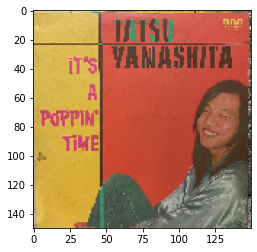

1/1 [==============================] - 0s 57ms/step
[[1.8542345e-10 8.1424780e-02 1.6214192e-28 2.3615948e-10 1.6050473e-31
  2.4929836e-23 5.7511499e-28 6.4233060e-31 7.8609440e-07 7.4773768e-27
  3.0734516e-21 2.3001995e-19 5.1499014e-17 8.8934922e-07 6.3153665e-13
  4.6808268e-28 1.0955349e-20 1.7733680e-24 1.6328234e-33 4.8621235e-31
  2.5775437e-21 2.7259944e-20 9.4082613e-19 1.0740290e-14 2.6510312e-26
  2.3743386e-34 2.9552688e-29 1.1756753e-10 9.1590089e-01 1.1159552e-18
  1.3871960e-13 1.4354522e-27 5.2827272e-21 5.5371089e-16 2.2121606e-06
  3.3620317e-14 3.3942602e-11 1.4083086e-23 2.6705428e-03 6.5502748e-22
  9.2517676e-27]]
Tatsuro Yamashita - It's A Poppin' Time , 91.59
5.m73956717062_1.jpg: Tatsuro Yamashita - It's A Poppin' Time
--------------------------------------------------------------
5.m80755372662_1.jpg


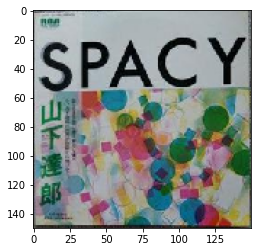

1/1 [==============================] - 0s 43ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 3.0695100e-36 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.8307080e-36 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.0000000e+00 2.6892554e-32 0.0000000e+00 4.9592751e-33 0.0000000e+00
  0.0000000e+00]]
Tatsuro Yamashita - Spacy , 100.00
5.m80755372662_1.jpg: Tatsuro Yamashita - Spacy
--------------------------------------------------------------
4.m38682487476_1.jpg


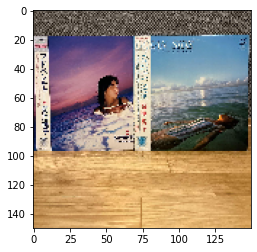

1/1 [==============================] - 0s 39ms/step
[[9.27263246e-17 1.91334429e-21 2.43151262e-01 1.39501974e-01
  7.24542636e-18 1.74651538e-09 6.05127264e-30 1.68822961e-22
  1.95446341e-06 8.01203212e-19 7.84334111e-21 2.23468192e-07
  3.30700431e-24 3.11952515e-18 1.15254042e-18 1.33486235e-08
  3.81936496e-12 9.97603996e-12 9.92914627e-28 2.01231830e-27
  1.38022892e-14 4.33659136e-01 2.17534035e-09 5.75949471e-14
  8.12433940e-11 1.84192786e-28 4.98466925e-16 5.42993206e-09
  9.54292926e-23 1.89638493e-13 5.41560767e-05 1.82416263e-10
  6.35048688e-24 1.88007070e-05 1.49635504e-16 1.79919153e-01
  1.10625695e-13 3.58657516e-03 1.06595769e-04 1.73649241e-07
  1.90492526e-21]]
Taeko Ohnuki - Mignonne , 43.37
4.m38682487476_1.jpg: Taeko Ohnuki - Mignonne
--------------------------------------------------------------
6.m46535537012_2.jpg


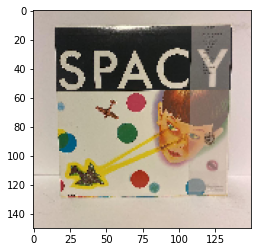

1/1 [==============================] - 0s 39ms/step
[[0.00000000e+00 2.08906193e-34 2.60485415e-26 2.09354139e-23
  0.00000000e+00 3.23702663e-24 0.00000000e+00 7.69646982e-34
  4.13892724e-23 2.29165614e-27 1.53570402e-31 8.06076009e-18
  4.21017209e-38 6.65344134e-37 0.00000000e+00 0.00000000e+00
  0.00000000e+00 2.73434217e-28 0.00000000e+00 0.00000000e+00
  1.75637948e-24 3.10465951e-15 4.02605447e-17 6.61325674e-30
  1.45869296e-37 0.00000000e+00 1.17520105e-35 1.80939335e-36
  2.52465967e-36 0.00000000e+00 3.79567322e-16 1.50307056e-35
  1.35453657e-37 0.00000000e+00 1.27108996e-32 1.00000000e+00
  8.79156539e-17 9.20291239e-16 5.24064208e-16 1.09514403e-36
  0.00000000e+00]]
Tatsuro Yamashita - Spacy , 100.00
6.m46535537012_2.jpg: Tatsuro Yamashita - Spacy
--------------------------------------------------------------
4.m75067930064_1.jpg


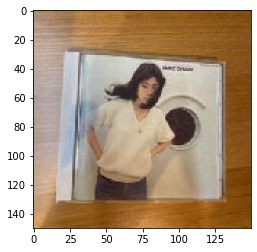

1/1 [==============================] - 0s 37ms/step
[[2.2433344e-09 8.4442711e-08 2.7331151e-10 6.3463664e-03 8.2008762e-21
  1.7370712e-05 5.3649834e-15 9.4316060e-18 6.0933429e-01 5.5171848e-20
  1.1243483e-13 3.5121170e-07 1.3367904e-15 1.1115701e-08 5.6479421e-10
  1.9634903e-09 2.1011175e-08 3.1817871e-09 4.5664123e-19 1.4539451e-19
  1.8582876e-15 1.5554115e-05 2.6609916e-05 2.3830199e-10 6.7481042e-11
  2.1295271e-25 7.4598762e-18 5.5630551e-07 1.5572837e-08 9.0128778e-14
  1.5900983e-03 4.2122485e-13 2.2193544e-11 3.6564294e-01 1.5262452e-07
  5.7418365e-03 8.0787277e-07 4.3120146e-10 1.1282999e-02 5.4982436e-09
  3.2823463e-11]]
Mariya Takeuchi - Beginning , 60.93
4.m75067930064_1.jpg: Mariya Takeuchi - Beginning
--------------------------------------------------------------
1.m43395571926_1.jpg


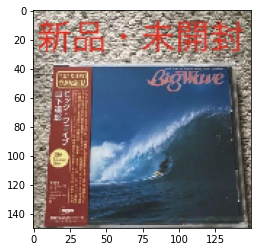

1/1 [==============================] - 0s 34ms/step
[[8.45470402e-38 3.11936912e-36 9.99969387e-38 1.37662306e-37
  6.22696244e-28 9.99900460e-01 1.37185125e-05 1.42308423e-34
  1.16823033e-12 0.00000000e+00 0.00000000e+00 5.35707529e-20
  0.00000000e+00 8.15145617e-32 9.18980534e-35 5.30405147e-13
  1.83767946e-25 1.31545441e-09 8.58224375e-05 4.81999598e-29
  1.67322266e-29 1.06428754e-29 2.72483799e-18 1.04869735e-17
  1.29385536e-09 8.36482990e-27 3.88391920e-24 2.62762826e-33
  0.00000000e+00 1.39450860e-30 1.15289527e-15 1.24762679e-25
  3.04887434e-15 1.01362529e-13 6.35132840e-28 1.77036337e-13
  4.57508831e-22 2.95593153e-27 4.14959775e-30 2.47620469e-29
  4.65535749e-19]]
Hiroshi Sato - Awakening , 99.99
1.m43395571926_1.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
2.m91157937794_1.jpg


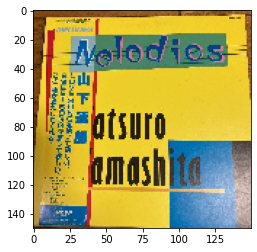

1/1 [==============================] - 0s 31ms/step
[[3.0467981e-35 1.2367425e-33 2.4721557e-37 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 1.5832461e-21 3.8740430e-28 0.0000000e+00
  1.2010095e-38 0.0000000e+00 2.1640348e-19 3.5592418e-28 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+00
  8.7651420e-25 2.3644572e-14 1.9552718e-21 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 7.0086555e-14
  0.0000000e+00]]
Tatsuro Yamashita - Melodies , 100.00
2.m91157937794_1.jpg: Tatsuro Yamashita - Melodies
--------------------------------------------------------------
3.m13512759082_1.jpg


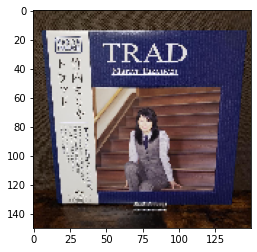

1/1 [==============================] - 0s 37ms/step
[[1.5462901e-22 3.0586100e-30 1.8237057e-23 4.3312163e-17 2.3440494e-33
  4.9172063e-17 1.0089350e-36 8.5031090e-17 1.1641061e-07 7.7397909e-21
  6.5387230e-14 9.9709988e-01 3.7713678e-06 7.7961850e-20 1.1421871e-37
  2.7154875e-32 9.6565456e-26 2.1695836e-29 0.0000000e+00 3.9735281e-34
  7.5731341e-23 1.9392653e-32 2.9519713e-36 4.0783353e-28 1.7974747e-37
  0.0000000e+00 3.8952457e-34 5.3101737e-27 6.8649891e-33 7.8829711e-20
  2.1801944e-07 5.6295669e-17 3.8592892e-12 1.2566704e-28 2.9793359e-37
  2.9617740e-28 4.5653295e-33 3.7629364e-19 7.3174339e-30 2.8960169e-03
  1.4398944e-29]]
Mariya Takeuchi - Request , 99.71
3.m13512759082_1.jpg: Mariya Takeuchi - Request
--------------------------------------------------------------
7.m56641359190_1.jpg


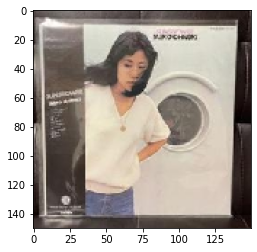

1/1 [==============================] - 0s 43ms/step
[[2.2837897e-13 3.4522651e-10 6.4706778e-06 4.9227169e-06 1.1937760e-11
  1.0617985e-04 7.3182491e-07 4.2515818e-08 1.1647431e-05 7.3905552e-12
  4.0701959e-08 1.7924068e-09 1.5474022e-12 1.1605477e-12 7.9228428e-09
  4.4826225e-05 8.6933210e-07 3.5262975e-09 8.0008333e-10 6.6884601e-12
  1.6786614e-04 1.1772388e-06 9.8644662e-01 8.0908984e-03 3.8882457e-09
  4.4292060e-13 1.2972461e-11 2.0288386e-11 2.2995726e-10 6.4590721e-14
  7.2578987e-05 3.3506502e-09 7.8105477e-06 2.7114907e-04 1.9060929e-10
  3.6195088e-03 1.1444492e-03 4.1134422e-07 1.8907945e-06 5.9136558e-12
  6.3746155e-09]]
Taeko Ohnuki - Romantique , 98.64
7.m56641359190_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
3.m69447274667_1.jpg


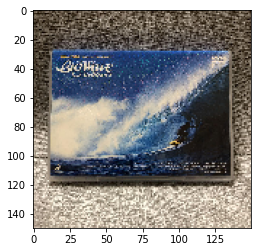

1/1 [==============================] - 0s 31ms/step
[[1.30815474e-35 5.58775833e-29 1.76655760e-12 2.05789948e-19
  4.90920031e-22 7.37467246e-07 1.93792645e-21 1.23547697e-22
  6.24616938e-12 4.25376601e-36 2.92111169e-31 7.03304838e-28
  0.00000000e+00 4.55401934e-31 1.23495323e-23 2.20740350e-08
  5.82793251e-21 4.89219125e-13 1.26708693e-17 1.29116637e-32
  6.21118976e-21 4.29511841e-13 9.99443710e-01 7.10840946e-13
  5.79472951e-19 2.20536714e-30 1.86164535e-22 2.56951379e-26
  1.11401766e-35 3.87599044e-31 9.83045568e-14 2.55686907e-20
  3.19850038e-15 5.51963341e-04 2.41298225e-23 3.52106531e-06
  3.56383738e-12 5.49679880e-17 1.43259847e-15 1.25920608e-21
  2.12589213e-25]]
Taeko Ohnuki - Romantique , 99.94
3.m69447274667_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
3.m26723730147_1.jpg


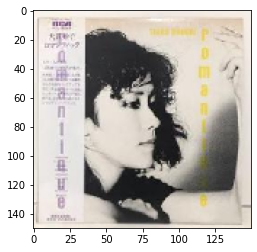

1/1 [==============================] - 0s 54ms/step
[[0.0000000e+00 0.0000000e+00 3.8185158e-17 2.2259796e-31 0.0000000e+00
  0.0000000e+00 0.0000000e+00 7.1405048e-20 6.7344361e-30 2.9027478e-24
  2.3231565e-21 0.0000000e+00 0.0000000e+00 0.0000000e+00 3.2083449e-32
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.7845711e-37
  1.4565846e-31 6.1838379e-27 1.0000000e+00 8.0271030e-32 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.2238421e-24 9.6916346e-30 8.4662734e-28 6.2913653e-11 0.0000000e+00
  7.0167499e-36 3.7564424e-20 9.1444064e-30 0.0000000e+00 7.7431933e-37
  0.0000000e+00]]
Taeko Ohnuki - Romantique , 100.00
3.m26723730147_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
3.m69412039756_1.jpg


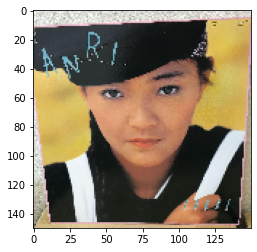

1/1 [==============================] - 0s 34ms/step
[[1.3170081e-35 9.9713659e-01 4.8134204e-31 6.5444285e-29 0.0000000e+00
  7.1621514e-26 0.0000000e+00 4.0909044e-28 8.3063709e-11 0.0000000e+00
  1.2852788e-34 0.0000000e+00 1.4374261e-32 1.4514521e-13 3.6287064e-31
  1.2180665e-34 2.4107830e-32 8.9367131e-22 0.0000000e+00 0.0000000e+00
  1.4111726e-18 9.9237173e-21 1.0649316e-20 3.3479523e-14 0.0000000e+00
  0.0000000e+00 0.0000000e+00 8.4057332e-32 1.6629326e-18 7.7306475e-25
  1.7084289e-13 4.8262233e-21 3.5355250e-20 3.2410482e-30 2.8633603e-03
  6.6340895e-21 1.7107081e-17 4.3723740e-20 1.1437640e-22 4.6689793e-30
  0.0000000e+00]]
Anri (2) - Coool , 99.71
3.m69412039756_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
3.m64096545118_1.jpg


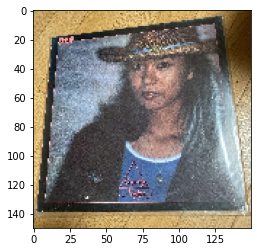

1/1 [==============================] - 0s 34ms/step
[[1.5818635e-21 2.2933687e-13 5.0905601e-30 1.2898962e-16 8.4100393e-35
  6.6353555e-11 1.6960352e-23 7.0728708e-26 8.2030589e-08 5.5658148e-24
  8.8688426e-23 4.7589519e-16 1.4801281e-21 7.3345126e-09 2.5148998e-16
  4.4056907e-33 2.6096839e-21 1.6685021e-27 5.3777959e-28 1.9179697e-24
  9.1696399e-12 7.6354449e-25 2.1556624e-20 1.1083722e-10 6.4089451e-26
  4.3927498e-34 5.8253310e-35 7.7799480e-19 2.6965468e-11 2.4576952e-21
  9.9999988e-01 5.9526442e-24 1.8913683e-11 1.7120913e-23 4.7152440e-14
  3.8752102e-13 1.0305918e-13 6.5849470e-19 2.6268855e-12 1.5956719e-18
  4.6153444e-26]]
Tatsuro Yamashita - Moonglow , 100.00
3.m64096545118_1.jpg: Tatsuro Yamashita - Moonglow
--------------------------------------------------------------
3.m43379398272_2.jpg


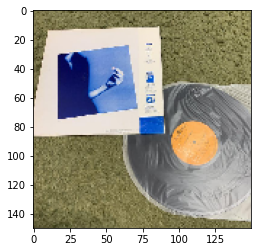

1/1 [==============================] - 0s 35ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.5060809e-24
  1.7705799e-17 0.0000000e+00 4.0888475e-32 1.5984714e-37 0.0000000e+00
  0.0000000e+00 1.6259121e-37 9.4289458e-33 1.5649385e-28 0.0000000e+00
  2.7150899e-30 0.0000000e+00 1.0000000e+00 4.1788536e-18 0.0000000e+00
  0.0000000e+00 0.0000000e+00 1.1930328e-37 8.0404724e-30 4.8529661e-37
  0.0000000e+00 3.2433929e-16 0.0000000e+00 0.0000000e+00 0.0000000e+00
  4.4280522e-32 4.9298018e-30 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.0513382e-23 0.0000000e+00 4.4625129e-23 0.0000000e+00 2.2843711e-17
  0.0000000e+00]]
Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線 , 100.00
3.m43379398272_2.jpg: Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線
--------------------------------------------------------------
5.m33465577871_1.jpg


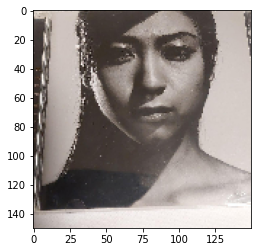

1/1 [==============================] - 0s 30ms/step
[[3.4630445e-21 2.4364810e-14 1.2208933e-06 7.8107759e-10 2.2882011e-12
  3.2234348e-07 5.3114204e-14 1.8052227e-09 7.2909135e-12 3.4538963e-09
  1.0202622e-07 1.5030466e-10 1.4587517e-14 1.4389018e-11 7.2873158e-15
  3.1996302e-13 1.8590579e-14 5.3412530e-12 2.4722413e-10 8.3671181e-11
  9.6451390e-01 2.9977880e-09 9.2933384e-05 2.6588676e-02 1.2416546e-13
  9.4976900e-12 2.9848241e-10 1.5799791e-13 5.2345454e-13 3.8892234e-15
  1.4739500e-04 2.9897209e-12 5.9823535e-12 9.6749187e-15 4.1582447e-14
  5.6822505e-04 7.0124920e-03 7.3085079e-04 3.4394325e-04 1.4488484e-12
  7.1778411e-15]]
Taeko Ohnuki - Grey Skies , 96.45
5.m33465577871_1.jpg: Taeko Ohnuki - Grey Skies
--------------------------------------------------------------
5.m14209987290_1.jpg


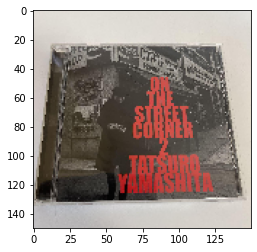

1/1 [==============================] - 0s 35ms/step
[[3.1953826e-04 9.9645668e-01 4.7410736e-10 1.3448099e-03 7.9955065e-20
  9.2171982e-15 1.4603266e-15 4.2507096e-12 1.5896317e-03 1.3131773e-11
  1.1162435e-04 1.3319965e-10 5.4351863e-06 5.6802399e-08 1.2594266e-04
  2.2575347e-12 7.1776443e-09 6.1057138e-15 5.0391858e-19 4.1914115e-17
  1.0754044e-11 2.8018873e-10 3.7030032e-09 9.5749984e-11 8.1878867e-14
  2.2626803e-21 3.4734376e-17 2.7211472e-10 7.2886501e-06 3.0686817e-08
  5.0774469e-07 2.4027771e-11 2.7274908e-05 2.8533809e-10 2.4393381e-07
  1.6043410e-12 1.0216626e-05 2.2196964e-12 6.2351421e-07 1.3350195e-08
  6.6840590e-14]]
Anri (2) - Coool , 99.65
5.m14209987290_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
7.i-img1200x1200-1655519203mbgupd505188.jpg


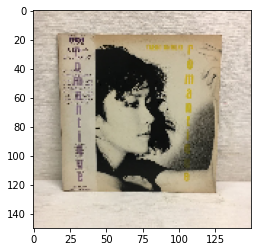

1/1 [==============================] - 0s 38ms/step
[[0.0000000e+00 0.0000000e+00 1.6114021e-14 1.3046530e-24 0.0000000e+00
  5.1495671e-29 0.0000000e+00 2.5022143e-21 6.6828669e-31 4.6013287e-21
  7.6042645e-23 0.0000000e+00 0.0000000e+00 0.0000000e+00 8.8232028e-27
  0.0000000e+00 3.5730829e-32 0.0000000e+00 0.0000000e+00 3.3849847e-29
  9.4885759e-21 1.2818626e-22 1.0000000e+00 3.5073970e-17 0.0000000e+00
  0.0000000e+00 0.0000000e+00 1.0284327e-34 0.0000000e+00 0.0000000e+00
  3.1374942e-16 1.5748487e-29 7.0421922e-30 9.7178819e-15 0.0000000e+00
  1.5946004e-19 7.2560169e-14 3.7609285e-21 9.0715050e-32 0.0000000e+00
  0.0000000e+00]]
Taeko Ohnuki - Romantique , 100.00
7.i-img1200x1200-1655519203mbgupd505188.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
3.m75849161538_3.jpg


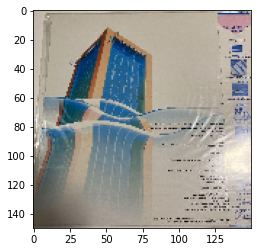

1/1 [==============================] - 0s 42ms/step
[[1.93606844e-32 1.29150831e-29 5.71452101e-18 8.75995849e-19
  1.06581545e-04 6.03855820e-03 5.25844724e-16 1.21290376e-21
  2.02389824e-11 4.83243087e-35 1.84667830e-30 6.12113937e-24
  2.36102111e-28 4.21895039e-24 3.99830375e-27 6.83843260e-11
  1.91846351e-29 9.90864336e-01 2.36527016e-03 1.51346195e-28
  3.71453974e-18 9.59105062e-15 8.39772918e-10 2.05091343e-11
  2.37014586e-08 1.53442574e-08 5.89690579e-04 8.32262399e-29
  4.83692528e-30 4.24858541e-32 1.05052864e-16 2.36854954e-24
  1.26474005e-17 1.88664988e-18 2.47866332e-22 3.55618395e-05
  8.86806861e-12 2.57661121e-14 3.48339998e-12 1.91692682e-22
  2.31060797e-28]]
Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線 , 99.09
3.m75849161538_3.jpg: Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線
--------------------------------------------------------------
1.m50605353925_1.jpg


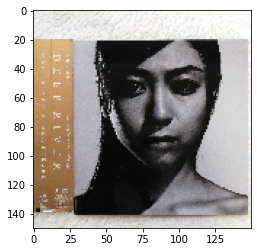

1/1 [==============================] - 0s 41ms/step
[[0.0000000e+00 4.1411325e-37 3.1369577e-11 4.2895687e-23 0.0000000e+00
  1.7016308e-24 0.0000000e+00 2.2423470e-09 8.1873677e-34 5.6586628e-06
  2.8255737e-08 5.2260308e-08 3.1995003e-26 2.1026585e-26 0.0000000e+00
  0.0000000e+00 0.0000000e+00 7.7526574e-32 0.0000000e+00 3.3187340e-22
  2.6813638e-09 2.4821477e-12 3.5113420e-12 2.3155210e-25 0.0000000e+00
  0.0000000e+00 9.7146054e-37 3.5974035e-34 0.0000000e+00 0.0000000e+00
  1.2603593e-13 8.7641586e-17 0.0000000e+00 2.2371312e-35 0.0000000e+00
  1.0822144e-09 2.4282280e-18 9.9999440e-01 6.4069298e-26 1.1395224e-12
  0.0000000e+00]]
Utada Hikaru - Deep River , 100.00
1.m50605353925_1.jpg: Utada Hikaru - Deep River
--------------------------------------------------------------
5.m80121781767_2.jpg


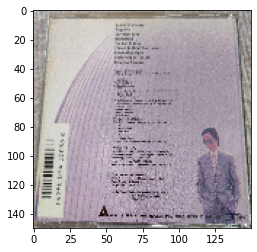

1/1 [==============================] - 0s 50ms/step
[[1.15510775e-04 6.20144492e-05 5.10101381e-04 2.08446727e-04
  8.58324202e-05 2.59892583e-01 5.61901182e-02 1.52777496e-03
  7.12013319e-02 2.74050308e-05 4.28864441e-04 2.46163923e-02
  6.19833445e-05 3.13162782e-05 1.11951224e-04 1.65284693e-01
  2.50302628e-02 1.86028366e-03 6.59589469e-03 3.08568240e-04
  5.28783072e-03 1.14678068e-03 3.56891332e-03 4.82889377e-02
  8.70541949e-03 1.37381910e-04 1.09968430e-04 9.16145800e-05
  2.58290311e-06 7.73438718e-04 7.98413157e-03 1.30220391e-02
  2.12124467e-01 1.13431793e-02 7.30347892e-05 3.73497256e-03
  5.25753247e-03 6.11421000e-03 5.31485894e-05 1.93613674e-03
  5.60930222e-02]]
Hiroshi Sato - Awakening , 25.99
5.m80121781767_2.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
2.m63949046117_2.jpg


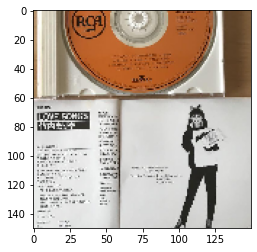

1/1 [==============================] - 0s 34ms/step
[[4.02277157e-22 5.08416052e-12 9.52143309e-05 2.30409796e-15
  5.75752280e-21 7.86993439e-07 2.45459555e-11 7.26838768e-01
  1.44692001e-08 2.20983054e-07 2.79271489e-07 3.91236498e-16
  1.91984666e-12 1.57502511e-10 6.05257598e-13 5.20547444e-15
  1.97442214e-12 2.92781337e-08 1.12772815e-13 1.75347757e-11
  6.89647006e-09 3.28204196e-12 4.23192345e-02 7.41440020e-09
  5.52973791e-13 2.88055903e-19 1.00770832e-14 8.17419659e-14
  7.51401498e-20 1.36711156e-10 1.19053625e-01 8.05441057e-04
  9.52998698e-02 1.43051324e-02 1.22160433e-13 7.48630402e-09
  1.26393838e-03 1.71562478e-05 5.27408737e-17 2.24889845e-07
  2.19207261e-13]]
Hiroshi Sato - Sound Of Science , 72.68
2.m63949046117_2.jpg: Hiroshi Sato - Sound Of Science
--------------------------------------------------------------
2.m11167363664_1.jpg


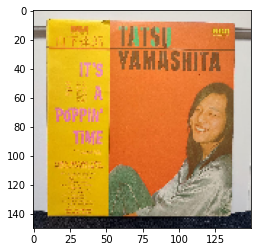

1/1 [==============================] - 0s 51ms/step
[[4.0855952e-08 6.0616332e-01 2.9871936e-15 1.1203912e-09 3.3477177e-16
  5.2381832e-10 2.7861739e-17 3.0513938e-13 7.1285930e-03 2.0976921e-15
  2.7886517e-13 1.5856683e-13 1.3613656e-10 2.5222119e-04 2.6016460e-09
  5.2220269e-16 1.5546249e-13 1.3116657e-08 1.5168692e-17 1.7192044e-18
  1.4644179e-10 1.6004448e-09 1.0832240e-07 5.8909512e-07 2.3937567e-16
  7.0563547e-19 6.9293861e-14 3.6101284e-08 5.5543776e-05 1.8672199e-09
  2.8411018e-06 5.3601057e-09 1.6826597e-10 4.9591648e-07 3.8625699e-01
  7.3299631e-08 9.4290692e-05 3.4777484e-10 4.4772638e-05 4.6499438e-10
  1.5065304e-16]]
Anri (2) - Coool , 60.62
2.m11167363664_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
2.m99019170323_1.jpg


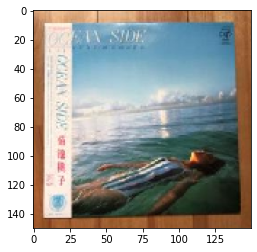

1/1 [==============================] - 0s 55ms/step
[[6.84033045e-24 3.68574489e-26 2.48138327e-03 1.88355841e-06
  1.29633014e-11 2.55672827e-12 6.75798355e-16 4.13885227e-22
  1.40781111e-07 2.13630980e-29 1.18207799e-17 8.30083311e-12
  1.60277588e-23 4.34776158e-32 3.55954636e-18 6.31958842e-02
  9.34320748e-01 1.53217540e-17 1.30951262e-20 1.67702245e-26
  7.48681793e-19 6.26228583e-12 5.83617573e-13 3.49218238e-15
  2.08191421e-16 1.21753200e-18 6.65581574e-19 5.64330111e-15
  4.72603833e-27 1.83036569e-22 6.40893186e-16 2.45886061e-20
  3.04699543e-10 1.68953410e-11 6.84911184e-29 2.64609272e-11
  2.12397366e-15 5.58808770e-18 1.52473051e-16 1.27273053e-17
  1.58815916e-09]]
Momoko Kikuchi - Ocean Side , 93.43
2.m99019170323_1.jpg: Momoko Kikuchi - Ocean Side
--------------------------------------------------------------
6.m60664763395_1.jpg


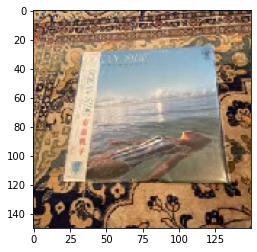

1/1 [==============================] - 0s 31ms/step
[[1.1276947e-26 1.9183007e-28 8.1570706e-27 4.8115649e-20 1.0063016e-30
  9.6801668e-01 5.0177163e-38 3.1853440e-31 2.7173538e-02 0.0000000e+00
  0.0000000e+00 2.0233825e-14 1.2791696e-30 3.6528333e-18 9.7153427e-32
  3.0662435e-20 2.5718890e-29 1.5953202e-11 2.5692109e-30 9.6875768e-34
  6.4287667e-28 4.4866750e-17 7.5529173e-22 1.9812721e-20 7.2402521e-21
  0.0000000e+00 8.7927737e-30 2.4673782e-21 3.7668546e-36 7.7882822e-20
  8.6123606e-09 9.8319958e-07 5.1576703e-26 5.3117652e-05 7.1315765e-18
  3.4877123e-18 8.4616343e-31 7.5437502e-17 8.8448286e-27 4.7557130e-03
  1.4698621e-31]]
Hiroshi Sato - Awakening , 96.80
6.m60664763395_1.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
6.m36871888167_1.jpg


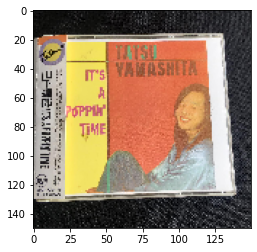

1/1 [==============================] - 0s 38ms/step
[[1.2503421e-22 9.9973458e-01 4.3331892e-20 2.3322740e-18 6.7504053e-27
  7.6531095e-15 1.3794124e-21 1.1669771e-15 3.7081301e-07 4.6437801e-28
  3.7555207e-18 8.3298963e-24 1.9773160e-17 8.0243393e-07 7.8210253e-19
  3.4037255e-22 1.9409944e-18 2.8285673e-14 1.6842330e-23 2.6347020e-31
  7.7874457e-11 4.7314456e-16 3.4097256e-13 1.4457261e-08 8.5687723e-26
  8.3200382e-27 7.5866922e-22 4.0379310e-19 2.7992006e-09 2.6050599e-16
  1.8273321e-08 4.4502788e-16 6.7915864e-09 1.8884943e-19 2.6417000e-04
  7.6614279e-13 5.3970236e-08 5.8854431e-14 8.8023902e-12 2.3137181e-18
  1.7346117e-21]]
Anri (2) - Coool , 99.97
6.m36871888167_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
5.m17039467299_3.jpg


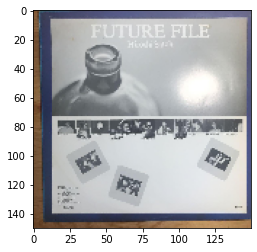

1/1 [==============================] - 0s 51ms/step
[[7.0261121e-05 5.7971401e-06 3.8779035e-02 4.1585448e-03 1.3195238e-01
  5.5615619e-02 2.6795290e-02 2.7583332e-03 2.6237758e-02 3.1398531e-04
  2.0013787e-01 3.2340929e-02 5.4595753e-04 7.9673733e-08 2.0561792e-04
  1.6148497e-01 2.0891421e-03 3.5805777e-03 1.3432816e-01 4.0197841e-04
  1.0722231e-02 1.9092644e-03 1.7732549e-03 5.8186394e-03 3.6861466e-03
  4.1968662e-02 1.9691328e-03 5.5561145e-07 6.3760848e-07 8.3626510e-05
  6.1380025e-04 4.9549412e-02 2.4843993e-02 1.2331912e-03 3.7902703e-07
  2.7295755e-04 1.2807447e-02 5.9107034e-03 3.2450637e-04 1.1743230e-02
  2.9659979e-03]]
Mariya Takeuchi - Miss M , 20.01
5.m17039467299_3.jpg: Mariya Takeuchi - Miss M
--------------------------------------------------------------
4.m45694014745_1.jpg


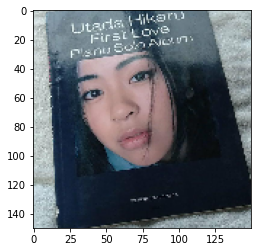

1/1 [==============================] - 0s 33ms/step
[[7.21308701e-13 5.66897810e-01 4.96764851e-11 5.08234841e-08
  1.13222828e-17 1.57917867e-07 9.72439750e-12 9.69160219e-09
  2.15143955e-04 6.74152678e-11 4.90212329e-02 1.22320353e-06
  1.01042374e-07 5.71192824e-04 5.35134802e-07 1.85719152e-15
  7.83671908e-07 7.41580204e-16 1.32007518e-14 2.18604163e-11
  7.75675071e-05 2.17147806e-13 5.51652612e-10 4.37429844e-06
  4.29052919e-16 7.30339336e-16 2.65254058e-16 8.44625411e-12
  1.28965970e-04 4.21980850e-08 3.57443869e-01 1.49091656e-10
  7.77662359e-03 2.90107521e-12 4.67842760e-08 1.83262794e-10
  9.16993804e-03 2.66040368e-09 8.69027339e-03 1.58877000e-08
  2.31775599e-09]]
Anri (2) - Coool , 56.69
4.m45694014745_1.jpg: Anri (2) - Coool
--------------------------------------------------------------
6.m72496597227_1.jpg


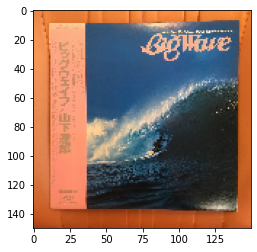

1/1 [==============================] - 0s 45ms/step
[[1.2985359e-18 2.3908921e-23 4.0326492e-11 3.4889289e-11 1.3843577e-11
  4.4695791e-02 7.3500815e-12 6.9498059e-23 1.0121059e-04 6.3122998e-29
  3.9899077e-28 1.0804251e-07 3.2770361e-24 1.8206070e-18 1.2014974e-21
  9.5391995e-01 1.0400305e-08 9.3794606e-06 9.0406464e-13 3.5038721e-23
  5.1957486e-20 8.3278886e-09 7.5877721e-11 1.9297914e-12 1.0672225e-04
  8.4865598e-19 2.0251736e-14 1.0202865e-11 2.0382383e-24 5.6640696e-16
  3.8299794e-07 7.7445689e-12 2.3506488e-15 1.1632844e-03 1.8143492e-15
  3.1692789e-06 1.6686321e-18 3.5990180e-12 6.3134041e-15 3.2308839e-10
  1.8328730e-09]]
Momoko Kikuchi - Escape From Dimension , 95.39
6.m72496597227_1.jpg: Momoko Kikuchi - Escape From Dimension
--------------------------------------------------------------
3.m97369395158_1.jpg


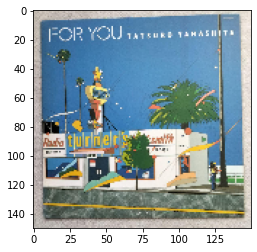

1/1 [==============================] - 0s 36ms/step
[[8.64126819e-37 6.88185478e-37 3.09518562e-08 1.20935005e-17
  4.80102236e-10 1.58687208e-19 3.42738997e-35 1.07204212e-17
  5.76143976e-16 4.05897118e-31 2.71655055e-33 9.90656209e-26
  1.22970266e-17 1.71873682e-22 2.14788941e-38 1.12152009e-07
  4.67181755e-21 9.97928500e-01 8.56846670e-21 0.00000000e+00
  5.26598053e-31 6.85302450e-26 1.83629370e-27 4.70379500e-27
  1.98592804e-15 3.17636612e-20 2.07136478e-03 1.26758756e-30
  0.00000000e+00 3.20327263e-26 8.47949490e-23 1.14111379e-16
  8.38794491e-28 4.32174130e-16 3.85753958e-32 1.56705394e-15
  4.78586971e-30 1.16534714e-18 8.83909730e-24 1.16986200e-13
  5.70748998e-18]]
Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線 , 99.79
3.m97369395158_1.jpg: Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線
--------------------------------------------------------------
3.m46609796980_1.jpg


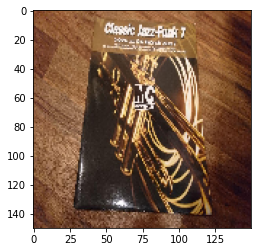

1/1 [==============================] - 0s 31ms/step
[[2.1045178e-06 1.1677640e-07 2.9938354e-05 4.6964479e-04 5.2320859e-19
  5.7254731e-14 5.7196618e-27 1.2181331e-07 1.8973002e-05 7.4007854e-02
  1.2216978e-07 1.9843004e-08 1.3893380e-07 6.1052723e-04 4.6935500e-10
  2.0199362e-19 5.7048484e-18 3.4591544e-15 1.4991112e-24 4.0000450e-14
  8.1300112e-11 2.2147621e-08 1.5668305e-04 7.4538500e-14 6.3494238e-15
  1.2982172e-27 2.7642584e-17 1.0011371e-01 4.6137631e-14 1.5396468e-04
  2.6503080e-01 4.5997722e-04 1.9014198e-12 1.7798349e-01 5.4584842e-10
  1.9942057e-13 1.4469739e-08 1.2030200e-05 1.2896168e-15 3.8094980e-01
  1.7847339e-23]]
Various - Classic Jazz-Funk Mastercuts Volume 7 , 38.09
3.m46609796980_1.jpg: Various - Classic Jazz-Funk Mastercuts Volume 7
--------------------------------------------------------------
7.m45474073046_1.jpg


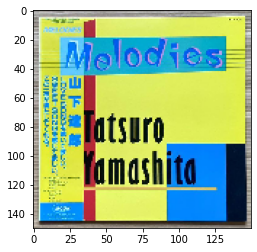

1/1 [==============================] - 0s 40ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 1.0000000e+00
  7.4983998e-24 9.2488718e-32 1.6404201e-24 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 3.3052929e-32
  0.0000000e+00]]
Tatsuro Yamashita - Melodies , 100.00
7.m45474073046_1.jpg: Tatsuro Yamashita - Melodies
--------------------------------------------------------------
1.m30396806056_1.jpg


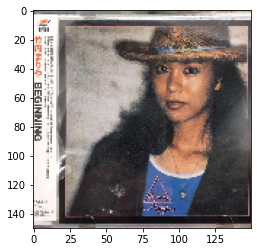

1/1 [==============================] - 0s 43ms/step
[[1.4826280e-12 3.9725714e-20 3.0498029e-22 1.9396322e-09 2.0259839e-26
  2.6108184e-08 5.3184230e-20 7.9929109e-22 9.9999869e-01 5.0128714e-24
  1.9389655e-21 1.6878623e-15 2.3927554e-17 6.0275550e-19 1.7130772e-10
  1.4399216e-22 9.6272714e-18 3.0182589e-14 2.4136996e-20 7.5411638e-23
  4.4643507e-21 8.2855613e-18 4.7492363e-19 3.1407848e-15 3.2321706e-18
  2.6185367e-28 1.1567788e-24 3.5045516e-20 8.5982387e-21 1.4169610e-20
  1.3185148e-06 6.8317438e-15 1.6393649e-08 4.2800199e-14 3.5415906e-20
  2.4840159e-11 3.8645578e-15 1.8027444e-19 1.6603116e-17 9.1149175e-14
  5.1498228e-19]]
Mariya Takeuchi - Beginning , 100.00
1.m30396806056_1.jpg: Mariya Takeuchi - Beginning
--------------------------------------------------------------
6.m34649649176_1.jpg


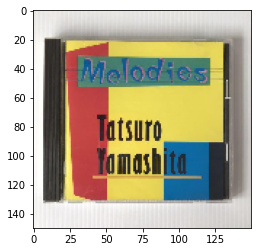

1/1 [==============================] - 0s 35ms/step
[[4.7266397e-16 3.5525530e-10 3.4306463e-10 8.0618373e-14 0.0000000e+00
  0.0000000e+00 0.0000000e+00 8.9271716e-20 1.7807928e-19 3.1780644e-16
  1.4756407e-21 7.3379594e-38 1.2483240e-11 2.1061044e-20 9.4804056e-27
  0.0000000e+00 3.5000529e-28 0.0000000e+00 0.0000000e+00 0.0000000e+00
  1.3688419e-37 0.0000000e+00 1.8471227e-36 0.0000000e+00 0.0000000e+00
  0.0000000e+00 7.5969364e-36 1.9434530e-16 2.0462098e-28 1.0000000e+00
  2.9470659e-16 3.8334240e-21 1.6544482e-15 3.0105660e-28 1.6131607e-37
  0.0000000e+00 4.5467614e-31 6.0427606e-33 3.0034546e-35 4.6083193e-10
  0.0000000e+00]]
Tatsuro Yamashita - Melodies , 100.00
6.m34649649176_1.jpg: Tatsuro Yamashita - Melodies
--------------------------------------------------------------
1.m59695001923_1.jpg


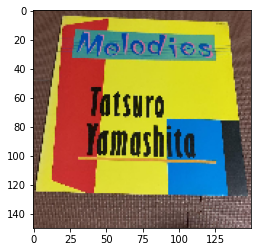

1/1 [==============================] - 0s 52ms/step
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 2.3359128e-24 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 2.3797402e-25 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 2.4488576e-38 0.0000000e+00
  0.0000000e+00 0.0000000e+00 5.3701854e-29 0.0000000e+00 9.9841774e-01
  1.5822427e-03 1.0284466e-14 7.7383752e-30 5.2292782e-38 0.0000000e+00
  0.0000000e+00 0.0000000e+00 2.7709749e-37 0.0000000e+00 1.5669832e-25
  0.0000000e+00]]
Tatsuro Yamashita - Melodies , 99.84
1.m59695001923_1.jpg: Tatsuro Yamashita - Melodies
--------------------------------------------------------------
4.m17123236096_1.jpg


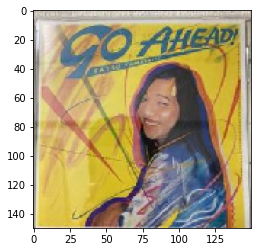

1/1 [==============================] - 0s 40ms/step
[[1.0452240e-04 3.8755116e-10 6.1679137e-30 1.6005757e-08 0.0000000e+00
  0.0000000e+00 0.0000000e+00 0.0000000e+00 1.1500559e-11 8.3361848e-18
  3.9463426e-30 4.2495301e-25 3.1959026e-25 7.8350222e-14 1.7919584e-11
  0.0000000e+00 4.8928475e-22 0.0000000e+00 0.0000000e+00 0.0000000e+00
  2.2100098e-38 6.4582934e-24 2.4423970e-31 3.9836504e-33 0.0000000e+00
  0.0000000e+00 0.0000000e+00 9.9989498e-01 4.7313509e-07 1.7049974e-11
  6.3654309e-14 2.4168249e-32 2.8642850e-33 1.3319503e-18 1.8940893e-12
  2.9747443e-23 3.8998894e-23 1.0628317e-32 3.4285805e-09 4.0012165e-30
  0.0000000e+00]]
Tatsuro Yamashita - Go Ahead! , 99.99
4.m17123236096_1.jpg: Tatsuro Yamashita - Go Ahead!
--------------------------------------------------------------
4.m46692754589_2.jpg


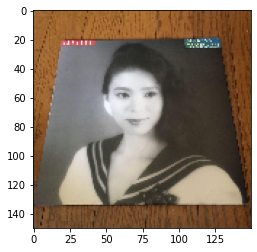

1/1 [==============================] - 0s 39ms/step
[[2.1268839e-13 7.4757883e-20 1.3927844e-24 4.8072842e-15 5.6375618e-18
  9.3906116e-01 4.5417560e-20 1.1490784e-24 5.8024589e-02 6.1759491e-30
  2.6828077e-25 3.2535706e-12 2.3965715e-20 3.4404332e-10 2.9763543e-19
  1.8242227e-14 1.2571689e-22 2.1541113e-09 1.9979423e-17 2.8423087e-21
  3.0777690e-24 1.7160520e-16 2.0280586e-17 3.0391865e-16 8.2798863e-16
  2.8795570e-28 4.2965843e-22 8.8934768e-13 7.5815288e-21 6.6967187e-16
  4.4207584e-09 4.8555053e-12 7.7015269e-16 7.4229017e-04 1.0212810e-12
  6.6414615e-16 1.4042250e-20 2.6302861e-17 1.5017077e-17 2.1719176e-03
  1.6958194e-24]]
Hiroshi Sato - Awakening , 93.91
4.m46692754589_2.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
4.m76419246686_1.jpg


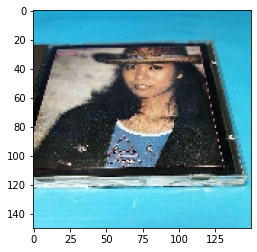

1/1 [==============================] - 0s 49ms/step
[[3.2267110e-14 6.3544336e-05 8.6026924e-10 6.3785136e-01 0.0000000e+00
  0.0000000e+00 0.0000000e+00 1.1177910e-23 1.9778765e-11 1.6344845e-18
  1.9929830e-07 6.6318794e-21 3.6195359e-01 2.1145648e-20 1.2725293e-04
  0.0000000e+00 3.9976876e-06 0.0000000e+00 0.0000000e+00 0.0000000e+00
  3.3547142e-27 1.3178900e-36 3.8602039e-21 3.3700916e-28 9.7952314e-35
  0.0000000e+00 0.0000000e+00 3.4632227e-21 4.2698058e-15 2.2492378e-17
  1.2461300e-08 1.2034427e-26 2.6604319e-08 1.1239958e-22 5.5622921e-31
  0.0000000e+00 7.5613036e-09 1.6547820e-38 2.7536415e-22 4.0486743e-19
  6.3383948e-31]]
Anri (2) - Wave , 63.79
4.m76419246686_1.jpg: Anri (2) - Wave
--------------------------------------------------------------
4.m40165340782_1.jpg


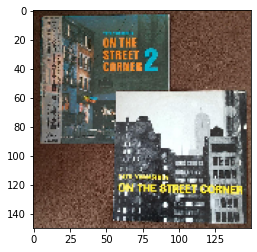

1/1 [==============================] - 0s 40ms/step
[[2.3536896e-23 7.1036571e-23 9.9929893e-01 1.1886265e-08 1.6454667e-16
  1.5161981e-17 1.8724303e-35 4.9607131e-08 4.9456695e-13 3.7006120e-09
  5.2791129e-11 1.6394214e-15 7.5961200e-16 8.5804632e-21 1.6138502e-23
  4.3092541e-18 1.1267921e-21 3.4373500e-13 3.6785536e-26 4.9839414e-22
  2.5613762e-15 3.1188412e-07 1.0507139e-07 9.0615222e-23 3.5601954e-20
  4.2590842e-25 1.3038337e-15 7.6628510e-17 7.3660388e-30 5.8599116e-17
  2.5341562e-13 6.2359877e-06 2.2798758e-21 1.9632589e-06 1.5388829e-24
  3.5640463e-17 3.9847705e-18 8.8406148e-07 3.9608157e-23 6.9141592e-04
  2.1339541e-31]]
Anri (2) - Timely!! , 99.93
4.m40165340782_1.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
3.m42927500800_2.jpg


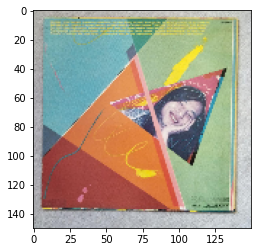

1/1 [==============================] - 0s 34ms/step
[[2.86780243e-17 3.81857697e-12 3.98252611e-11 8.32541332e-07
  2.17661150e-11 1.06726056e-13 3.04968924e-23 8.03038056e-17
  4.51280766e-12 5.49179275e-15 2.10067293e-12 5.78141567e-07
  1.29488902e-11 3.39065755e-11 8.32668843e-21 5.41327847e-14
  7.99419240e-17 8.47964234e-12 7.74282257e-19 1.92279622e-18
  7.62185315e-11 4.89999046e-08 3.03347245e-13 9.31978663e-15
  5.60938517e-16 2.43626755e-18 3.95232527e-11 1.18351929e-13
  1.87930590e-13 1.09377338e-16 4.56372096e-09 1.37014768e-15
  2.80895253e-20 2.36234527e-20 4.28825074e-12 5.14677340e-05
  5.79789383e-10 2.97882309e-07 9.99946713e-01 6.18903706e-10
  2.10324263e-16]]
Utada Hikaru - First Love , 99.99
3.m42927500800_2.jpg: Utada Hikaru - First Love
--------------------------------------------------------------
6.m40165340782_7.jpg


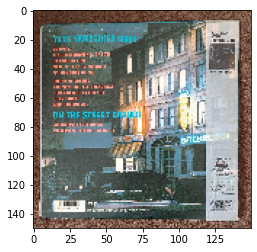

1/1 [==============================] - 0s 49ms/step
[[3.9517752e-27 7.3626156e-33 4.4828108e-12 1.9016286e-22 5.2891655e-06
  9.0455472e-01 4.6155976e-10 1.4058961e-10 7.7268156e-20 4.3046376e-07
  7.2338281e-07 2.6856731e-03 9.9267611e-21 2.8312417e-18 2.2538927e-23
  5.3466169e-09 6.0353781e-19 2.5857256e-17 4.3767653e-03 6.1083736e-04
  3.9871376e-02 2.7528721e-22 5.2941846e-16 4.4938680e-02 6.1431600e-14
  1.5631829e-05 6.8235154e-11 2.9865635e-21 1.6372944e-29 6.9411523e-16
  2.1115928e-12 1.6994396e-12 5.5962732e-17 1.8204455e-16 2.7965750e-30
  4.5799155e-13 4.8210597e-10 2.9398284e-03 5.8671465e-14 1.9223358e-10
  2.1045070e-17]]
Hiroshi Sato - Awakening , 90.46
6.m40165340782_7.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
5.c1045869207.1.jpg


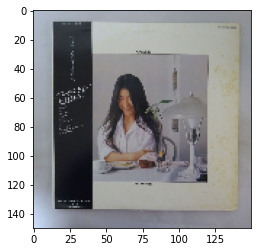

1/1 [==============================] - 0s 32ms/step
[[3.15312665e-26 1.05777246e-21 2.38781744e-10 4.67026483e-13
  2.84754160e-15 1.27649323e-11 3.69410564e-19 1.11272869e-09
  9.79644165e-19 2.19290008e-09 1.54863781e-04 1.41626399e-09
  3.60055410e-13 1.58022901e-15 7.48534089e-25 5.91396617e-17
  8.21952249e-20 3.59643655e-20 1.31696497e-16 4.96047683e-08
  9.99844313e-01 2.93990703e-14 1.78195485e-13 1.08868804e-07
  8.59348861e-24 6.75099569e-18 1.39827397e-18 1.69618317e-18
  2.07166597e-21 7.82924915e-21 2.38374823e-11 1.08629522e-13
  4.53240423e-18 5.97616101e-21 4.04845341e-23 3.55908120e-13
  3.93509796e-13 6.17058561e-07 9.42070247e-14 1.14801925e-10
  1.73414300e-18]]
Taeko Ohnuki - Grey Skies , 99.98
5.c1045869207.1.jpg: Taeko Ohnuki - Grey Skies
--------------------------------------------------------------
1.m49127388755_1.jpg


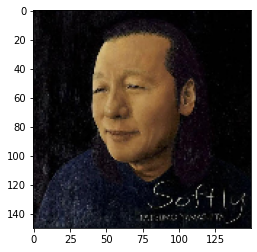

1/1 [==============================] - 0s 47ms/step
[[7.85644688e-23 1.16777055e-01 3.95517953e-28 2.67215493e-23
  0.00000000e+00 3.97393044e-29 0.00000000e+00 6.11173646e-27
  1.32009362e-07 0.00000000e+00 5.97477071e-31 0.00000000e+00
  3.16614057e-23 1.22129030e-14 3.60922955e-24 5.18552022e-34
  2.05549554e-25 3.83055386e-20 0.00000000e+00 0.00000000e+00
  1.36434579e-22 1.32946319e-18 2.28868451e-17 1.52945876e-14
  0.00000000e+00 0.00000000e+00 1.05861612e-31 2.26592596e-23
  6.96552758e-15 3.66345297e-16 1.61681313e-12 1.57349257e-17
  2.80042905e-21 3.66767024e-19 8.83222759e-01 1.03732103e-24
  2.56759191e-15 1.35375410e-22 2.13739981e-19 6.27062279e-28
  1.46108032e-36]]
Tatsuro Yamashita - Softly , 88.32
1.m49127388755_1.jpg: Tatsuro Yamashita - Softly
--------------------------------------------------------------
7.m80828542331_3.jpg


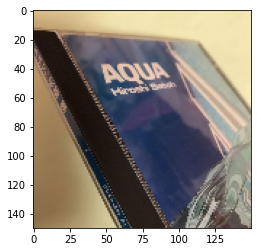

1/1 [==============================] - 0s 45ms/step
[[8.2561186e-34 1.7242182e-11 1.5950516e-30 2.8353084e-23 5.3841548e-27
  9.7706842e-01 3.0975011e-13 3.2098158e-13 1.4141824e-09 5.9068093e-31
  7.1242039e-18 1.1022342e-13 8.0266851e-19 6.5066735e-05 6.9188841e-33
  1.6828407e-23 1.4615454e-26 4.2356377e-14 1.4450734e-07 2.2422731e-22
  1.6525820e-02 1.9178365e-23 4.3702371e-16 1.0439191e-03 2.7762785e-18
  5.8813395e-22 3.7557922e-20 4.3666610e-28 4.1084225e-14 6.1051503e-25
  5.2965768e-03 5.7488255e-22 5.2569717e-09 1.0122809e-29 4.7043348e-13
  5.2056283e-08 1.4057683e-12 1.3768243e-10 3.5757480e-11 1.7958916e-14
  1.0667856e-15]]
Hiroshi Sato - Awakening , 97.71
7.m80828542331_3.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
2.m46609796980_4.jpg


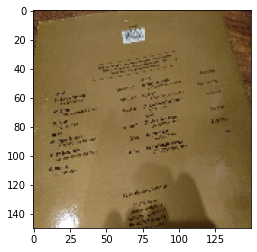

1/1 [==============================] - 0s 32ms/step
[[5.50172990e-03 3.16567048e-02 4.03686680e-18 1.65877952e-06
  1.93243467e-21 8.15052739e-18 9.78545617e-20 5.34917265e-22
  4.12638765e-05 1.29407015e-11 7.59081969e-16 6.43136566e-09
  6.11267925e-10 3.78049398e-03 1.01485687e-09 9.69562053e-18
  1.84398815e-13 1.13563635e-17 6.09273639e-26 4.00321748e-20
  8.72795708e-15 3.47076881e-11 6.72963547e-16 5.23584756e-13
  4.29329204e-17 2.89624176e-27 5.05513620e-21 4.69130697e-03
  9.00136709e-01 8.83213431e-08 1.04595713e-07 1.24436843e-16
  7.57831709e-17 1.57924479e-10 8.96076788e-04 1.48944025e-07
  2.74287870e-10 2.89095440e-12 5.32936603e-02 3.60438307e-12
  1.71781386e-19]]
Tatsuro Yamashita - It's A Poppin' Time , 90.01
2.m46609796980_4.jpg: Tatsuro Yamashita - It's A Poppin' Time
--------------------------------------------------------------
1.m42927500800_1.jpg


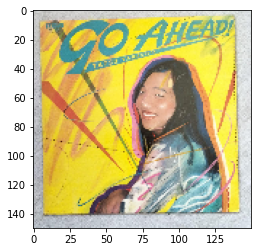

1/1 [==============================] - 0s 37ms/step
[[5.4116193e-03 1.1405988e-04 2.4803703e-19 3.0546824e-05 1.4835558e-35
  1.0464102e-37 6.9704885e-38 1.0248438e-31 1.3151373e-09 1.2371787e-09
  8.4904780e-19 2.3706478e-16 3.6174117e-17 2.0499873e-11 1.5759730e-08
  3.3241361e-32 7.0456842e-17 6.5010407e-34 0.0000000e+00 9.4937341e-34
  1.3517720e-28 8.2511671e-18 4.9943917e-22 1.3877212e-25 4.8496700e-32
  0.0000000e+00 3.4205322e-34 9.9414343e-01 3.1464591e-05 2.2724155e-06
  8.5648121e-11 1.1656240e-22 2.3564264e-26 1.5664560e-14 3.3359732e-11
  3.4632708e-18 6.7502631e-14 5.5658441e-23 2.6654609e-04 4.5115579e-22
  4.6535896e-33]]
Tatsuro Yamashita - Go Ahead! , 99.41
1.m42927500800_1.jpg: Tatsuro Yamashita - Go Ahead!
--------------------------------------------------------------
3.m35271324182_1.jpg


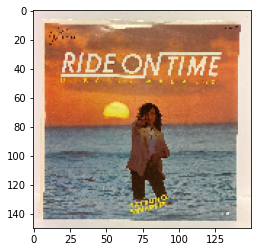

1/1 [==============================] - 0s 41ms/step
[[4.58321154e-01 3.43212187e-02 4.33583692e-17 4.47174191e-01
  4.95444131e-24 7.86094051e-21 1.92715406e-23 1.95317260e-19
  2.83776131e-03 1.32349642e-09 7.69158360e-05 1.87037159e-08
  3.15645273e-04 1.54062035e-03 3.05734552e-03 2.22786626e-24
  6.76741788e-11 1.15090319e-27 2.54043396e-31 7.19400871e-14
  1.53987416e-18 1.85083763e-17 1.69460654e-16 1.11759102e-16
  3.01394940e-26 5.22836957e-29 3.22399768e-27 4.32320274e-02
  9.11658630e-03 4.24784368e-08 5.75047397e-06 7.58973574e-19
  1.07802867e-09 6.05577810e-11 5.86465210e-10 1.00153647e-20
  4.15751635e-11 3.73452692e-20 7.10593781e-07 1.44300683e-10
  1.03906066e-19]]
Anri (2) - Bi・Ki・Ni , 45.83
3.m35271324182_1.jpg: Anri (2) - Bi・Ki・Ni
--------------------------------------------------------------
3.maxresdefault.jpg


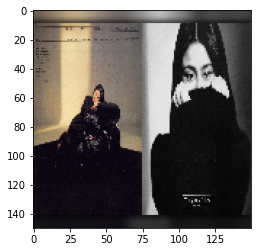

1/1 [==============================] - 0s 47ms/step
[[1.12462190e-24 2.32729095e-14 2.74823826e-08 2.26602595e-16
  2.60601147e-24 1.03360456e-13 2.47215072e-35 1.14892291e-08
  1.77254922e-08 3.15703783e-11 1.19561665e-15 3.96940236e-18
  7.00147905e-16 8.91219522e-15 3.72465740e-18 4.52694993e-23
  8.23888349e-22 5.01428651e-13 9.92664599e-25 4.00043080e-24
  6.54555240e-13 8.56667376e-11 8.40695066e-07 7.57108265e-12
  1.41840262e-20 9.40411851e-28 2.13450681e-17 6.96810899e-19
  3.37188733e-25 1.87376920e-10 2.10309906e-07 9.99989271e-01
  1.26461350e-19 7.90138620e-06 1.98150242e-12 6.93875573e-16
  2.48802525e-13 1.79302617e-06 1.70950344e-21 2.96532612e-08
  2.22905834e-30]]
Tatsuro Yamashita - On The Street Corner , 100.00
3.maxresdefault.jpg: Tatsuro Yamashita - On The Street Corner
--------------------------------------------------------------
4.m75849161538_2.jpg


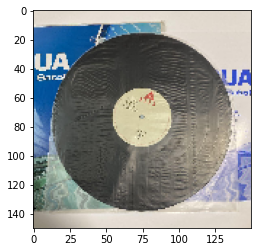

1/1 [==============================] - 0s 30ms/step
[[5.55503248e-32 1.54272820e-34 7.01785386e-02 3.76408242e-13
  4.75777057e-07 5.06415791e-14 3.44067102e-31 7.15383378e-11
  1.63255171e-25 8.67640309e-04 2.34801695e-01 3.24083555e-12
  1.08454615e-20 4.74860298e-19 4.27212968e-31 1.07302825e-19
  5.37465347e-35 2.38450483e-21 1.27473707e-14 4.49015092e-09
  1.76565911e-04 4.26851322e-16 8.59838242e-11 6.13081092e-14
  1.90600108e-29 2.81063177e-20 2.99754118e-15 1.26154194e-19
  7.99324769e-37 1.64498274e-21 1.49540068e-11 1.65000282e-15
  1.31676418e-27 1.81618990e-20 1.73113641e-36 2.89205420e-18
  4.44566739e-09 6.27839625e-01 5.34445752e-12 6.61354512e-02
  2.09733892e-35]]
Utada Hikaru - Deep River , 62.78
4.m75849161538_2.jpg: Utada Hikaru - Deep River
--------------------------------------------------------------
4.m14911898302_1.jpg


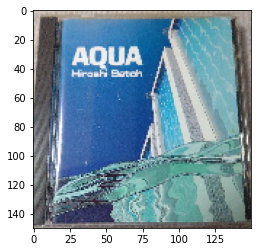

1/1 [==============================] - 0s 38ms/step
[[0.0000000e+00 0.0000000e+00 2.9723165e-25 0.0000000e+00 2.6366634e-10
  6.7235160e-01 1.4913445e-26 1.9631148e-38 9.2362854e-22 0.0000000e+00
  0.0000000e+00 1.4295241e-13 0.0000000e+00 0.0000000e+00 0.0000000e+00
  3.2764831e-01 1.4043867e-33 1.0183588e-07 1.3642710e-11 0.0000000e+00
  1.7049350e-36 7.9566092e-32 3.7534568e-21 1.0717380e-22 2.1218959e-16
  6.8291827e-25 1.1956065e-13 3.1668809e-37 0.0000000e+00 0.0000000e+00
  8.1084378e-31 4.5538075e-29 9.7150933e-37 6.1587617e-11 0.0000000e+00
  9.2191041e-15 2.2209217e-31 4.9905724e-22 2.8995754e-34 9.4527378e-26
  1.8037228e-25]]
Hiroshi Sato - Awakening , 67.24
4.m14911898302_1.jpg: Hiroshi Sato - Awakening
--------------------------------------------------------------
2.m92793218439_1.jpg


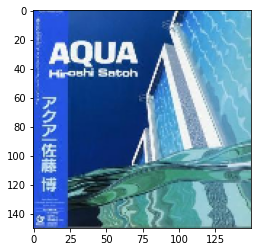

1/1 [==============================] - 0s 46ms/step
[[0.00000000e+00 0.00000000e+00 7.81376353e-12 3.73453956e-27
  9.99965549e-01 1.29886064e-27 1.52363893e-28 8.12506009e-27
  5.56123767e-29 2.30284004e-25 1.02411544e-17 5.34003448e-22
  6.25736520e-30 0.00000000e+00 1.74664600e-37 8.42382670e-17
  8.17806910e-29 1.38161382e-25 3.99155223e-11 3.34793792e-20
  8.41703642e-20 1.15981482e-33 2.91335989e-34 1.21319546e-27
  3.93071372e-28 3.45059452e-05 2.81688853e-15 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 3.03314130e-32
  2.85315116e-29 7.98966234e-36 0.00000000e+00 2.38902365e-28
  6.16801467e-24 1.46403371e-29 1.32402445e-26 1.73813467e-26
  1.65003783e-28]]
Hiroshi Sato - Aqua , 100.00
2.m92793218439_1.jpg: Hiroshi Sato - Aqua
--------------------------------------------------------------
3.m80096952270_3.jpg


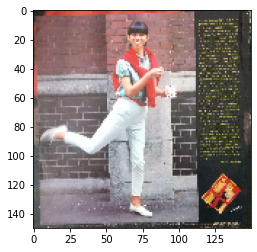

1/1 [==============================] - 0s 32ms/step
[[2.07848513e-11 6.50725474e-09 2.56458804e-07 2.19753193e-09
  4.56909088e-09 3.72085392e-01 7.55067902e-07 5.10408972e-06
  3.53402346e-02 2.97349301e-09 1.16610204e-06 4.78531952e-08
  1.23185576e-12 4.10916741e-08 1.52656536e-08 6.02844850e-08
  6.32411918e-12 6.50458445e-04 4.13649203e-03 6.07852712e-07
  3.10564587e-08 7.85121301e-06 5.16069889e-01 3.44858427e-06
  5.92537219e-08 3.70376174e-10 6.83920975e-10 5.64177283e-09
  8.19579560e-12 8.46507309e-09 1.47081027e-03 1.83024604e-04
  5.27938409e-03 4.41806465e-02 2.03030126e-08 5.20287074e-07
  5.65452920e-03 2.54994320e-05 1.29866129e-09 1.49035547e-02
  1.02842526e-13]]
Taeko Ohnuki - Romantique , 51.61
3.m80096952270_3.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------
7.m80121781767_3.jpg


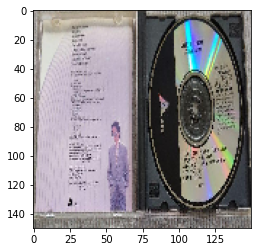

1/1 [==============================] - 0s 56ms/step
[[1.5513981e-22 9.6100941e-23 5.1426554e-01 1.2146601e-04 1.3674920e-28
  1.5247329e-21 0.0000000e+00 1.1776203e-13 1.5409497e-03 2.4109456e-11
  2.0665143e-11 1.2023632e-22 2.0143430e-19 1.1902734e-31 8.9440668e-09
  8.3348573e-29 7.4220099e-20 4.0667748e-18 1.5131473e-32 2.4407015e-29
  5.7870312e-23 5.0412985e-10 1.0328023e-02 9.2032369e-23 5.5363972e-27
  8.6976125e-37 5.6220206e-26 7.2060104e-22 3.4374203e-33 1.0963784e-20
  1.3985743e-08 2.1207372e-06 1.4970220e-14 4.7374192e-01 2.4847351e-27
  3.6986371e-16 1.7389935e-09 1.6008694e-16 6.7093647e-22 6.9586502e-12
  1.3508294e-34]]
Anri (2) - Timely!! , 51.43
7.m80121781767_3.jpg: Anri (2) - Timely!!
--------------------------------------------------------------
2.m83483418597_1.jpg


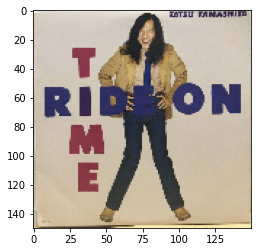

1/1 [==============================] - 0s 44ms/step
[[9.75410386e-17 6.12231196e-18 1.30719785e-03 5.69896095e-08
  3.30989468e-12 2.91737997e-05 9.83813207e-20 1.48089603e-03
  8.66935409e-07 9.16690283e-07 7.86401142e-06 2.42014872e-12
  1.72350495e-10 1.10409772e-10 4.55176465e-14 2.87603752e-12
  9.79965961e-21 6.84517145e-05 4.39674436e-10 3.44346459e-13
  2.60865468e-10 7.23581479e-06 9.95150149e-01 8.04761424e-10
  3.28145497e-13 8.14109637e-17 6.13600337e-10 2.20182162e-13
  3.20572404e-23 1.90627272e-14 1.67721591e-05 8.57175837e-06
  1.25858785e-11 4.57515009e-04 7.40351689e-15 2.09481286e-07
  6.47852630e-06 3.12099903e-04 5.81190439e-16 1.14566251e-03
  4.02246057e-22]]
Taeko Ohnuki - Romantique , 99.52
2.m83483418597_1.jpg: Taeko Ohnuki - Romantique
--------------------------------------------------------------


In [13]:
mypath = "./raw_data/Test_CNN/"

onlyfiles = [f for f in listdir(mypath) if isfile(join(mypath, f))]
print(onlyfiles)

# predicting images
for file in onlyfiles:
    print(file)
    img = image.load_img(mypath+file, target_size=(img_width, img_height)) #150x150
    
    imgplot = plt.imshow(img)
    plt.show()
    
    x = image.img_to_array(img)
    x /= 255.0
    x = np.expand_dims(x, axis=0)
    
    images = np.vstack([x])
    classes = model.predict(images)
    #classes = model.predict_classes(images)
    print(classes)
    #classes = classes[0][0]
    
    if np.argmax(classes) == 0:
        print("%s , %.2f" % ("Anri (2) - Bi・Ki・Ni", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Anri (2) - Bi・Ki・Ni')
    elif np.argmax(classes) == 1:
        print("%s , %.2f" % ("Anri (2) - Coool", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Anri (2) - Coool')
    elif np.argmax(classes) == 2:
        print("%s , %.2f" % ("Anri (2) - Timely!!", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Anri (2) - Timely!!')
    elif np.argmax(classes) == 3:
        print("%s , %.2f" % ("Anri (2) - Wave", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Anri (2) - Wave')
    elif np.argmax(classes) == 4:
        print("%s , %.2f" % ("Hiroshi Sato - Aqua", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Hiroshi Sato - Aqua')
    elif np.argmax(classes) == 5:
        print("%s , %.2f" % ("Hiroshi Sato - Awakening", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Hiroshi Sato - Awakening')
    elif np.argmax(classes) == 6:
        print("%s , %.2f" % ("Hiroshi Sato - Future File", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Hiroshi Sato - Future File')
    elif np.argmax(classes) == 7:
        print("%s , %.2f" % ("Hiroshi Sato - Sound Of Science", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Hiroshi Sato - Sound Of Science')
    elif np.argmax(classes) == 8:
        print("%s , %.2f" % ("Mariya Takeuchi - Beginning", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Mariya Takeuchi - Beginning')
    elif np.argmax(classes) == 9:
        print("%s , %.2f" % ("Mariya Takeuchi - Love Songs", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Mariya Takeuchi - Love Songs')
    elif np.argmax(classes) == 10:
        print("%s , %.2f" % ("Mariya Takeuchi - Miss M", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Mariya Takeuchi - Miss M')
    elif np.argmax(classes) == 11:
        print("%s , %.2f" % ("Mariya Takeuchi - Request", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Mariya Takeuchi - Request')
    elif np.argmax(classes) == 12:
        print("%s , %.2f" % ("Mariya Takeuchi - Trad = トラッド", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Mariya Takeuchi - Trad = トラッド')
    elif np.argmax(classes) == 13:
        print("%s , %.2f" % ("Mariya Takeuchi - University Street", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Mariya Takeuchi - University Street')
    elif np.argmax(classes) == 14:
        print("%s , %.2f" % ("Momoko Kikuchi - Adventure", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Momoko Kikuchi - Adventure')
    elif np.argmax(classes) == 15:
        print("%s , %.2f" % ("Momoko Kikuchi - Escape From Dimension", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Momoko Kikuchi - Escape From Dimension')
    elif np.argmax(classes) == 16:
        print("%s , %.2f" % ("Momoko Kikuchi - Ocean Side", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Momoko Kikuchi - Ocean Side')
    elif np.argmax(classes) == 17:
        print("%s , %.2f" % ("Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Momoko Kikuchi - Tropic Of Capricorn =トロピック・オブ・カプリコーン 南回帰線')
    elif np.argmax(classes) == 18:
        print("%s , %.2f" % ("Taeko Ohnuki - Aventure", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Taeko Ohnuki - Aventure')
    elif np.argmax(classes) == 19:
        print("%s , %.2f" % ("Taeko Ohnuki - Cliché", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Taeko Ohnuki - Cliché')
    elif np.argmax(classes) == 20:
        print("%s , %.2f" % ("Taeko Ohnuki - Grey Skies", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Taeko Ohnuki - Grey Skies')
    elif np.argmax(classes) == 21:
        print("%s , %.2f" % ("Taeko Ohnuki - Mignonne", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Taeko Ohnuki - Mignonne')
    elif np.argmax(classes) == 22:
        print("%s , %.2f" % ("Taeko Ohnuki - Romantique", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Taeko Ohnuki - Romantique')
    elif np.argmax(classes) == 23:
        print("%s , %.2f" % ("Taeko Ohnuki - Sunshower", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Taeko Ohnuki - Sunshower')
    elif np.argmax(classes) == 24:
        print("%s , %.2f" % ("Tatsuro Yamashita - Big Wave = ビッグウェイブ", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Tatsuro Yamashita - Big Wave = ビッグウェイブ')
    elif np.argmax(classes) == 25:
        print("%s , %.2f" % ("Tatsuro Yamashita - Circus Town", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Tatsuro Yamashita - Circus Town')
    elif np.argmax(classes) == 26:
        print("%s , %.2f" % ("Tatsuro Yamashita - For You", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Tatsuro Yamashita - For You')
    elif np.argmax(classes) == 27:
        print("%s , %.2f" % ("Tatsuro Yamashita - Go Ahead!", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Tatsuro Yamashita - Go Ahead!')
    elif np.argmax(classes) == 28:
        print("%s , %.2f" % ("Tatsuro Yamashita - It's A Poppin' Time", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + "Tatsuro Yamashita - It's A Poppin' Time")
    elif np.argmax(classes) == 29:
        print("%s , %.2f" % ("Tatsuro Yamashita - Melodies", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Tatsuro Yamashita - Melodies')
    elif np.argmax(classes) == 30:
        print("%s , %.2f" % ("Tatsuro Yamashita - Moonglow", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Tatsuro Yamashita - Moonglow')
    elif np.argmax(classes) == 31:
        print("%s , %.2f" % ("Tatsuro Yamashita - On The Street Corner", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Tatsuro Yamashita - On The Street Corner')
    elif np.argmax(classes) == 32:
        print("%s , %.2f" % ("Tatsuro Yamashita - On The Street Corner 2", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Tatsuro Yamashita - On The Street Corner 2')
    elif np.argmax(classes) == 33:
        print("%s , %.2f" % ("Tatsuro Yamashita - Ride On Time", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Tatsuro Yamashita - Ride On Time')
    elif np.argmax(classes) == 34:
        print("%s , %.2f" % ("Tatsuro Yamashita - Softly", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Tatsuro Yamashita - Softly')
    elif np.argmax(classes) == 35:
        print("%s , %.2f" % ("Tatsuro Yamashita - Spacy", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Tatsuro Yamashita - Spacy')
    elif np.argmax(classes) == 36:
        print("%s , %.2f" % ("Utada Hikaru - Badモード", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Utada Hikaru - Badモード')
    elif np.argmax(classes) == 37:
        print("%s , %.2f" % ("Utada Hikaru - Deep River", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Utada Hikaru - Deep River')
    elif np.argmax(classes) == 38:
        print("%s , %.2f" % ("Utada Hikaru - First Love", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Utada Hikaru - First Love')
    elif np.argmax(classes) == 39:
        print("%s , %.2f" % ("Various - Classic Jazz-Funk Mastercuts Volume 7", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + 'Various - Classic Jazz-Funk Mastercuts Volume 7')
    elif np.argmax(classes) == 40:
        print("%s , %.2f" % ("東北新幹線 - Thru Traffic", (classes[0][np.argmax(classes)]*100)))
        print(file + ": " + '東北新幹線 - Thru Traffic')
        
    print('--------------------------------------------------------------')